In [ ]:
import numpy as np # linear algebra
import pandas as pd # data processing
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import seaborn as sns
import plotly.express as px

%matplotlib inline

In [ ]:
# Set DPI for fugures

plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

In [ ]:
# Set the default font size and weight
plt.rcParams['font.size'] = 30
plt.rcParams['font.weight'] = 'bold'

In [ ]:
# Drive connection

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Preparing the BRFSS 2021 Dataset

In [ ]:
# Importing Dataset

BRFSS11 = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/BRFSS/BRFSS2021.csv')

In [ ]:
# Dataset Size
BRFSS11.shape

(438693, 44)

In [ ]:
# Count the total number of rows with missing values
total_rows_with_missing = BRFSS11.isnull().any(axis=1).sum()

print(f'Total rows with missing values: {total_rows_with_missing}')

Total rows with missing values: 114674


In [ ]:
# Define the refuse values for each column
refuse_values = {
    'EMPLOY1': [9],
    'PRIMINSR': [77, 99],
    'INCOME3': [77, 99],
    '_STATE': [],  # No refuse values specified for this column
}

# Initialize a variable to count the number of rows with refuse values
rows_with_refuse_values = 0

# Iterate through columns and count rows with refuse values
for column, refuse in refuse_values.items():
    if column in BRFSS11.columns:
        rows_with_refuse_values += len(BRFSS11[BRFSS11[column].isin(refuse)])

# For columns without specified refuse values, count rows with refuse values
for column in BRFSS11.columns:
    if column not in refuse_values:
        refuse = [7, 9, 77, 99, 777, 999, 7777, 9999, 77777, 99999, 777777, 999999]
        rows_with_refuse_values += len(BRFSS11[BRFSS11[column].isin(refuse)])

# Print the total number of rows with refuse values
print(f'Total number of rows with refuse values: {rows_with_refuse_values}')

Total number of rows with refuse values: 292991


In [ ]:
# Droping all null values
BRFSS11 = BRFSS11.dropna()

In [ ]:
# Define the refuse values for each column
refuse_values = {
    'EMPLOY1': [9],
    'PRIMINSR': [77, 99],
    'INCOME3': [77, 99],
    '_STATE': [],  # No refuse values specified for this column
}

# Iterate through columns and remove rows with refuse values
for column, refuse in refuse_values.items():
    if column in BRFSS11.columns:
        BRFSS11 = BRFSS11[~BRFSS11[column].isin(refuse)]

# For columns without specified refuse values, you can still remove rows with the specified refuse values
for column in BRFSS11.columns:
    if column not in refuse_values:
        refuse = [7, 9, 77, 99, 777, 999, 7777, 9999, 77777, 99999, 777777, 999999]
        BRFSS11 = BRFSS11[~BRFSS11[column].isin(refuse)]

In [ ]:
# Null Values

BRFSS11.isnull().sum()

BPHIGH6     0
_AGE_G      0
TOLDHI3     0
GENHLTH     0
HAVARTH5    0
EMPLOY1     0
PRIMINSR    0
DIFFWALK    0
_SMOKER3    0
DIABETE4    0
EXERANY2    0
FLUSHOT7    0
CHCCOPD3    0
CHCOCNCR    0
PERSDOC3    0
DIFFALON    0
CHECKUP1    0
EDUCA       0
_CHLDCNT    0
DIFFDRES    0
_BMI5CAT    0
CHCSCNCR    0
VETERAN3    0
INCOME3     0
HIVTST7     0
RENTHOM1    0
CPDEMO1B    0
FRUIT2      0
USENOW3     0
MARITAL     0
SEXVAR      0
_RFDRHV7    0
BLIND       0
CHCKDNY2    0
ADDEPEV3    0
ASTHMA3     0
MEDCOST1    0
QSTLANG     0
_STATE      0
_IMPRACE    0
HEIGHT3     0
CVDCRHD4    0
CVDINFR4    0
CVDSTRK3    0
dtype: int64

In [ ]:
# Dataset Size
BRFSS11.shape

(230845, 44)

### Categorical Synergy Analysis (CSA)

Feature importance has been shown only for the selected features. However, the feature selection mechanism was applied to the entire dataset based on a proposed triple-criteria selection approach, which includes the following steps:

(i) Data Availability: Features with less than 50% data availability were removed to ensure sufficient data for effective AI model training.
(ii) Redundancy: Features with a high correlation score (around 0.85) were excluded to eliminate redundant information that could negatively affect model performance.
(iii) Categorical Synergy Analysis (CSA): This method was applied for domain-specific feature selection, identifying features that exhibit a significant and influential relationship with MI within imbalanced data distributions.

The complete feature selection process is not presented here for simplicity, as the initial preprocessing involved a large number of features. So, only the Categorical Synergy Analysis (CSA) has been presented here, only applied to the selected features, to demonstrate how their importance was calculated.

In [ ]:
from scipy.stats import chi2_contingency
from sklearn.feature_selection import mutual_info_classif

# Load the dataset
df = BRFSS11.copy() # Adjusting the file path as needed

# 'CVDINFR4' is the target column
target_col = 'CVDINFR4'

# Initialize dictionaries to store results
jfr_ratios = {}
p_values = {}
mutual_info_scores = {}

# Loop through each input feature
for col in df.columns:
    if col != target_col:  # Exclude the target column
        # Create contingency table for chi-squared test
        contingency_table = pd.crosstab(df[col], df[target_col])

        # Calculate Chi-squared test statistic and p-value
        chi2_stat, p_val, _, _ = chi2_contingency(contingency_table)

        # Calculate Joint Frequency Ratio (JFR)
        observed_frequencies = contingency_table.values
        expected_frequencies = contingency_table.sum(axis=1).values.reshape(-1, 1) * contingency_table.sum(axis=0).values / df.shape[0]
        jfr_ratio = observed_frequencies / expected_frequencies
        jfr_ratios[col] = jfr_ratio

        # Store p-values
        p_values[col] = p_val

        # Calculate Mutual Information score
        mutual_info = mutual_info_classif(df[[col]], df[target_col])[0]
        mutual_info_scores[col] = mutual_info

# Combine p-values and Mutual Information scores into a single metric (e.g., weighted sum)
# Here, we simply use a weighted sum with equal weights for demonstration
combined_scores = {col: 0.5 * p_values[col] + 0.5 * mutual_info_scores[col] for col in df.columns if col != target_col}

# Print results
print("Joint Frequency Ratio (JFR) for CVDINFR4 with all input features:")
for col, ratio in jfr_ratios.items():
    print(f"Feature: {col}")
    print("JFR Ratio:")
    print(ratio)
    print("Chi-squared p-value:", p_values[col])
    print("Mutual Information Score:", mutual_info_scores[col])
    print("Combined Score:", combined_scores[col])
    print()

# Identify the feature with the highest combined score as the most correlated with the target
most_correlated_feature = max(combined_scores, key=combined_scores.get)
print("Most correlated feature:", most_correlated_feature)

Joint Frequency Ratio (JFR) for CVDINFR4 with all input features:
Feature: BPHIGH6
JFR Ratio:
[[1.76548812 0.95670638]
 [0.44725062 1.03126178]
 [0.44756926 1.03124376]
 [0.56478392 1.02461446]]
Chi-squared p-value: 0.0
Mutual Information Score: 0.03859371434774017
Combined Score: 0.019296857173870086

Feature: _AGE_G
JFR Ratio:
[[0.03693082 1.05446819]
 [0.09870525 1.05097442]
 [0.21151063 1.0445945 ]
 [0.53419383 1.02634454]
 [1.03520514 0.99800891]
 [1.80317228 0.95457508]]
Chi-squared p-value: 0.0
Mutual Information Score: 0.028911847868759777
Combined Score: 0.014455923934379888

Feature: TOLDHI3
JFR Ratio:
[[1.65721989 0.96282969]
 [0.56205899 1.02476858]]
Chi-squared p-value: 0.0
Mutual Information Score: 0.04547152579986746
Combined Score: 0.02273576289993373

Feature: GENHLTH
JFR Ratio:
[[0.24868507 1.04249203]
 [0.52810244 1.02668905]
 [1.08553371 0.99516248]
 [2.36028273 0.92306665]
 [4.12638576 0.82318137]]
Chi-squared p-value: 0.0
Mutual Information Score: 0.02758250358416

## Data Preparation

In [ ]:
# Target label class count
unique_classes = BRFSS11['CVDINFR4'].nunique()
print(unique_classes)

2


In [ ]:
# Target label data count hueing class
class_counts = BRFSS11['CVDINFR4'].value_counts()

print(class_counts)

2.0    218488
1.0     12357
Name: CVDINFR4, dtype: int64


### Train/Test Split

In [ ]:
# Separating data
Healthy = BRFSS11[BRFSS11['CVDINFR4']==2]
Affected = BRFSS11[BRFSS11['CVDINFR4']==1]

In [ ]:
# Input & Target dataset split hueing class

from sklearn.model_selection import train_test_split


trainhealthy, testhealthy = train_test_split(Healthy,test_size=0.50, random_state=42)
trainAffected, testAffected = train_test_split(Affected,test_size=0.3, random_state=42)

In [ ]:
# Train and Test
train = pd.concat([trainhealthy, trainAffected], axis=0)
test = pd.concat([testhealthy, testAffected], axis=0)

In [ ]:
# shuffling
train = train.sample(frac=1.0, random_state=42)
test = test.sample(frac=1.0, random_state=42)

In [ ]:
# Labeling
x_train = train.drop(['CVDINFR4'], axis=1) # Input features
y_train = train['CVDINFR4'] # Target label

x_test = test.drop(['CVDINFR4'], axis=1) # Input features
y_test = test['CVDINFR4'] # Target label

In [ ]:
# Taget Label Encoder
y_train = np.array([1 if val == 1 else 0 for val in y_train])

y_test = np.array([1 if val == 1 else 0 for val in y_test])

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 109244
Class 1 count: 8649


In [ ]:
# Count the occurrences of class 0 and class 1 in test set
class_0_count = np.sum(y_test == 0)
class_1_count = np.sum(y_test == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 109244
Class 1 count: 3708


In [ ]:
# Target label class count
unique_classes = BRFSS11['CVDINFR4'].nunique()
print(unique_classes)

2


In [ ]:
# Target label data count hueing class
class_counts = BRFSS11['CVDINFR4'].value_counts()

print(class_counts)

2.0    218488
1.0     12357
Name: CVDINFR4, dtype: int64


In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_test = pd.DataFrame(x_test)
y_test = pd.DataFrame(y_test)

# Save oversampled data
x_test.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_test.csv', index=False)
y_test.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_test.csv', index=False)

"""

In [ ]:
# Load test data
x_test = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_test.csv')
y_test = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_test.csv')

# Sampling

### Proposed minority weighted sampling

## Proposed Sampling for balanced training

In [ ]:
from scipy.spatial.distance import euclidean

# ---------------------------------------------
# Step 1: Initialize Parameters
# ---------------------------------------------
# X_train: training features
# y_train: training labels (0 = Healthy, 1 = MI)

# Calculate initial sampling ratio (ρ) based on minority class availability
minority_class = 1
majority_class = 0

minority_indices = np.where(y_train == minority_class)[0]
majority_indices = np.where(y_train == majority_class)[0]

num_minority = len(minority_indices)
num_majority = len(majority_indices)

# Initial sampling ratio ρ
rho = num_minority / num_majority

# ---------------------------------------------
# Step 2: Minority Weighted Sampling (MWS)
# ---------------------------------------------
# Equation (2): MWS = wₘ * δ(ρ⁻¹) * {m: Nₘ} * δ(1−ρ) * Σᵢ(pᵢ − qᵢ)²
# Iteratively adjust the sampling ratio to maximize balanced accuracy

def compute_mws(X, y, rho, max_iter=10):
    """
    Compute MWS by adjusting sampling ratio iteratively.
    """
    best_X, best_y = X, y
    best_balance_score = 0

    for step in range(max_iter):
        # Determine number of new samples for minority class
        N_m = int(num_majority * rho)
        w_m = np.sqrt(rho ** -1)

        # Randomly sample with replacement from minority class
        sampled_indices = np.random.choice(minority_indices, N_m, replace=True)
        X_minority_resampled = X[sampled_indices]
        y_minority_resampled = y[sampled_indices]

        # Combine with majority class
        X_resampled = np.vstack((X[majority_indices], X_minority_resampled))
        y_resampled = np.concatenate((y[majority_indices], y_minority_resampled))

        # Remove close samples from different classes using Euclidean Distance (ED)
        keep_mask = []
        for i in range(len(X_resampled)):
            distances = [euclidean(X_resampled[i], X_resampled[j])
                         for j in range(len(X_resampled)) if y_resampled[i] != y_resampled[j]]
            if np.min(distances) > 0.1:  # threshold to reduce ambiguity
                keep_mask.append(True)
            else:
                keep_mask.append(False)

        X_cleaned = X_resampled[keep_mask]
        y_cleaned = y_resampled[keep_mask]

        # Compute balance measure (proxy for balanced accuracy)
        counts = np.bincount(y_cleaned)
        balance_score = min(counts) / max(counts)

        if balance_score > best_balance_score:
            best_balance_score = balance_score
            best_X, best_y = X_cleaned, y_cleaned
        else:
            break  # It will stop when balance stops improving

        rho *= 1.05  # It will slightly increase sampling ratio

    return best_X, best_y

# ---------------------------------------------
# Step 3: Applying MWS on training data
# ---------------------------------------------
x_train_balanced, y_train_balanced = compute_mws(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_balanced = pd.DataFrame(x_train_balanced)
y_train_balanced = pd.DataFrame(y_train_balanced)

# Save oversampled data
x_train_balanced.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_train_resampled.csv', index=False)
y_train_balanced.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_train_resampled.csv', index=False)
"""

In [ ]:
# Load oversampled data
x_train_balanced = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_train_resampled.csv')
y_train_balanced = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_train_resampled.csv')

In [ ]:
# Convert DataFrame to NumPy array
x_train_balanced = x_train_balanced.values
y_train_balanced = y_train_balanced.values

In [ ]:
# Count the occurrences of class 0 and class 1 in test set
class_0_count = np.sum(y_train_balanced == 0)
class_1_count = np.sum(y_train_balanced == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 109244
Class 1 count: 107175


In [ ]:
import copy

x_train = copy.deepcopy(x_train_balanced)
y_train = copy.deepcopy(y_train_balanced)

### Preparing Test set using BRFSS 2019

In [ ]:
# Importing Dataset
BRFSS9 = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/BRFSS/BRFSS2019.csv')

In [ ]:
# Droping all null values
BRFSS9 = BRFSS9.dropna()

In [ ]:
# Define the refuse values for each column
refuse_values = {
    'EMPLOY1': [9],
    'PRIMINSR': [77, 99],
    'INCOME3': [77, 99],
    '_STATE': [],  # No refuse values specified for this column
}

# Iterate through columns and remove rows with refuse values
for column, refuse in refuse_values.items():
    if column in BRFSS9.columns:
        BRFSS9 = BRFSS9[~BRFSS9[column].isin(refuse)]

# For columns without specified refuse values, you can still remove rows with the specified refuse values
for column in BRFSS9.columns:
    if column not in refuse_values:
        refuse = [7, 9, 77, 99, 777, 999, 7777, 9999, 77777, 99999, 777777, 999999]
        BRFSS9 = BRFSS9[~BRFSS9[column].isin(refuse)]

In [ ]:
# Null values
BRFSS9.isnull().sum()

BPHIGH6     0
_AGE_G      0
TOLDHI3     0
GENHLTH     0
HAVARTH5    0
EMPLOY1     0
PRIMINSR    0
DIFFWALK    0
_SMOKER3    0
DIABETE4    0
EXERANY2    0
FLUSHOT7    0
CHCCOPD3    0
CHCOCNCR    0
PERSDOC3    0
DIFFALON    0
CHECKUP1    0
EDUCA       0
_CHLDCNT    0
DIFFDRES    0
_BMI5CAT    0
CHCSCNCR    0
VETERAN3    0
INCOME3     0
HIVTST7     0
RENTHOM1    0
CPDEMO1B    0
FRUIT2      0
USENOW3     0
MARITAL     0
SEXVAR      0
_RFDRHV7    0
BLIND       0
CHCKDNY2    0
ADDEPEV3    0
ASTHMA3     0
MEDCOST1    0
QSTLANG     0
_STATE      0
_IMPRACE    0
HEIGHT3     0
CVDCRHD4    0
CVDINFR4    0
CVDSTRK3    0
dtype: int64

In [ ]:
# Size
BRFSS9.shape

(56269, 44)

In [ ]:
# Target label data count hueing class
class_counts = BRFSS9['CVDINFR4'].value_counts()

print(class_counts)

CVDINFR4
2.0    52866
1.0     3403
Name: count, dtype: int64


In [ ]:
x_test = BRFSS9.drop(['CVDINFR4'], axis=1) # Input features
y_test = BRFSS9['CVDINFR4'] # Target label

In [ ]:
y_test = np.array([1 if val == 1 else 0 for val in y_test])

In [ ]:
# Count the occurrences of class 0 and class 1 in test set
class_0_count = np.sum(y_test == 0)
class_1_count = np.sum(y_test == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 52866
Class 1 count: 3403


In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_test = pd.DataFrame(x_test)
y_test = pd.DataFrame(y_test)

# Save oversampled data
x_test.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_test19.csv', index=False)
y_test.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_test19.csv', index=False)

"""

In [ ]:
# Load test data
x_test = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/x_test19.csv')
y_test = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/y_test19.csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in test set
class_0_count = np.sum(y_test == 0)
class_1_count = np.sum(y_test == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    52866
dtype: int64
Class 1 count: 0    3403
dtype: int64


# Pipeline

In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

### For BRFSS 2021

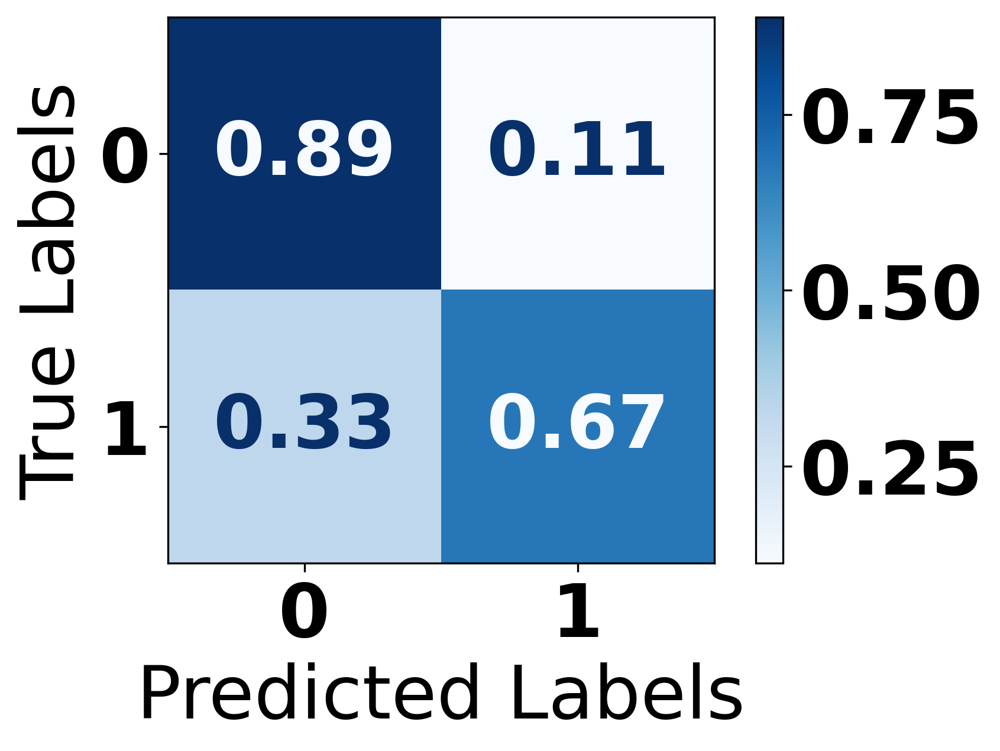

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94    109244
     Class 1       0.17      0.67      0.27      3708

    accuracy                           0.88    112952
   macro avg       0.58      0.78      0.60    112952
weighted avg       0.96      0.88      0.91    112952

Train Accuracy: 0.9097953506854759
Test Accuracy: 0.8813566824845952


In [ ]:
!pip install catboost

# Import necessary libraries
from catboost import CatBoostClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the CatBoost model
catboost = CatBoostClassifier(random_state=7, verbose=0)  # Set verbose to 0 to disable logging
catboost.fit(x_train, y_train)

# Predict on the test set
y_pred = catboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=catboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = catboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(catboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CatBoost.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CatBoost.pkl']

In [ ]:
import joblib

# Load the model from file
CatBoost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CatBoost.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:99: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/preprocessing/_label.py:134: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, dtype=self.classes_.dtype, warn=True)


[LightGBM] [Info] Number of positive: 107175, number of negative: 109244
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.151623 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 422
[LightGBM] [Info] Number of data points in the train set: 216419, number of used features: 43
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495220 -> initscore=-0.019121
[LightGBM] [Info] Start training from score -0.019121


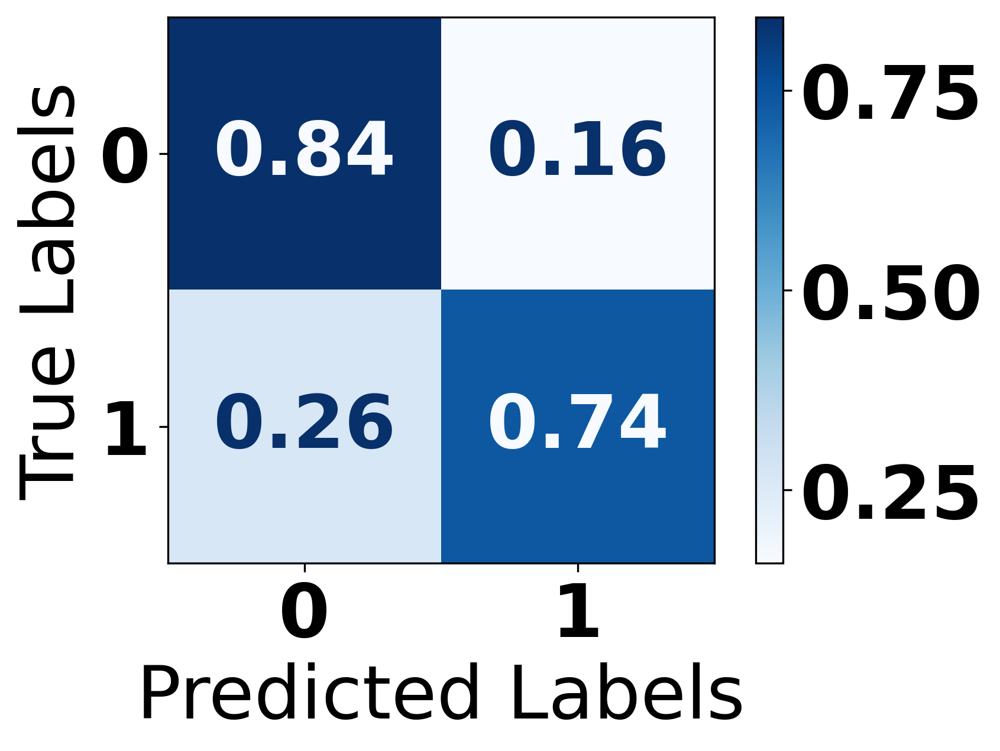

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91    109244
     Class 1       0.14      0.74      0.23      3708

    accuracy                           0.84    112952
   macro avg       0.56      0.79      0.57    112952
weighted avg       0.96      0.84      0.89    112952

Train Accuracy: 0.7927446296304853
Test Accuracy: 0.8379842765068347


In [ ]:
# Import necessary libraries
import lightgbm as lgb
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the LightGBM model
lgbm = lgb.LGBMClassifier(
    random_state=15,
    n_estimators=4,         # Number of boosting iterations
    learning_rate=0.1,        # Learning rate
    max_depth=15,              # Maximum tree depth for base learners
    num_leaves=13,            # Maximum number of leaves in one tree
    subsample=0.7,            # Subsample ratio of the training instances
    colsample_bytree=0.9      # Subsample ratio of columns when constructing each tree
)
lgbm.fit(x_train, y_train)

# Predict on the test set
y_pred = lgbm.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=lgbm.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = lgbm.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(lgbm, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LGBM.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LGBM.pkl']

In [ ]:
import joblib

# Load the model from file
LGBM = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LGBM.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_gb.py:437: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


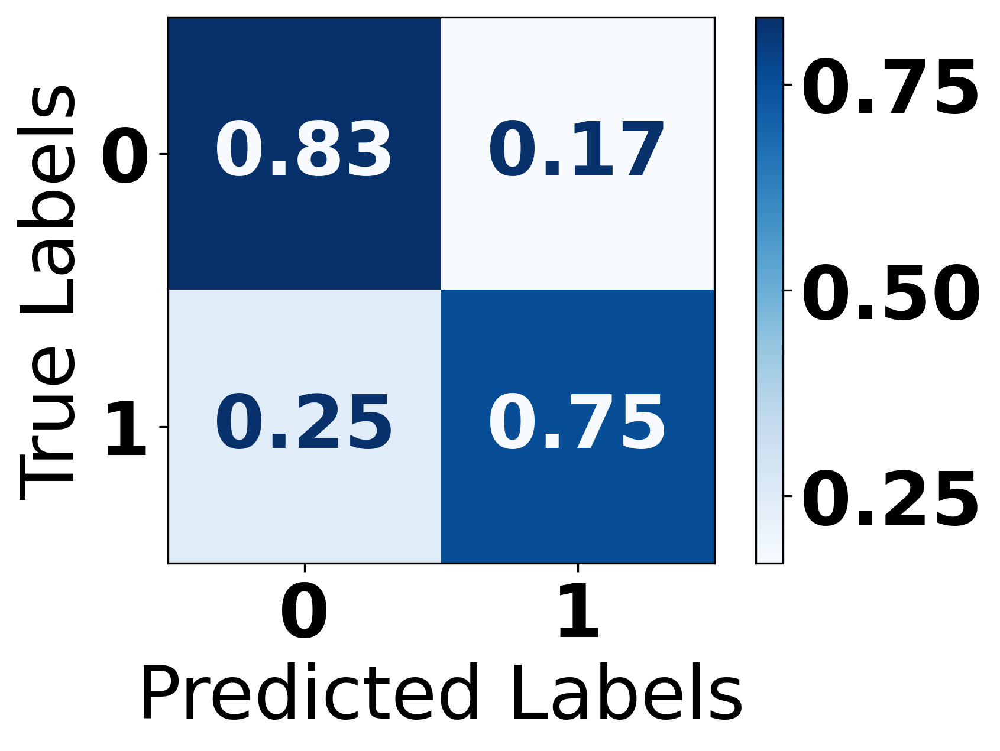

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90    109244
     Class 1       0.13      0.75      0.22      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.79      0.56    112952
weighted avg       0.96      0.83      0.88    112952

Train Accuracy: 0.7939413822261446
Test Accuracy: 0.8293168779658616


In [ ]:
# Import necessary libraries
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the Gradient Boosting Machine model
gbm = GradientBoostingClassifier(
    random_state=15,
    n_estimators=100,        # Number of boosting stages to be run
    learning_rate=0.1,       # Learning rate shrinks the contribution of each tree by learning_rate
    max_depth=1,             # Maximum depth of the individual regression estimators
    subsample=0.9,           # Fraction of samples used for fitting the individual base learners
    max_features='sqrt'      # Number of features to consider when looking for the best split
)
gbm.fit(x_train, y_train)

# Predict on the test set
y_pred = gbm.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=gbm.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = gbm.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(gbm, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GBM.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GBM.pkl']

In [ ]:
import joblib

# Load the model from file
GBM = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GBM.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/neighbors/_classification.py:215: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


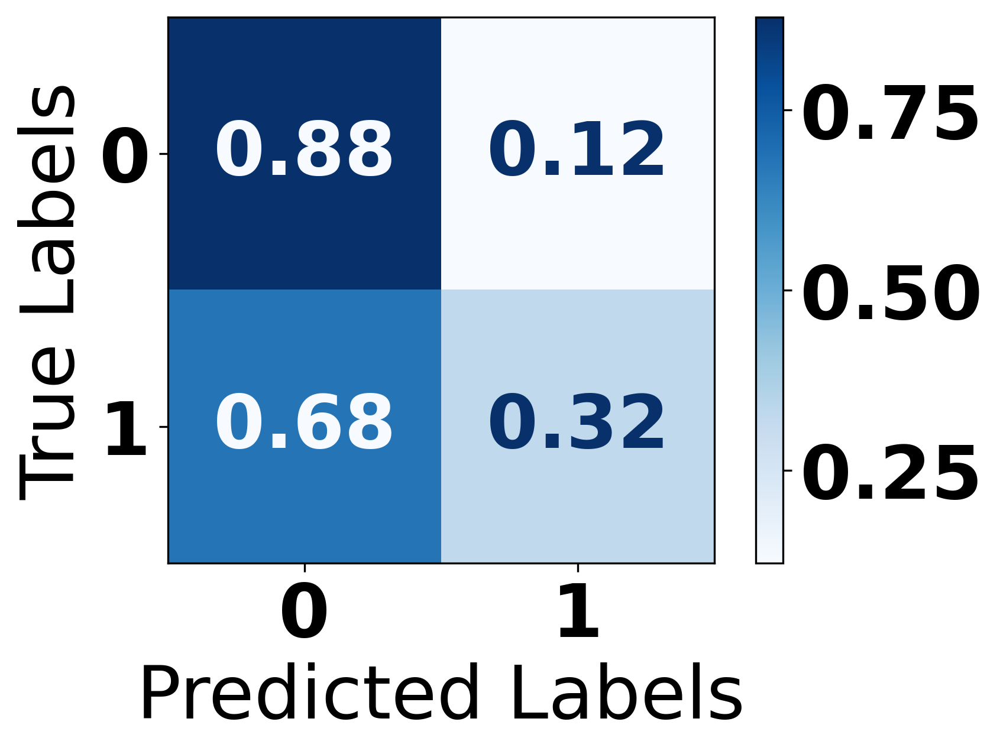

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.88      0.92    109244
     Class 1       0.08      0.32      0.13      3708

    accuracy                           0.86    112952
   macro avg       0.53      0.60      0.53    112952
weighted avg       0.95      0.86      0.90    112952

Train Accuracy: 0.9577486265069148
Test Accuracy: 0.8606399178412069


In [ ]:
# Import necessary libraries
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the k-NN model
knn = KNeighborsClassifier()
knn.fit(x_train, y_train)

# Predict on the test set
y_pred = knn.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=knn.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = knn.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(knn, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/KNN.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/KNN.pkl']

In [ ]:
import joblib

# Load the model from file
KNN = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/KNN.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


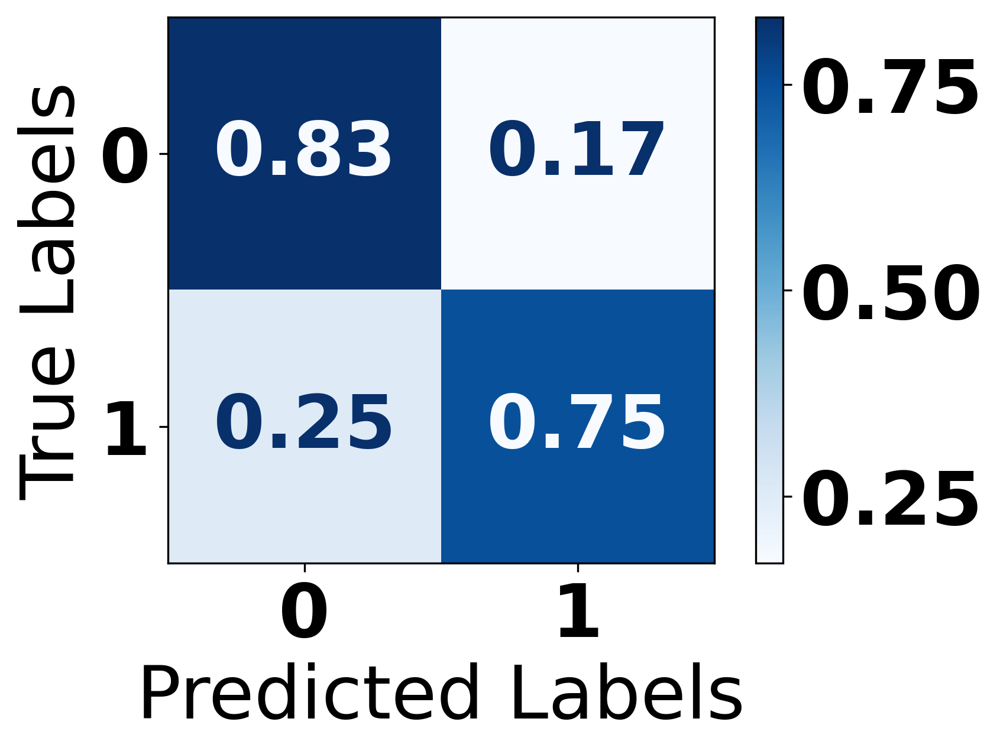

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90    109244
     Class 1       0.13      0.75      0.22      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.79      0.56    112952
weighted avg       0.96      0.83      0.88    112952

Train Accuracy: 0.7962609567551833
Test Accuracy: 0.8286440257808627


In [ ]:
# Import necessary libraries
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the Logistic Regression model
log_reg = LogisticRegression(
    random_state=15,
    solver='lbfgs',          # Algorithm to use in the optimization problem
    max_iter=500,           # Maximum number of iterations for solvers to converge
    C=1.5,                   # Inverse of regularization strength; must be a positive float
    penalty='l2',            # Used to specify the norm used in the penalization
    class_weight='balanced'  # Adjust weights inversely proportional to class frequencies
)
log_reg.fit(x_train, y_train)

# Predict on the test set
y_pred = log_reg.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=log_reg.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = log_reg.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(log_reg, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LR.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LR.pkl']

In [ ]:
import joblib

# Load the model from file
LR = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/LR.pkl')

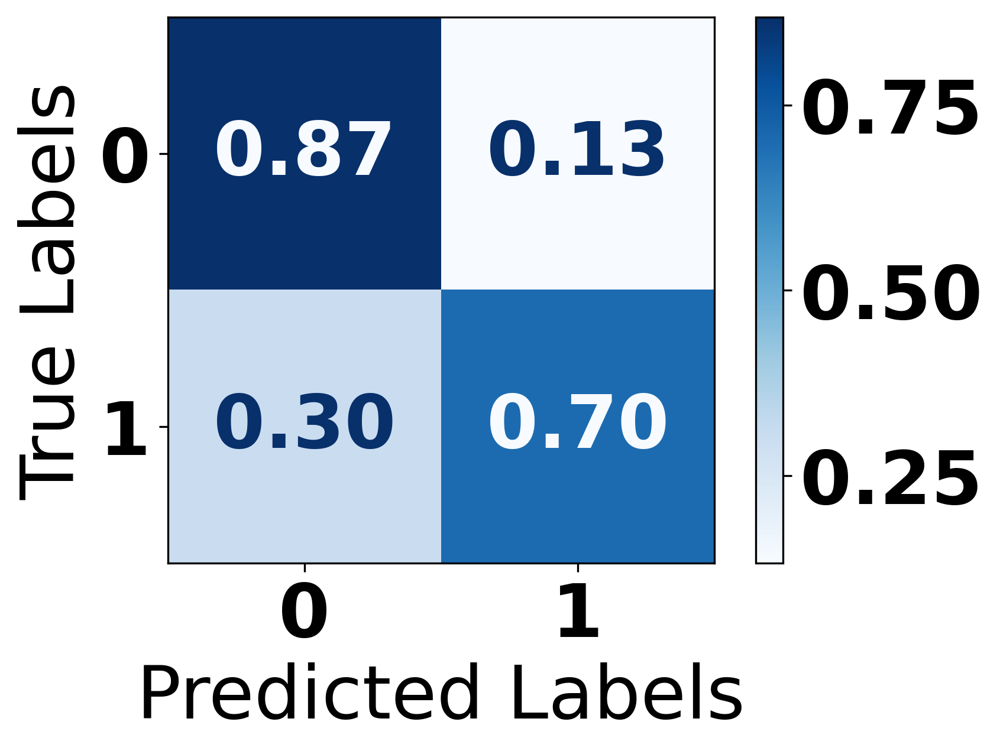

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.87      0.92    109244
     Class 1       0.15      0.70      0.25      3708

    accuracy                           0.86    112952
   macro avg       0.57      0.78      0.59    112952
weighted avg       0.96      0.86      0.90    112952

Train Accuracy: 0.8842892721988365
Test Accuracy: 0.8627735675331114


In [ ]:
# Import necessary libraries
from xgboost import XGBClassifier
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, accuracy_score
import matplotlib.pyplot as plt

# Create and fit the XGBoost Classifier
XGB = XGBClassifier(random_state=7)
XGB.fit(x_train, y_train)

# Predict on the test set
y_pred = XGB.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=XGB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = XGB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(XGB, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/XGB.pkl')
"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/XGB.pkl']

In [ ]:
import joblib

# Load the model from file
XGB = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/XGB.pkl')

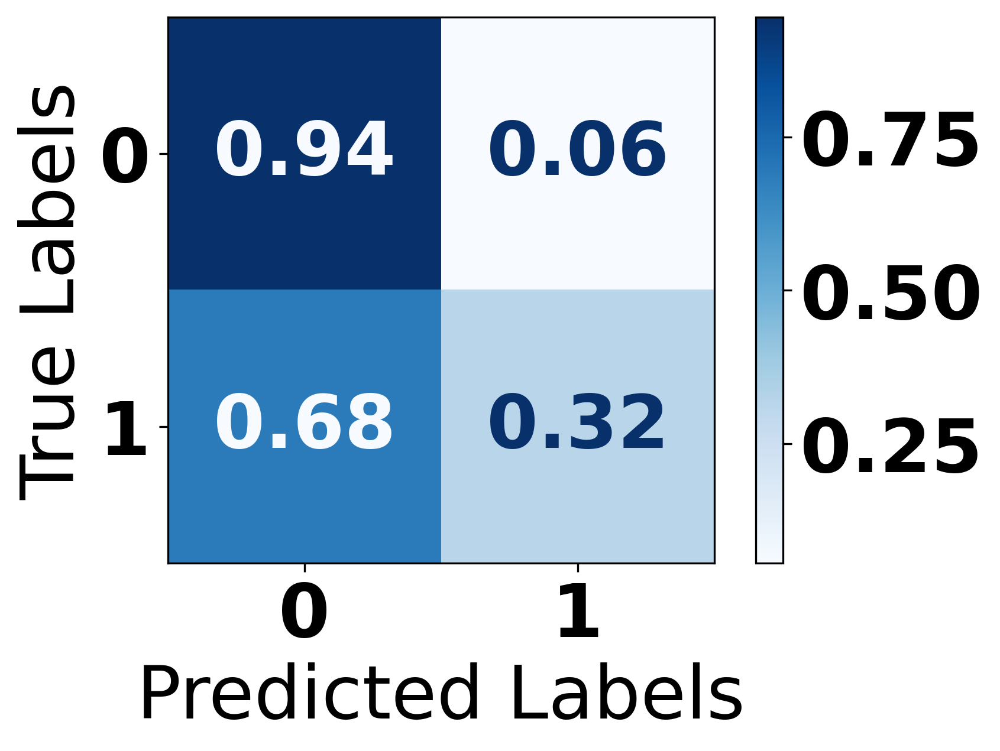

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96    109244
     Class 1       0.16      0.32      0.21      3708

    accuracy                           0.92    112952
   macro avg       0.57      0.63      0.59    112952
weighted avg       0.95      0.92      0.94    112952

Train Accuracy: 1.0
Test Accuracy: 0.9242244493236065


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(DT, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/DT.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/DT.pkl']

In [ ]:
import joblib

# Load the model from file
DT = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/DT.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


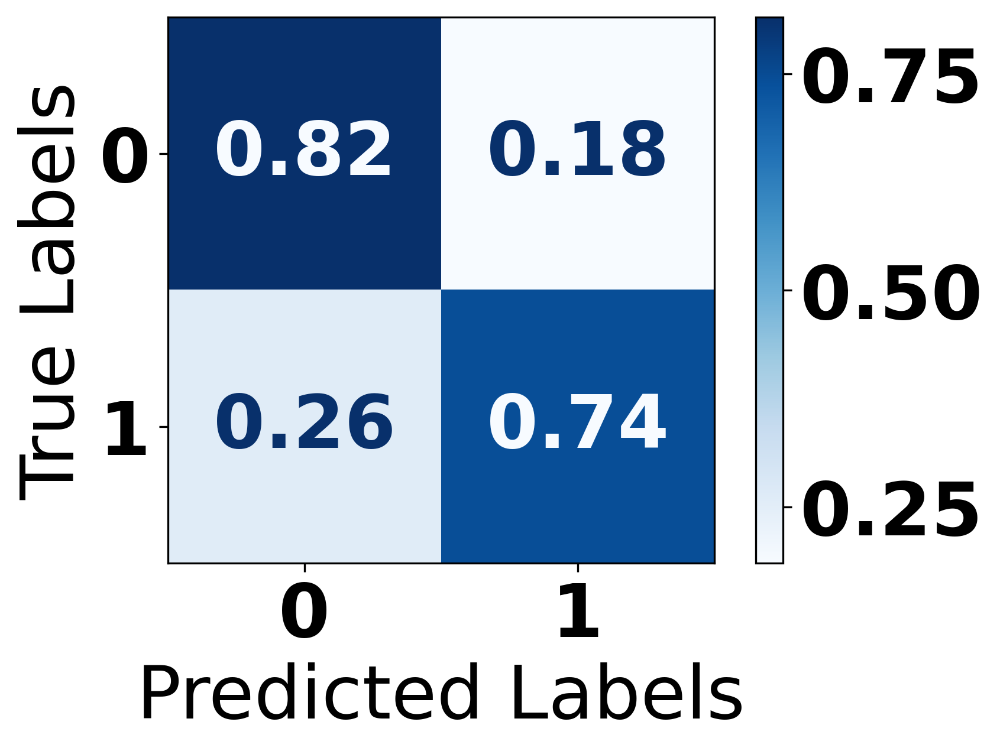

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.89    109244
     Class 1       0.12      0.74      0.21      3708

    accuracy                           0.81    112952
   macro avg       0.55      0.78      0.55    112952
weighted avg       0.96      0.81      0.87    112952

Train Accuracy: 0.7845937741141027
Test Accuracy: 0.8128142927969403


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(rusboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RUSBoost.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RUSBoost.pkl']

In [ ]:
import joblib

# Load the model from file
RUSBoost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RUSBoost.pkl')

<ipython-input-26-a4acf040c617>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


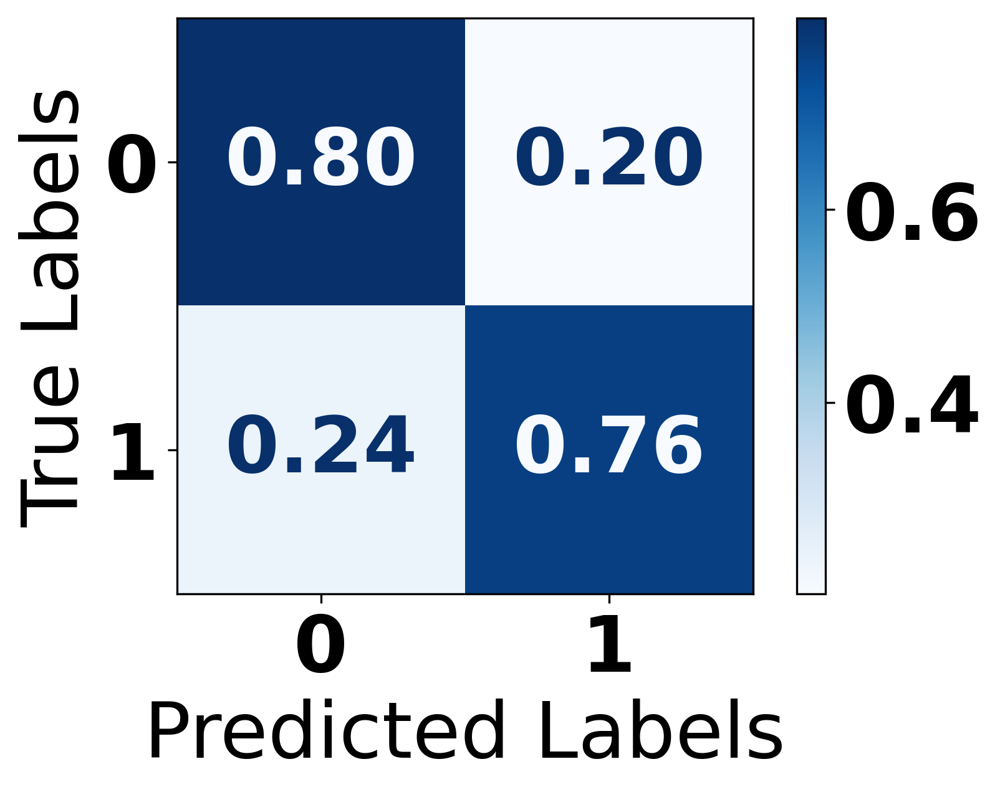

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.80      0.88    109244
           1       0.11      0.76      0.20      3708

    accuracy                           0.80    112952
   macro avg       0.55      0.78      0.54    112952
weighted avg       0.96      0.80      0.86    112952

Train Accuracy: 0.7823666129129143
Test Accuracy: 0.7971527728592677


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(RF, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RF.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RF.pkl']

In [ ]:
import joblib

# Load the model from file
RF = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RF.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


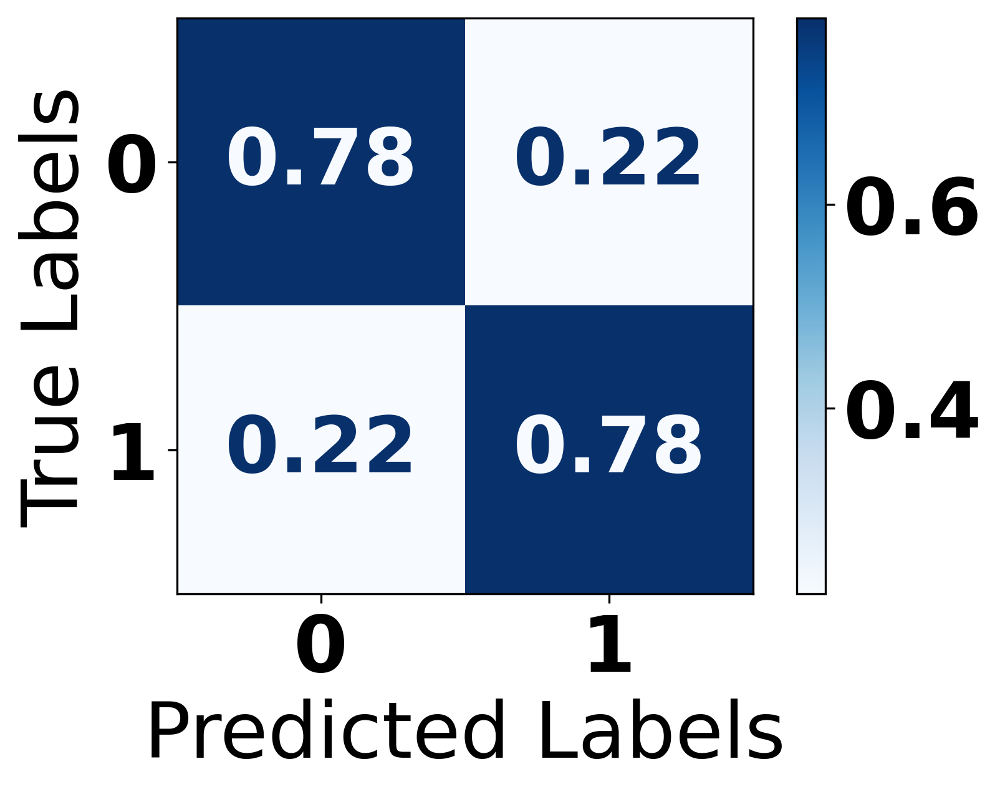

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.78      0.87    109244
           1       0.11      0.78      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.78      0.53    112952
weighted avg       0.96      0.78      0.85    112952

Train Accuracy: 0.7804397950272388
Test Accuracy: 0.7825182378355408


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(GNB, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GNB.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GNB.pkl']

In [ ]:
import joblib

# Load the model from file
GNB = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GNB.pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


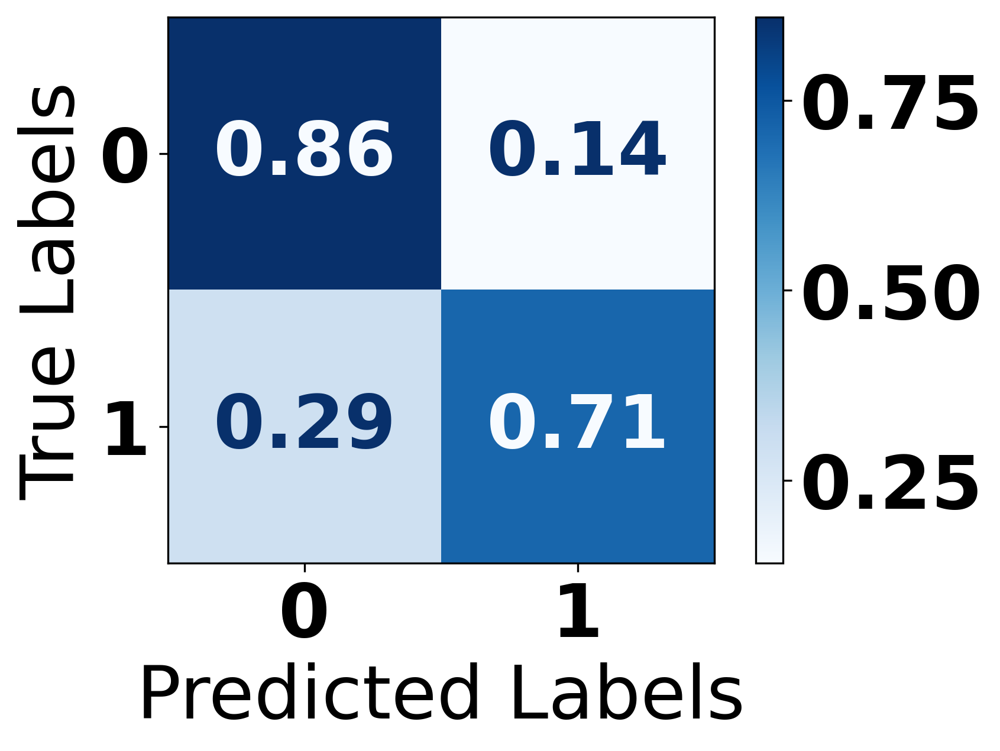

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.86      0.92    109244
           1       0.15      0.71      0.24      3708

    accuracy                           0.85    112952
   macro avg       0.57      0.78      0.58    112952
weighted avg       0.96      0.85      0.90    112952

Train Accuracy: 0.7903234004408116
Test Accuracy: 0.8545222749486507


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(Adaboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/AdaBoost.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/AdaBoost.pkl']

In [ ]:
import joblib

# Load the model from file
AdaBoost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/AdaBoost.pkl')

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.82160119 0.17839881]
 [0.23516721 0.76483279]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.90    109244
     Class 1       0.13      0.76      0.22      3708

    accuracy                           0.82    112952
   macro avg       0.56      0.79      0.56    112952
weighted avg       0.96      0.82      0.88    112952



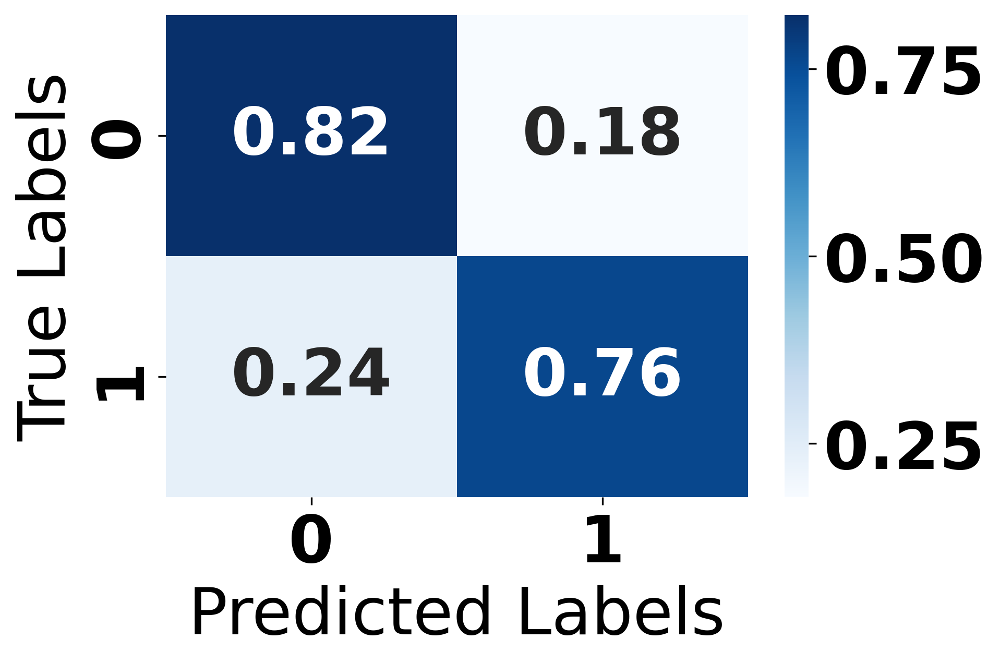

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(clf, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/MLP.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/MLP.pkl']

In [ ]:
import joblib

# Load the model from file
MLP = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/MLP.pkl')

### Deep Learning Models

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1691/1691 [==============================] - 63s 35ms/step - loss: 0.5800 - accuracy: 0.7171 - val_loss: 0.6992 - val_accuracy: 0.5873
Epoch 2/10
1691/1691 [==============================] - 38s 22ms/step - loss: 0.5089 - accuracy: 0.7504 - val_loss: 0.5003 - val_accuracy: 0.7323
Epoch 3/10
1691/1691 [==============================] - 39s 23ms/step - loss: 0.5004 - accuracy: 0.7567 - val_loss: 0.4744 - val_accuracy: 0.7408
Epoch 4/10
1691/1691 [==============================] - 44s 26ms/step - loss: 0.4949 - accuracy: 0.7606 - val_loss: 0.5676 - val_accuracy: 0.6840
Epoch 5/10
1691/1691 [==============================] - 39s 23ms/step - loss: 0.4907 - accuracy: 0.7620 - val_loss: 0.4669 - val_accuracy: 0.7428
Epoch 6/10
1691/1691 [==============================] - 39s 23ms/step - loss: 0.4856 - accuracy: 0.7652 - val_loss: 0.5470 - val_accuracy: 0.6872
Epoch 7/10
1691/1691 [==============================] - 42s 25ms/step - loss: 0.4775 - accuracy: 0.7696 - val_loss: 0.4730 -

In [ ]:
import time
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Define the input shape based on your data
input_shape = (x_train.shape[1], 1)  # Assuming your input data is 2D

# Input layer
input_layer = Input(shape=input_shape)

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the model
model.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 35s 12ms/step - loss: 0.5681 - accuracy: 0.7175 - val_loss: 0.5929 - val_accuracy: 0.6581
Epoch 2/20
1691/1691 [==============================] - 19s 11ms/step - loss: 0.5056 - accuracy: 0.7537 - val_loss: 0.5566 - val_accuracy: 0.6864
Epoch 3/20
1691/1691 [==============================] - 19s 11ms/step - loss: 0.4968 - accuracy: 0.7591 - val_loss: 0.5313 - val_accuracy: 0.7046
Epoch 4/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.4930 - accuracy: 0.7612 - val_loss: 0.4677 - val_accuracy: 0.7278
Epoch 5/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.4879 - accuracy: 0.7632 - val_loss: 0.5120 - val_accuracy: 0.7072
Epoch 6/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4830 - accuracy: 0.7644 - val_loss: 0.5138 - val_accuracy: 0.7091
Epoch 7/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.4748 - accuracy: 0.7686 - val_loss: 0.4591 - v

In [ ]:
# Assuming grownet_tabular_model is your trained model
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 43, 1)]              0         []                            
                                                                                                  
 conv1d (Conv1D)             (None, 43, 32)               128       ['input_1[0][0]']             
                                                                                                  
 max_pooling1d (MaxPooling1  (None, 21, 32)               0         ['conv1d[0][0]']              
 D)                                                                                               
                                                                                                  
 conv1d_1 (Conv1D)           (None, 21, 64)               6208      ['max_pooling1d[0][0]']   

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.73032844 0.26967156]
 [0.25080906 0.74919094]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.73      0.84    109244
     Class 1       0.09      0.75      0.15      3708

    accuracy                           0.73    112952
   macro avg       0.54      0.74      0.50    112952
weighted avg       0.96      0.73      0.82    112952



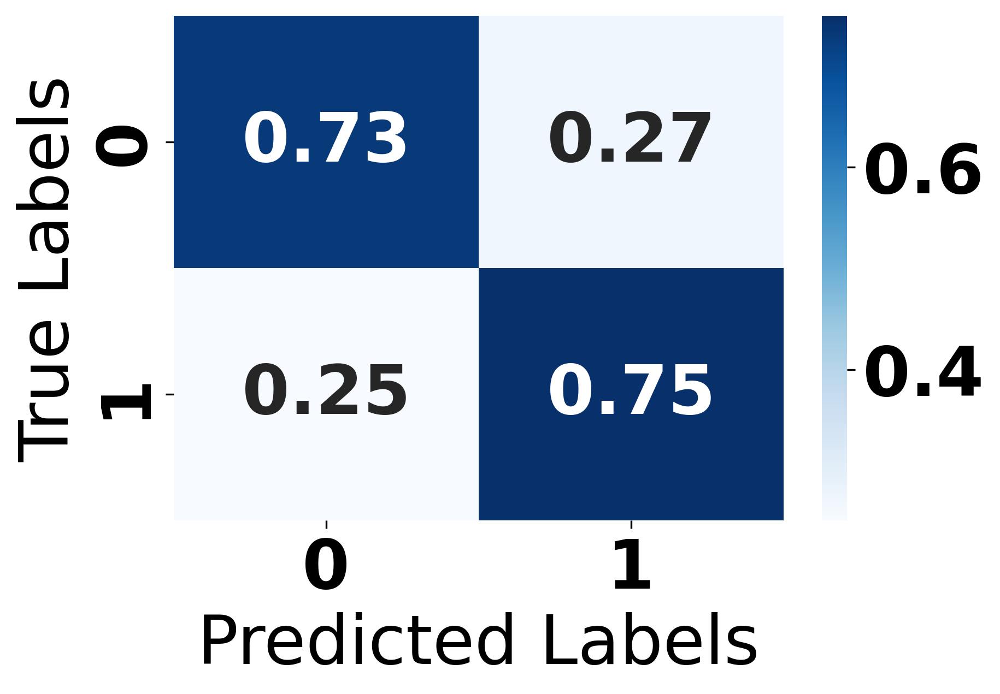

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CNN.h5')

"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
CNN = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CNN.h5')

6828/6828 [==============================] - 30s 4ms/step
Normalized Confusion Matrix:
[[0.73032844 0.26967156]
 [0.25161107 0.74838893]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.74      0.73      0.74    109244
     Class 1       0.74      0.75      0.74    109244

    accuracy                           0.74    218488
   macro avg       0.74      0.74      0.74    218488
weighted avg       0.74      0.74      0.74    218488



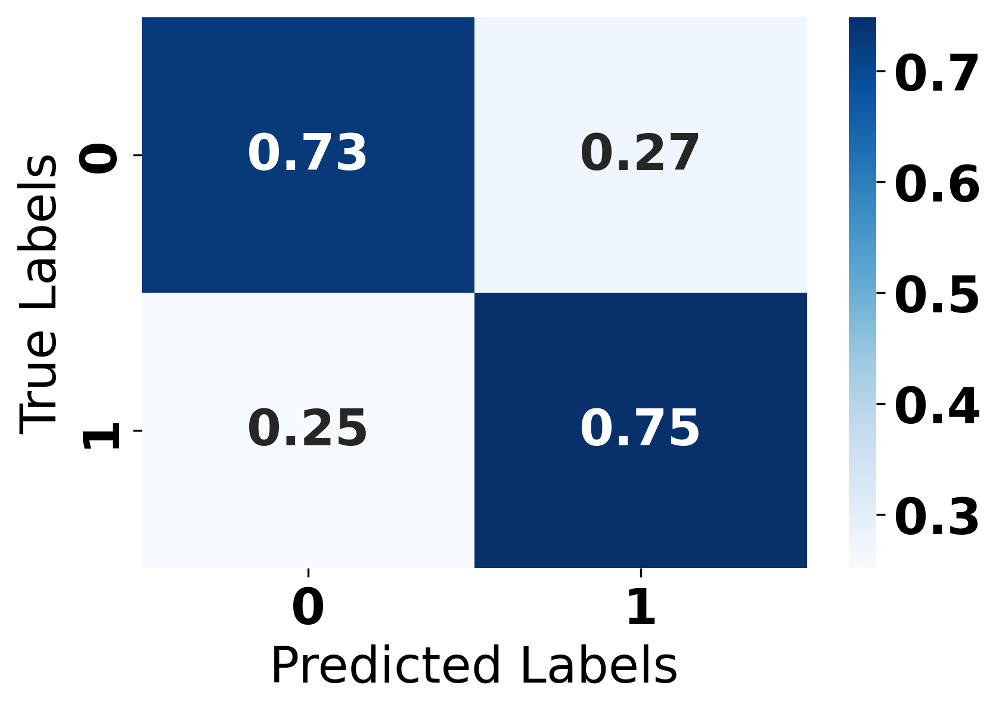

In [ ]:
# Predict probabilities on test data
y_pred_prob = CNN.predict(x_test_balanced)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test_balanced, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test_balanced, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(1024, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(512, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(256, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)
    dense3 = Dropout(0.5)(dense3)

    dense4 = Dense(128, activation='relu')(dense3)
    dense4 = BatchNormalization()(dense4)
    dense4 = Dropout(0.5)(dense4)

    dense5 = Dense(64, activation='relu')(dense4)
    dense5 = BatchNormalization()(dense5)

    output = Dense(1, activation='sigmoid')(dense5)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the even more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the even more complex ANN model
ANN_model.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the even more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 22s 10ms/step - loss: 0.5049 - accuracy: 0.7480 - val_loss: 0.6283 - val_accuracy: 0.6696
Epoch 2/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4452 - accuracy: 0.7910 - val_loss: 0.2876 - val_accuracy: 0.9469
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4379 - accuracy: 0.7944 - val_loss: 0.2374 - val_accuracy: 0.9350
Epoch 4/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4344 - accuracy: 0.7958 - val_loss: 0.3856 - val_accuracy: 0.8546
Epoch 5/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4322 - accuracy: 0.7965 - val_loss: 0.3851 - val_accuracy: 0.8640
Epoch 6/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4320 - accuracy: 0.7966 - val_loss: 0.4181 - val_accuracy: 0.8212
Epoch 7/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4301 - accuracy: 0.7979 - val_loss: 0.3107 - val_a

In [ ]:
# Assuming grownet_tabular_model is your trained model
ANN_model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 43)]              0         
                                                                 
 dense_3 (Dense)             (None, 1024)              45056     
                                                                 
 batch_normalization (Batch  (None, 1024)              4096      
 Normalization)                                                  
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_4 (Dense)             (None, 512)               524800    
                                                                 
 batch_normalization_1 (Bat  (None, 512)               2048      
 chNormalization)                                          

In [ ]:
"""
# Save the model to a file
ANN_model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/ANN(Base).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
ANN_Base = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/ANN(Base).h5')

In [ ]:
import time
from keras.models import load_model

start_time = time.time()

# Load your Deep Learning model here using Keras
model = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/ANN(Base).h5')

end_time = time.time()
elapsed_time = end_time - start_time
print(f"Elapsed time for loading the model: {elapsed_time} seconds")

Elapsed time for loading the model: 0.6778361797332764 seconds


3530/3530 [==============================] - 27s 8ms/step
Normalized Confusion Matrix:
[[0.82503387 0.17496613]
 [0.25107875 0.74892125]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90    109244
     Class 1       0.13      0.75      0.22      3708

    accuracy                           0.82    112952
   macro avg       0.56      0.79      0.56    112952
weighted avg       0.96      0.82      0.88    112952



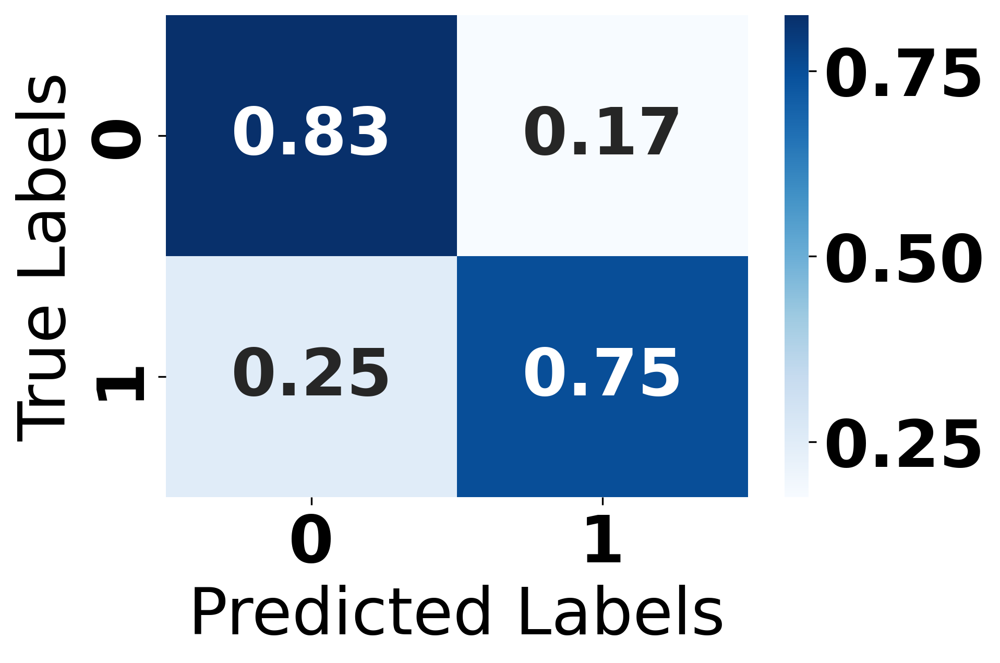

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_Base.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.58
y_pred = np.where(y_pred_prob > 0.65, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.58)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Attention CNN

In [ ]:
import time
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add, Multiply, GlobalAveragePooling1D, Reshape

# Define the input shape based on your data
input_shape = (x_train.shape[1], 1)  # Assuming your input data is 2D

# Input layer
input_layer = Input(shape=input_shape)

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Attention mechanism
def attention_layer(inputs):
    # Global Average Pooling
    gap = GlobalAveragePooling1D()(inputs)
    # Reshape to match input shape
    gap = Reshape((1, inputs.shape[-1]))(gap)
    # Dense layer with sigmoid activation for attention weights
    attention_weights = Dense(inputs.shape[-1], activation='sigmoid')(gap)
    # Multiply the inputs by the attention weights
    attention_output = Multiply()([inputs, attention_weights])
    return attention_output

attention_output = attention_layer(pool2)

# Flatten layer
flatten = Flatten()(attention_output)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the model
model.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 24s 9ms/step - accuracy: 0.6787 - loss: 0.6885 - val_accuracy: 0.7212 - val_loss: 0.5048
Epoch 2/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7551 - loss: 0.5033 - val_accuracy: 0.6131 - val_loss: 0.6891
Epoch 3/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7567 - loss: 0.5003 - val_accuracy: 0.7369 - val_loss: 0.4884
Epoch 4/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 7s 3ms/step - accuracy: 0.7611 - loss: 0.4939 - val_accuracy: 0.7133 - val_loss: 0.5017
Epoch 5/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7622 - loss: 0.4910 - val_accuracy: 0.7299 - val_loss: 0.4684
Epoch 6/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.7669 - loss: 0.4841 - val_accuracy: 0.7227 - val_loss: 0.5117
Epoch 7/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7709 - loss: 0.4753 - val_accuracy: 0.7305 - val_loss: 0.4618
Epoch 8/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 6s 3ms/step - accuracy: 0.7768 - loss: 0.4644 -

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step
Normalized Confusion Matrix:
[[0.80381531 0.19618469]
 [0.40803668 0.59196332]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88    109244
     Class 1       0.09      0.59      0.16      3708

    accuracy                           0.80    112952
   macro avg       0.54      0.70      0.52    112952
weighted avg       0.95      0.80      0.86    112952



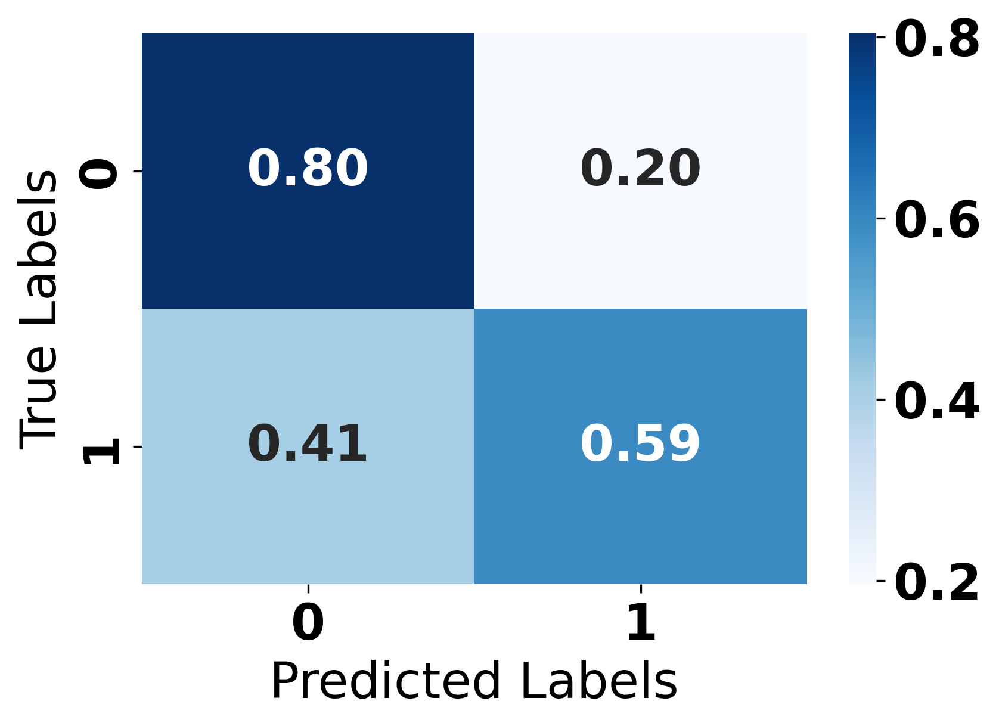

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CNN-attention.h5')
"""

In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
AttentionCNN = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CNN-attention.h5')

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 22s 6ms/step
Normalized Confusion Matrix:
[[0.80381531 0.19618469]
 [0.40803668 0.59196332]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88    109244
     Class 1       0.09      0.59      0.16      3708

    accuracy                           0.80    112952
   macro avg       0.54      0.70      0.52    112952
weighted avg       0.95      0.80      0.86    112952



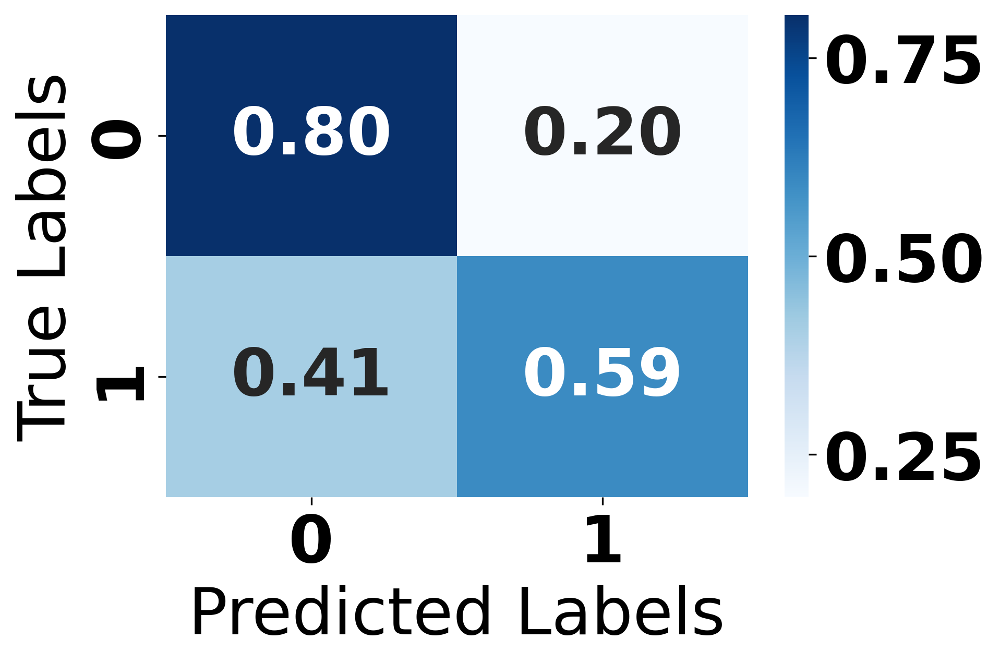

In [ ]:
# Predict probabilities on test data
y_pred_prob = AttentionCNN.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
# Assuming grownet_tabular_model is your trained model
model.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_5             │ (None, 43, 1)          │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d (Conv1D)           │ (None, 43, 32)         │            128 │ input_layer_5[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d             │ (None, 21, 32)         │              0 │ conv1d[0][0]           │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_1 (Conv1D)         │ (None, 21, 64)         │          6,208 │ max_pooling1d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_3 (Conv1D)         │ (None, 21, 64)         │          2,112 │ max_pooling1d[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1d_2 (Conv1D)         │ (None, 21, 64)         │         12,352 │ conv1d_1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_3 (Add)               │ (None, 21, 64)         │              0 │ conv1d_3[0][0],        │
│                           │                        │                │ conv1d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling1d_1           │ (None, 10, 64)         │              0 │ add_3[0][0]            │
│ (MaxPooling1D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling1d  │ (None, 64)             │              0 │ max_pooling1d_1[0][0]  │
│ (GlobalAveragePooling1D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ reshape (Reshape)         │ (None, 1, 64)          │              0 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_36 (Dense)          │ (None, 1, 64)          │          4,160 │ reshape[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ multiply_5 (Multiply)     │ (None, 10, 64)         │              0 │ max_pooling1d_1[0][0], │
│                           │                        │                │ dense_36[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ flatten (Flatten)         │ (None, 640)            │              0 │ multiply_5[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_37 (Dense)          │ (None, 128)            │         82,048 │ flatten[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_38 (Dense)          │ (None, 64)             │          8,256 │ dense_37[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_39 (Dense)          │ (None, 1)              │             65 │ dense_38[0][0]         │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 345,989 (1.32 MB)

 Trainable params: 115,329 (450.50 KB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 230,660 (901.02 KB)

### Transformer

In [ ]:
from tensorflow.keras.layers import Input, Dense, Dropout, LayerNormalization, Embedding, GlobalAveragePooling1D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
import time

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def create_simple_transformer_model(input_shape, vocab_size, embed_dim, ff_dim):
    # Input layer
    inputs = Input(shape=input_shape)

    # Embedding layer
    x = Embedding(input_dim=vocab_size, output_dim=embed_dim, input_length=input_shape[0])(inputs)

    # Feed-forward network
    x = Dense(ff_dim, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = LayerNormalization(epsilon=1e-6)(x)

    # Another feed-forward layer
    x = Dense(ff_dim // 2, activation='relu')(x)
    x = Dropout(0.1)(x)
    x = LayerNormalization(epsilon=1e-6)(x)

    # Global average pooling
    x = GlobalAveragePooling1D()(x)

    # Dense layers
    x = Dense(128, activation='relu')(x)
    x = Dropout(0.5)(x)
    x = Dense(64, activation='relu')(x)

    # Output layer
    outputs = Dense(1, activation='sigmoid')(x)

    # Create the model
    model = Model(inputs=inputs, outputs=outputs)
    return model

# Define model parameters
vocab_size = 20000  # This should be set according to your dataset
embed_dim = 128  # Embedding size for each token
ff_dim = 128  # Hidden layer size in the feed-forward network

# Create the Transformer model
simple_transformer_model = create_simple_transformer_model(input_shape, vocab_size, embed_dim, ff_dim)

# Compile the model
simple_transformer_model.compile(loss='binary_crossentropy', optimizer=Adam(learning_rate=1e-4), metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the Transformer model
simple_transformer_model.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the Transformer model
loss, accuracy = simple_transformer_model.evaluate(x_test, y_test)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 31s 12ms/step - accuracy: 0.6781 - loss: 0.6029 - val_accuracy: 0.7071 - val_loss: 0.5614
Epoch 2/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 23s 5ms/step - accuracy: 0.7017 - loss: 0.5769 - val_accuracy: 0.7001 - val_loss: 0.5665
Epoch 3/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 9s 4ms/step - accuracy: 0.7064 - loss: 0.5720 - val_accuracy: 0.6851 - val_loss: 0.5758
Epoch 4/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.7069 - loss: 0.5719 - val_accuracy: 0.7251 - val_loss: 0.5264
Epoch 5/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7075 - loss: 0.5698 - val_accuracy: 0.7011 - val_loss: 0.5485
Epoch 6/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.7086 - loss: 0.5696 - val_accuracy: 0.6908 - val_loss: 0.5532
Epoch 7/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 7s 4ms/step - accuracy: 0.7071 - loss: 0.5697 - val_accuracy: 0.6937 - val_loss: 0.5580
Epoch 8/20
1691/1691 ━━━━━━━━━━━━━━━━━━━━ 6s 4ms/step - accuracy: 0.7082 - loss: 0.5690

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 10s 3ms/step
Normalized Confusion Matrix:
[[0.68887994 0.31112006]
 [0.27427184 0.72572816]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.69      0.81    109244
     Class 1       0.07      0.73      0.13      3708

    accuracy                           0.69    112952
   macro avg       0.53      0.71      0.47    112952
weighted avg       0.96      0.69      0.79    112952



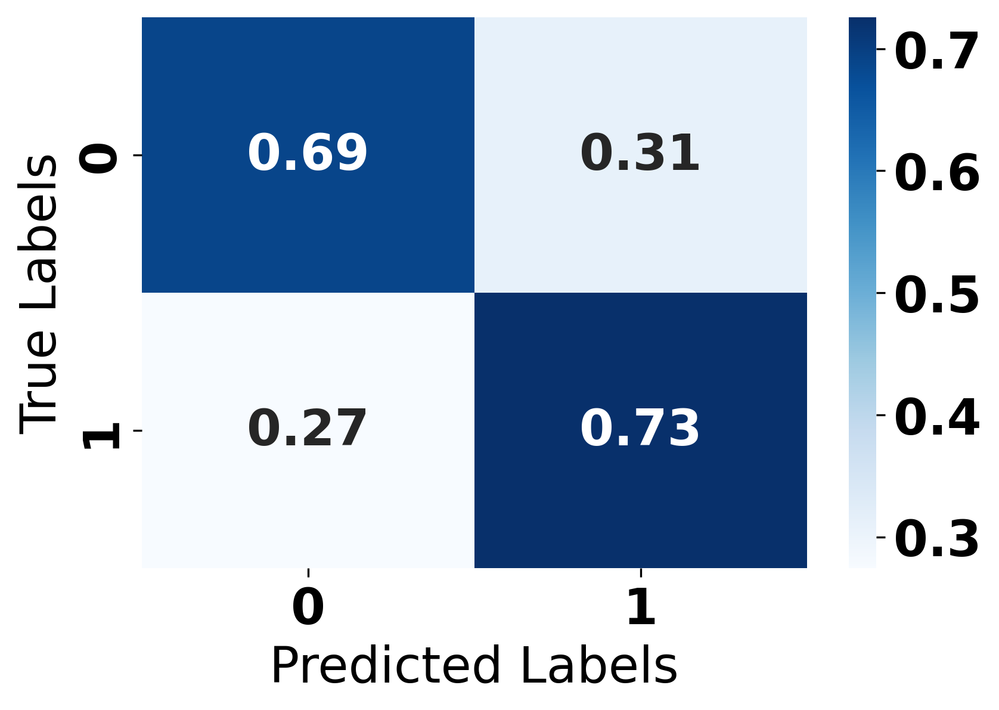

In [ ]:
# Predict probabilities on test data
y_pred_prob = simple_transformer_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
simple_transformer_model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/transformer_model.h5')
"""

In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
transformer_model = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/transformer_model.h5')

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 42s 12ms/step
Normalized Confusion Matrix:
[[0.68887994 0.31112006]
 [0.27427184 0.72572816]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.69      0.81    109244
     Class 1       0.07      0.73      0.13      3708

    accuracy                           0.69    112952
   macro avg       0.53      0.71      0.47    112952
weighted avg       0.96      0.69      0.79    112952



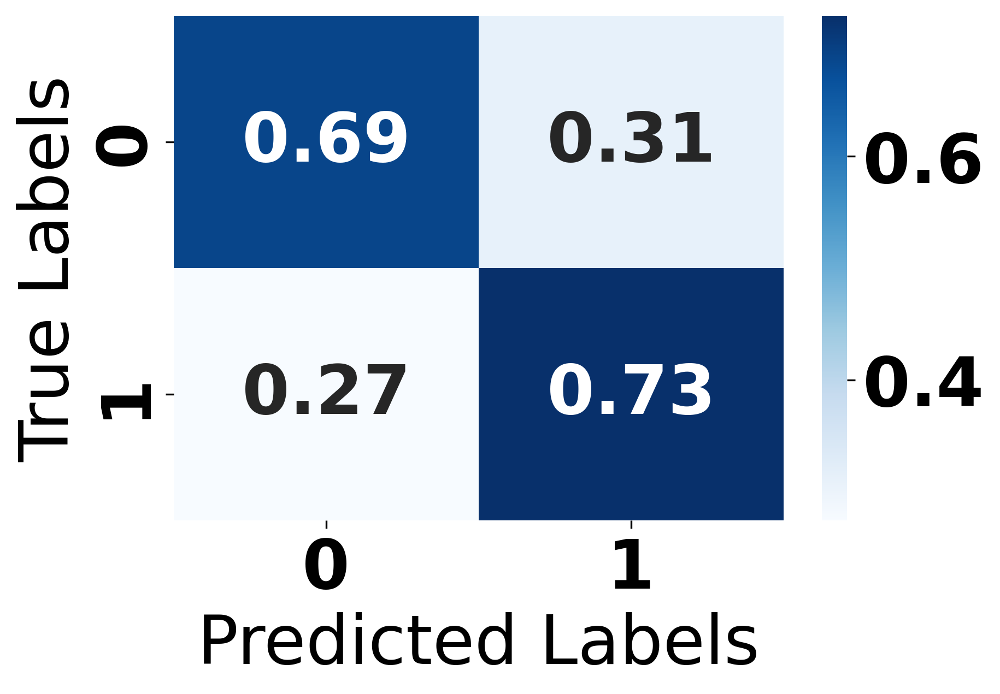

In [ ]:
# Predict probabilities on test data
y_pred_prob = transformer_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
# Assuming grownet_tabular_model is your trained model
simple_transformer_model.summary()

Model: "functional_5"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_7 (InputLayer)           │ (None, 43)                  │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ embedding_1 (Embedding)              │ (None, 43, 128)             │       2,560,000 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_42 (Dense)                     │ (None, 43, 128)             │          16,512 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_25 (Dropout)                 │ (None, 43, 128)             │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ layer_normalization_2                │ (None, 43, 128)             │             256 │
│ (LayerNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_43 (Dense)                     │ (None, 43, 64)              │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_26 (Dropout)                 │ (None, 43, 64)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ layer_normalization_3                │ (None, 43, 64)              │             128 │
│ (LayerNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling1d_2           │ (None, 64)                  │               0 │
│ (GlobalAveragePooling1D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_44 (Dense)                     │ (None, 128)                 │           8,320 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_27 (Dropout)                 │ (None, 128)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_45 (Dense)                     │ (None, 64)                  │           8,256 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_46 (Dense)                     │ (None, 1)                   │              65 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,805,381 (29.78 MB)

 Trainable params: 2,601,793 (9.93 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 5,203,588 (19.85 MB)

### Proposed Dual-Path ANN

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_test, y_test)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 32s 12ms/step - loss: 0.4950 - accuracy: 0.7607 - val_loss: 0.4584 - val_accuracy: 0.8133
Epoch 2/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4450 - accuracy: 0.7920 - val_loss: 0.5517 - val_accuracy: 0.7319
Epoch 3/20
1691/1691 [==============================] - 24s 14ms/step - loss: 0.4403 - accuracy: 0.7943 - val_loss: 0.6752 - val_accuracy: 0.6249
Epoch 4/20
1691/1691 [==============================] - 23s 14ms/step - loss: 0.4360 - accuracy: 0.7957 - val_loss: 0.4150 - val_accuracy: 0.8258
Epoch 5/20
1691/1691 [==============================] - 18s 11ms/step - loss: 0.4333 - accuracy: 0.7960 - val_loss: 0.3415 - val_accuracy: 0.8767
Epoch 6/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4315 - accuracy: 0.7969 - val_loss: 0.3854 - val_accuracy: 0.8277
Epoch 7/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4313 - accuracy: 0.7974 - val_loss: 0.5626 - va

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.79608949 0.20391051]
 [0.20361381 0.79638619]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.80      0.88    109244
     Class 1       0.12      0.80      0.20      3708

    accuracy                           0.80    112952
   macro avg       0.55      0.80      0.54    112952
weighted avg       0.96      0.80      0.86    112952



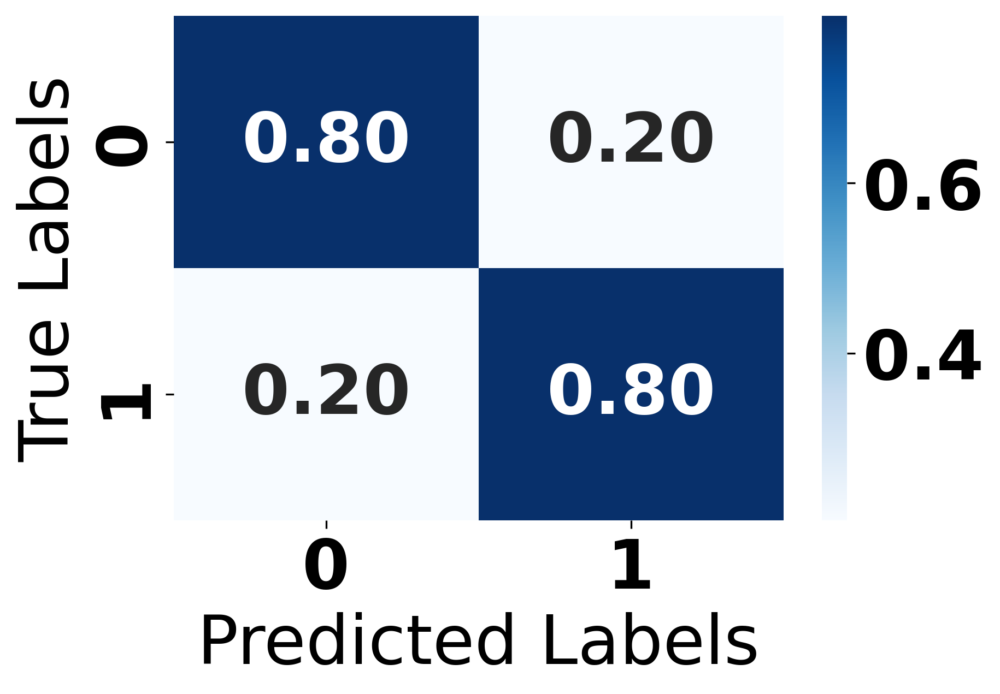

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.56
y_pred = np.where(y_pred_prob > 0.56, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.56)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/Novel_ANN.h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
dual-path_ANN = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/Novel_ANN.h5')

In [ ]:
# Assuming grownet_tabular_model is your trained model
dual-path_ANN.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 43)]                 0         []                            
                                                                                                  
 dense_12 (Dense)            (None, 256)                  11264     ['input_4[0][0]']             
                                                                                                  
 batch_normalization_9 (Bat  (None, 256)                  1024      ['dense_12[0][0]']            
 chNormalization)                                                                                 
                                                                                                  
 dropout_6 (Dropout)         (None, 256)                  0         ['batch_normalization_9[

In [ ]:
import time
from keras.models import load_model

start_time = time.time()

# Load your Deep Learning model here using Keras
dual-path_ANN = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/Novel_ANN.h5')

end_time = time.time()
elapsed_time = end_time - start_time
print(f"Elapsed time for loading the model: {elapsed_time} seconds")

Elapsed time for loading the model: 0.33150672912597656 seconds


### Cross testing using BRFSS 2019

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but DecisionTreeClassifier was fitted without feature names
  warnings.warn(


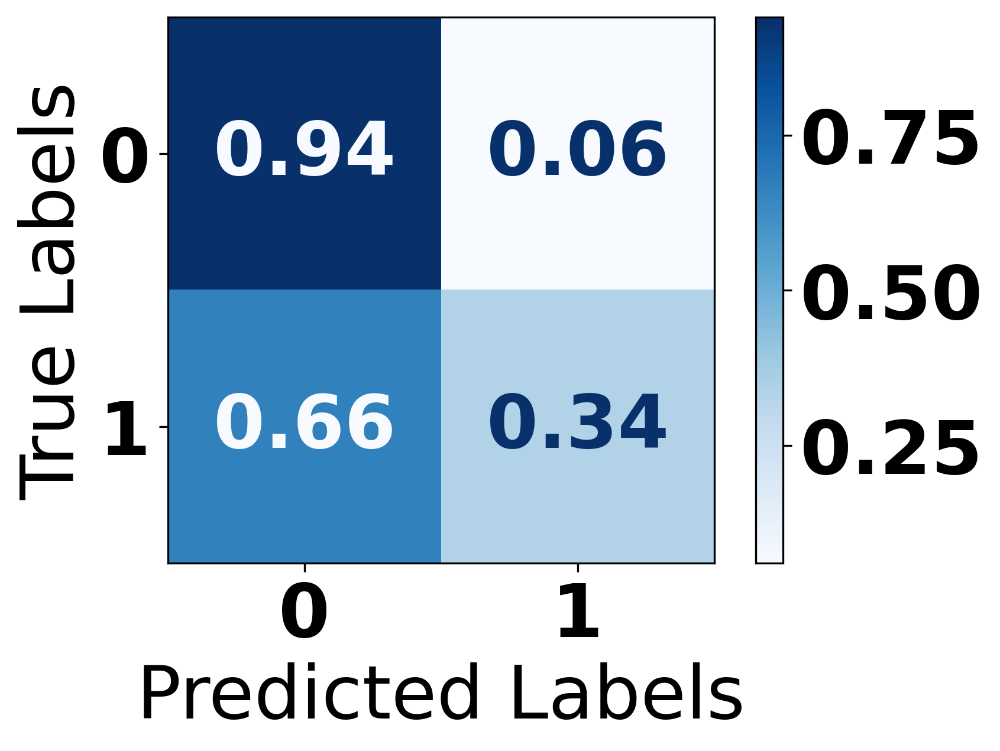

In [ ]:
# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but RUSBoostClassifier was fitted without feature names
  warnings.warn(


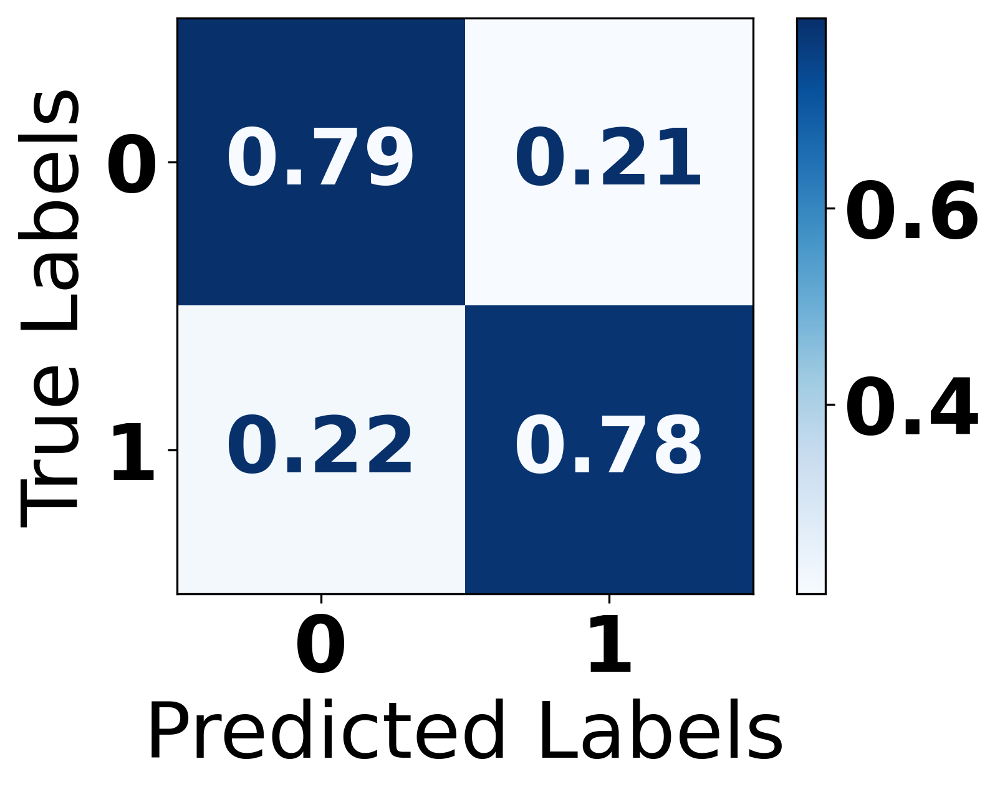

In [ ]:
# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

<ipython-input-70-dd446fbd0acb>:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but RandomForestClassifier was fitted without feature names
  warnings.warn(


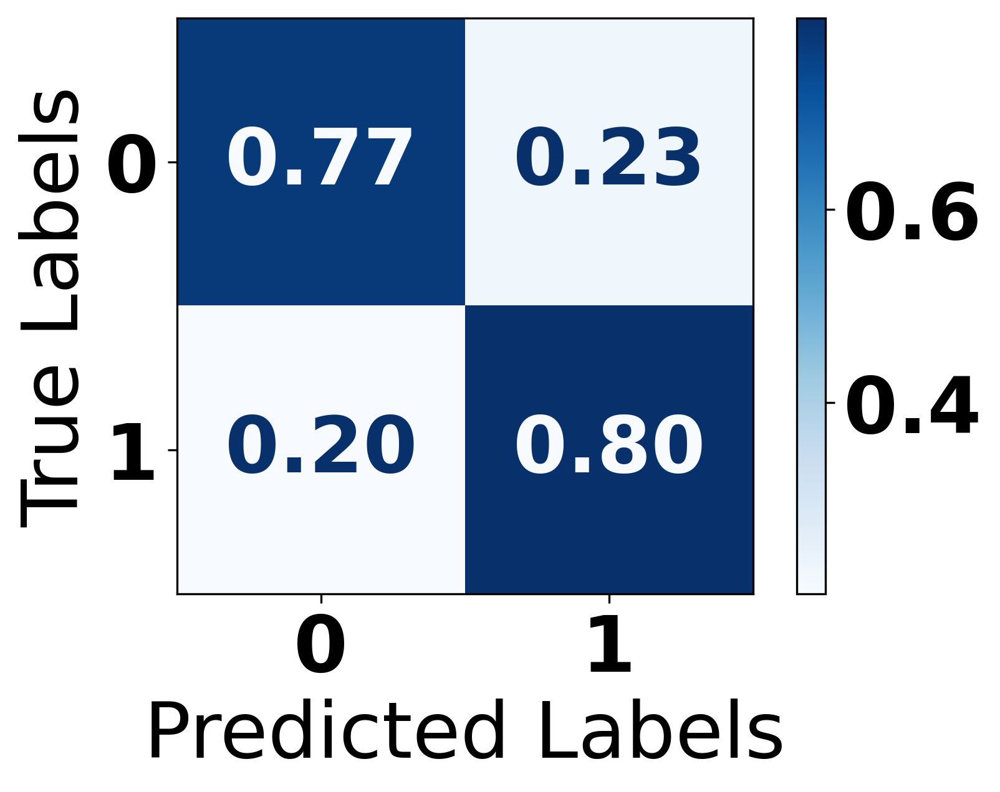

In [ ]:
# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but GaussianNB was fitted without feature names
  warnings.warn(


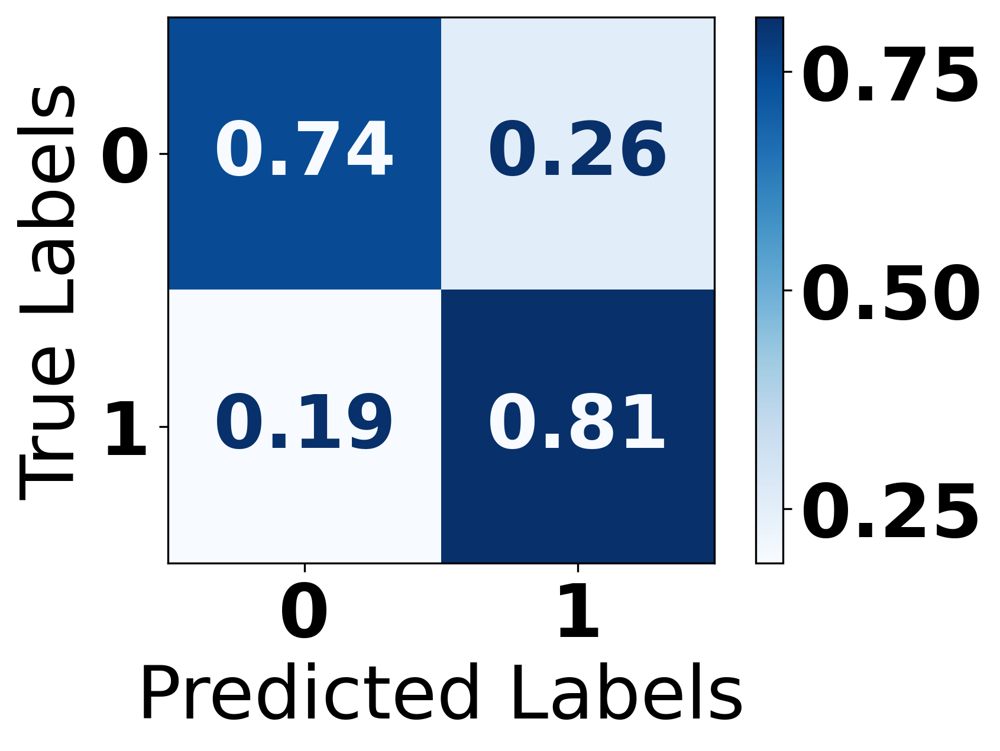

In [ ]:
# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but AdaBoostClassifier was fitted without feature names
  warnings.warn(


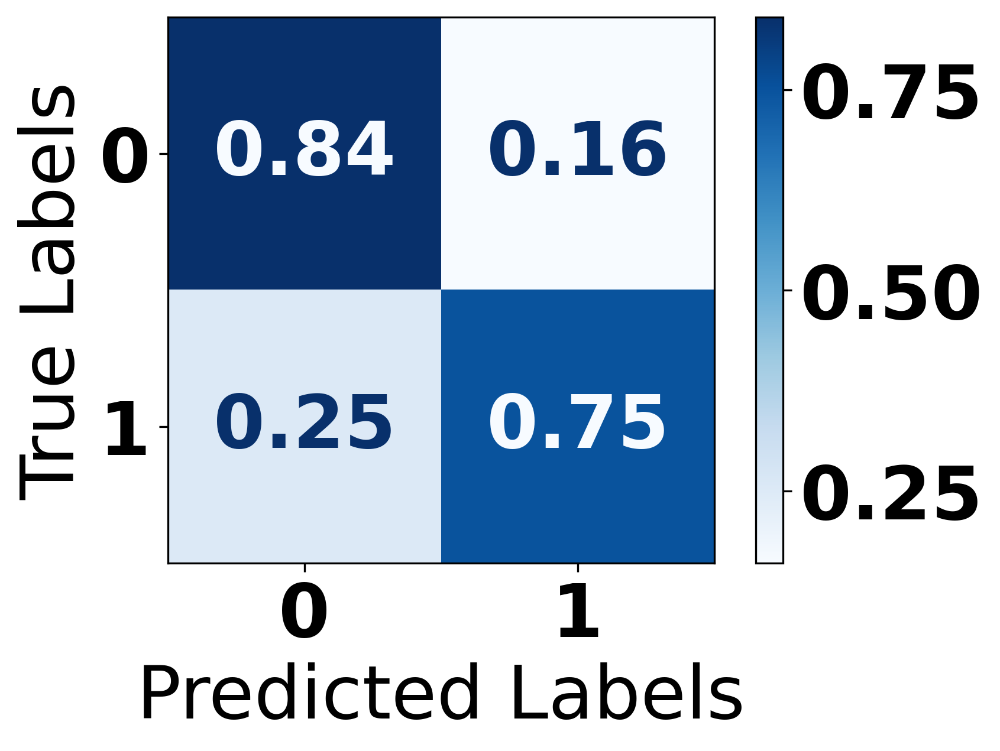

In [ ]:
# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but MLPClassifier was fitted without feature names
  warnings.warn(


Normalized Confusion Matrix:
[[0.80125222 0.19874778]
 [0.19717896 0.80282104]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88     52866
     Class 1       0.21      0.80      0.33      3403

    accuracy                           0.80     56269
   macro avg       0.60      0.80      0.61     56269
weighted avg       0.94      0.80      0.85     56269



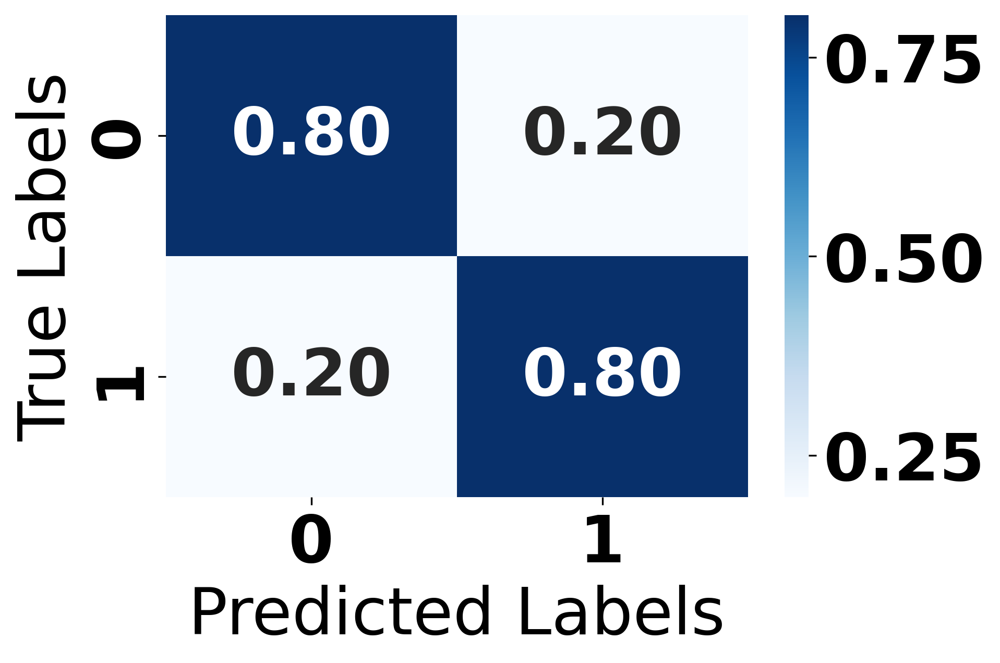

In [ ]:
# Predict probabilities on test data
y_pred_prob = MLP.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

1759/1759 [==============================] - 8s 4ms/step
Normalized Confusion Matrix:
[[0.71480725 0.28519275]
 [0.24213929 0.75786071]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.71      0.83     52866
     Class 1       0.15      0.76      0.24      3403

    accuracy                           0.72     56269
   macro avg       0.56      0.74      0.54     56269
weighted avg       0.93      0.72      0.79     56269



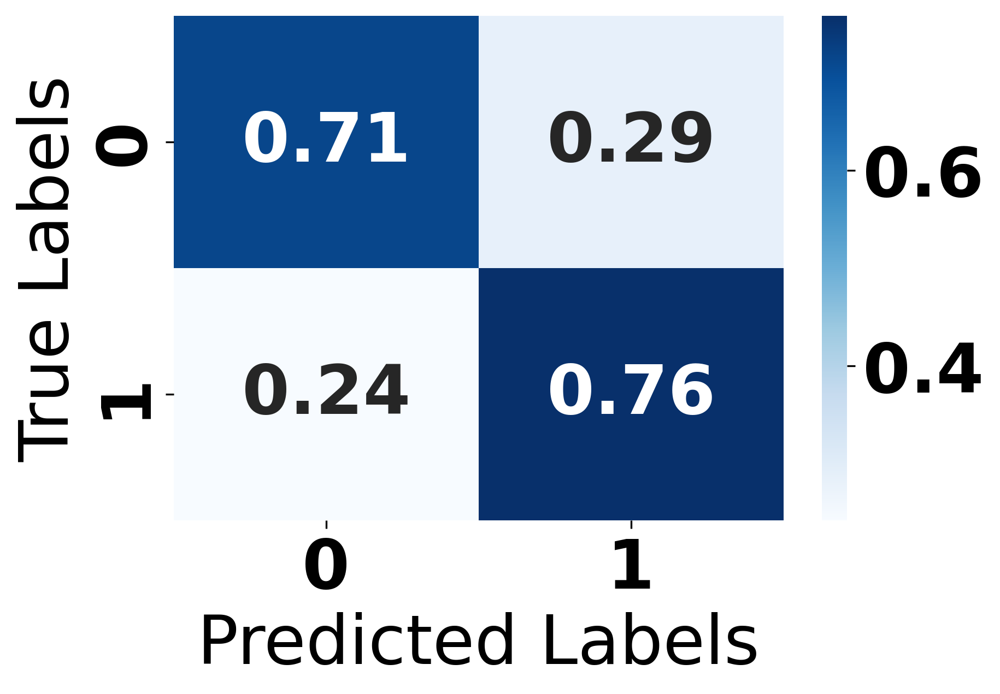

In [ ]:
# Predict probabilities on test data
y_pred_prob = CNN.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

1759/1759 [==============================] - 15s 9ms/step
Normalized Confusion Matrix:
[[0.65240419 0.34759581]
 [0.10255657 0.89744343]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.65      0.79     52866
     Class 1       0.14      0.90      0.25      3403

    accuracy                           0.67     56269
   macro avg       0.57      0.77      0.52     56269
weighted avg       0.94      0.67      0.75     56269



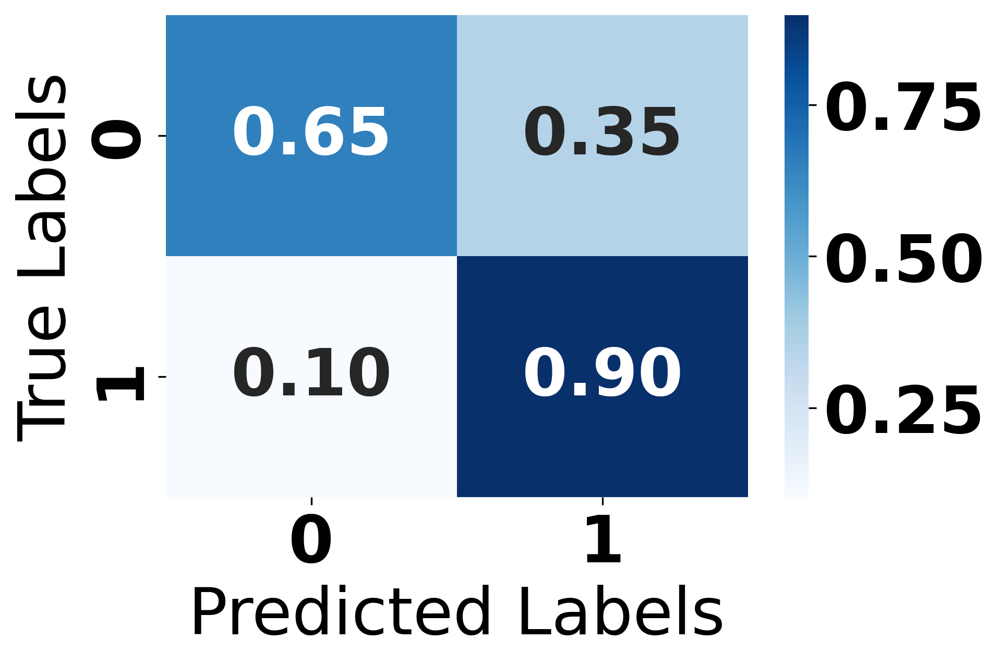

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

1759/1759 [==============================] - 10s 5ms/step
Normalized Confusion Matrix:
[[0.79501003 0.20498997]
 [0.18895093 0.81104907]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.80      0.88     52866
     Class 1       0.20      0.81      0.32      3403

    accuracy                           0.80     56269
   macro avg       0.59      0.80      0.60     56269
weighted avg       0.94      0.80      0.85     56269



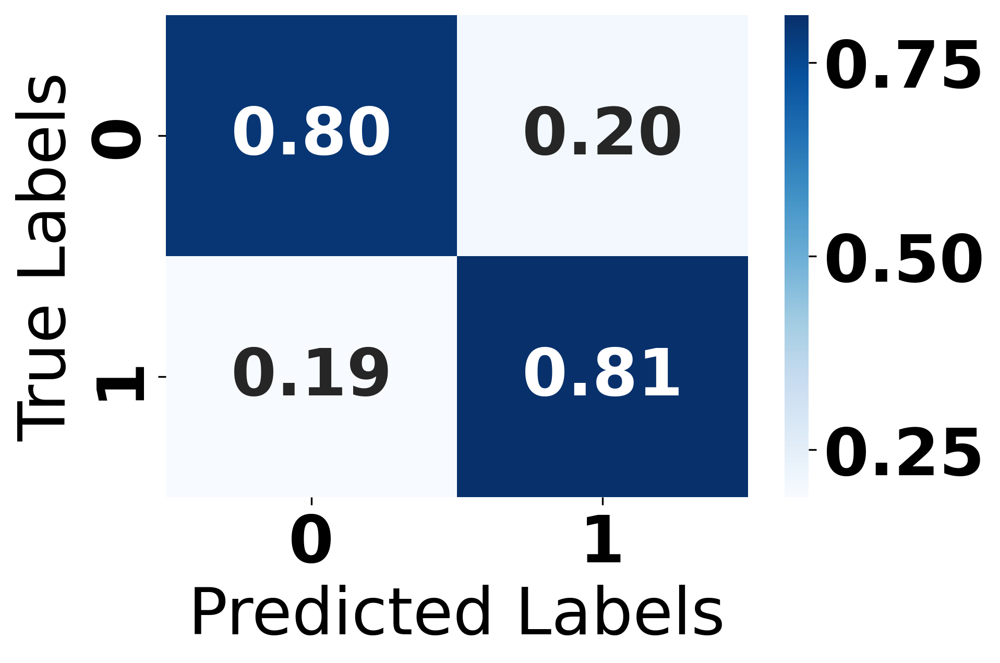

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.58
y_pred = np.where(y_pred_prob > 0.58, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.58)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

#### AUC

In [ ]:
import joblib
from tensorflow.keras.models import load_model

In [ ]:
# Load the model from the file
model1 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/AdaBoost.pkl')
model2 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RF.pkl')
model3 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/RUSBoost.pkl')
model4 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/DT.pkl')
model5 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/GNB.pkl')
model6 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/MLP.pkl')
model7 = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/CNN.h5')
model8 = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/ANN(Base).h5')
model9 = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/Novel_ANN.h5')
model10 = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/XGB.pkl')

### BRFSS 2021

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but AdaBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but RUSBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but GaussianNB was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but MLPClassifier was fitted without feature names
  warnings.warn(


1759/1759 [==============================] - 9s 5ms/step


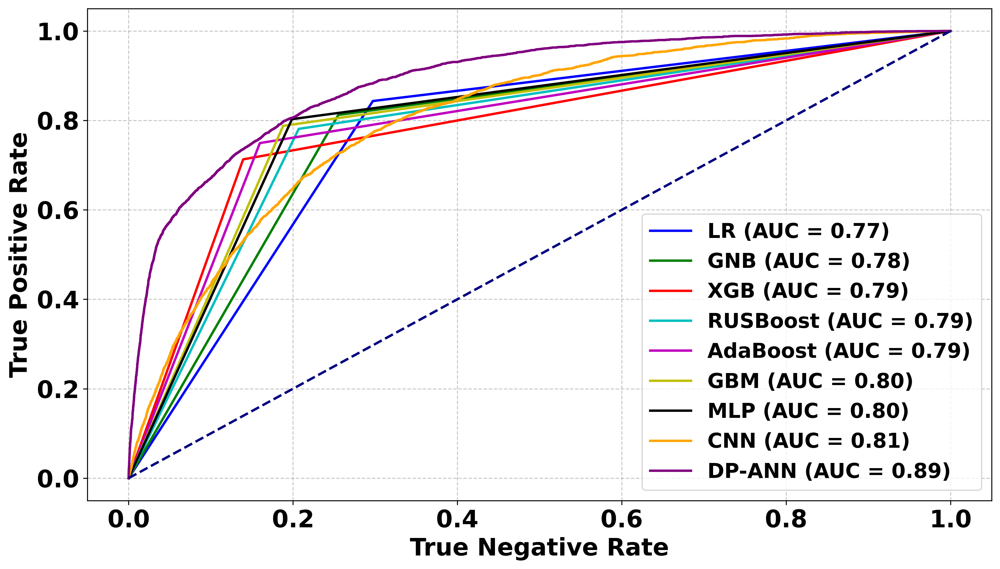

In [ ]:
from sklearn.metrics import roc_curve, auc

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple']

# Assuming you have predictions from eight models on the same test dataset
y_preds = [model.predict(x_test) for model in [model1, model2, model3, model4, model5, model6, model7, model9, model10]]
model_names = ['AdaBoost', 'LR', 'RUSBoost', 'GBM', 'GNB', 'MLP', 'CNN', 'DP-ANN', 'XGB']

# Create a figure and axis for the plot
plt.figure(figsize=(12, 7))

# Create a list of (AUC, y_pred, model_name) tuples
auc_values = [(auc(roc_curve(y_test, y_pred)[0], roc_curve(y_test, y_pred)[1]), y_pred, model_name)
              for y_pred, model_name in zip(y_preds, model_names)]

# Sort the list of tuples based on AUC values in ascending order
auc_values.sort(key=lambda x: x[0])

for i, (auc_roc, y_pred, model_name) in enumerate(auc_values):
    fpr, tpr, _ = roc_curve(y_test, y_pred)
    plt.plot(fpr, tpr, lw=2, label='%s (AUC = %0.2f)' % (model_name, auc_roc), color=colors[i])

# Plot the diagonal line (random classifier)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Set labels, legend, grid, and title
plt.xlabel('True Negative Rate', weight='bold', fontsize=20)
plt.ylabel('True Positive Rate', weight='bold', fontsize=20)
plt.legend(loc='lower right', fontsize=17)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

### BRFSS 2019

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but AdaBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but RUSBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but GaussianNB was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but MLPClassifier was fitted without feature names
  warnings.warn(


3530/3530 [==============================] - 9s 2ms/step


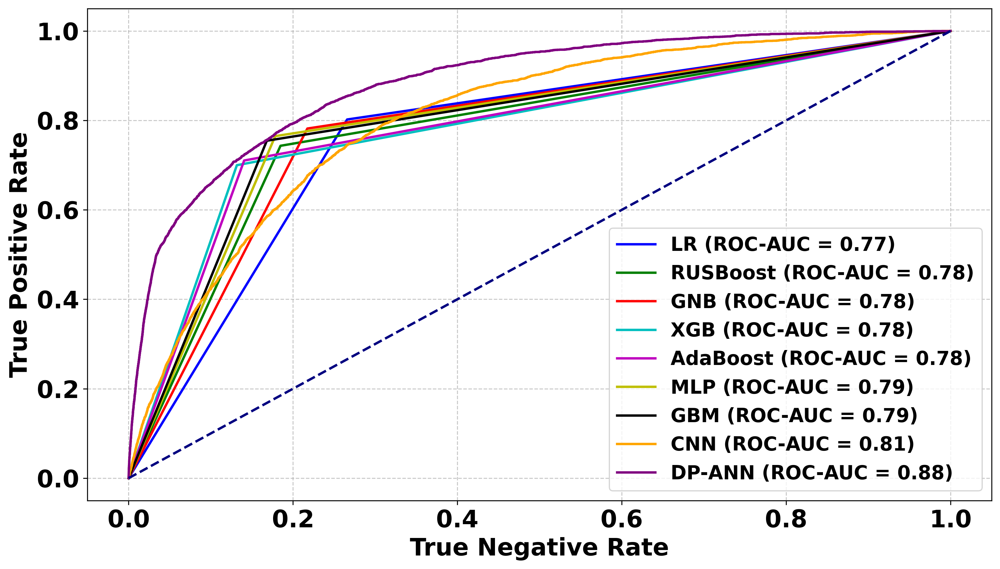

In [ ]:
from sklearn.metrics import roc_curve, auc

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple']

# Assuming you have predictions from eight models on the same test dataset
y_preds = [model.predict(x_test) for model in [model1, model2, model3, model4, model5, model6, model7, model9, model10]]
model_names = ['AdaBoost', 'LR', 'RUSBoost', 'GBM', 'GNB', 'MLP', 'CNN', 'DP-ANN', 'XGB']

# Create a figure and axis for the plot
plt.figure(figsize=(12, 7))

# Create a list of (AUC, y_pred, model_name) tuples
auc_values = [(auc(roc_curve(y_test, y_pred)[0], roc_curve(y_test, y_pred)[1]), y_pred, model_name)
              for y_pred, model_name in zip(y_preds, model_names)]

# Sort the list of tuples based on AUC values in ascending order
auc_values.sort(key=lambda x: x[0])

for i, (auc_roc, y_pred, model_name) in enumerate(auc_values):
    fpr, tpr, _ = roc_curve(y_test, y_pred)
    plt.plot(fpr, tpr, lw=2, label='%s (ROC-AUC = %0.2f)' % (model_name, auc_roc), color=colors[i])

# Plot the diagonal line (random classifier)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Set labels, legend, grid, and title
plt.xlabel('True Negative Rate', weight='bold', fontsize=20)
plt.ylabel('True Positive Rate', weight='bold', fontsize=20)
plt.legend(loc='lower right', fontsize=16)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but AdaBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but RUSBoostClassifier was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but GaussianNB was fitted without feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but MLPClassifier was fitted without feature names
  warnings.warn(


3530/3530 [==============================] - 9s 2ms/step


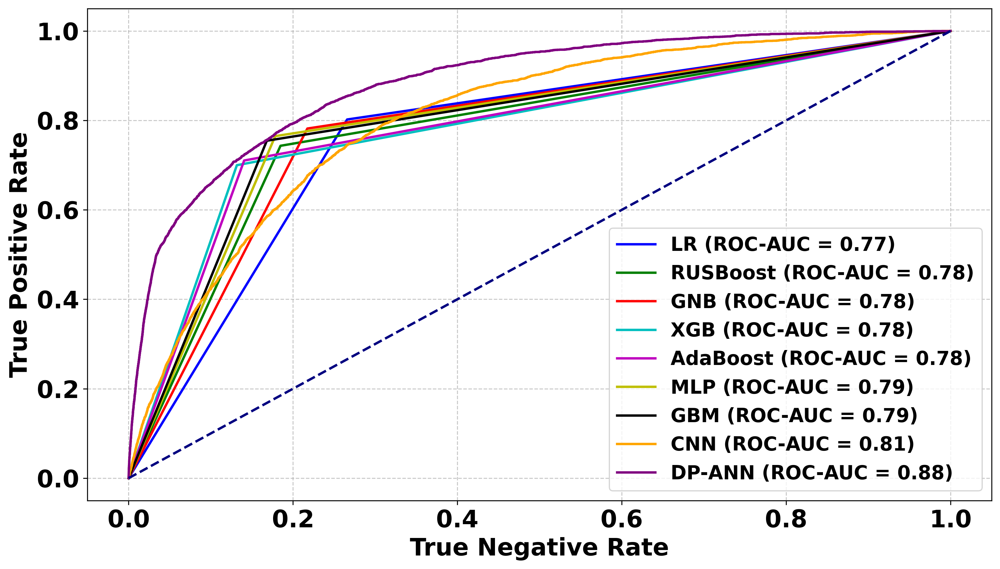

In [ ]:
from sklearn.metrics import roc_curve, auc

colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k', 'orange', 'purple']

# Assuming you have predictions from eight models on the same test dataset
y_preds = [model.predict(x_test) for model in [model1, model2, model3, model4, model5, model6, model7, model9, model10]]
model_names = ['AdaBoost', 'LR', 'RUSBoost', 'GBM', 'GNB', 'MLP', 'CNN', 'DP-ANN', 'XGB']

# Create a figure and axis for the plot
plt.figure(figsize=(12, 7))

# Create a list of (AUC, y_pred, model_name) tuples
auc_values = [(auc(roc_curve(y_test, y_pred)[0], roc_curve(y_test, y_pred)[1]), y_pred, model_name)
              for y_pred, model_name in zip(y_preds, model_names)]

# Sort the list of tuples based on AUC values in ascending order
auc_values.sort(key=lambda x: x[0])

for i, (auc_roc, y_pred, model_name) in enumerate(auc_values):
    fpr, tpr, _ = roc_curve(y_test, y_pred)
    plt.plot(fpr, tpr, lw=2, label='%s (ROC-AUC = %0.2f)' % (model_name, auc_roc), color=colors[i])

# Plot the diagonal line (random classifier)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')

# Set labels, legend, grid, and title
plt.xlabel('True Negative Rate', weight='bold', fontsize=20)
plt.ylabel('True Positive Rate', weight='bold', fontsize=20)
plt.legend(loc='lower right', fontsize=16)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Show the plot
plt.show()

### SHAP

In [ ]:
# Installing shap
!pip install shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 538.2/538.2 kB 8.6 MB/s eta 0:00:00


In [ ]:
# Import Shap
import shap

In [ ]:
# Converting to numpy array

x_train_np = np.array(x_train)
x_test_np = np.array(x_test)

In [ ]:
# Define Shap Explainer
explainer = shap.Explainer(dual-path_ANN, x_train_np)

In [ ]:
"""
# Shap values
shap_values = explainer.shap_values(x_test_np)

"""

PermutationExplainer explainer: 112953it [1:59:51, 15.71it/s]                            


In [ ]:
# Load SHAP values from the saved file
shap_values = np.load('/content/drive/MyDrive/Myocardial Infarction/SHAP/shap_values(Novel_ANN).npy')

In [ ]:
# Get the list of features (columns)
feature_names_list = x_train.columns.tolist()

print(feature_names_list)

['BPHIGH6', '_AGE_G', 'TOLDHI3', 'GENHLTH', 'HAVARTH5', 'EMPLOY1', 'PRIMINSR', 'DIFFWALK', '_SMOKER3', 'DIABETE4', 'EXERANY2', 'FLUSHOT7', 'CHCCOPD3', 'CHCOCNCR', 'PERSDOC3', 'DIFFALON', 'CHECKUP1', 'EDUCA', '_CHLDCNT', 'DIFFDRES', '_BMI5CAT', 'CHCSCNCR', 'VETERAN3', 'INCOME3', 'HIVTST7', 'RENTHOM1', 'CPDEMO1B', 'FRUIT2', 'USENOW3', 'MARITAL', 'SEXVAR', '_RFDRHV7', 'BLIND', 'CHCKDNY2', 'ADDEPEV3', 'ASTHMA3', 'MEDCOST1', 'QSTLANG', '_STATE', '_IMPRACE', 'HEIGHT3', 'CVDCRHD4', 'CVDSTRK3']


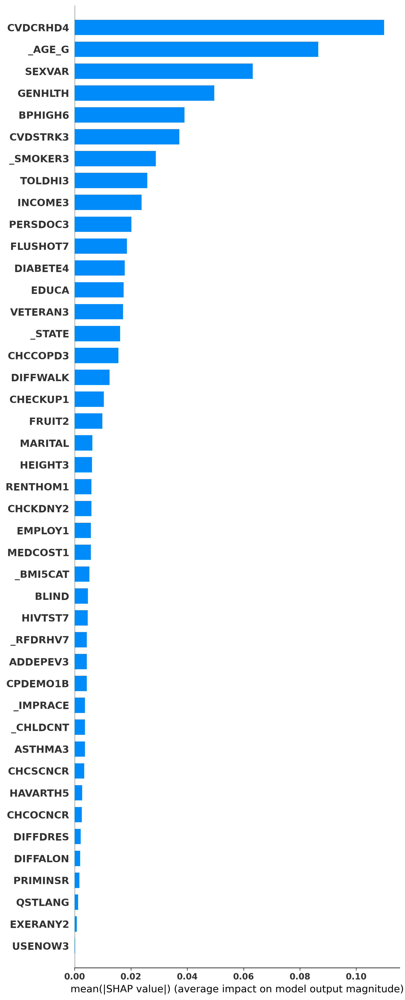

In [ ]:
# Feature importance
max_display = 44

shap.summary_plot(shap_values, x_test, plot_type="bar", feature_names=feature_names_list, max_display=max_display)

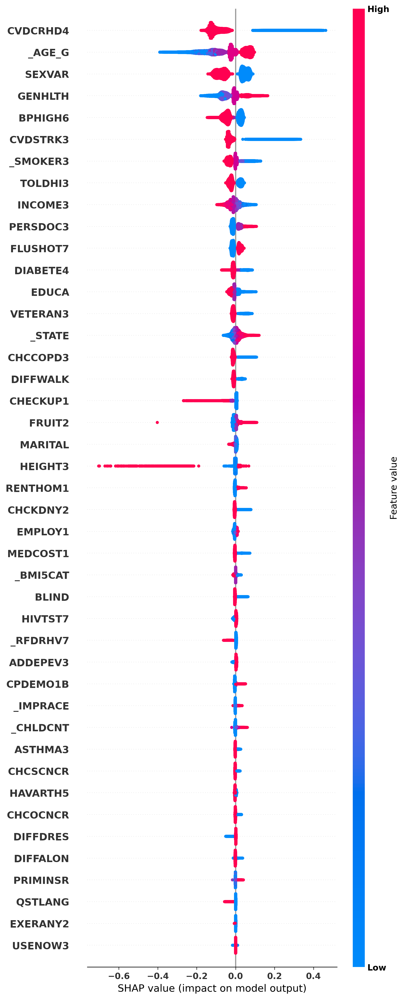

<Figure size 1920x1440 with 0 Axes>

In [ ]:
# Set the max_display to the total number of features (42 in this case)
max_display = 44

# Create the SHAP summary plot with the desired settings
shap.summary_plot(shap_values, x_test_np, feature_names=feature_names_list, max_display=max_display)

# Get the current figure and adjust the size and dpi
fig = plt.gcf()
plt.show()

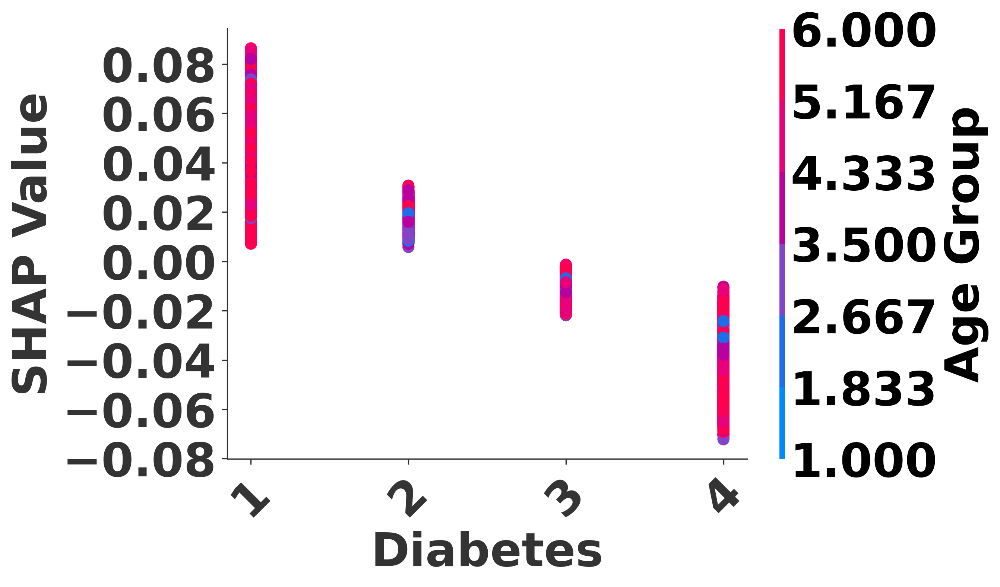

In [ ]:
# Choose a specific feature name
feature_name = 'DIABETE4'

# Find the index of the feature in the feature_names_list
feature_idx = feature_names_list.index(feature_name)

# Create a SHAP dependence plot with a custom interaction index plot
shap.dependence_plot(
    feature_idx,
    shap_values,
    x_test_np,
    dot_size=60,
    interaction_index="_AGE_G",
    feature_names=feature_names_list,
    show=False  # Set show to False to get the matplotlib figure
)

# Set font size for the axis labels and ticks
plt.xlabel("Diabetes", fontsize=30, weight="bold")
plt.ylabel("SHAP Value", fontsize=30, weight="bold")

# Set ticks for x-axis based on the values present in the data
unique_values = list(set(x_test_np[:, feature_idx]))  # Get unique values from the feature
unique_values.sort()  # Sort the values
plt.xticks(unique_values, rotation=45, fontsize=30)

plt.yticks(fontsize=30)

# Get the current figure and axes objects
fig, ax = plt.gcf(), plt.gca()

# Get colorbar
cb_ax = fig.axes[1]

# Modifying color bar parameters
cb_ax.tick_params(labelsize=30)
cb_ax.set_ylabel("Age Group", fontsize=30, weight="bold")

# Show the plot
plt.show()

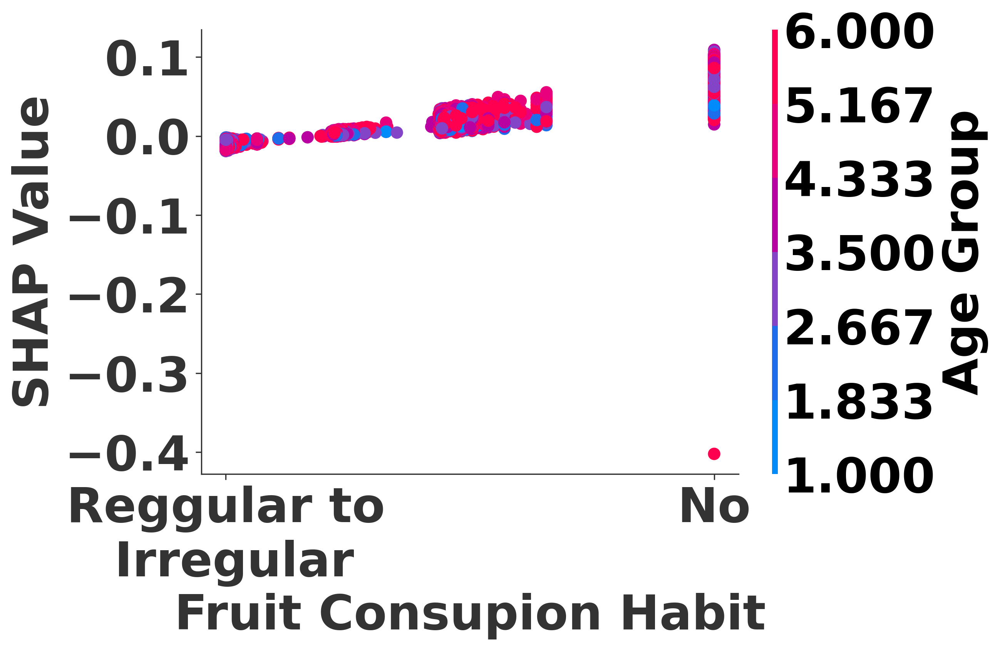

In [ ]:
# Choose a specific feature name
feature_name = 'FRUIT2'

# Find the index of the feature in the feature_names_list
feature_idx = feature_names_list.index(feature_name)

# Create a SHAP dependence plot with a custom interaction index plot
shap.dependence_plot(
    feature_idx,
    shap_values,
    x_test_np,
    dot_size=60,
    interaction_index="_AGE_G",
    feature_names=feature_names_list,
    show=False  # Set show to False to get the matplotlib figure
)

# Set font size for the axis labels and ticks
plt.xlabel("Fruit Consupion Habit", fontsize=30, weight="bold")
plt.ylabel("SHAP Value", fontsize=30, weight="bold")

# Set ticks for x-axis based on the values present in the data
unique_values = list(set(x_test_np[:, feature_idx]))  # Get unique values from the feature
unique_values.sort()  # Sort the values

# Customize x-ticks
tick_labels = ["Reggular to\n Irregular", "No"]
plt.xticks([unique_values[0], unique_values[-1]], tick_labels, rotation=45, fontsize=30)

plt.yticks(fontsize=30)

# Get the current figure and axes objects
fig, ax = plt.gcf(), plt.gca()

# Get colorbar
cb_ax = fig.axes[1]

# Modifying color bar parameters
cb_ax.tick_params(labelsize=30)
cb_ax.set_ylabel("Age Group", fontsize=30, weight="bold")

# Show the plot
plt.show()

### Lime

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=767f8bdc14de1fa9db1e3eafa5ad41f22e06279123c0a6b9ddb861efb2824a20
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


157/157 [==============================] - 0s 2ms/step


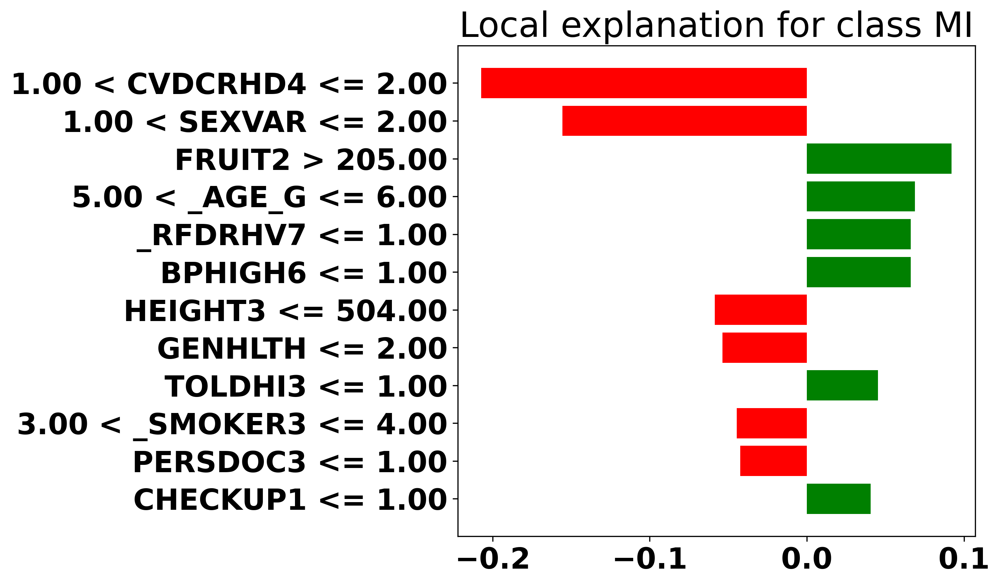

In [ ]:
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
import numpy as np

class_names = ['Healthy', 'MI']

explainer = lime.lime_tabular.LimeTabularExplainer(
    x_train_np,
    feature_names=feature_names_list,
    class_names=class_names,
    discretize_continuous=True,
)

# Wrapper function to ensure the model returns probabilities
def predict_proba(data):
    probabilities = dual-path_ANN.predict(data)
    return np.hstack([1 - probabilities, probabilities])

# Choose a test instance to explain
i = 0  # Index of the test instance to explain
exp = explainer.explain_instance(x_test_np[i], predict_proba, num_features=12)

# Customize plot appearance
fig = exp.as_pyplot_figure()
fig.set_size_inches(10, 6)
plt.tight_layout()
plt.show()

157/157 [==============================] - 1s 4ms/step


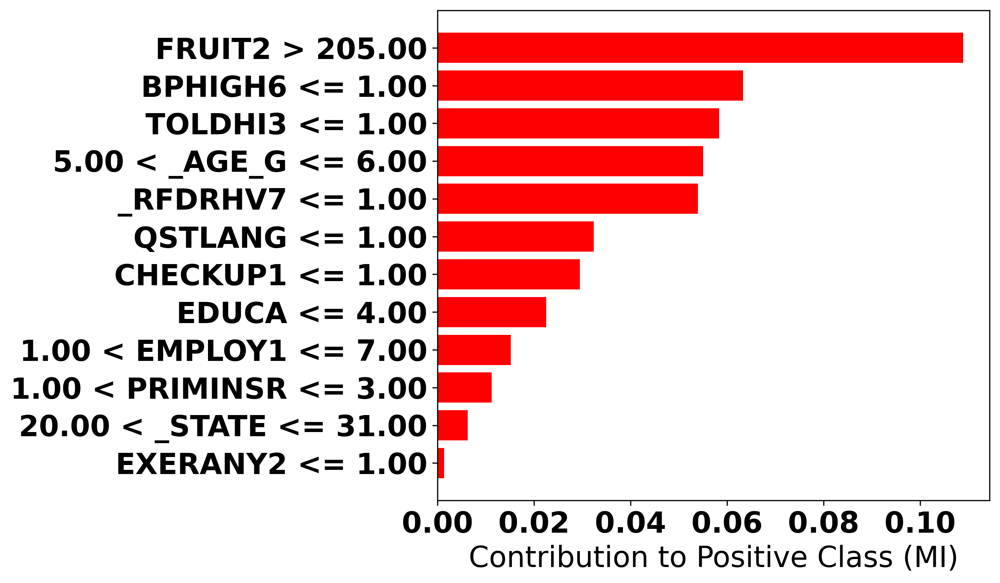

In [ ]:
import lime
import lime.lime_tabular
import matplotlib.pyplot as plt
import numpy as np

# Initialize LIME explainer
class_names = ['Healthy', 'MI']
explainer = lime.lime_tabular.LimeTabularExplainer(
    x_train_np,
    feature_names=feature_names_list,
    class_names=class_names,
    discretize_continuous=True,
)

# Wrapper function to ensure the model returns probabilities
def predict_proba(data):
    probabilities = dual-path_ANN.predict(data)
    return np.hstack([1 - probabilities, probabilities])

# Choose a test instance to explain
i = 0  # Index of the test instance to explain
exp = explainer.explain_instance(x_test_np[i], predict_proba, num_features=len(feature_names_list))

# Extract the explanations
explanation_list = exp.as_list()

# Filter and sort the top 12 features contributing to the positive class
positive_contributions = [item for item in explanation_list if item[1] > 0]
positive_contributions = sorted(positive_contributions, key=lambda x: x[1], reverse=True)[:12]

# Create a new figure for the top 12 positive contributions
fig, ax = plt.subplots(figsize=(10, 6))

# Plot the positive contributions
feature_names, contributions = zip(*positive_contributions)
ax.barh(feature_names, contributions, color='red')

# Customize plot appearance
ax.set_xlabel('Contribution to Positive Class (MI)')
plt.gca().invert_yaxis()  # Highest contributions at the top
plt.tight_layout()
plt.show()

### Raw Data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 109244
Class 1 count: 8649


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

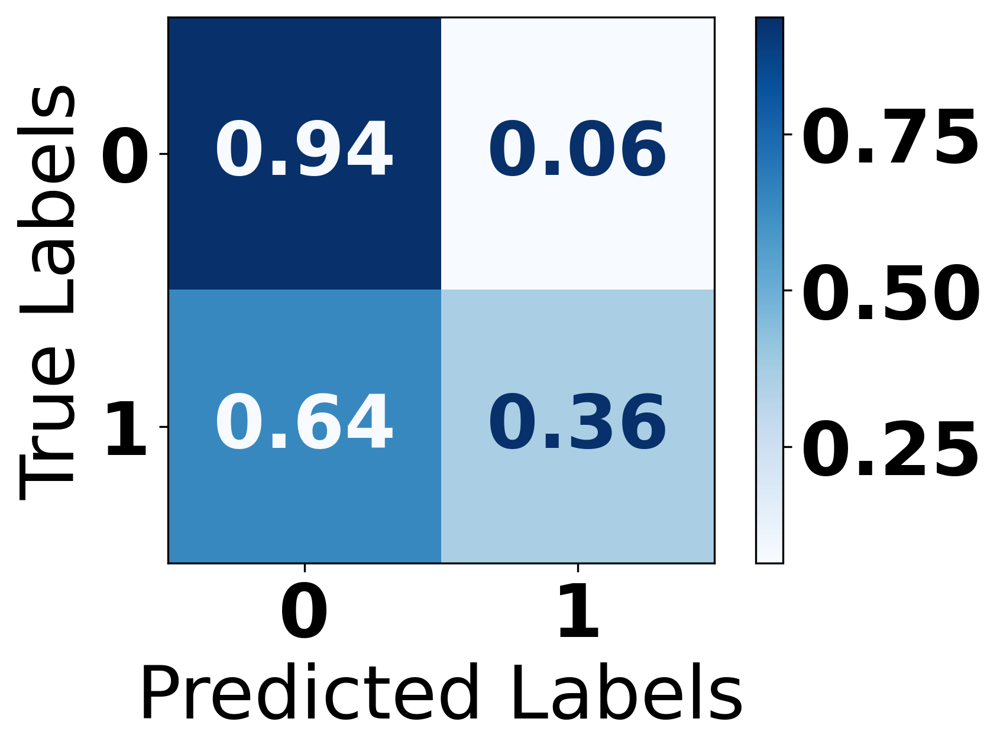

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96    109244
     Class 1       0.16      0.36      0.22      3708

    accuracy                           0.92    112952
   macro avg       0.57      0.65      0.59    112952
weighted avg       0.95      0.92      0.93    112952

Train Accuracy: 1.0
Test Accuracy: 0.9177172604292089


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')

# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(DT, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/DT.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/DT.pkl']

In [ ]:
import joblib

# Load the model from file
DT = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/DT.pkl')

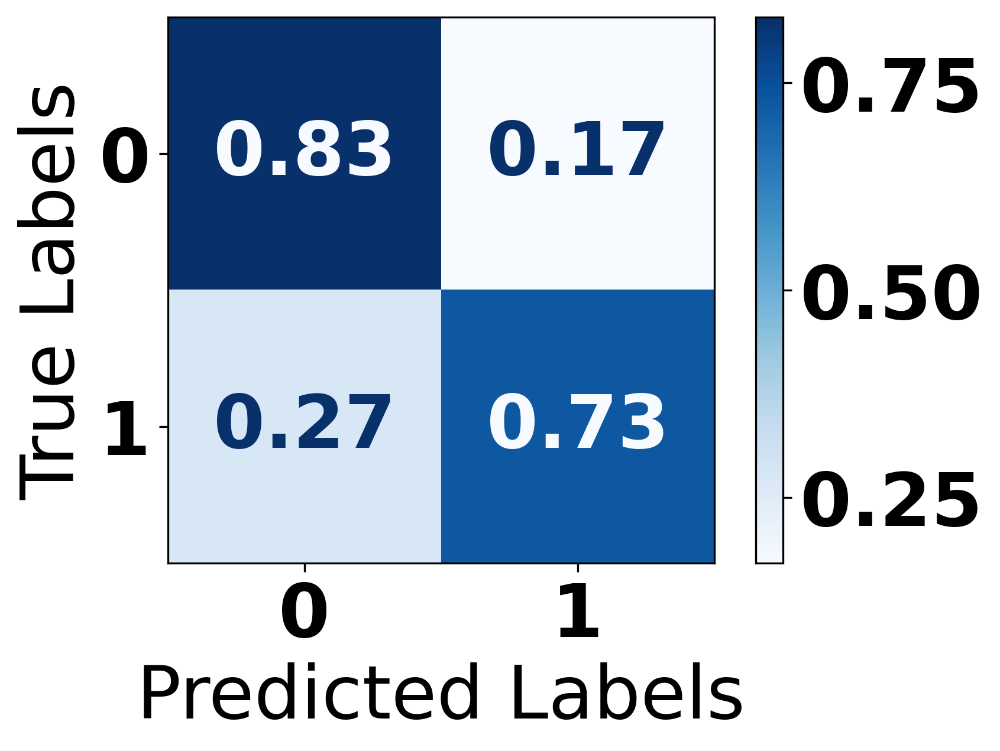

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90    109244
     Class 1       0.13      0.73      0.22      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.78      0.56    112952
weighted avg       0.96      0.83      0.88    112952

Train Accuracy: 0.8252228715869475
Test Accuracy: 0.8259614703590906


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(rusboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RUSBoost.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RUSBoost.pkl']

In [ ]:
import joblib

# Load the model from file
RUSBoost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RUSBoost.pkl')

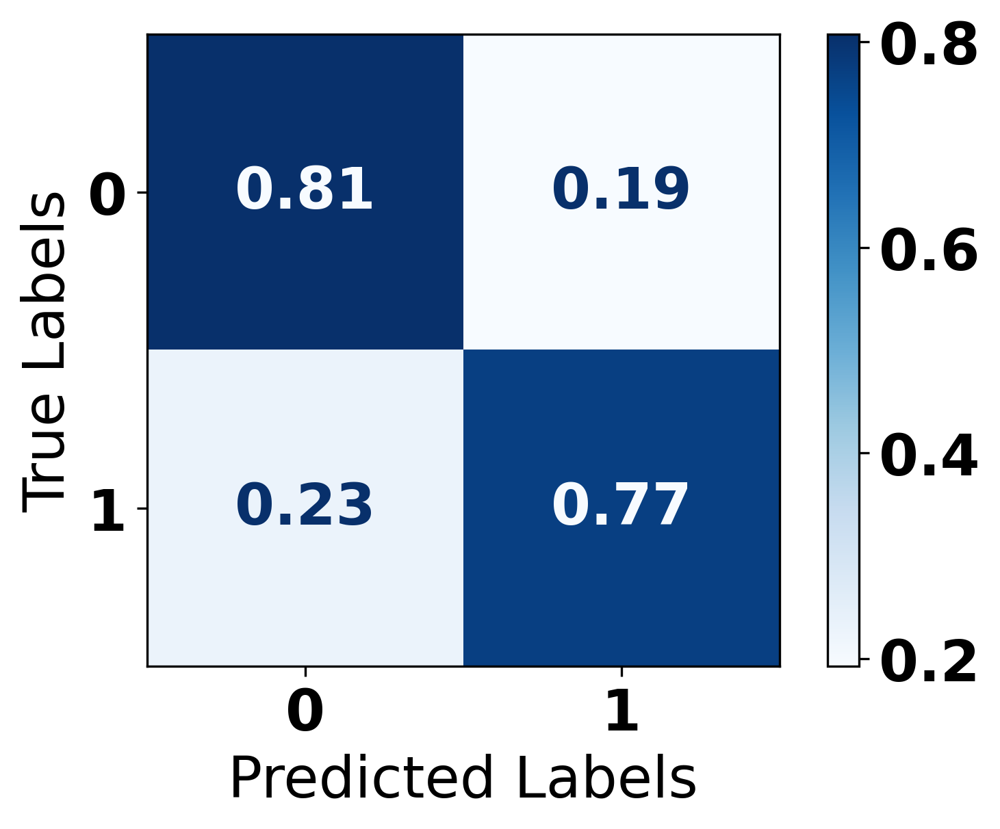

In [ ]:
# Predicting the output on the test dataset
y_pred = RUSBoost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

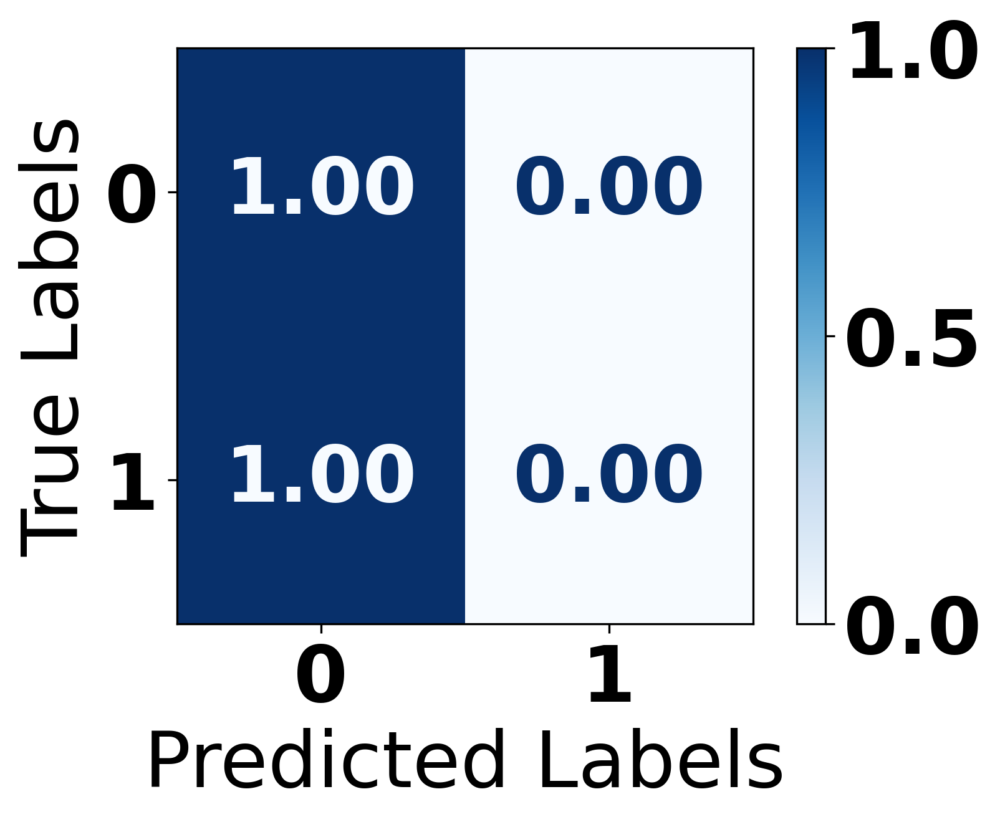

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report:
               precision    recall  f1-score   support

           0       0.97      1.00      0.98    109244
           1       0.00      0.00      0.00      3708

    accuracy                           0.97    112952
   macro avg       0.48      0.50      0.49    112952
weighted avg       0.94      0.97      0.95    112952

Train Accuracy: 0.9266368656323954
Test Accuracy: 0.9671718960266308


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(RF, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RF.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RF.pkl']

In [ ]:
import joblib

# Load the model from file
RF = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/RF.pkl')

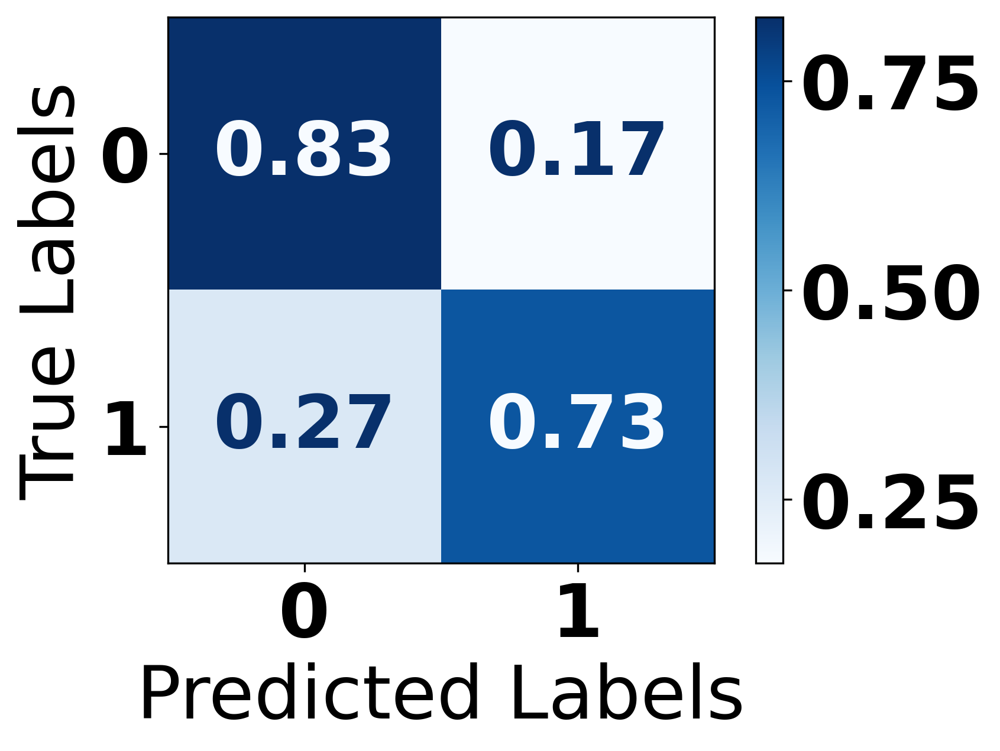

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.83      0.90    109244
           1       0.12      0.73      0.21      3708

    accuracy                           0.82    112952
   macro avg       0.56      0.78      0.56    112952
weighted avg       0.96      0.82      0.88    112952

Train Accuracy: 0.8202437803771216
Test Accuracy: 0.8229070755719243


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(GNB, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/GNB.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/GNB.pkl']

In [ ]:
import joblib

# Load the model from file
GNB = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/GNB.pkl')

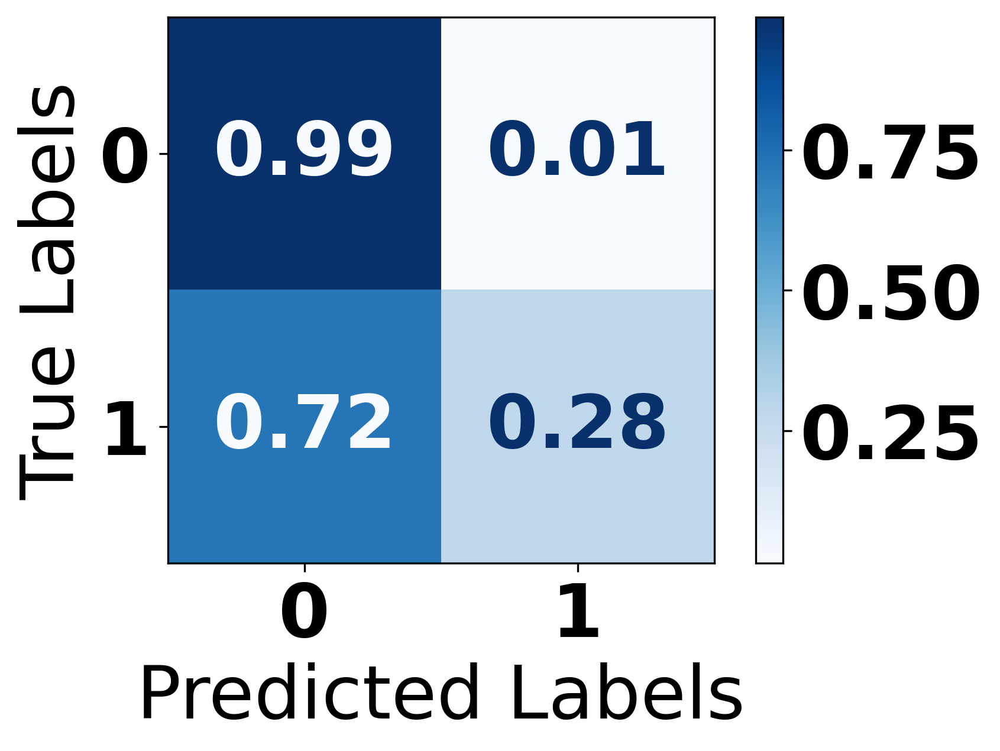

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.99      0.98    109244
           1       0.41      0.28      0.33      3708

    accuracy                           0.96    112952
   macro avg       0.69      0.63      0.65    112952
weighted avg       0.96      0.96      0.96    112952

Train Accuracy: 0.9360776297150806
Test Accuracy: 0.9629842765068347


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
# Change x label and y label
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')

# Change figure size
plt.gcf().set_size_inches(6, 4)

plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(Adaboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/AdaBoost.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/AdaBoost.pkl']

In [ ]:
import joblib

# Load the model from file
AdaBoost = joblib.load('//content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/AdaBoost.pkl')

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.99146864 0.00853136]
 [0.802589   0.197411  ]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.99      0.98    109244
     Class 1       0.44      0.20      0.27      3708

    accuracy                           0.97    112952
   macro avg       0.71      0.59      0.63    112952
weighted avg       0.96      0.97      0.96    112952



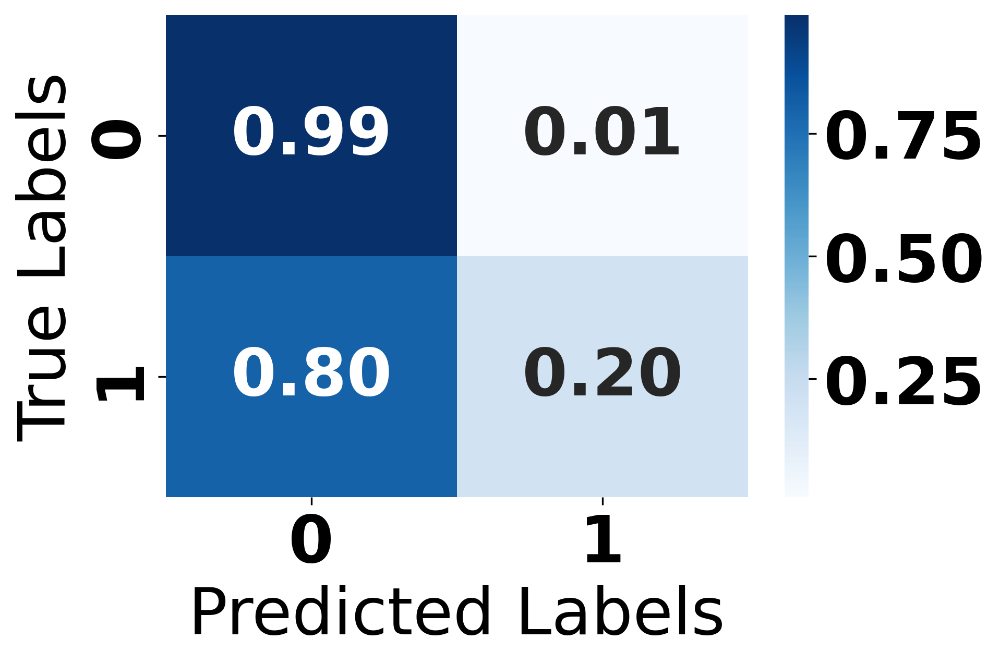

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(clf, '/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/MLP.pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/MLP.pkl']

In [ ]:
import joblib

# Load the model from file
MLP = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/MLP.pkl')

### Deep Learning Models

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
922/922 [==============================] - 31s 32ms/step - loss: 0.2913 - accuracy: 0.9235 - val_loss: 0.1471 - val_accuracy: 0.9663
Epoch 2/10
922/922 [==============================] - 41s 45ms/step - loss: 0.2243 - accuracy: 0.9257 - val_loss: 0.1986 - val_accuracy: 0.9520
Epoch 3/10
922/922 [==============================] - 42s 45ms/step - loss: 0.2173 - accuracy: 0.9262 - val_loss: 0.1340 - val_accuracy: 0.9670
Epoch 4/10
922/922 [==============================] - 28s 30ms/step - loss: 0.2128 - accuracy: 0.9264 - val_loss: 0.1293 - val_accuracy: 0.9664
Epoch 5/10
922/922 [==============================] - 27s 30ms/step - loss: 0.2107 - accuracy: 0.9266 - val_loss: 0.1265 - val_accuracy: 0.9670
Epoch 6/10
922/922 [==============================] - 23s 25ms/step - loss: 0.2101 - accuracy: 0.9267 - val_loss: 0.1325 - val_accuracy: 0.9663
Epoch 7/10
922/922 [==============================] - 28s 31ms/step - loss: 0.2091 - accuracy: 0.9268 - val_loss: 0.1285 - val_accuracy:

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.99852623 0.00147377]
 [0.97923409 0.02076591]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      1.00      0.98    109244
     Class 1       0.32      0.02      0.04      3708

    accuracy                           0.97    112952
   macro avg       0.65      0.51      0.51    112952
weighted avg       0.95      0.97      0.95    112952



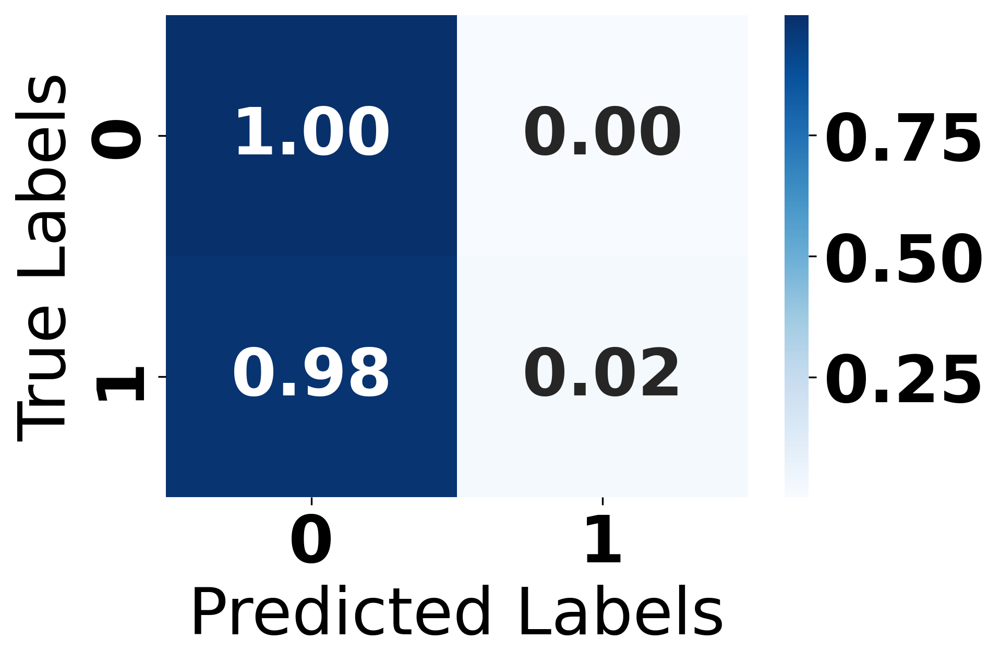

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/CNN.h5')

"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
CNN = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/CNN.h5')

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=20, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
922/922 [==============================] - 10s 9ms/step - loss: 0.2910 - accuracy: 0.9051 - val_loss: 0.1587 - val_accuracy: 0.9672
Epoch 2/20
922/922 [==============================] - 8s 9ms/step - loss: 0.2082 - accuracy: 0.9283 - val_loss: 0.1283 - val_accuracy: 0.9672
Epoch 3/20
922/922 [==============================] - 8s 8ms/step - loss: 0.1953 - accuracy: 0.9301 - val_loss: 0.1186 - val_accuracy: 0.9672
Epoch 4/20
922/922 [==============================] - 8s 9ms/step - loss: 0.1902 - accuracy: 0.9306 - val_loss: 0.1147 - val_accuracy: 0.9671
Epoch 5/20
922/922 [==============================] - 7s 7ms/step - loss: 0.1863 - accuracy: 0.9319 - val_loss: 0.1441 - val_accuracy: 0.9667
Epoch 6/20
922/922 [==============================] - 9s 10ms/step - loss: 0.1861 - accuracy: 0.9312 - val_loss: 0.1519 - val_accuracy: 0.9672
Epoch 7/20
922/922 [==============================] - 8s 8ms/step - loss: 0.1848 - accuracy: 0.9318 - val_loss: 0.1201 - val_accuracy: 0.9672
Epoc

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.99675039 0.00324961]
 [0.89859763 0.10140237]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      1.00      0.98    109244
     Class 1       0.51      0.10      0.17      3708

    accuracy                           0.97    112952
   macro avg       0.74      0.55      0.58    112952
weighted avg       0.96      0.97      0.96    112952



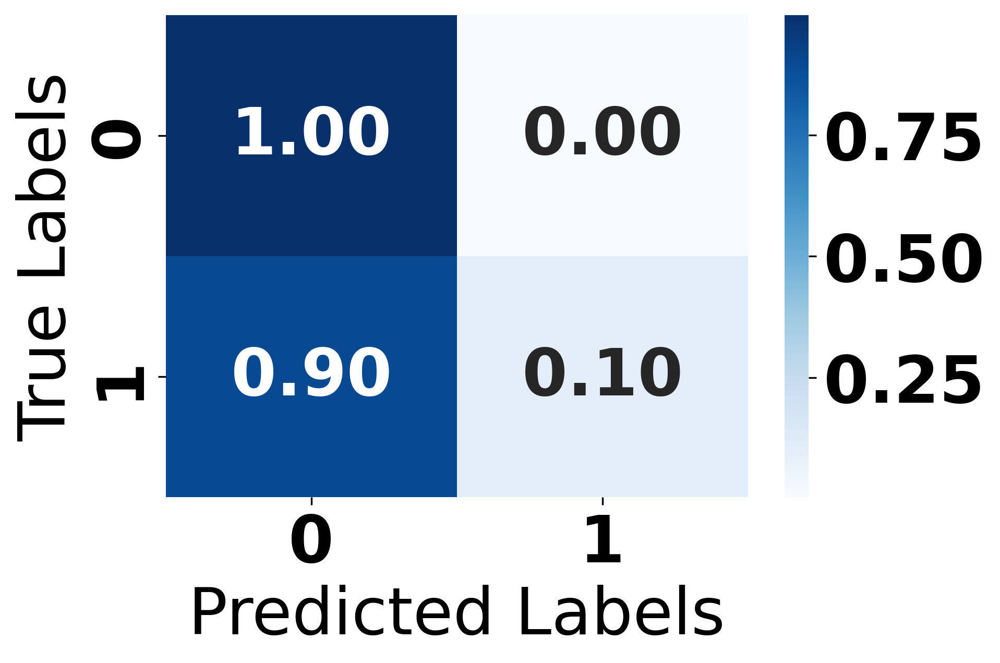

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.49
y_pred = np.where(y_pred_prob > 0.49, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.49)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
ANN_model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/ANN.h5')

"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
ANN_model = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Raw_model/ANN.h5')

### Traditional Sampling Approach

In [ ]:
# Labeling
x_train = train.drop(['CVDINFR4'], axis=1) # Input features
y_train = train['CVDINFR4'] # Target label

x_test = test.drop(['CVDINFR4'], axis=1) # Input features
y_test = test['CVDINFR4'] # Target label

In [ ]:
# Taget Label Encoder
y_train = np.array([1 if val == 1 else 0 for val in y_train])

y_test = np.array([1 if val == 1 else 0 for val in y_test])

### NearMiss

In [ ]:
from imblearn.under_sampling import NearMiss

# Initialize NearMiss
nm = NearMiss(version=1)

# Fit and transform the training data
x_train_resampled, y_train_resampled = nm.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save NearMiss data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/x_train_resampled(NearMiss).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/y_train_resampled(NearMiss).csv', index=False)
"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/x_train_resampled(NearMiss).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/y_train_resampled(NearMiss).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    8649
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    8649
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

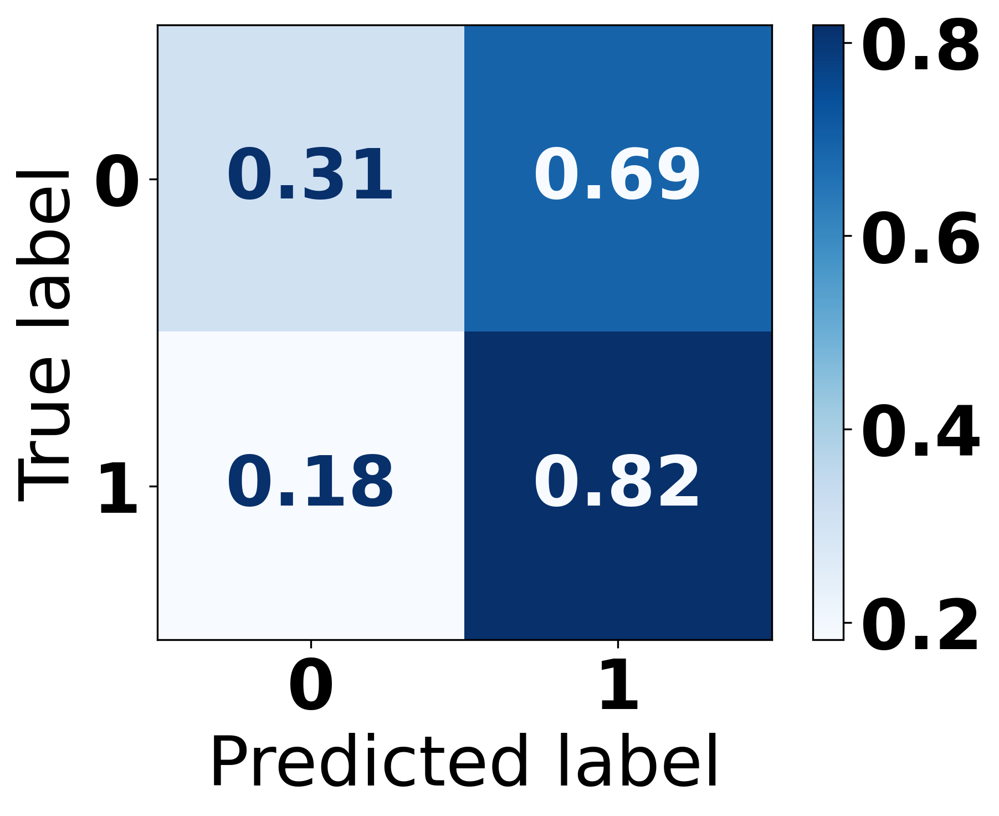

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.31      0.47    109244
     Class 1       0.04      0.82      0.07      3708

    accuracy                           0.33    112952
   macro avg       0.51      0.56      0.27    112952
weighted avg       0.95      0.33      0.46    112952

Train Accuracy: 1.0
Test Accuracy: 0.3253682980381047


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


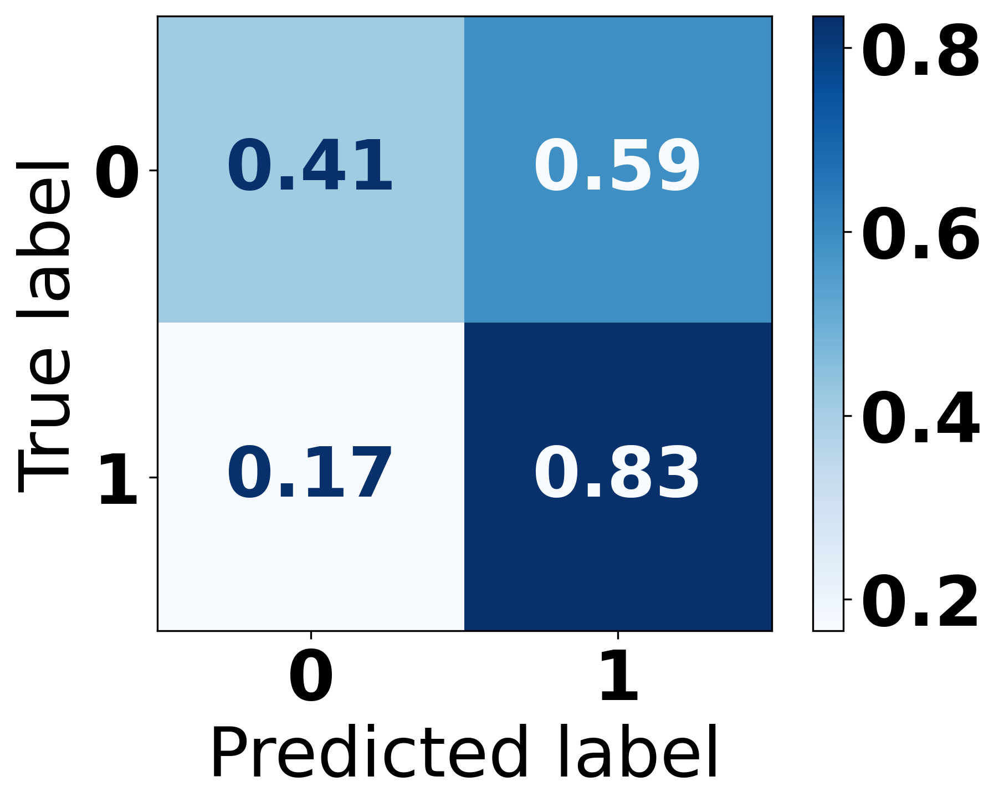

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.41      0.58    109244
     Class 1       0.05      0.83      0.09      3708

    accuracy                           0.42    112952
   macro avg       0.52      0.62      0.33    112952
weighted avg       0.96      0.42      0.56    112952

Train Accuracy: 0.8691178170886807
Test Accuracy: 0.4247025285076847


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-20-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


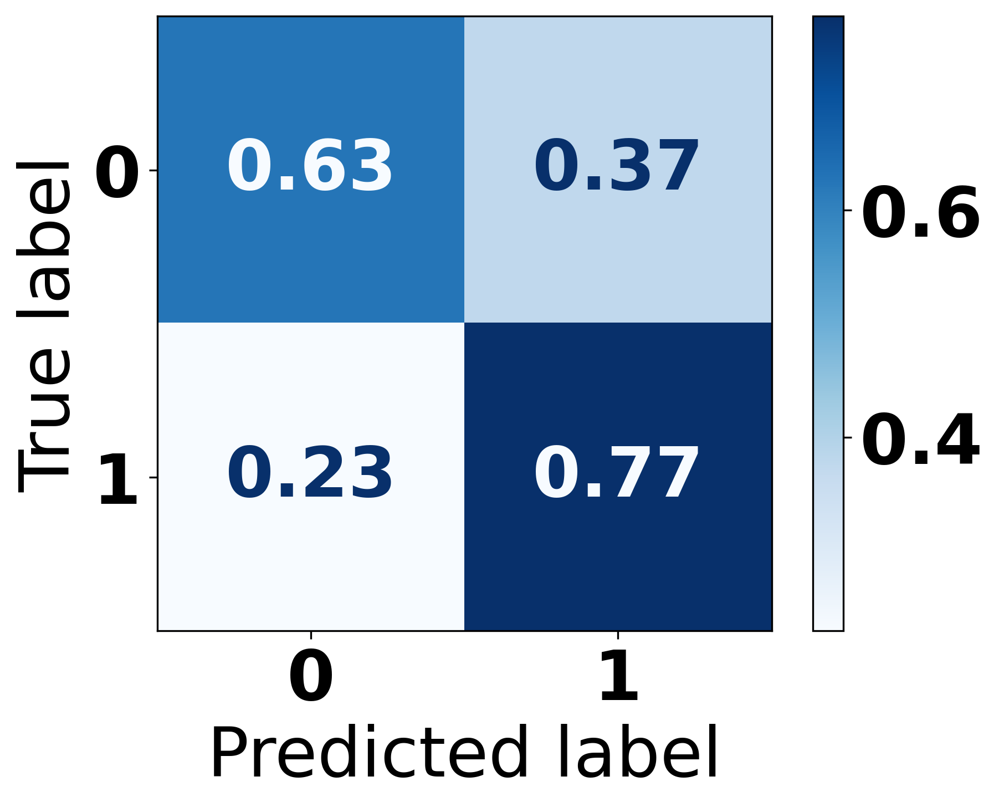

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.63      0.77    109244
           1       0.07      0.77      0.12      3708

    accuracy                           0.63    112952
   macro avg       0.53      0.70      0.44    112952
weighted avg       0.96      0.63      0.74    112952

Train Accuracy: 0.8386518672678922
Test Accuracy: 0.6303208442524258


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(RF, '/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/Model/RF(NearMiss).pkl')
"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/Model/RF(ENN).pkl']

In [ ]:
import joblib

# Load the model from the file
RF = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/Model/RF(NearMiss).pkl')

In [ ]:
import joblib

# Load the model from file
RF = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/NearMiss/Model/RF(NearMiss).pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


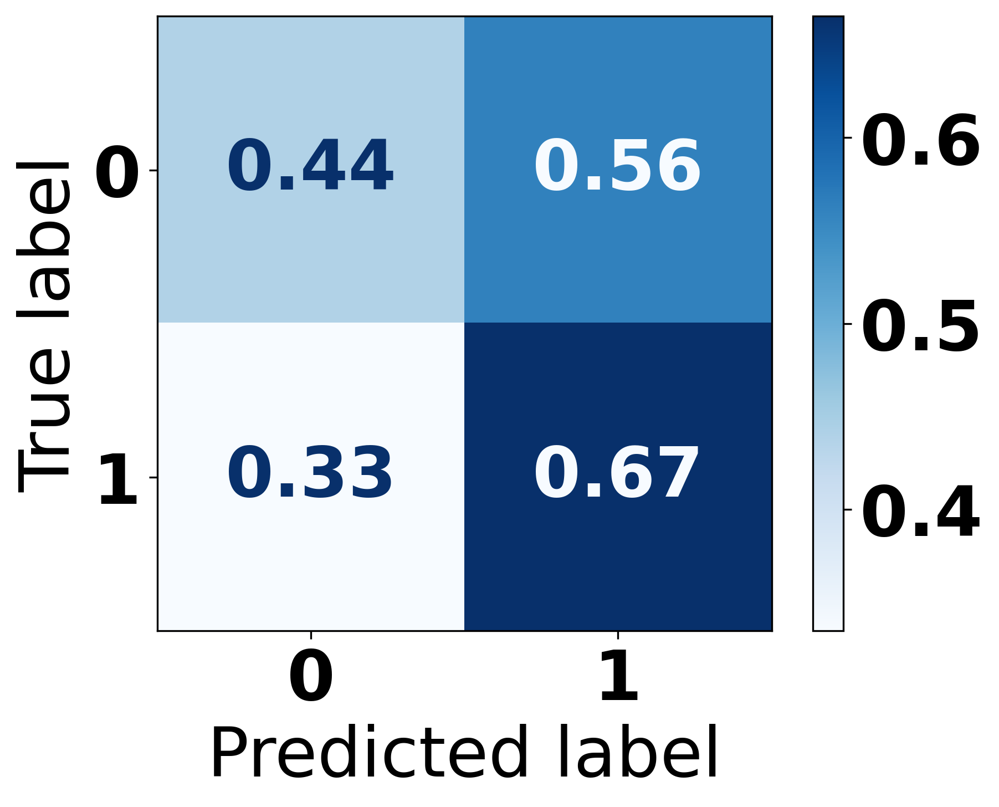

Classification Report:
               precision    recall  f1-score   support

           0       0.97      0.44      0.60    109244
           1       0.04      0.67      0.07      3708

    accuracy                           0.45    112952
   macro avg       0.51      0.55      0.34    112952
weighted avg       0.94      0.45      0.59    112952

Train Accuracy: 0.8058157012371372
Test Accuracy: 0.4458708123804802


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


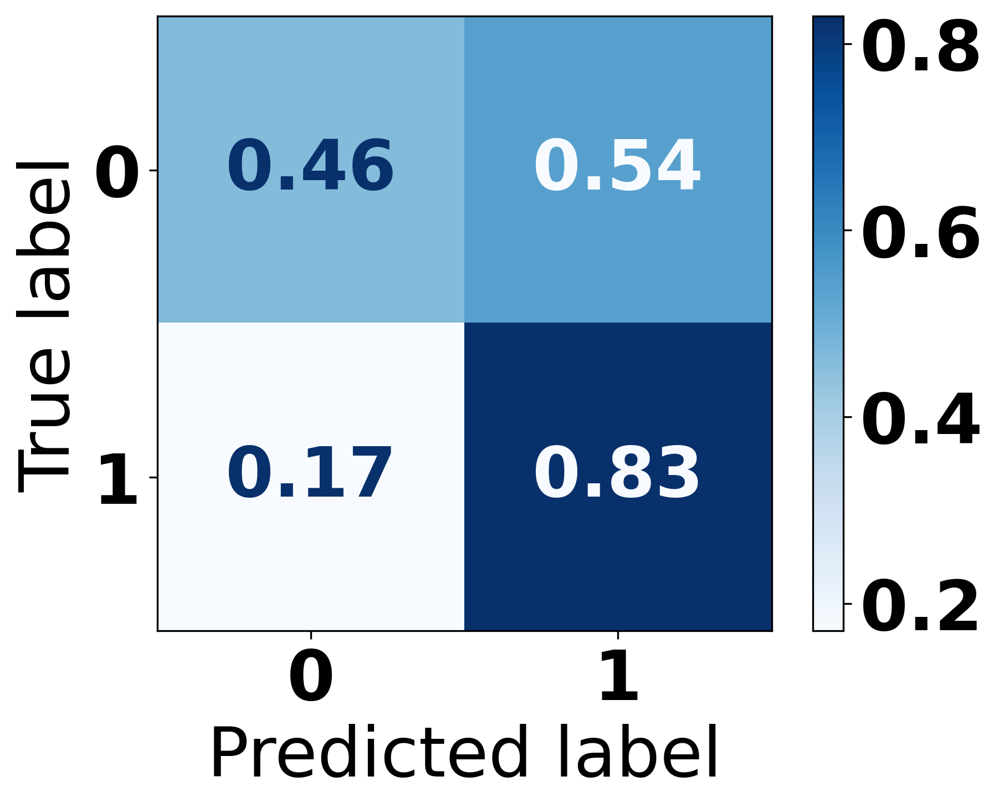

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.46      0.63    109244
           1       0.05      0.83      0.09      3708

    accuracy                           0.47    112952
   macro avg       0.52      0.65      0.36    112952
weighted avg       0.96      0.47      0.61    112952

Train Accuracy: 0.8691756272401434
Test Accuracy: 0.47306820596359517


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.43681117 0.56318883]
 [0.22141316 0.77858684]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.44      0.60    109244
     Class 1       0.04      0.78      0.08      3708

    accuracy                           0.45    112952
   macro avg       0.51      0.61      0.34    112952
weighted avg       0.95      0.45      0.59    112952



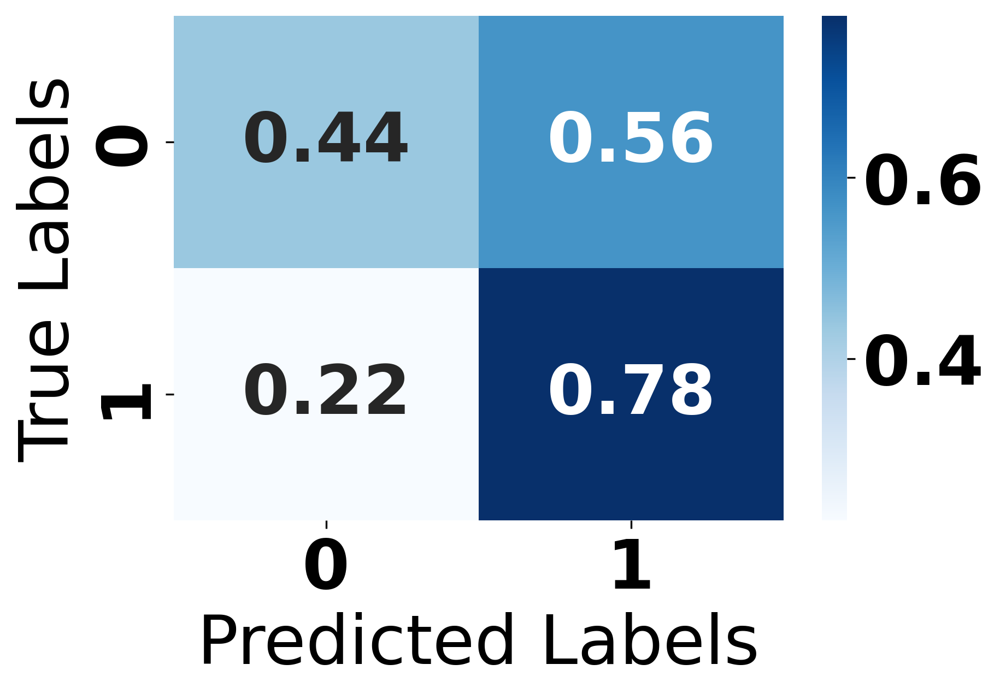

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
136/136 [==============================] - 9s 24ms/step - loss: 0.7894 - accuracy: 0.6835 - val_loss: 1.5480 - val_accuracy: 0.6716
Epoch 2/10
136/136 [==============================] - 3s 20ms/step - loss: 0.4580 - accuracy: 0.7815 - val_loss: 2.1244 - val_accuracy: 0.5762
Epoch 3/10
136/136 [==============================] - 3s 20ms/step - loss: 0.4065 - accuracy: 0.8139 - val_loss: 3.1575 - val_accuracy: 0.3721
Epoch 4/10
136/136 [==============================] - 3s 23ms/step - loss: 0.3890 - accuracy: 0.8258 - val_loss: 2.9662 - val_accuracy: 0.4391
Epoch 5/10
136/136 [==============================] - 3s 24ms/step - loss: 0.3695 - accuracy: 0.8356 - val_loss: 3.2000 - val_accuracy: 0.3755
Epoch 6/10
136/136 [==============================] - 3s 24ms/step - loss: 0.3666 - accuracy: 0.8387 - val_loss: 2.9498 - val_accuracy: 0.4162
Epoch 7/10
136/136 [==============================] - 3s 24ms/step - loss: 0.3693 - accuracy: 0.8373 - val_loss: 2.4327 - val_accuracy: 0.5397

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.39989382 0.60010618]
 [0.23894283 0.76105717]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.40      0.57    109244
     Class 1       0.04      0.76      0.08      3708

    accuracy                           0.41    112952
   macro avg       0.51      0.58      0.32    112952
weighted avg       0.95      0.41      0.55    112952



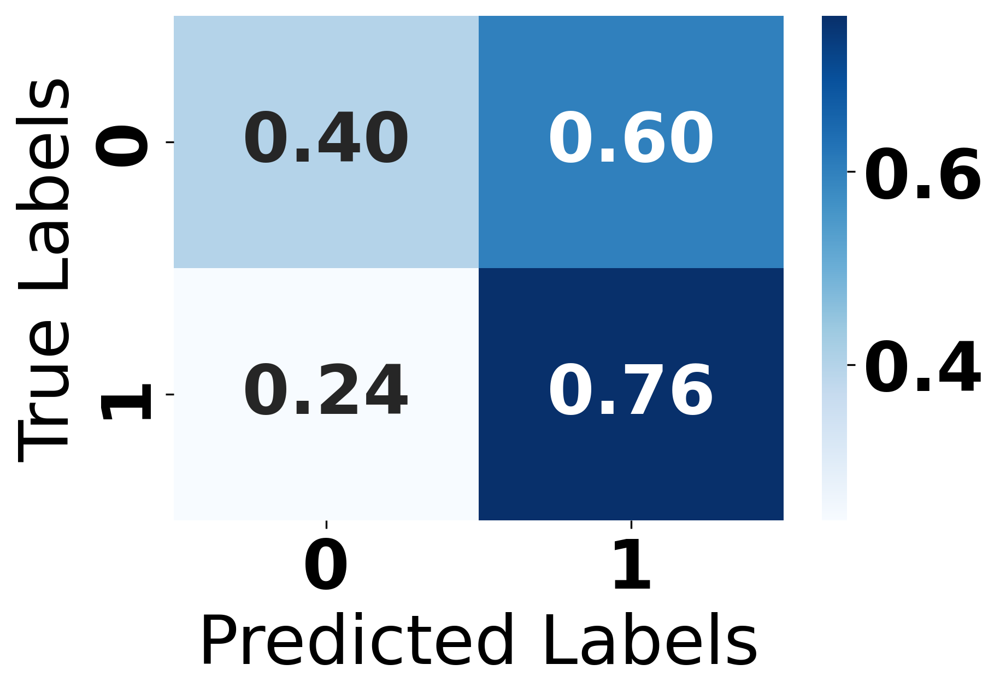

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
136/136 [==============================] - 8s 20ms/step - loss: 0.5428 - accuracy: 0.7196 - val_loss: 2.1009 - val_accuracy: 0.0347
Epoch 2/10
136/136 [==============================] - 3s 24ms/step - loss: 0.4009 - accuracy: 0.8180 - val_loss: 1.3498 - val_accuracy: 0.3245
Epoch 3/10
136/136 [==============================] - 2s 18ms/step - loss: 0.3536 - accuracy: 0.8458 - val_loss: 1.4296 - val_accuracy: 0.3961
Epoch 4/10
136/136 [==============================] - 3s 25ms/step - loss: 0.3469 - accuracy: 0.8506 - val_loss: 2.6874 - val_accuracy: 0.0564
Epoch 5/10
136/136 [==============================] - 3s 25ms/step - loss: 0.3401 - accuracy: 0.8582 - val_loss: 2.0462 - val_accuracy: 0.2708
Epoch 6/10
136/136 [==============================] - 2s 18ms/step - loss: 0.3344 - accuracy: 0.8592 - val_loss: 2.3712 - val_accuracy: 0.2452
Epoch 7/10
136/136 [==============================] - 2s 18ms/step - loss: 0.3291 - accuracy: 0.8656 - val_loss: 1.7201 - val_accuracy: 0.4707

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.12625865 0.87374135]
 [0.03451996 0.96548004]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.13      0.22    109244
     Class 1       0.04      0.97      0.07      3708

    accuracy                           0.15    112952
   macro avg       0.51      0.55      0.15    112952
weighted avg       0.96      0.15      0.22    112952



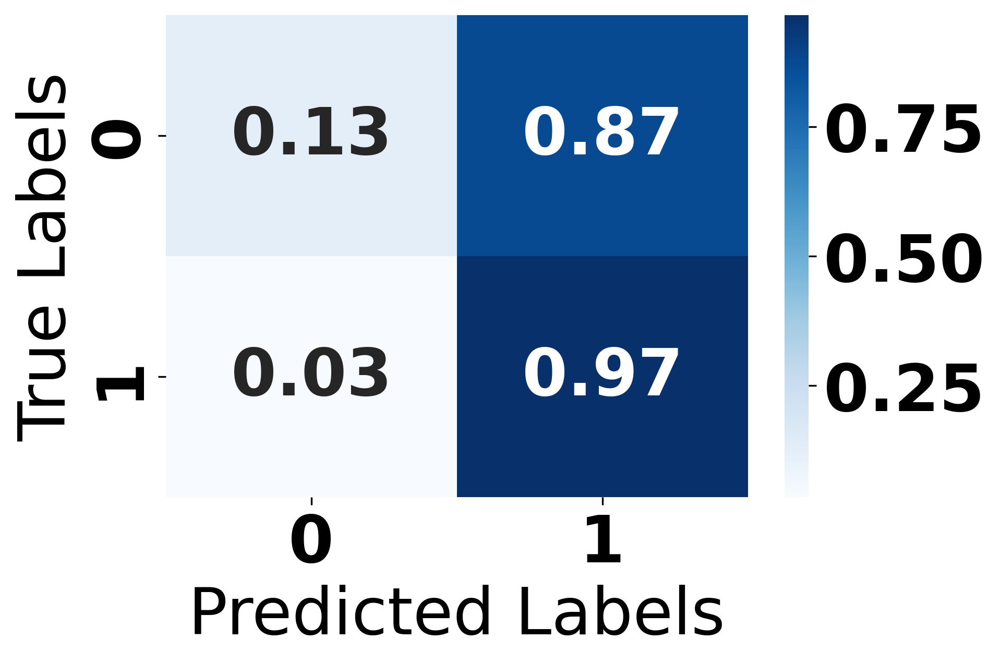

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Edited Nearest Neighbors

In [ ]:
from imblearn.under_sampling import EditedNearestNeighbours

# Initialize EditedNearestNeighbours
enn = EditedNearestNeighbours()

# Fit and transform the training data
x_train_resampled, y_train_resampled = enn.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save ENN data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/x_train_resampled(ENN).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/y_train_resampled(ENN).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/x_train_resampled(ENN).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/y_train_resampled(ENN).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    94147
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    94147
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

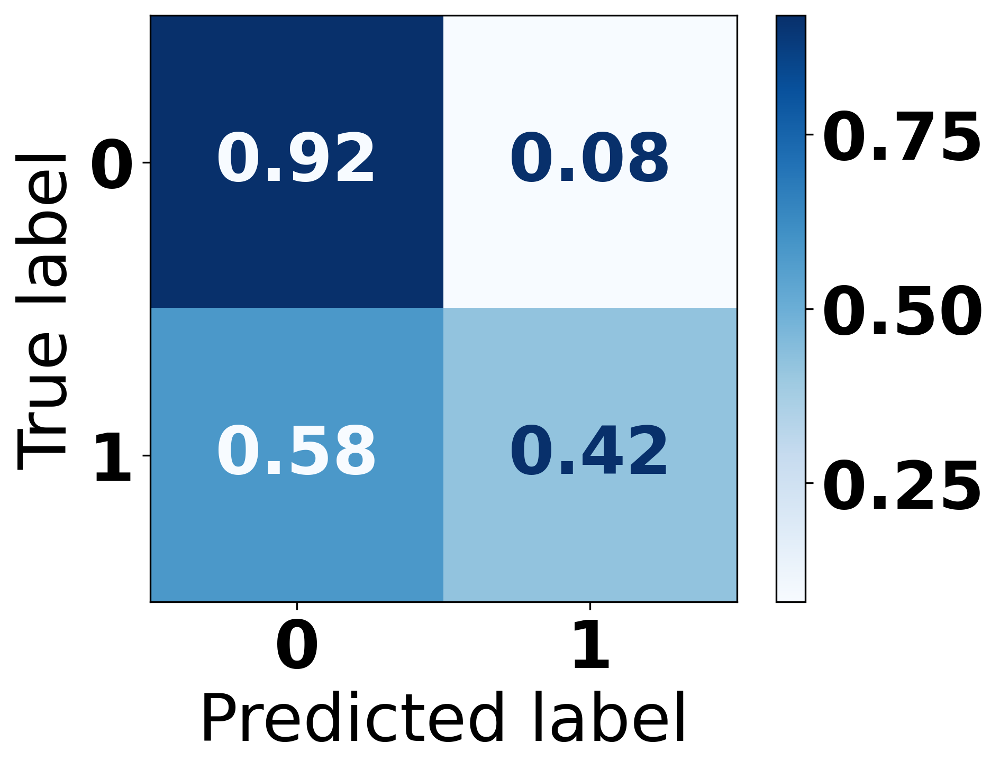

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.92      0.95    109244
     Class 1       0.15      0.42      0.22      3708

    accuracy                           0.90    112952
   macro avg       0.57      0.67      0.59    112952
weighted avg       0.95      0.90      0.93    112952

Train Accuracy: 1.0
Test Accuracy: 0.9040388837736384


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


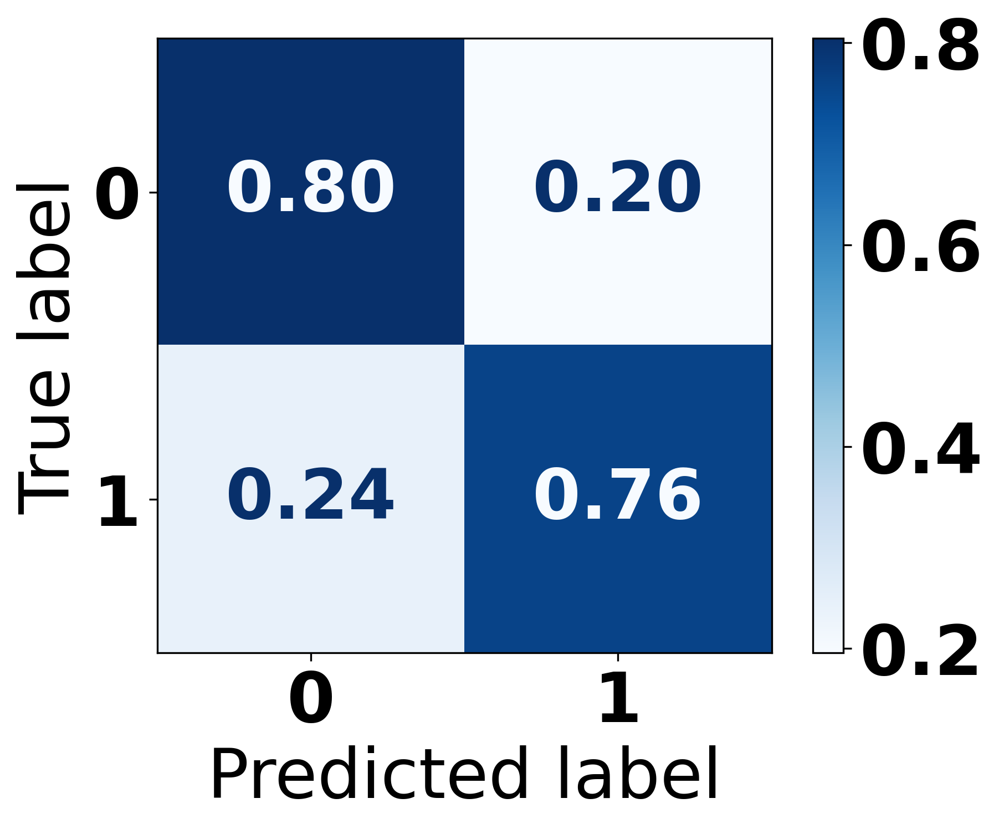

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.80      0.89    109244
     Class 1       0.12      0.76      0.20      3708

    accuracy                           0.80    112952
   macro avg       0.55      0.78      0.54    112952
weighted avg       0.96      0.80      0.87    112952

Train Accuracy: 0.8436028639246663
Test Accuracy: 0.802863163113535


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(rusboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/Model/rusboost(ENN).pkl')
"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/Model/rusboost(ENN).pkl']

In [ ]:
import joblib

# Load the model from file
rusboost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/ENN/Model/rusboost(ENN).pkl')

<ipython-input-46-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


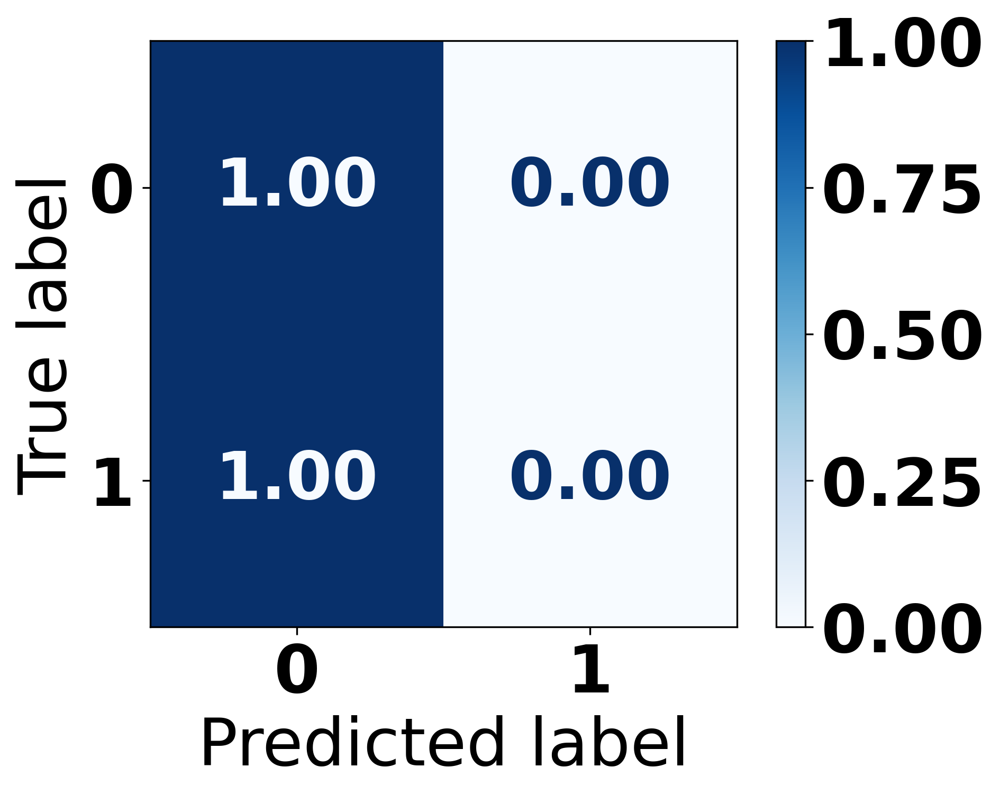

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report:
               precision    recall  f1-score   support

           0       0.97      1.00      0.98    109244
           1       0.00      0.00      0.00      3708

    accuracy                           0.97    112952
   macro avg       0.48      0.50      0.49    112952
weighted avg       0.94      0.97      0.95    112952

Train Accuracy: 0.9158624849215923
Test Accuracy: 0.9671718960266308


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


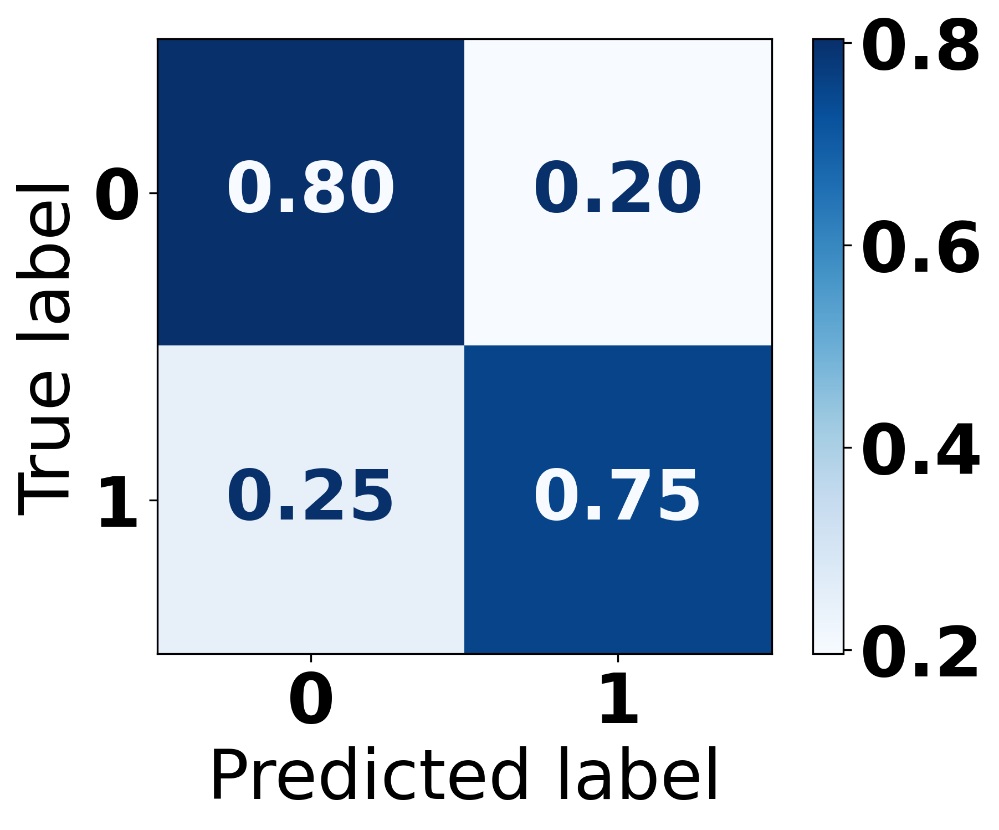

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.80      0.89    109244
           1       0.12      0.75      0.20      3708

    accuracy                           0.80    112952
   macro avg       0.55      0.78      0.54    112952
weighted avg       0.96      0.80      0.86    112952

Train Accuracy: 0.8391571656484688
Test Accuracy: 0.802084071109852


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


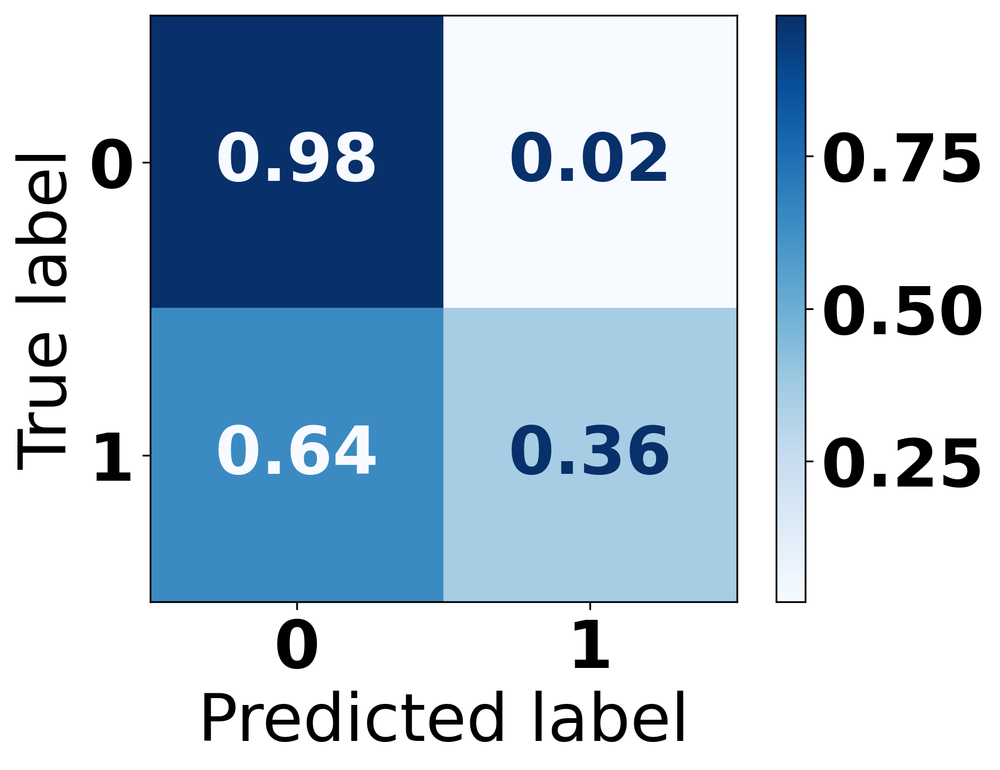

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.98      0.98    109244
           1       0.38      0.36      0.37      3708

    accuracy                           0.96    112952
   macro avg       0.68      0.67      0.67    112952
weighted avg       0.96      0.96      0.96    112952

Train Accuracy: 0.9365734075255846
Test Accuracy: 0.9598679084921028


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.97808575 0.02191425]
 [0.61596548 0.38403452]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.98      0.98    109244
     Class 1       0.37      0.38      0.38      3708

    accuracy                           0.96    112952
   macro avg       0.68      0.68      0.68    112952
weighted avg       0.96      0.96      0.96    112952



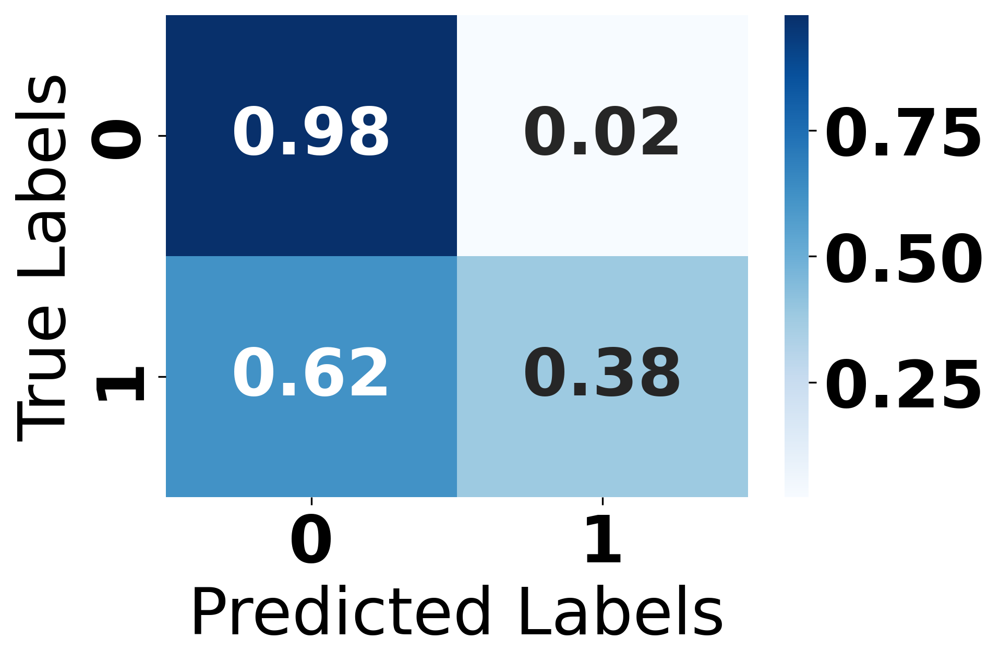

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
804/804 [==============================] - 15s 14ms/step - loss: 0.3044 - accuracy: 0.9128 - val_loss: 0.1975 - val_accuracy: 0.9298
Epoch 2/10
804/804 [==============================] - 11s 14ms/step - loss: 0.2296 - accuracy: 0.9157 - val_loss: 0.1343 - val_accuracy: 0.9648
Epoch 3/10
804/804 [==============================] - 7s 8ms/step - loss: 0.2211 - accuracy: 0.9177 - val_loss: 0.1966 - val_accuracy: 0.9337
Epoch 4/10
804/804 [==============================] - 6s 8ms/step - loss: 0.2170 - accuracy: 0.9187 - val_loss: 0.1856 - val_accuracy: 0.9422
Epoch 5/10
804/804 [==============================] - 7s 8ms/step - loss: 0.2140 - accuracy: 0.9192 - val_loss: 0.1520 - val_accuracy: 0.9506
Epoch 6/10
804/804 [==============================] - 6s 8ms/step - loss: 0.2123 - accuracy: 0.9198 - val_loss: 0.1689 - val_accuracy: 0.9443
Epoch 7/10
804/804 [==============================] - 7s 8ms/step - loss: 0.2112 - accuracy: 0.9205 - val_loss: 0.1435 - val_accuracy: 0.9551
Ep

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.9838252  0.0161748 ]
 [0.85490831 0.14509169]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.98      0.98    109244
     Class 1       0.23      0.15      0.18      3708

    accuracy                           0.96    112952
   macro avg       0.60      0.56      0.58    112952
weighted avg       0.95      0.96      0.95    112952



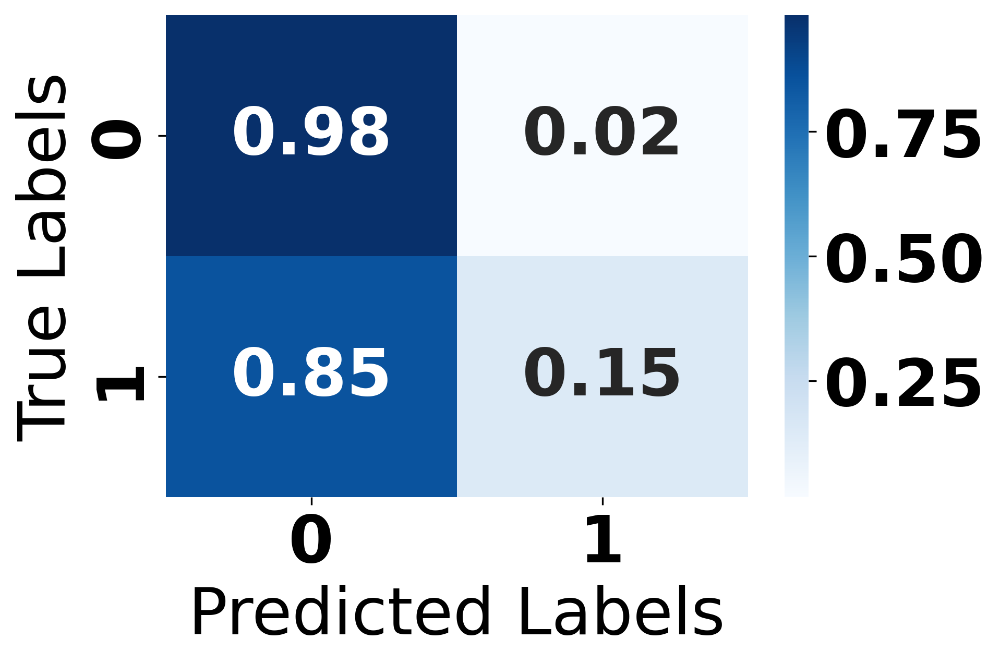

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
804/804 [==============================] - 10s 10ms/step - loss: 0.3072 - accuracy: 0.8912 - val_loss: 0.1205 - val_accuracy: 0.9672
Epoch 2/10
804/804 [==============================] - 8s 10ms/step - loss: 0.2078 - accuracy: 0.9239 - val_loss: 0.1515 - val_accuracy: 0.9672
Epoch 3/10
804/804 [==============================] - 7s 9ms/step - loss: 0.1981 - accuracy: 0.9276 - val_loss: 0.1231 - val_accuracy: 0.9672
Epoch 4/10
804/804 [==============================] - 7s 9ms/step - loss: 0.1917 - accuracy: 0.9302 - val_loss: 0.1078 - val_accuracy: 0.9674
Epoch 5/10
804/804 [==============================] - 8s 10ms/step - loss: 0.1884 - accuracy: 0.9307 - val_loss: 0.1080 - val_accuracy: 0.9672
Epoch 6/10
804/804 [==============================] - 6s 7ms/step - loss: 0.1867 - accuracy: 0.9317 - val_loss: 0.1052 - val_accuracy: 0.9674
Epoch 7/10
804/804 [==============================] - 7s 9ms/step - loss: 0.1854 - accuracy: 0.9325 - val_loss: 0.1081 - val_accuracy: 0.9672
Ep

3530/3530 [==============================] - 10s 3ms/step
Normalized Confusion Matrix:
[[0.99422394 0.00577606]
 [0.84519957 0.15480043]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.99      0.98    109244
     Class 1       0.48      0.15      0.23      3708

    accuracy                           0.97    112952
   macro avg       0.72      0.57      0.61    112952
weighted avg       0.96      0.97      0.96    112952



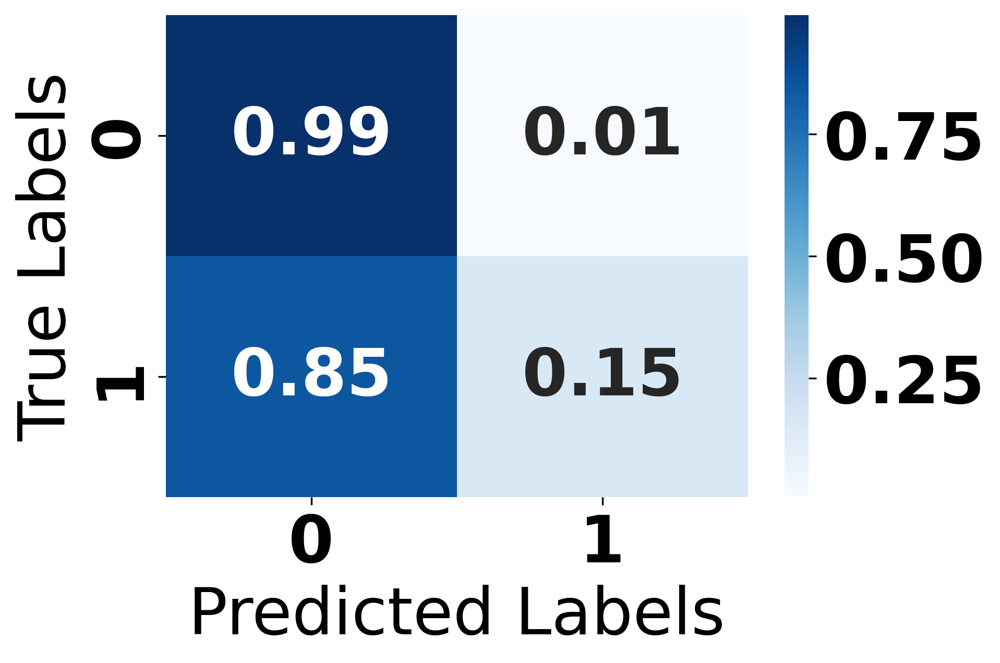

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Synthetic Minority Over-sampling Technique

In [ ]:
from imblearn.over_sampling import SMOTE

# Initialize SMOTE
smote = SMOTE(random_state=42)

# Fit and transform the training data
x_train_resampled, y_train_resampled = smote.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save SMOTE data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/x_train_resampled(SMOTE).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/y_train_resampled(SMOTE).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/x_train_resampled(SMOTE).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/y_train_resampled(SMOTE).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    109244
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    109244
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

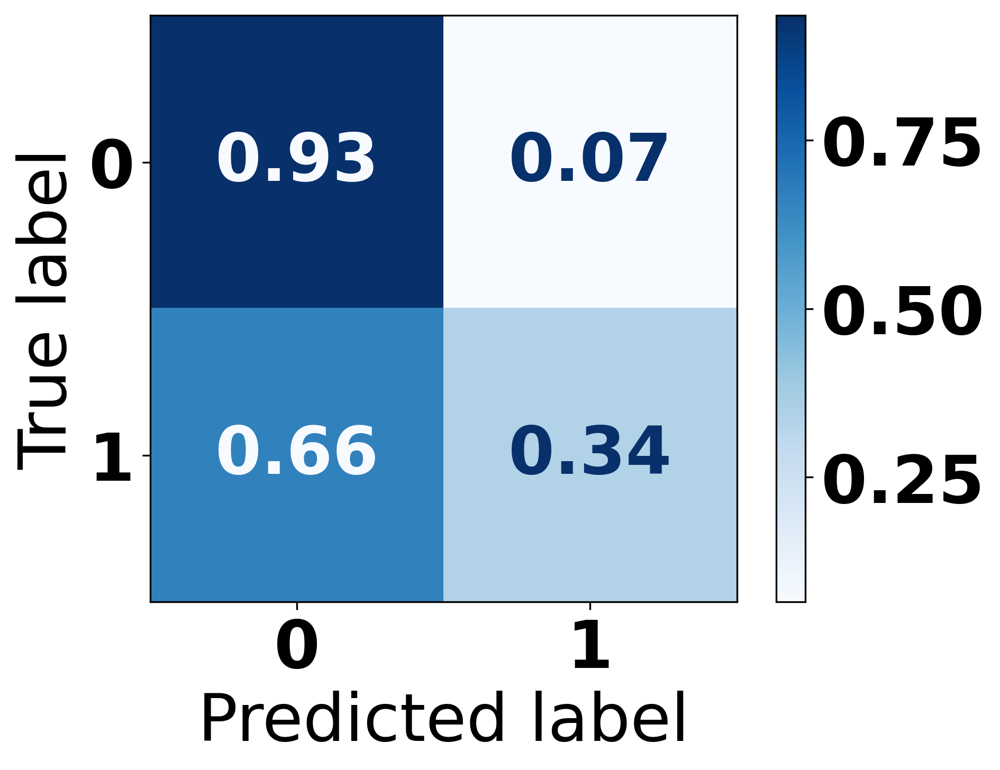

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96    109244
     Class 1       0.15      0.34      0.21      3708

    accuracy                           0.92    112952
   macro avg       0.56      0.64      0.58    112952
weighted avg       0.95      0.92      0.93    112952

Train Accuracy: 1.0
Test Accuracy: 0.9153445711452652


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


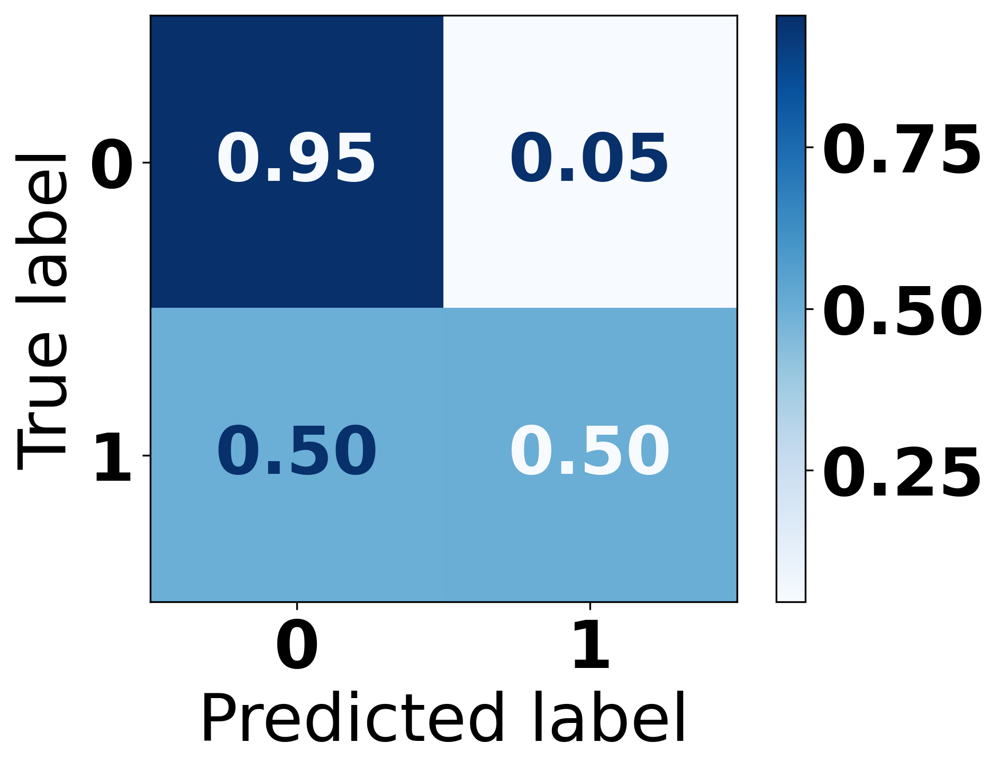

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.97    109244
     Class 1       0.27      0.50      0.35      3708

    accuracy                           0.94    112952
   macro avg       0.63      0.73      0.66    112952
weighted avg       0.96      0.94      0.95    112952

Train Accuracy: 0.9015460803339314
Test Accuracy: 0.9389563708477937


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-64-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


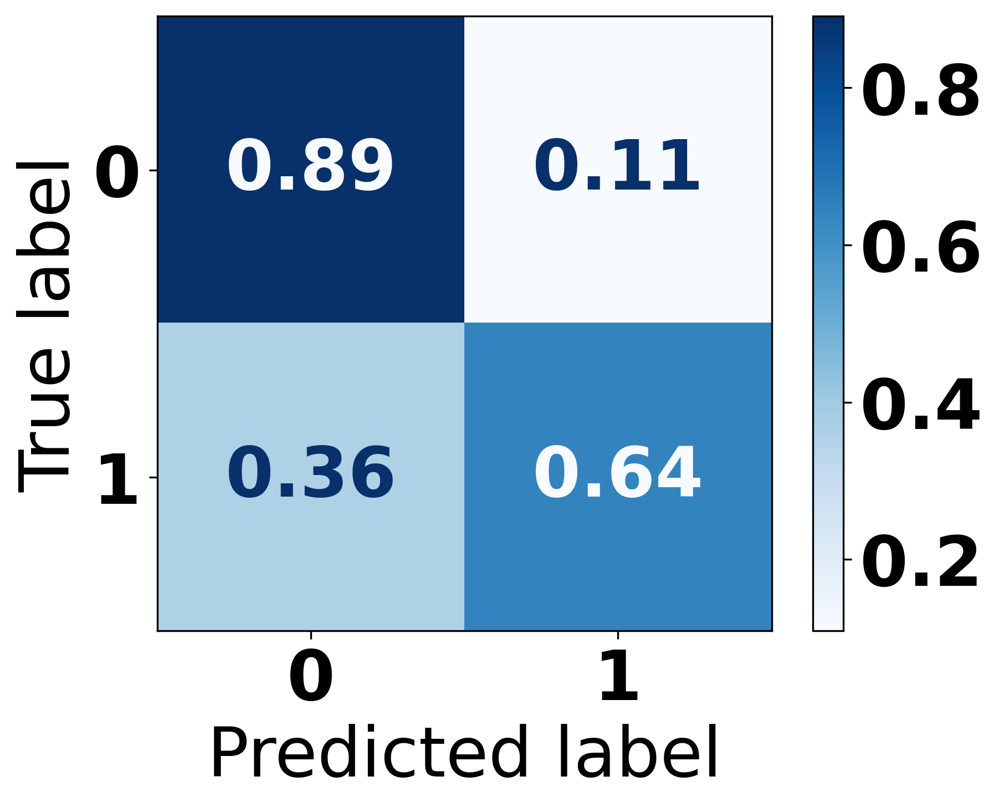

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.89      0.94    109244
           1       0.17      0.64      0.26      3708

    accuracy                           0.88    112952
   macro avg       0.58      0.76      0.60    112952
weighted avg       0.96      0.88      0.91    112952

Train Accuracy: 0.8906301490242027
Test Accuracy: 0.8827555067639351


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


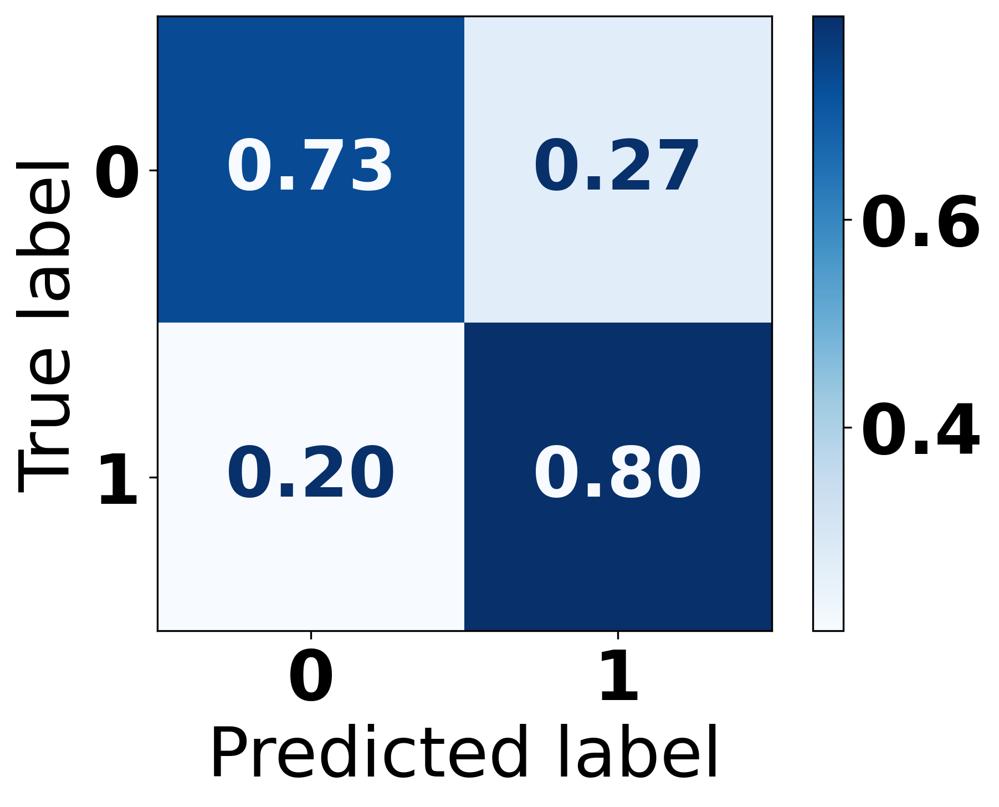

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.73      0.84    109244
           1       0.09      0.80      0.16      3708

    accuracy                           0.73    112952
   macro avg       0.54      0.76      0.50    112952
weighted avg       0.96      0.73      0.82    112952

Train Accuracy: 0.8012934348797188
Test Accuracy: 0.7333911750123946


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


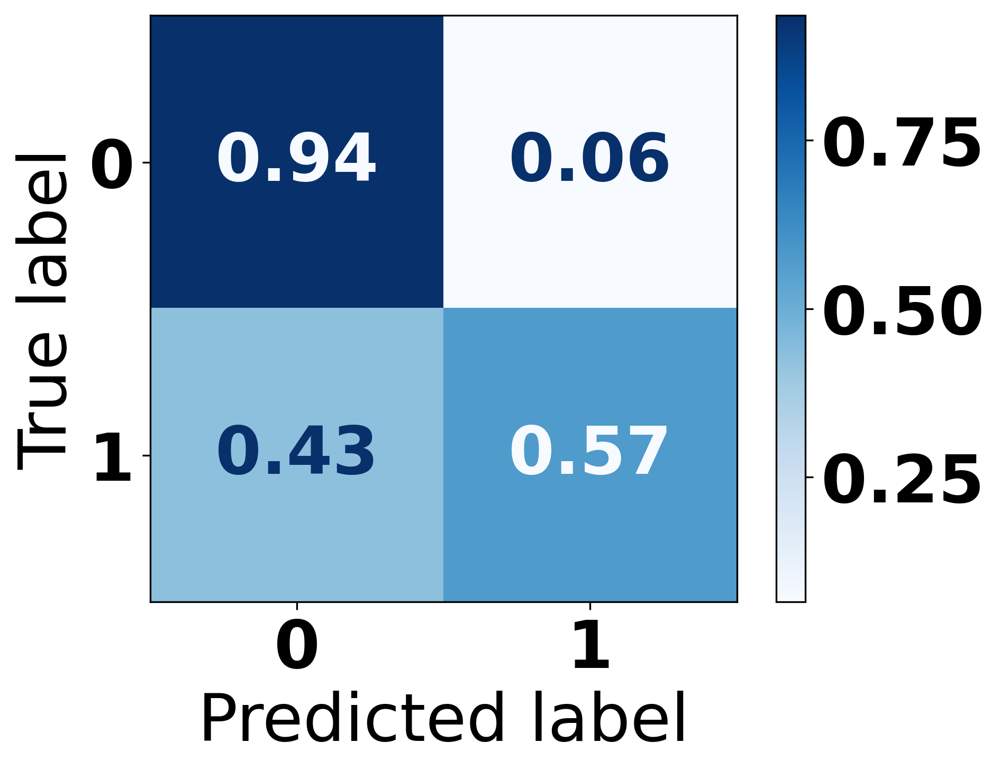

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.94      0.96    109244
           1       0.23      0.57      0.33      3708

    accuracy                           0.92    112952
   macro avg       0.61      0.75      0.64    112952
weighted avg       0.96      0.92      0.94    112952

Train Accuracy: 0.9051389549998169
Test Accuracy: 0.9232682909554502


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=10).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.92550621 0.07449379]
 [0.40614887 0.59385113]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.95    109244
     Class 1       0.21      0.59      0.31      3708

    accuracy                           0.91    112952
   macro avg       0.60      0.76      0.63    112952
weighted avg       0.96      0.91      0.93    112952



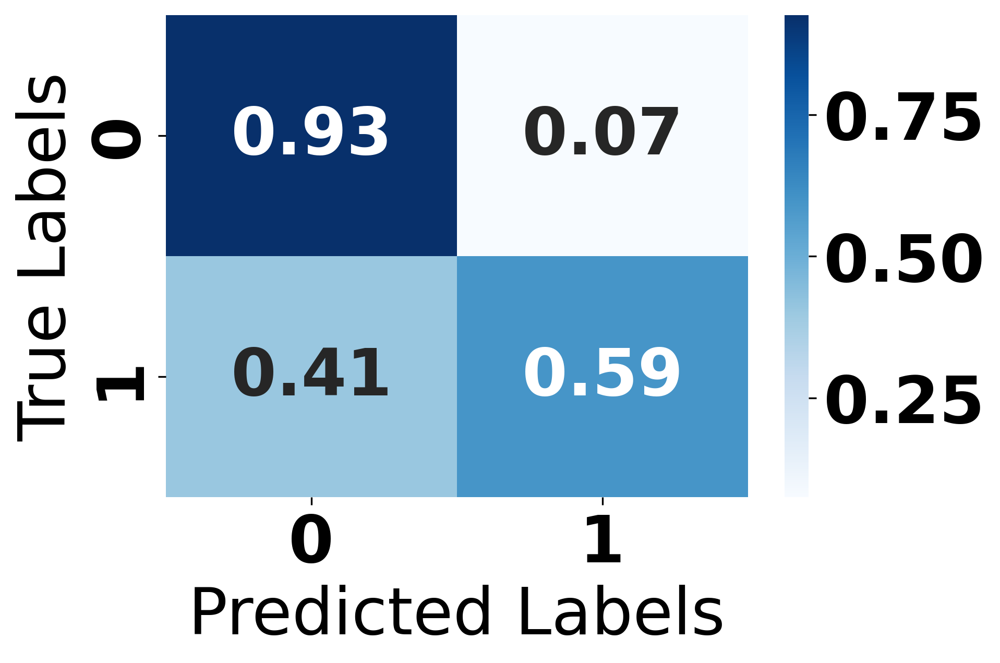

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1707/1707 [==============================] - 13s 7ms/step - loss: 0.5182 - accuracy: 0.7589 - val_loss: 0.2663 - val_accuracy: 0.8835
Epoch 2/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.3036 - accuracy: 0.8678 - val_loss: 0.4565 - val_accuracy: 0.7888
Epoch 3/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.2287 - accuracy: 0.9016 - val_loss: 0.1515 - val_accuracy: 0.9611
Epoch 4/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.2061 - accuracy: 0.9125 - val_loss: 0.1929 - val_accuracy: 0.9311
Epoch 5/10
1707/1707 [==============================] - 13s 8ms/step - loss: 0.1949 - accuracy: 0.9174 - val_loss: 0.2466 - val_accuracy: 0.9106
Epoch 6/10
1707/1707 [==============================] - 11s 7ms/step - loss: 0.1888 - accuracy: 0.9200 - val_loss: 0.1534 - val_accuracy: 0.9556
Epoch 7/10
1707/1707 [==============================] - 14s 8ms/step - loss: 0.1797 - accuracy: 0.9250 - val_loss: 0.2691 - val_ac

3530/3530 [==============================] - 8s 2ms/step
Normalized Confusion Matrix:
[[0.95768189 0.04231811]
 [0.75809061 0.24190939]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.96      0.97    109244
     Class 1       0.16      0.24      0.19      3708

    accuracy                           0.93    112952
   macro avg       0.57      0.60      0.58    112952
weighted avg       0.95      0.93      0.94    112952



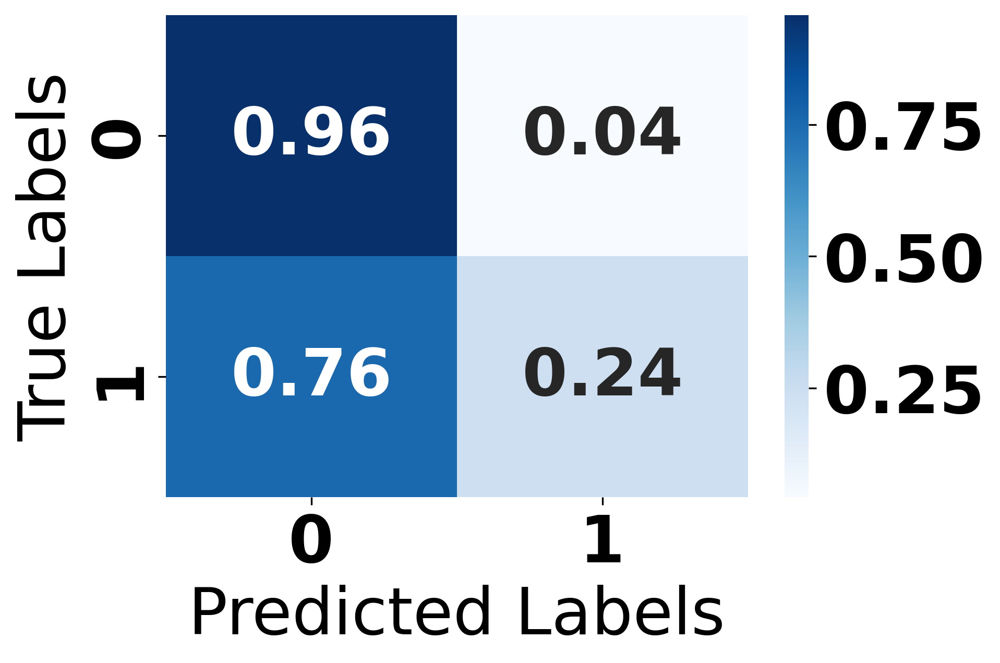

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=10).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1707/1707 [==============================] - 21s 11ms/step - loss: 0.4515 - accuracy: 0.7884 - val_loss: 0.4879 - val_accuracy: 0.7831
Epoch 2/10
1707/1707 [==============================] - 17s 10ms/step - loss: 0.3790 - accuracy: 0.8374 - val_loss: 0.8795 - val_accuracy: 0.5309
Epoch 3/10
1707/1707 [==============================] - 16s 9ms/step - loss: 0.3638 - accuracy: 0.8432 - val_loss: 0.2775 - val_accuracy: 0.9220
Epoch 4/10
1707/1707 [==============================] - 16s 9ms/step - loss: 0.3550 - accuracy: 0.8434 - val_loss: 0.2865 - val_accuracy: 0.8900
Epoch 5/10
1707/1707 [==============================] - 15s 9ms/step - loss: 0.3481 - accuracy: 0.8451 - val_loss: 0.2386 - val_accuracy: 0.9314
Epoch 6/10
1707/1707 [==============================] - 15s 9ms/step - loss: 0.3433 - accuracy: 0.8459 - val_loss: 0.2849 - val_accuracy: 0.9284
Epoch 7/10
1707/1707 [==============================] - 15s 9ms/step - loss: 0.3389 - accuracy: 0.8473 - val_loss: 0.1952 - val_

3530/3530 [==============================] - 9s 2ms/step
Normalized Confusion Matrix:
[[0.76263227 0.23736773]
 [0.20523193 0.79476807]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.76      0.86    109244
     Class 1       0.10      0.79      0.18      3708

    accuracy                           0.76    112952
   macro avg       0.55      0.78      0.52    112952
weighted avg       0.96      0.76      0.84    112952



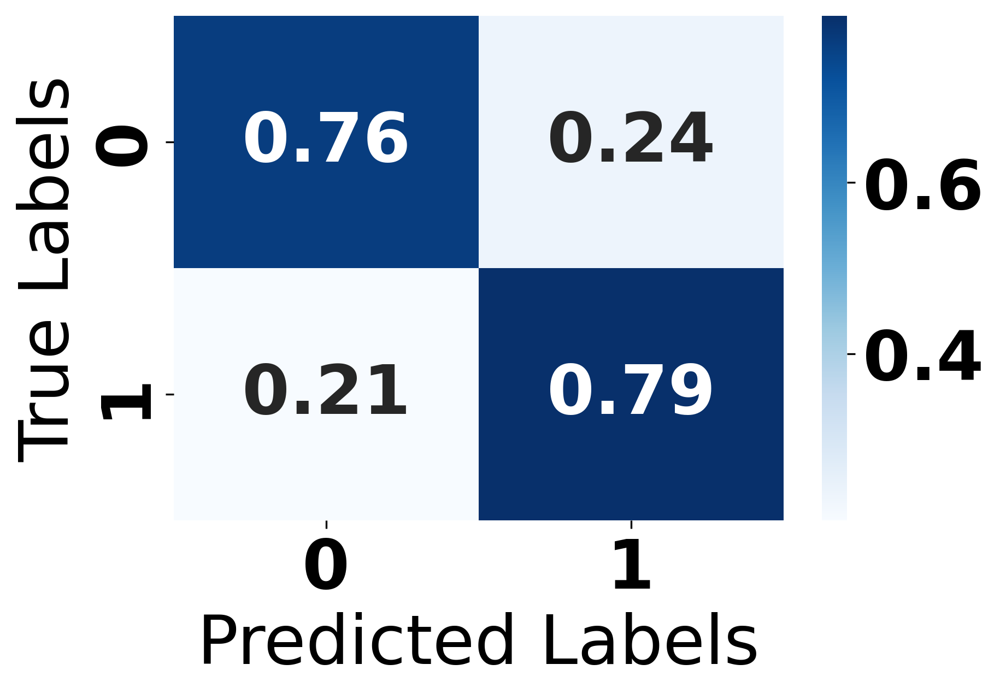

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
ANN_model.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/Model/ANN(SMOTE).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
ANN_model = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTE/Model/ANN(SMOTE).h5')

### Synthetic minority over-sampling technique (SMOTE) and Edited nearest neighbor (ENN)

In [ ]:
from imblearn.combine import SMOTEENN

# Initialize SMOTEENN
smoteenn = SMOTEENN()

# Fit and transform the training data
x_train_resampled, y_train_resampled = smoteenn.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save SMOTEENN data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/x_train_resampled(SMOTEENN).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/y_train_resampled(SMOTEENN).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/x_train_resampled(SMOTEENN).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/y_train_resampled(SMOTEENN).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    73131
dtype: int64
Class 1 count: 0    109090
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    73131
dtype: int64
Class 1 count: 0    109090
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

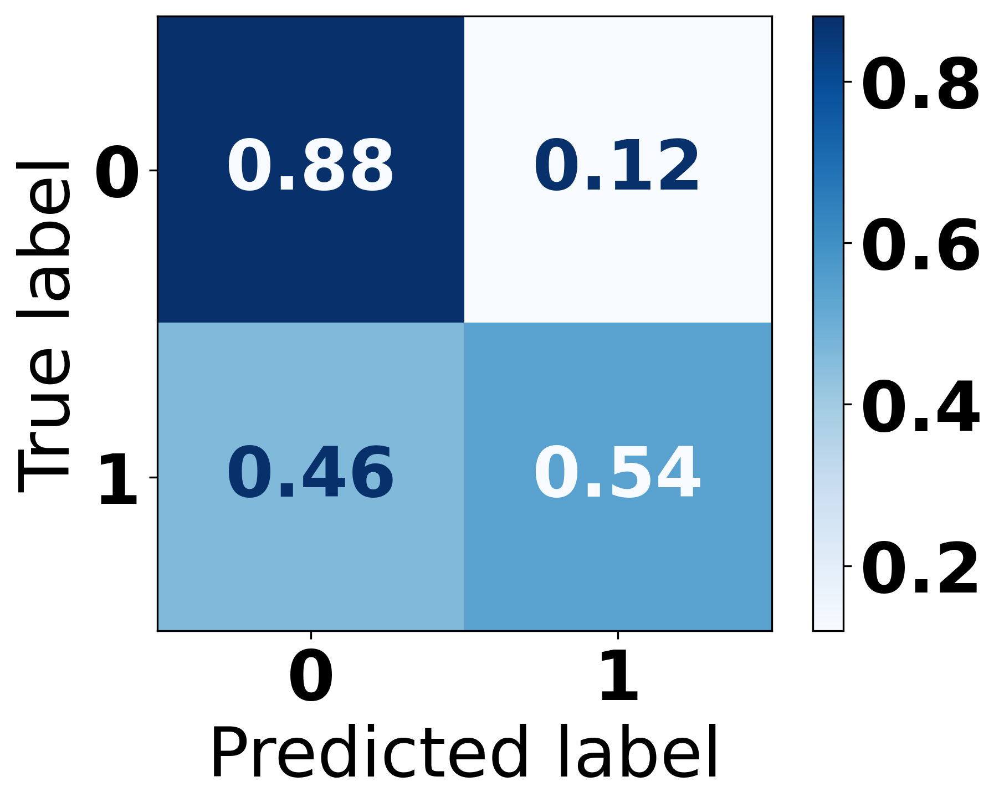

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.88      0.93    109244
     Class 1       0.13      0.54      0.21      3708

    accuracy                           0.87    112952
   macro avg       0.56      0.71      0.57    112952
weighted avg       0.95      0.87      0.91    112952

Train Accuracy: 1.0
Test Accuracy: 0.8694312628373114


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


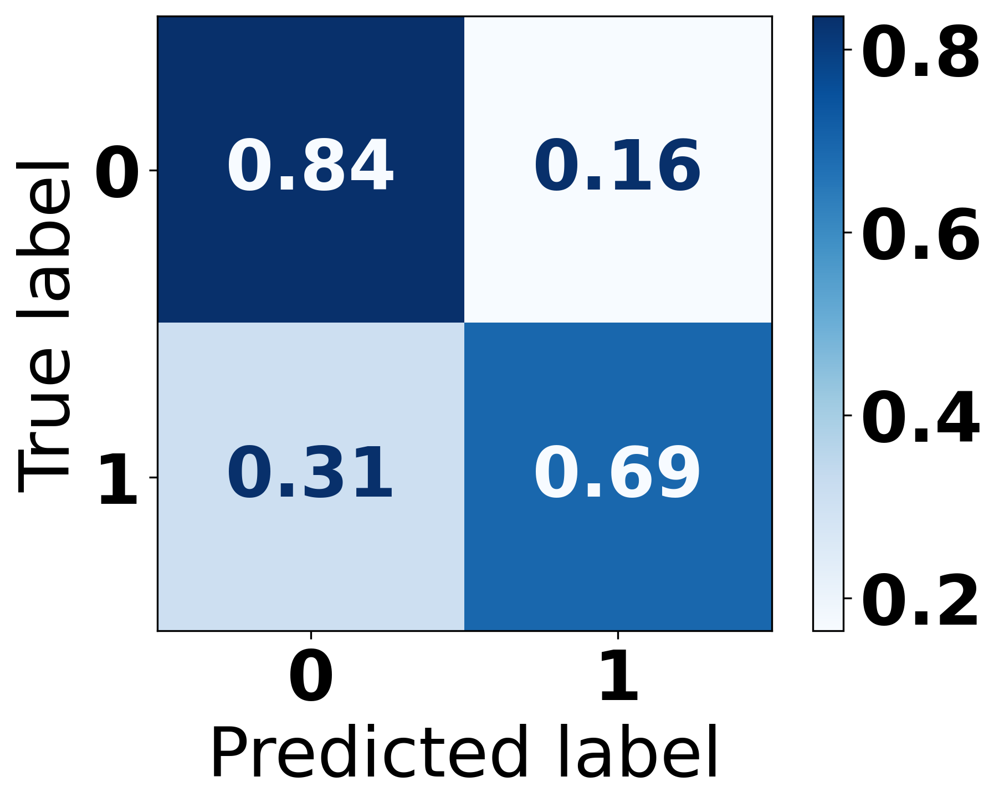

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91    109244
     Class 1       0.13      0.69      0.21      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.76      0.56    112952
weighted avg       0.96      0.83      0.88    112952

Train Accuracy: 0.9173421285142767
Test Accuracy: 0.8313708477937531


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-86-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


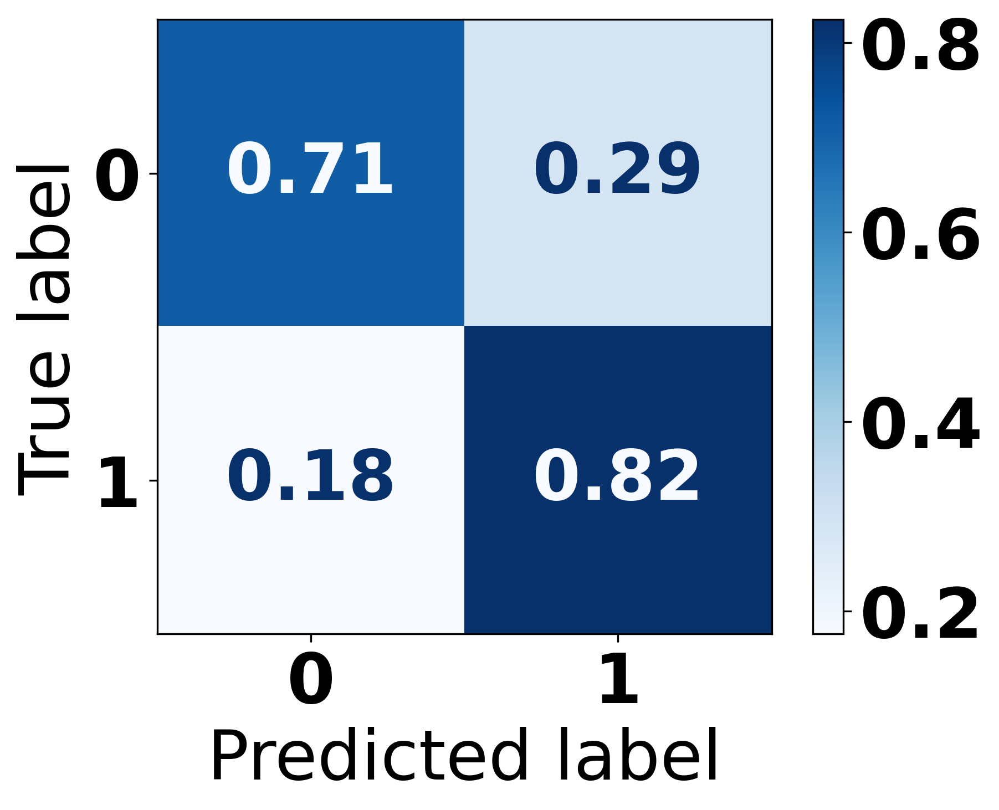

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.71      0.83    109244
           1       0.09      0.82      0.16      3708

    accuracy                           0.72    112952
   macro avg       0.54      0.77      0.49    112952
weighted avg       0.96      0.72      0.81    112952

Train Accuracy: 0.9072884025441634
Test Accuracy: 0.7154897655641335


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


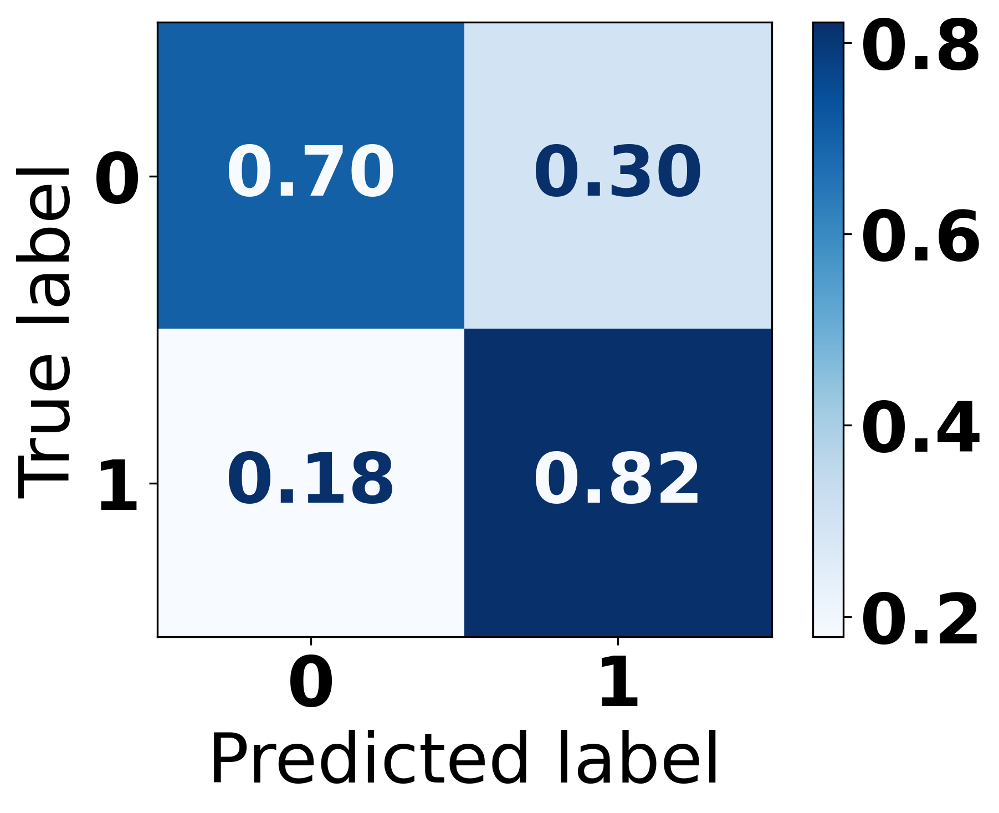

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.70      0.82    109244
           1       0.09      0.82      0.16      3708

    accuracy                           0.71    112952
   macro avg       0.54      0.76      0.49    112952
weighted avg       0.96      0.71      0.80    112952

Train Accuracy: 0.8621673681957623
Test Accuracy: 0.706964020114739


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


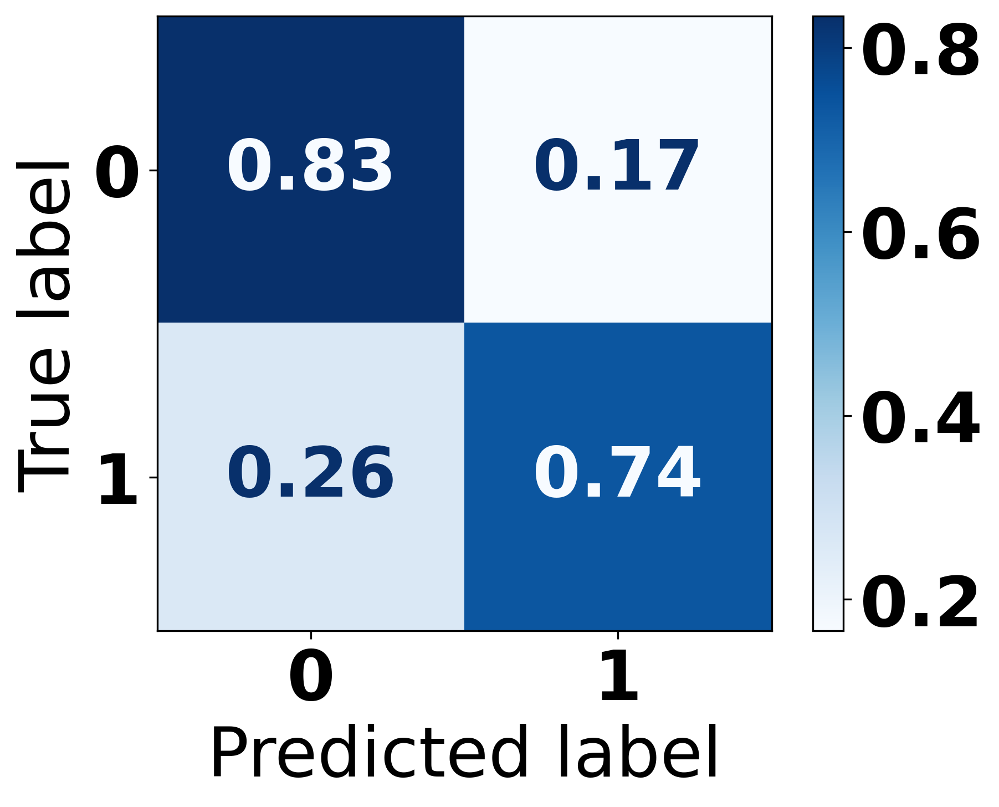

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.83      0.91    109244
           1       0.13      0.74      0.22      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.79      0.56    112952
weighted avg       0.96      0.83      0.88    112952

Train Accuracy: 0.9310288056810138
Test Accuracy: 0.8310521283377009


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(Adaboost, '/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/Model/AdaBoost(SMOTEENN).pkl')
"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/Model/AdaBoost(SMOTEENN).pkl']

In [ ]:
import joblib

# Load the model from file
Adaboost = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/SMOTEENN/Model/AdaBoost(SMOTEENN).pkl')

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.67634836 0.32365164]
 [0.12756203 0.87243797]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.68      0.80    109244
     Class 1       0.08      0.87      0.15      3708

    accuracy                           0.68    112952
   macro avg       0.54      0.77      0.48    112952
weighted avg       0.96      0.68      0.78    112952



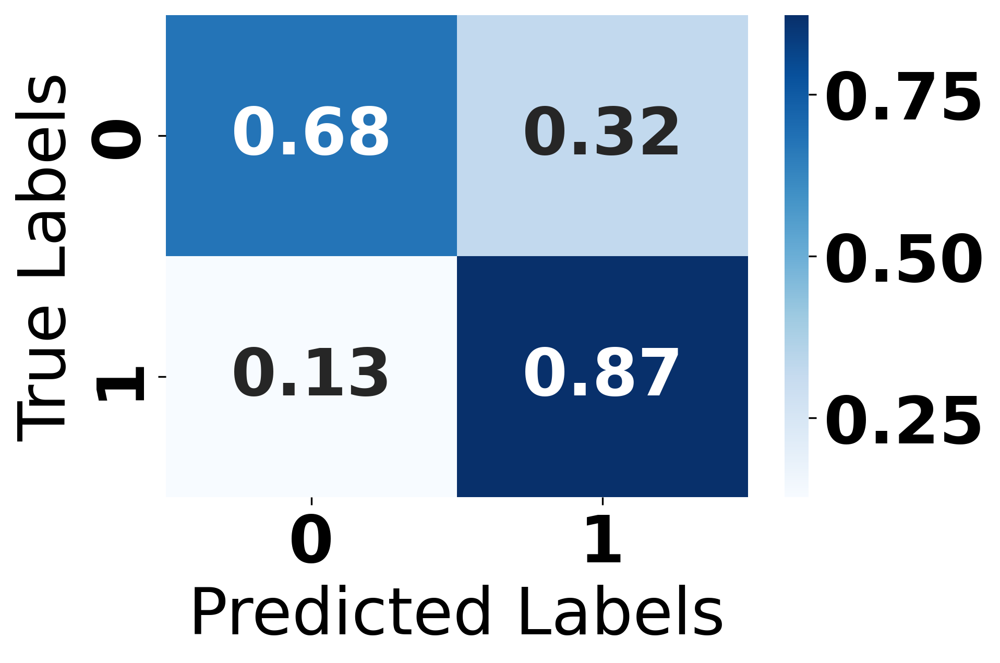

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1424/1424 [==============================] - 12s 7ms/step - loss: 0.4085 - accuracy: 0.8258 - val_loss: 0.5599 - val_accuracy: 0.7287
Epoch 2/10
1424/1424 [==============================] - 10s 7ms/step - loss: 0.2674 - accuracy: 0.8887 - val_loss: 0.6878 - val_accuracy: 0.7008
Epoch 3/10
1424/1424 [==============================] - 9s 7ms/step - loss: 0.2033 - accuracy: 0.9152 - val_loss: 0.3642 - val_accuracy: 0.8383
Epoch 4/10
1424/1424 [==============================] - 8s 6ms/step - loss: 0.1808 - accuracy: 0.9240 - val_loss: 0.3330 - val_accuracy: 0.8480
Epoch 5/10
1424/1424 [==============================] - 9s 7ms/step - loss: 0.1674 - accuracy: 0.9297 - val_loss: 0.5840 - val_accuracy: 0.7428
Epoch 6/10
1424/1424 [==============================] - 10s 7ms/step - loss: 0.1587 - accuracy: 0.9335 - val_loss: 0.2856 - val_accuracy: 0.8719
Epoch 7/10
1424/1424 [==============================] - 9s 6ms/step - loss: 0.1526 - accuracy: 0.9363 - val_loss: 0.2970 - val_accura

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.81150452 0.18849548]
 [0.3635383  0.6364617 ]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.81      0.89    109244
     Class 1       0.10      0.64      0.18      3708

    accuracy                           0.81    112952
   macro avg       0.54      0.72      0.53    112952
weighted avg       0.96      0.81      0.87    112952



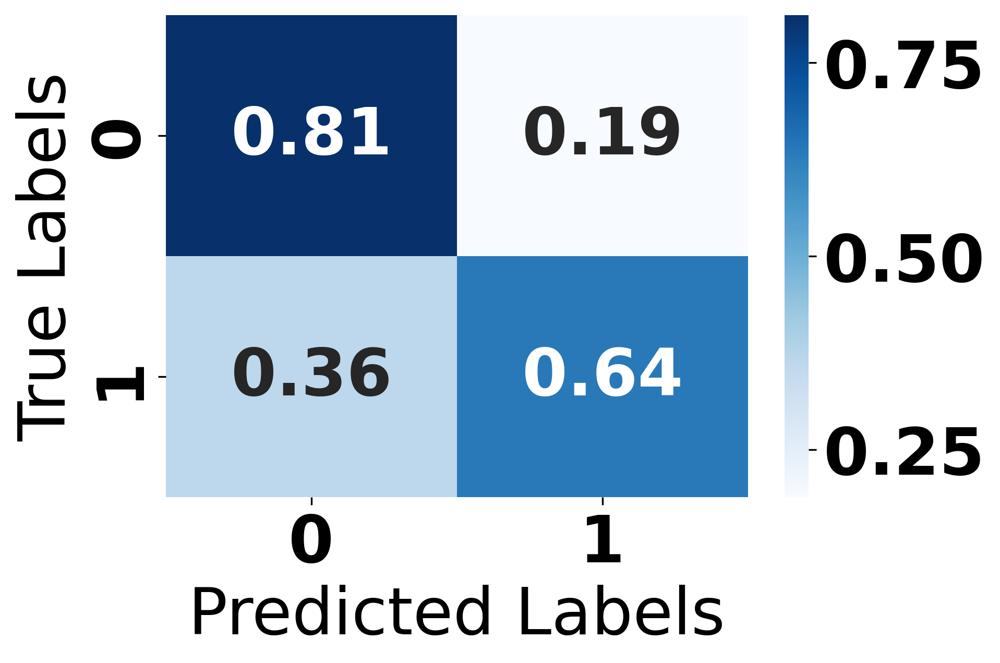

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1424/1424 [==============================] - 13s 7ms/step - loss: 0.3625 - accuracy: 0.8423 - val_loss: 0.6227 - val_accuracy: 0.7326
Epoch 2/10
1424/1424 [==============================] - 11s 8ms/step - loss: 0.2888 - accuracy: 0.8824 - val_loss: 1.1052 - val_accuracy: 0.5215
Epoch 3/10
1424/1424 [==============================] - 12s 8ms/step - loss: 0.2798 - accuracy: 0.8868 - val_loss: 0.7113 - val_accuracy: 0.6987
Epoch 4/10
1424/1424 [==============================] - 12s 8ms/step - loss: 0.2730 - accuracy: 0.8887 - val_loss: 0.2506 - val_accuracy: 0.9214
Epoch 5/10
1424/1424 [==============================] - 12s 8ms/step - loss: 0.2693 - accuracy: 0.8897 - val_loss: 0.4024 - val_accuracy: 0.8496
Epoch 6/10
1424/1424 [==============================] - 9s 7ms/step - loss: 0.2649 - accuracy: 0.8909 - val_loss: 0.3551 - val_accuracy: 0.8606
Epoch 7/10
1424/1424 [==============================] - 11s 7ms/step - loss: 0.2641 - accuracy: 0.8913 - val_loss: 1.8037 - val_acc

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.38781993 0.61218007]
 [0.03451996 0.96548004]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       1.00      0.39      0.56    109244
     Class 1       0.05      0.97      0.10      3708

    accuracy                           0.41    112952
   macro avg       0.52      0.68      0.33    112952
weighted avg       0.97      0.41      0.54    112952



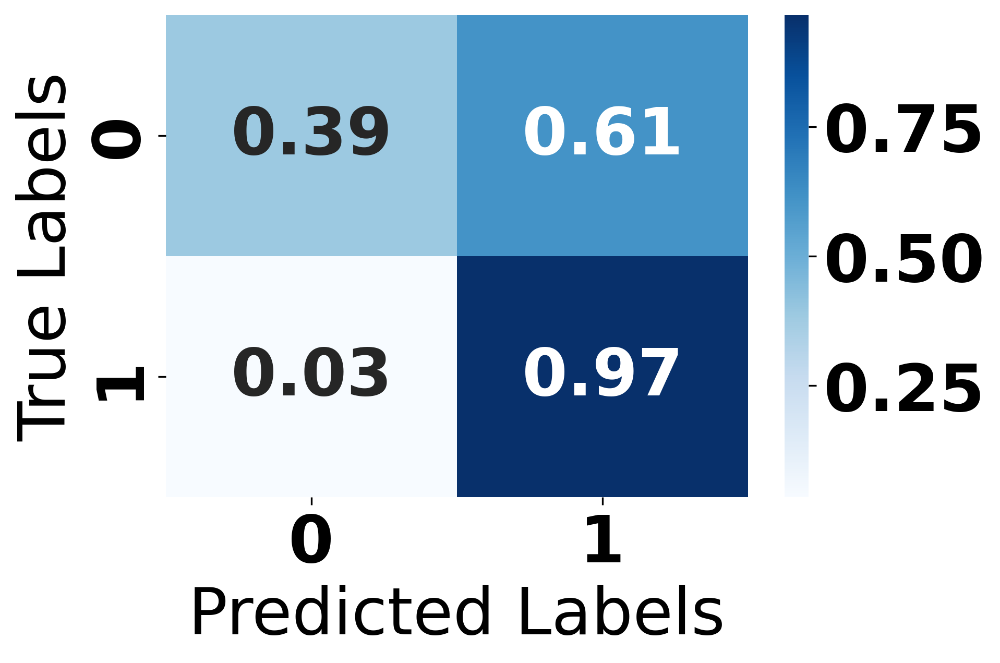

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Tomek Links

In [ ]:
from imblearn.under_sampling import TomekLinks

# Initialize TomekLinks
tomek_links = TomekLinks()

# Fit and transform the training data
x_train_resampled, y_train_resampled = tomek_links.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save TomekLinks data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/x_train_resampled(TomekLinks).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/y_train_resampled(TomekLinks).csv', index=False)

""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/x_train_resampled(TomekLinks).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/y_train_resampled(TomekLinks).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    107129
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    107129
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

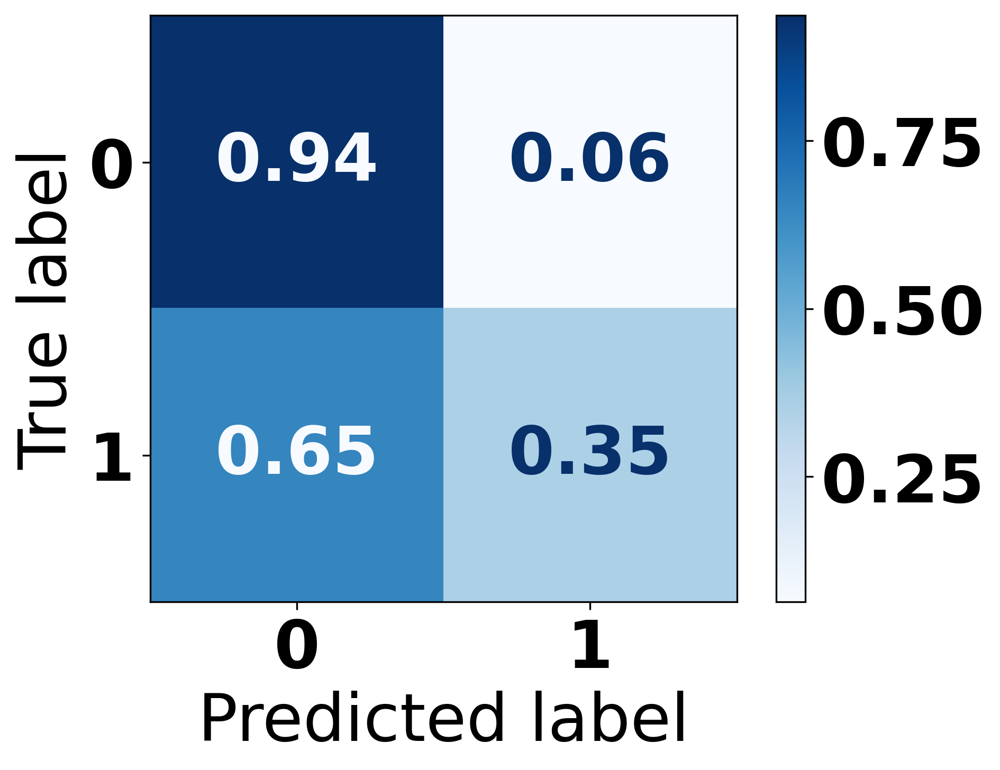

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.94      0.96    109244
     Class 1       0.16      0.35      0.22      3708

    accuracy                           0.92    112952
   macro avg       0.57      0.64      0.59    112952
weighted avg       0.95      0.92      0.93    112952

Train Accuracy: 1.0
Test Accuracy: 0.9171595013811177


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


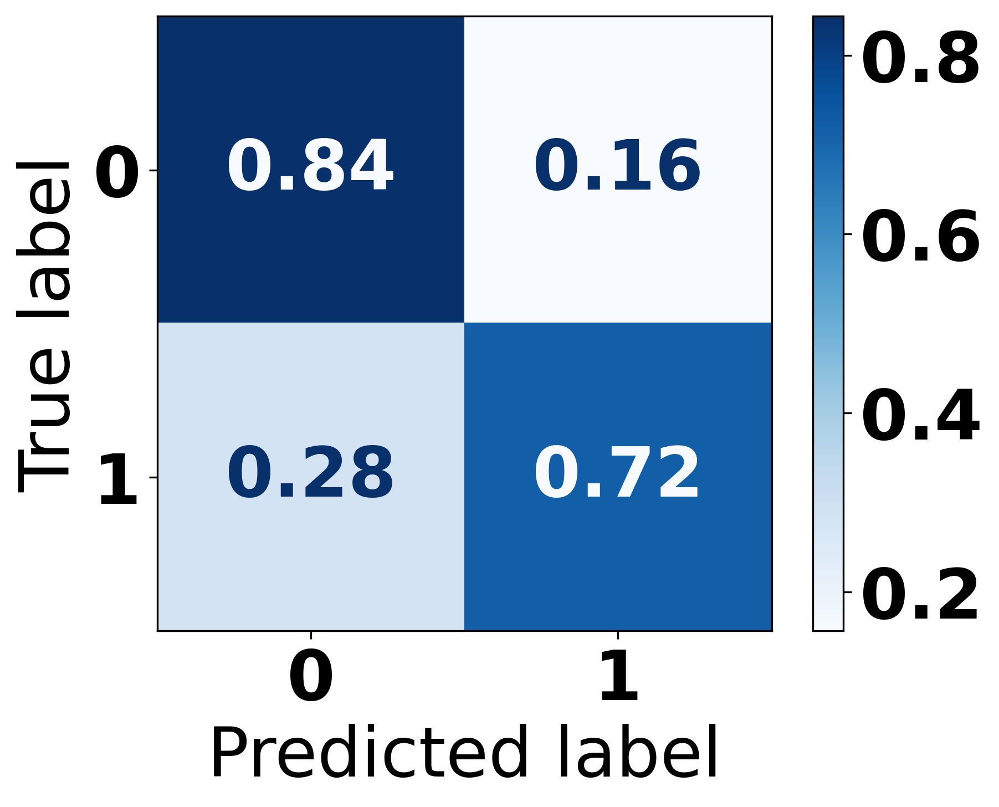

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.84      0.91    109244
     Class 1       0.13      0.72      0.23      3708

    accuracy                           0.84    112952
   macro avg       0.56      0.78      0.57    112952
weighted avg       0.96      0.84      0.89    112952

Train Accuracy: 0.8416193059130405
Test Accuracy: 0.8393122742403853


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-106-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


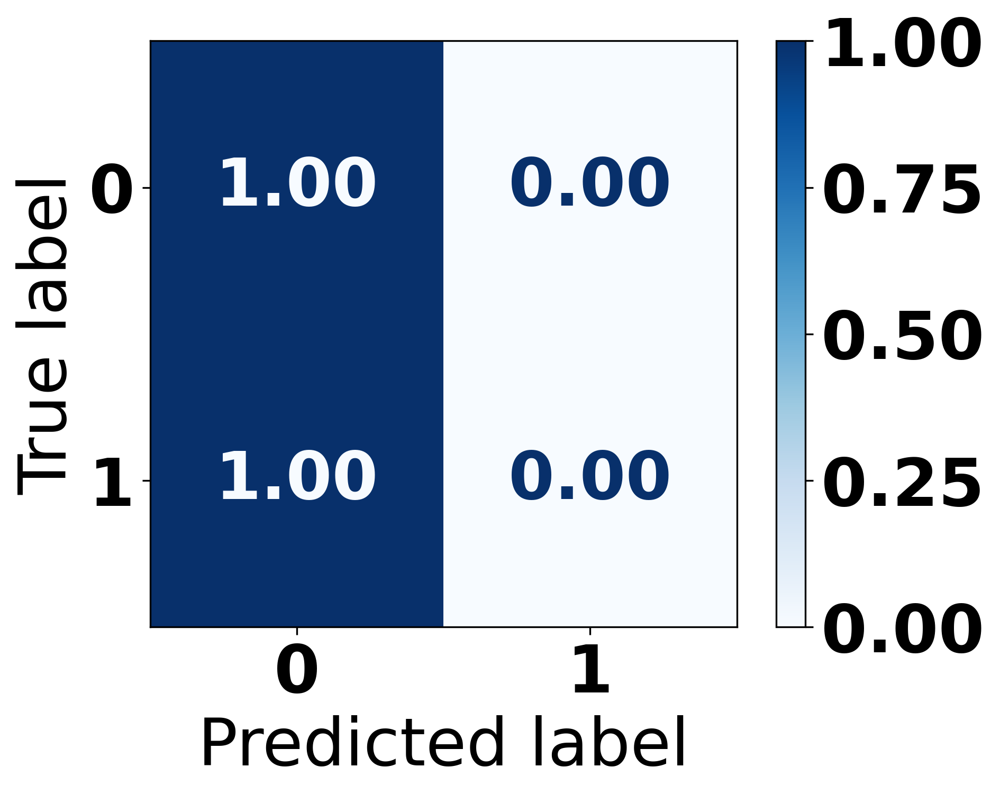

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Classification Report:
               precision    recall  f1-score   support

           0       0.97      1.00      0.98    109244
           1       0.00      0.00      0.00      3708

    accuracy                           0.97    112952
   macro avg       0.48      0.50      0.49    112952
weighted avg       0.94      0.97      0.95    112952

Train Accuracy: 0.9252966884900413
Test Accuracy: 0.9671718960266308


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


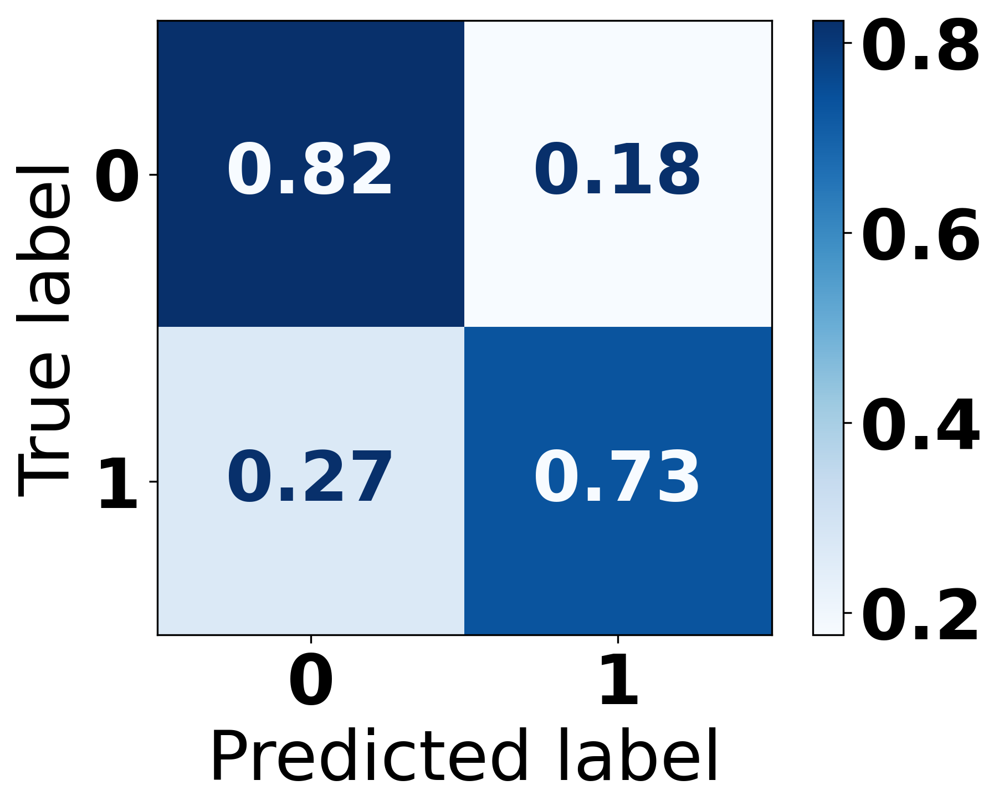

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.82      0.90    109244
           1       0.12      0.73      0.21      3708

    accuracy                           0.82    112952
   macro avg       0.56      0.78      0.55    112952
weighted avg       0.96      0.82      0.88    112952

Train Accuracy: 0.8222805714384426
Test Accuracy: 0.8202156668319286


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(GNB, '/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/Model/GNB(TOMEK).pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/Model/GNB(TOMEK).pkl']

In [ ]:
import joblib

# Load the model from file
GNB = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/TOMEK/Model/GNB(TOMEK).pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


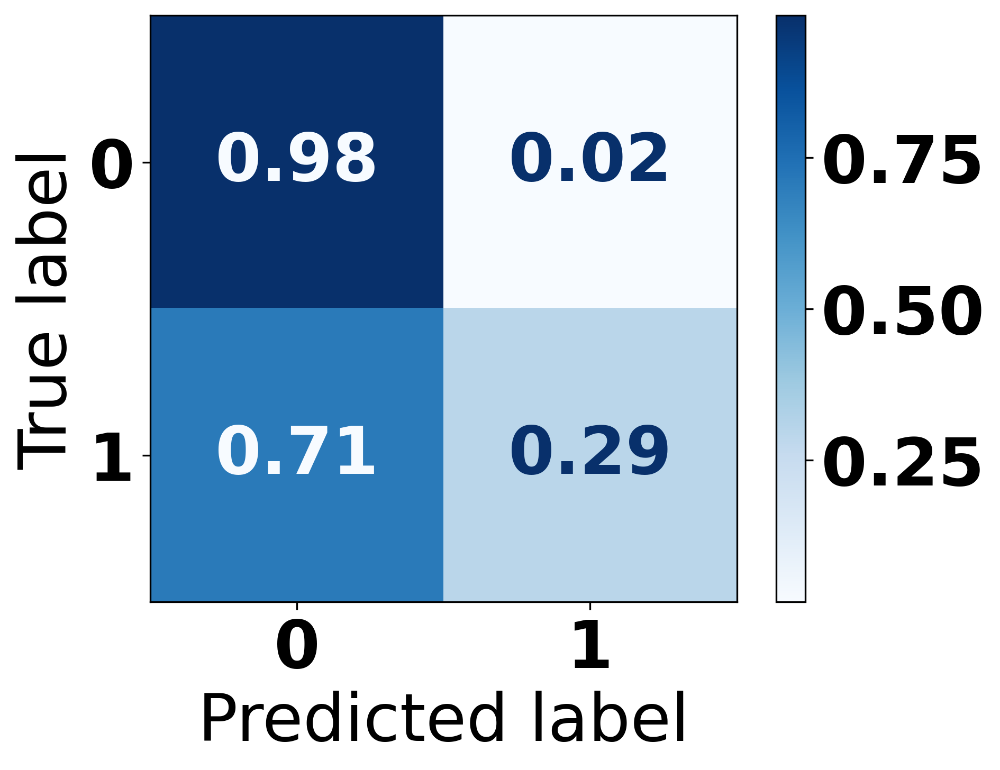

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.98      0.98    109244
           1       0.39      0.29      0.34      3708

    accuracy                           0.96    112952
   macro avg       0.68      0.64      0.66    112952
weighted avg       0.96      0.96      0.96    112952

Train Accuracy: 0.9358859196047609
Test Accuracy: 0.9619395849564417


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=20).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (20) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.98285489 0.01714511]
 [0.66990291 0.33009709]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.98      0.98    109244
     Class 1       0.40      0.33      0.36      3708

    accuracy                           0.96    112952
   macro avg       0.69      0.66      0.67    112952
weighted avg       0.96      0.96      0.96    112952



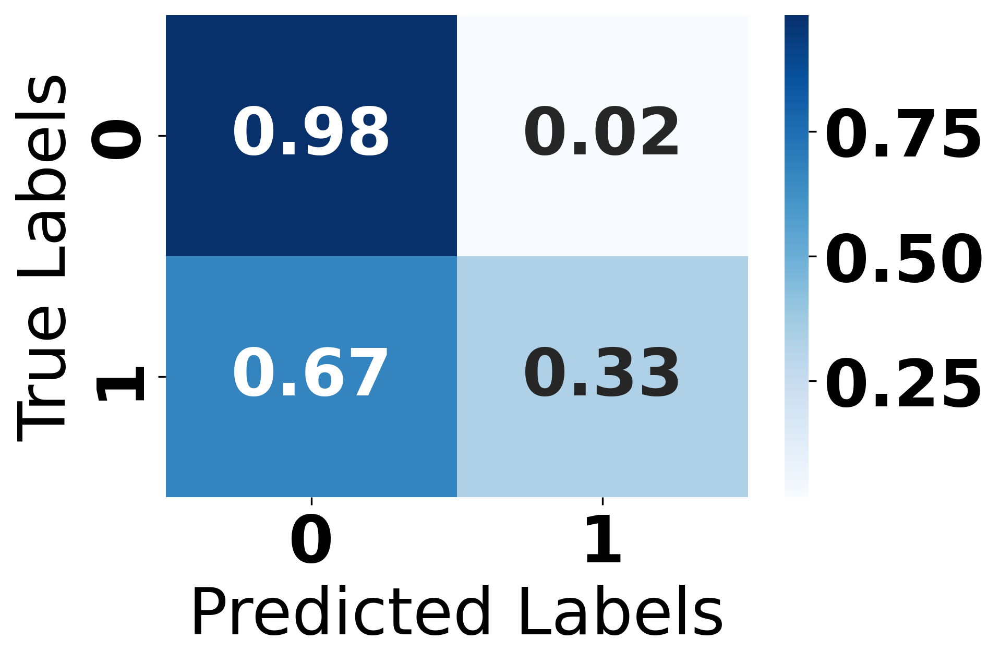

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
905/905 [==============================] - 12s 10ms/step - loss: 0.2939 - accuracy: 0.9220 - val_loss: 0.1534 - val_accuracy: 0.9621
Epoch 2/10
905/905 [==============================] - 8s 9ms/step - loss: 0.2270 - accuracy: 0.9241 - val_loss: 0.1240 - val_accuracy: 0.9671
Epoch 3/10
905/905 [==============================] - 6s 7ms/step - loss: 0.2170 - accuracy: 0.9251 - val_loss: 0.1480 - val_accuracy: 0.9629
Epoch 4/10
905/905 [==============================] - 7s 8ms/step - loss: 0.2145 - accuracy: 0.9251 - val_loss: 0.1419 - val_accuracy: 0.9653
Epoch 5/10
905/905 [==============================] - 7s 8ms/step - loss: 0.2113 - accuracy: 0.9255 - val_loss: 0.1413 - val_accuracy: 0.9667
Epoch 6/10
905/905 [==============================] - 8s 8ms/step - loss: 0.2103 - accuracy: 0.9256 - val_loss: 0.1375 - val_accuracy: 0.9651
Epoch 7/10
905/905 [==============================] - 7s 7ms/step - loss: 0.2101 - accuracy: 0.9256 - val_loss: 0.1337 - val_accuracy: 0.9664
Epoc

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[9.99057156e-01 9.42843543e-04]
 [9.88133765e-01 1.18662352e-02]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      1.00      0.98    109244
     Class 1       0.30      0.01      0.02      3708

    accuracy                           0.97    112952
   macro avg       0.63      0.51      0.50    112952
weighted avg       0.95      0.97      0.95    112952



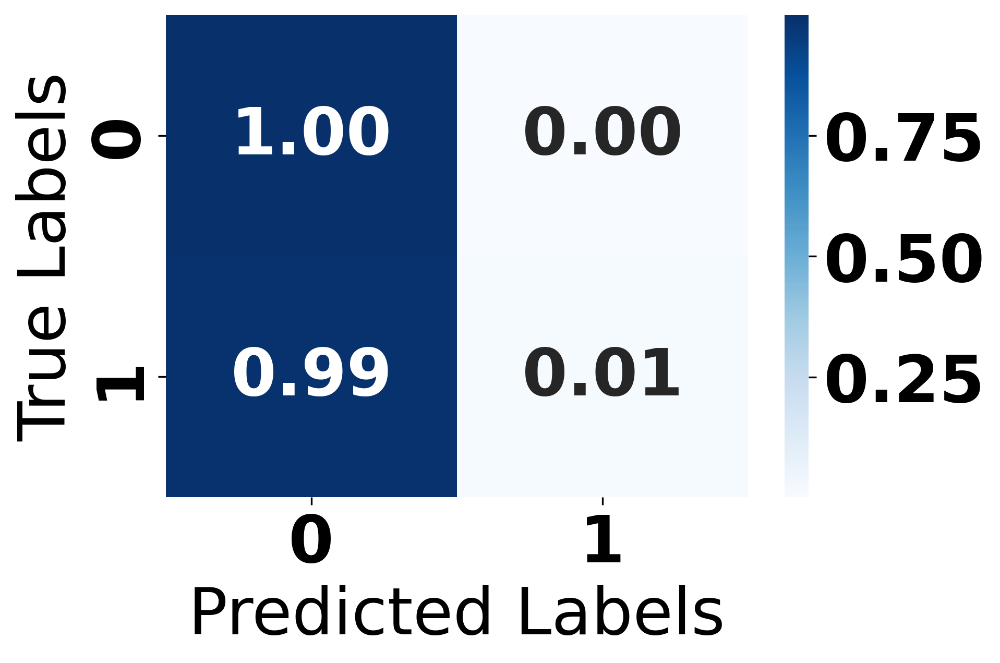

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
905/905 [==============================] - 10s 8ms/step - loss: 0.2916 - accuracy: 0.9029 - val_loss: 0.1541 - val_accuracy: 0.9672
Epoch 2/10
905/905 [==============================] - 8s 8ms/step - loss: 0.2057 - accuracy: 0.9267 - val_loss: 0.1369 - val_accuracy: 0.9672
Epoch 3/10
905/905 [==============================] - 8s 9ms/step - loss: 0.1948 - accuracy: 0.9298 - val_loss: 0.1379 - val_accuracy: 0.9672
Epoch 4/10
905/905 [==============================] - 8s 9ms/step - loss: 0.1897 - accuracy: 0.9309 - val_loss: 0.1190 - val_accuracy: 0.9672
Epoch 5/10
905/905 [==============================] - 12s 14ms/step - loss: 0.1876 - accuracy: 0.9313 - val_loss: 0.1700 - val_accuracy: 0.9670
Epoch 6/10
905/905 [==============================] - 11s 12ms/step - loss: 0.1863 - accuracy: 0.9318 - val_loss: 0.1259 - val_accuracy: 0.9675
Epoch 7/10
905/905 [==============================] - 9s 10ms/step - loss: 0.1839 - accuracy: 0.9322 - val_loss: 0.1249 - val_accuracy: 0.9672


3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.98803596 0.01196404]
 [0.73840345 0.26159655]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.99      0.98    109244
     Class 1       0.43      0.26      0.32      3708

    accuracy                           0.96    112952
   macro avg       0.70      0.62      0.65    112952
weighted avg       0.96      0.96      0.96    112952



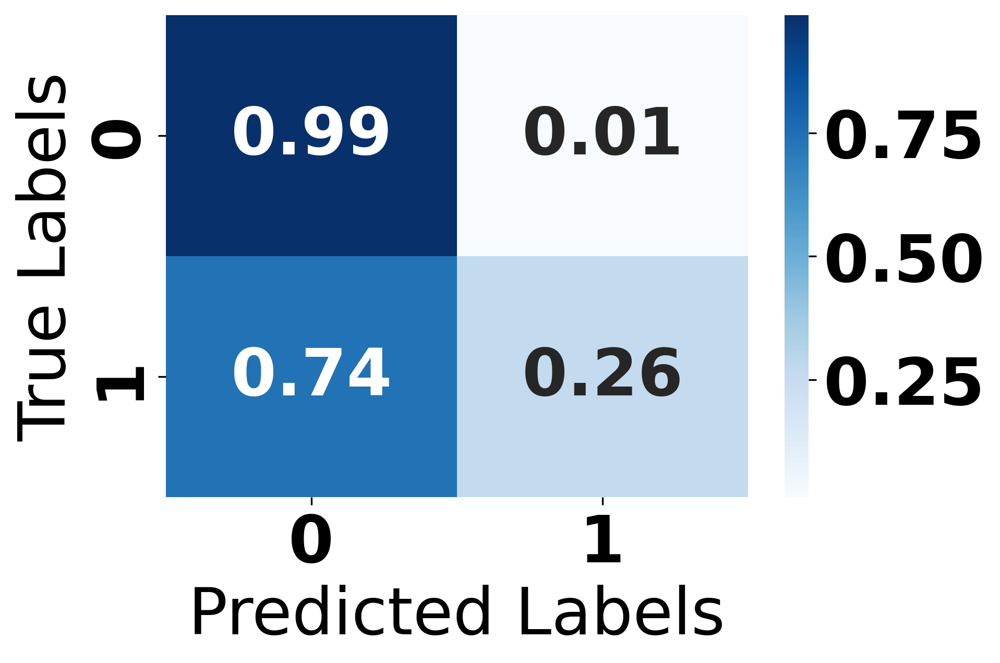

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Adaptive Synthetic Sampling

In [ ]:
from imblearn.over_sampling import ADASYN

# Initialize ADASYN
adasyn = ADASYN(random_state=42)

# Fit and transform the training data
x_train_resampled, y_train_resampled = adasyn.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save ADASYN data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/x_train_resampled(ADASYN).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/y_train_resampled(ADASYN).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/x_train_resampled(ADASYN).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/y_train_resampled(ADASYN).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    110304
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    110304
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

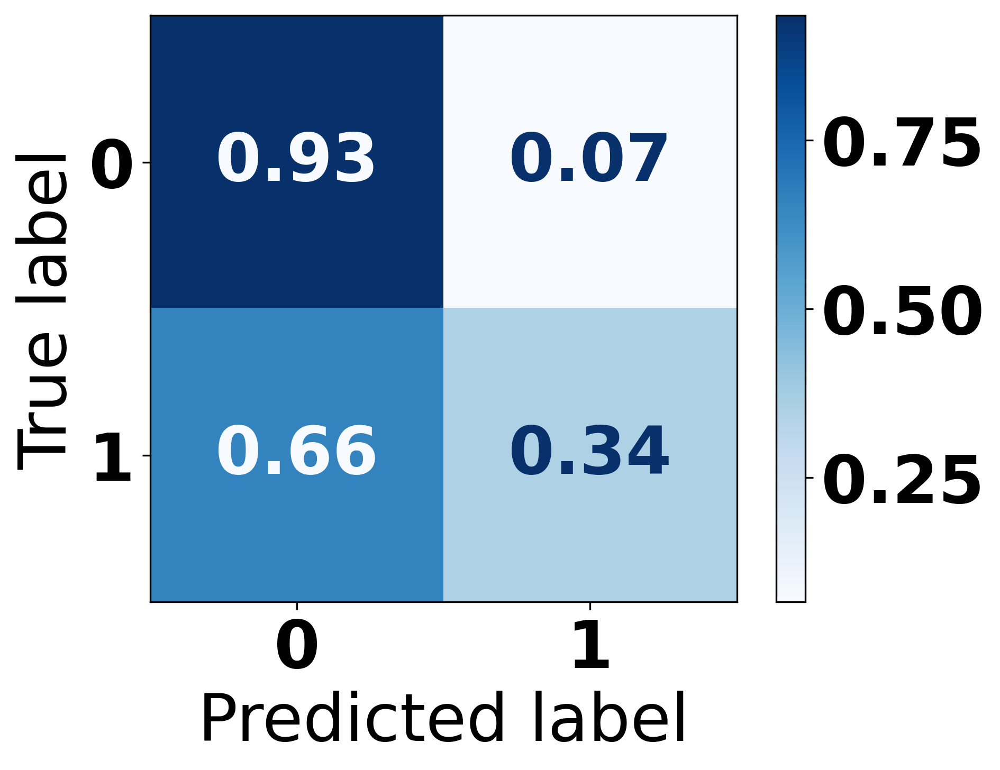

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.93      0.96    109244
     Class 1       0.15      0.34      0.21      3708

    accuracy                           0.92    112952
   macro avg       0.56      0.64      0.58    112952
weighted avg       0.95      0.92      0.93    112952

Train Accuracy: 1.0
Test Accuracy: 0.9152117713719102


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


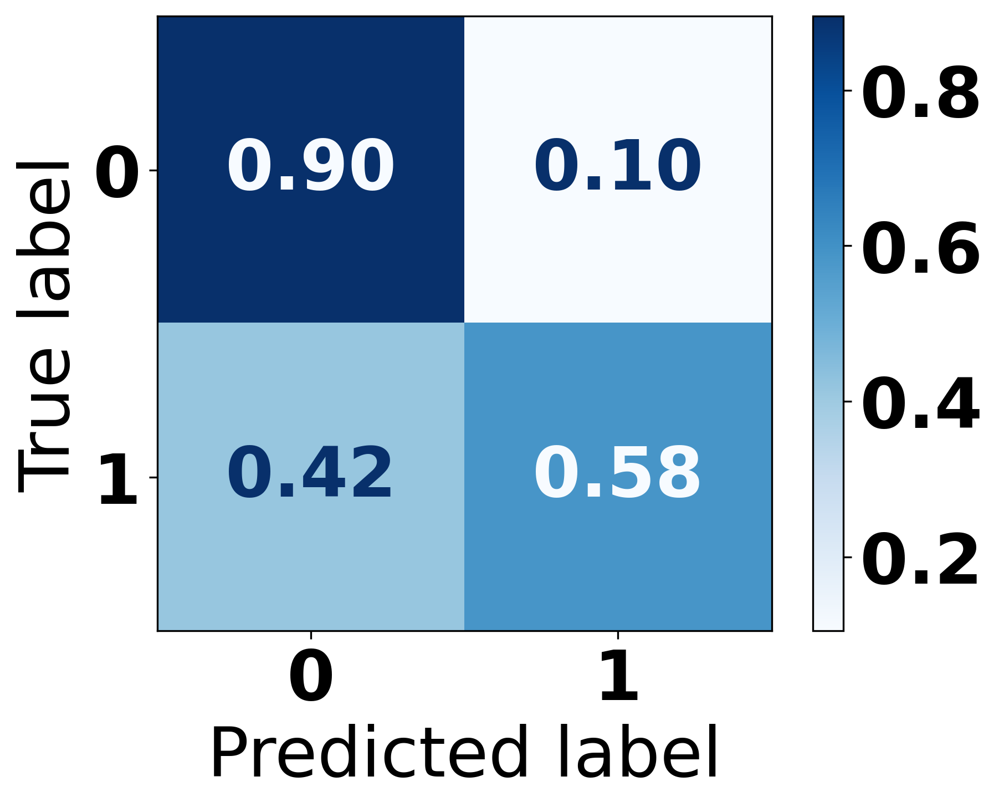

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94    109244
     Class 1       0.16      0.58      0.25      3708

    accuracy                           0.88    112952
   macro avg       0.57      0.74      0.59    112952
weighted avg       0.96      0.88      0.92    112952

Train Accuracy: 0.8938364275693698
Test Accuracy: 0.8848094765918266


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-141-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


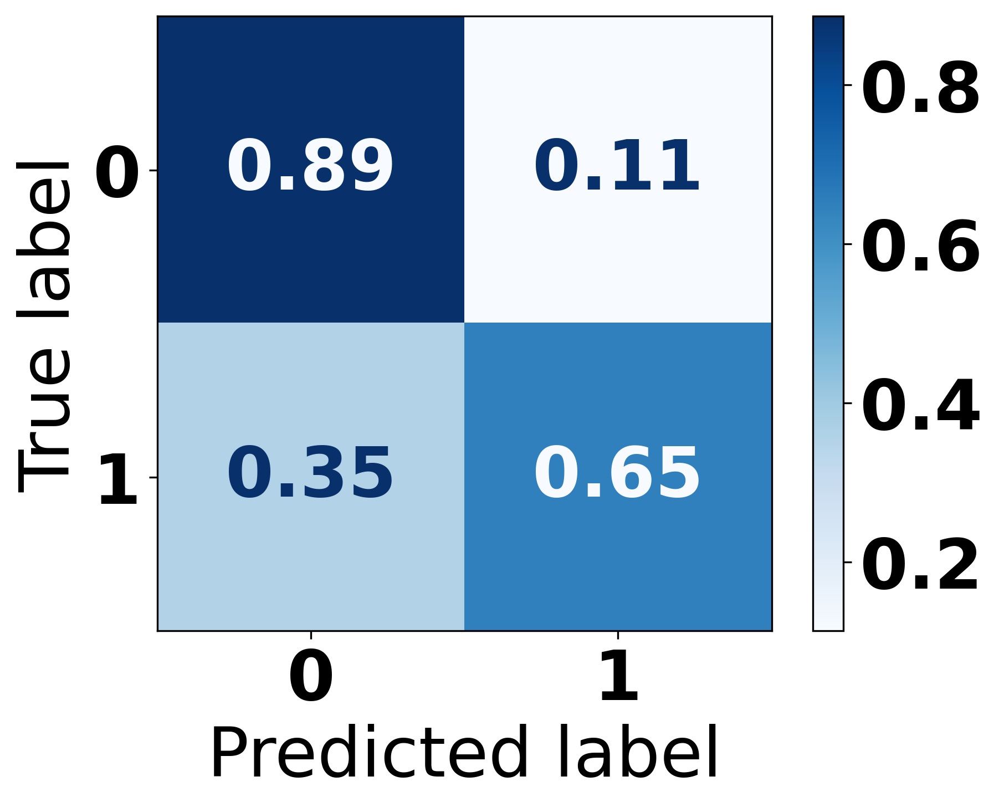

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.89      0.93    109244
           1       0.16      0.65      0.26      3708

    accuracy                           0.88    112952
   macro avg       0.57      0.77      0.60    112952
weighted avg       0.96      0.88      0.91    112952

Train Accuracy: 0.8879971577969282
Test Accuracy: 0.8785944471988101


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


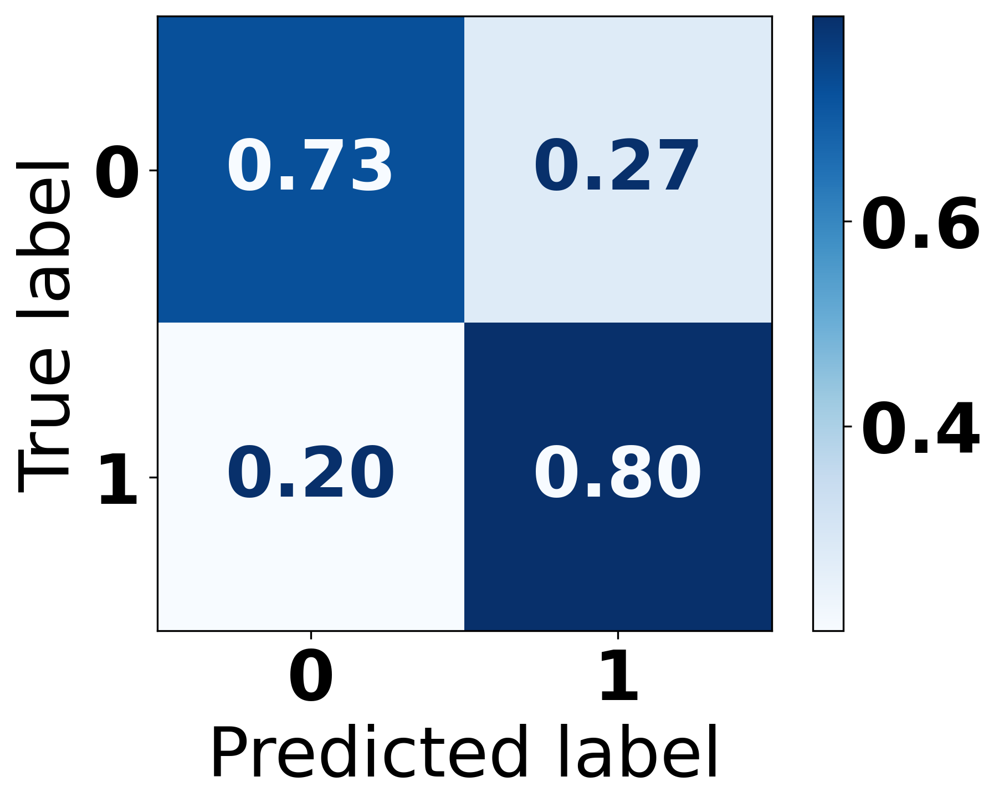

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.73      0.84    109244
           1       0.09      0.80      0.16      3708

    accuracy                           0.73    112952
   macro avg       0.54      0.76      0.50    112952
weighted avg       0.96      0.73      0.82    112952

Train Accuracy: 0.7955754550257802
Test Accuracy: 0.7292832353566117


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


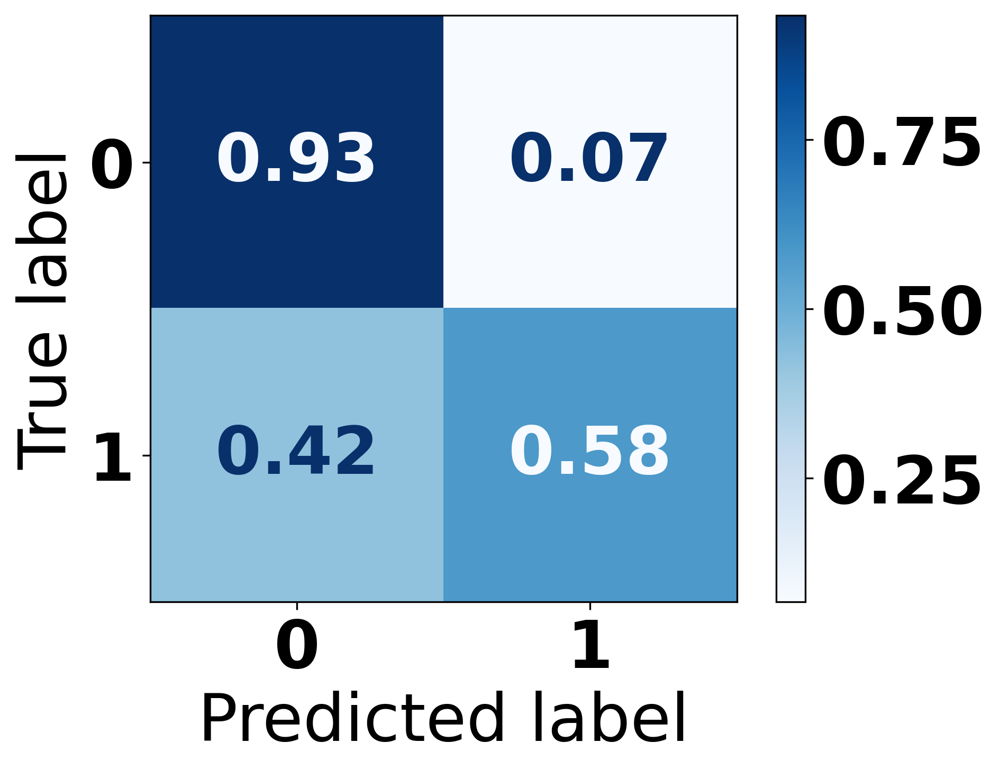

Classification Report:
               precision    recall  f1-score   support

           0       0.98      0.93      0.96    109244
           1       0.23      0.58      0.33      3708

    accuracy                           0.92    112952
   macro avg       0.61      0.76      0.64    112952
weighted avg       0.96      0.92      0.94    112952

Train Accuracy: 0.902016871025926
Test Accuracy: 0.9211346412635456


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=17, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=10).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.76427081 0.23572919]
 [0.19606257 0.80393743]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.76      0.86    109244
     Class 1       0.10      0.80      0.18      3708

    accuracy                           0.77    112952
   macro avg       0.55      0.78      0.52    112952
weighted avg       0.96      0.77      0.84    112952



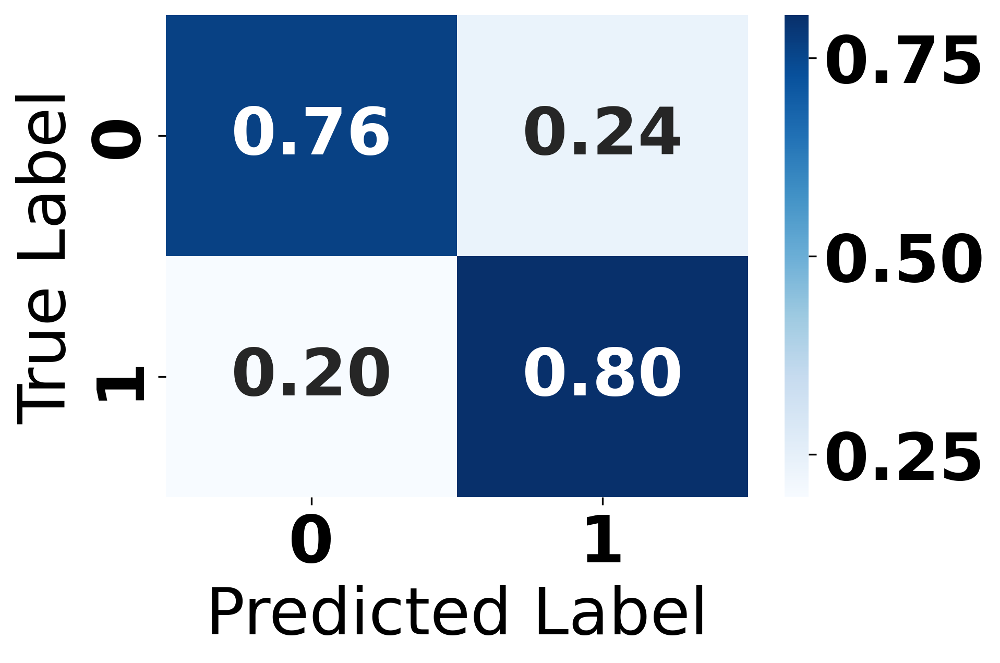

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(clf, '/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/Model/MLP(ADASYN).pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/Model/MLP(ADASYN).pkl']

In [ ]:
import joblib

# Load the model from file
MLP = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/ADASYN/Model/MLP(ADASYN).pkl')

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1716/1716 [==============================] - 14s 7ms/step - loss: 0.5066 - accuracy: 0.7753 - val_loss: 0.6145 - val_accuracy: 0.6812
Epoch 2/10
1716/1716 [==============================] - 11s 7ms/step - loss: 0.2689 - accuracy: 0.8838 - val_loss: 0.1707 - val_accuracy: 0.9435
Epoch 3/10
1716/1716 [==============================] - 12s 7ms/step - loss: 0.2133 - accuracy: 0.9091 - val_loss: 0.1412 - val_accuracy: 0.9618
Epoch 4/10
1716/1716 [==============================] - 11s 6ms/step - loss: 0.1972 - accuracy: 0.9161 - val_loss: 0.1390 - val_accuracy: 0.9631
Epoch 5/10
1716/1716 [==============================] - 11s 6ms/step - loss: 0.1878 - accuracy: 0.9210 - val_loss: 0.1911 - val_accuracy: 0.9395
Epoch 6/10
1716/1716 [==============================] - 11s 6ms/step - loss: 0.1819 - accuracy: 0.9236 - val_loss: 0.2816 - val_accuracy: 0.8912
Epoch 7/10
1716/1716 [==============================] - 11s 6ms/step - loss: 0.1804 - accuracy: 0.9246 - val_loss: 0.1390 - val_ac

3530/3530 [==============================] - 13s 4ms/step
Normalized Confusion Matrix:
[[0.98577496 0.01422504]
 [0.88430421 0.11569579]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.99      0.98    109244
     Class 1       0.22      0.12      0.15      3708

    accuracy                           0.96    112952
   macro avg       0.59      0.55      0.56    112952
weighted avg       0.95      0.96      0.95    112952



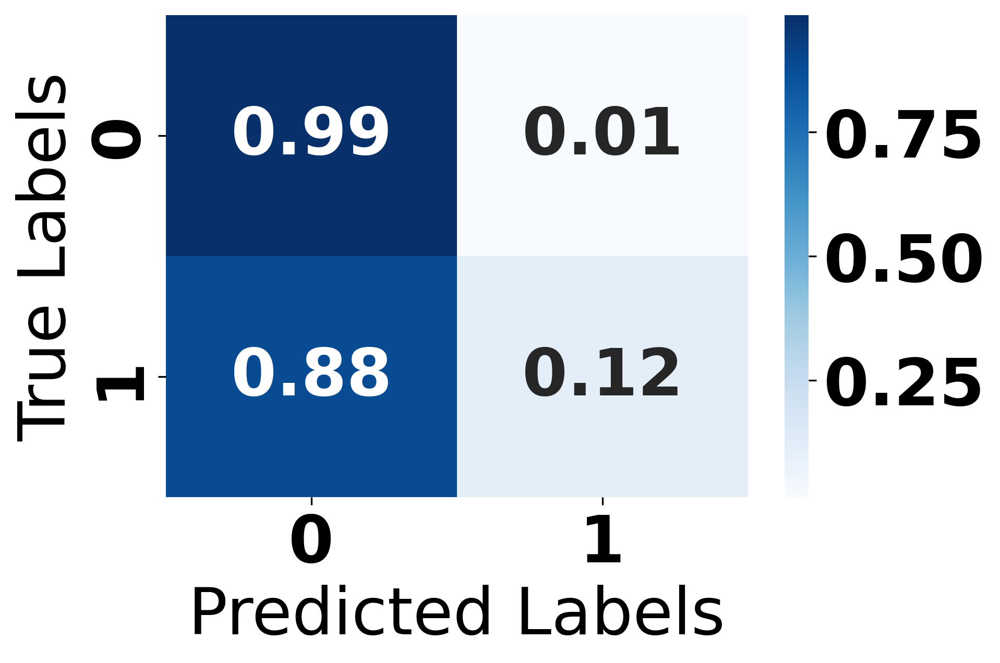

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1716/1716 [==============================] - 28s 13ms/step - loss: 0.4608 - accuracy: 0.7829 - val_loss: 1.6667 - val_accuracy: 0.1619
Epoch 2/10
1716/1716 [==============================] - 18s 11ms/step - loss: 0.3915 - accuracy: 0.8286 - val_loss: 0.9854 - val_accuracy: 0.5026
Epoch 3/10
1716/1716 [==============================] - 21s 13ms/step - loss: 0.3759 - accuracy: 0.8355 - val_loss: 0.4837 - val_accuracy: 0.7789
Epoch 4/10
1716/1716 [==============================] - 16s 9ms/step - loss: 0.3665 - accuracy: 0.8368 - val_loss: 0.6696 - val_accuracy: 0.6665
Epoch 5/10
1716/1716 [==============================] - 13s 7ms/step - loss: 0.3599 - accuracy: 0.8386 - val_loss: 0.1714 - val_accuracy: 0.9509
Epoch 6/10
1716/1716 [==============================] - 12s 7ms/step - loss: 0.3555 - accuracy: 0.8392 - val_loss: 0.2767 - val_accuracy: 0.8910
Epoch 7/10
1716/1716 [==============================] - 12s 7ms/step - loss: 0.3507 - accuracy: 0.8414 - val_loss: 0.2048 - val

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.89145399 0.10854601]
 [0.33737864 0.66262136]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94    109244
     Class 1       0.17      0.66      0.27      3708

    accuracy                           0.88    112952
   macro avg       0.58      0.78      0.60    112952
weighted avg       0.96      0.88      0.92    112952



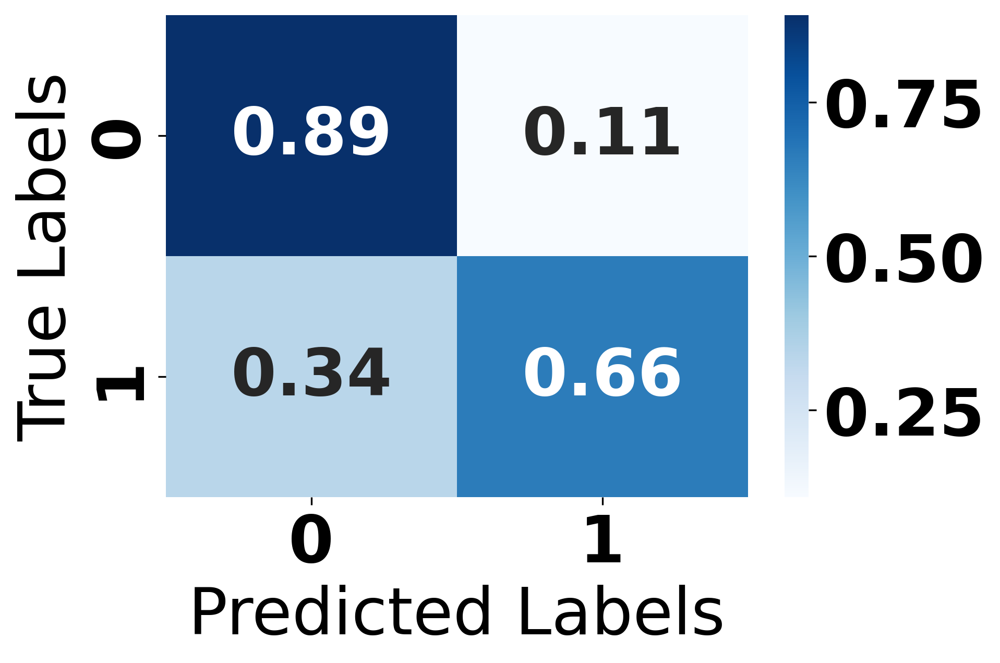

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Random Undersamppling

In [ ]:
from imblearn.under_sampling import RandomUnderSampler

# Initialize RandomUnderSampler
rus = RandomUnderSampler(random_state=42)

# Fit and transform the training data
x_train_resampled, y_train_resampled = rus.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save undersampled data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/x_train_resampled(RUS).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/y_train_resampled(RUS).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/x_train_resampled(RUS).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/y_train_resampled(RUS).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    8649
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    8649
dtype: int64
Class 1 count: 0    8649
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

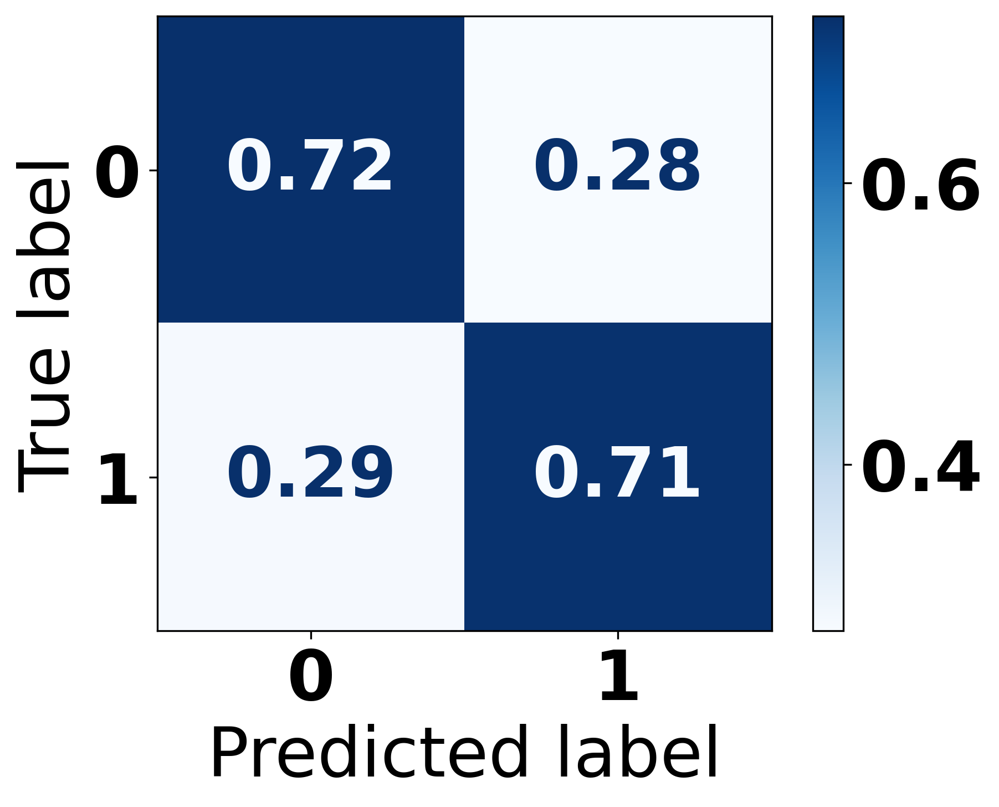

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.72      0.83    109244
     Class 1       0.08      0.71      0.14      3708

    accuracy                           0.72    112952
   macro avg       0.53      0.72      0.49    112952
weighted avg       0.96      0.72      0.81    112952

Train Accuracy: 1.0
Test Accuracy: 0.7183051207592606


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


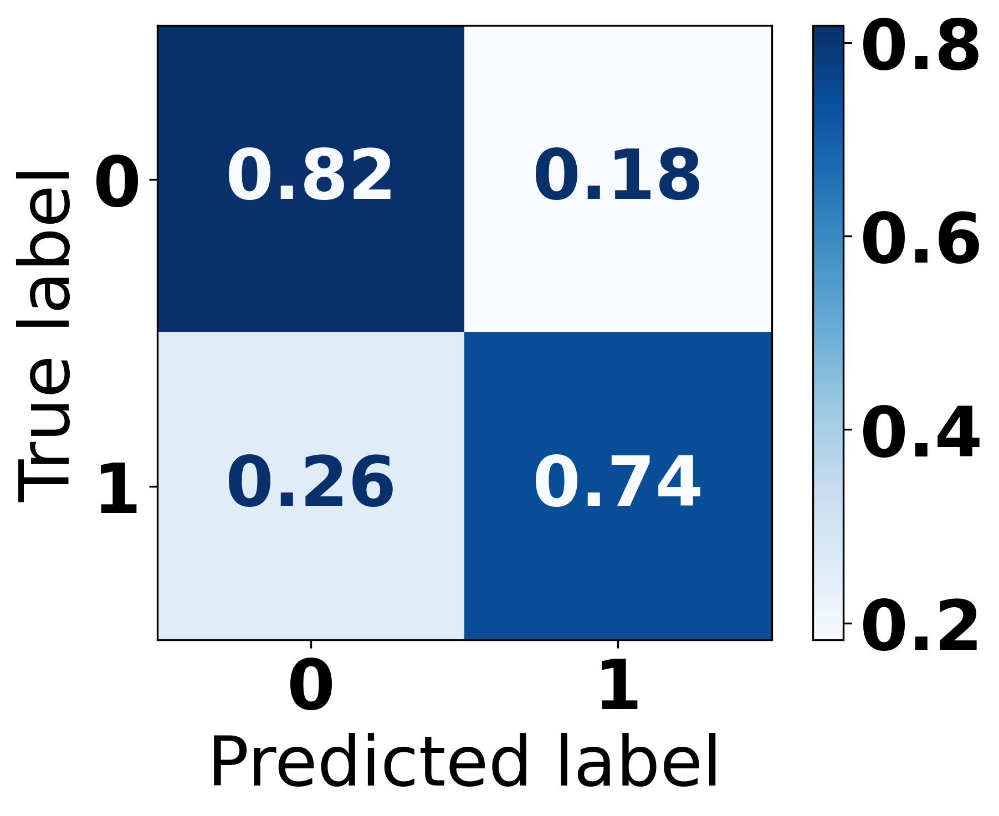

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.90    109244
     Class 1       0.12      0.74      0.21      3708

    accuracy                           0.81    112952
   macro avg       0.56      0.78      0.55    112952
weighted avg       0.96      0.81      0.87    112952

Train Accuracy: 0.7864493004971673
Test Accuracy: 0.8148859692612791


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-81-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


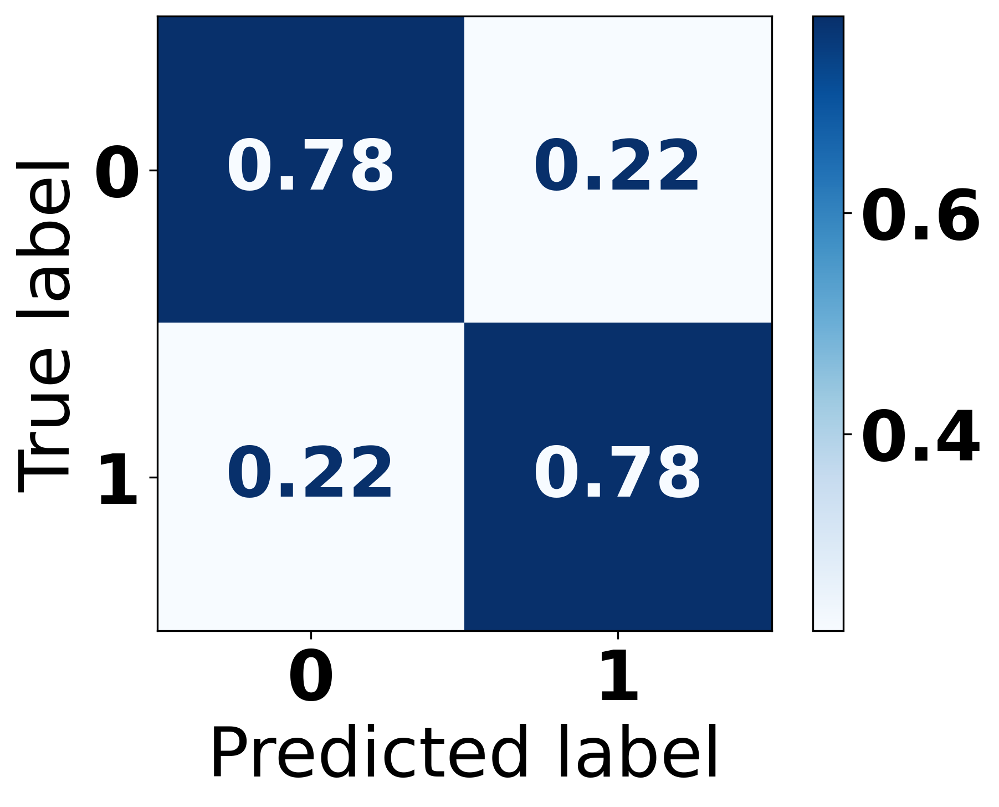

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.78      0.87    109244
           1       0.11      0.78      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.78      0.53    112952
weighted avg       0.96      0.78      0.85    112952

Train Accuracy: 0.7799167533818938
Test Accuracy: 0.7769406473546285


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(RF, '/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/Model/RF(RUS).pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/Model/RF(RUS).pkl']

In [ ]:
import joblib

# Load the model from file
RF = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/RUS/Model/RF(RUS).pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


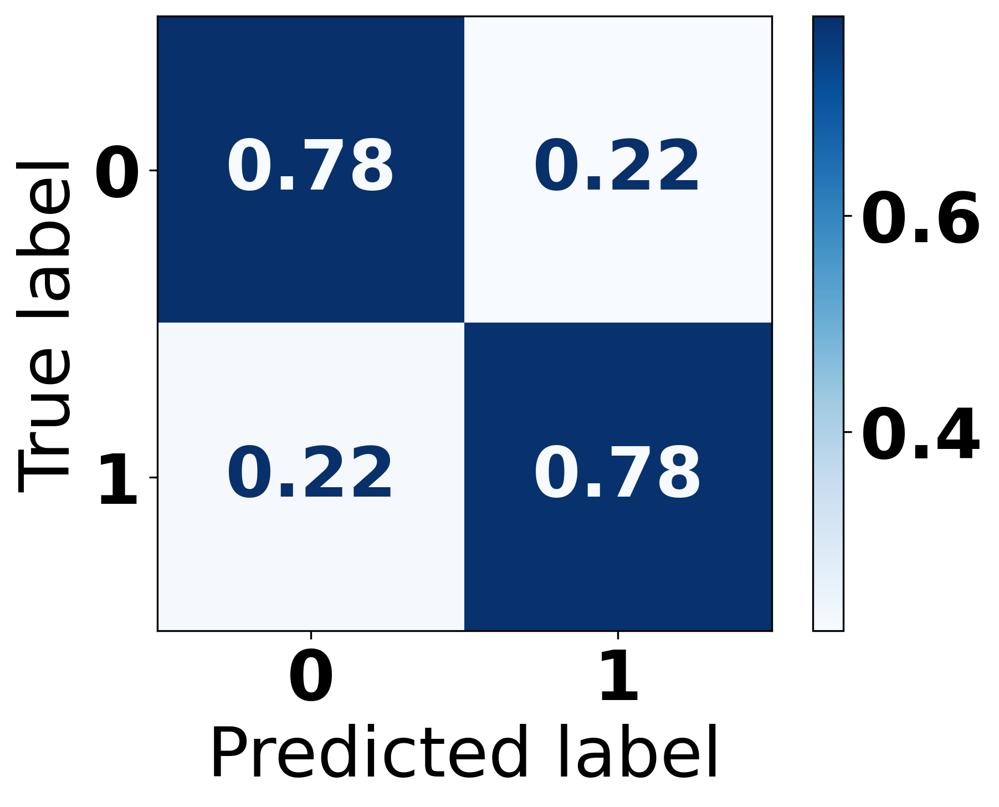

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.78      0.88    109244
           1       0.11      0.78      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.78      0.53    112952
weighted avg       0.96      0.78      0.85    112952

Train Accuracy: 0.7802636142906695
Test Accuracy: 0.7840587152064594


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


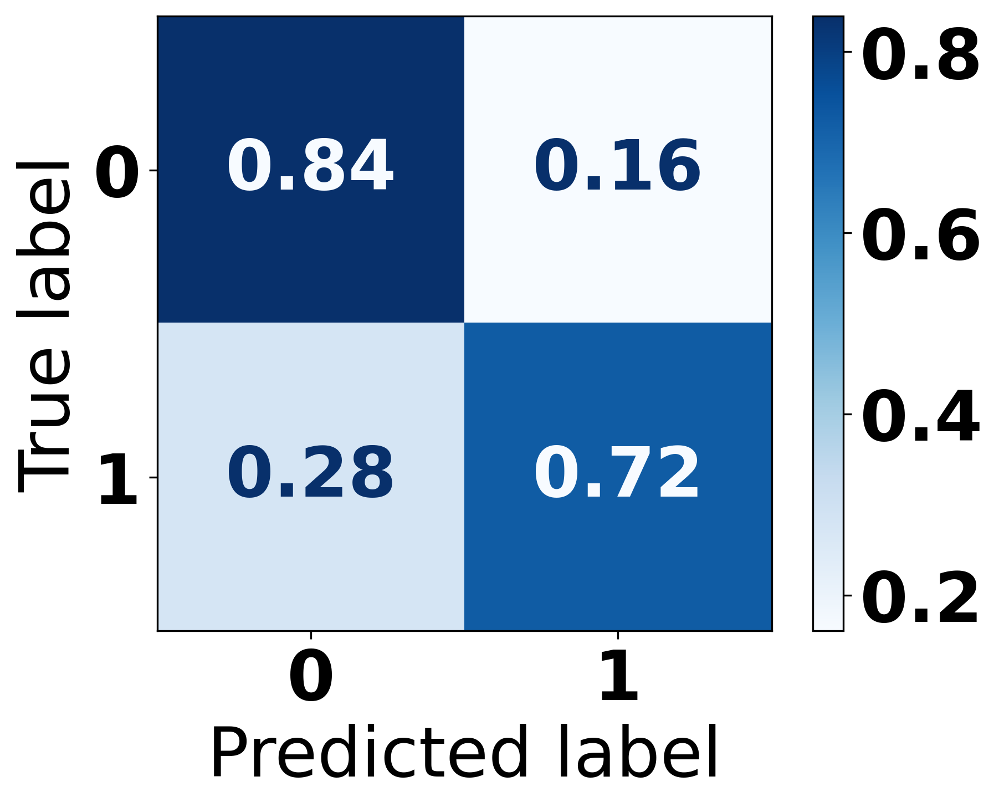

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.84      0.91    109244
           1       0.13      0.72      0.22      3708

    accuracy                           0.84    112952
   macro avg       0.56      0.78      0.57    112952
weighted avg       0.96      0.84      0.89    112952

Train Accuracy: 0.7881257948895826
Test Accuracy: 0.8354079609037467


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=13, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=10).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.77801985 0.22198015]
 [0.23004315 0.76995685]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.78      0.87    109244
     Class 1       0.11      0.77      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.77      0.53    112952
weighted avg       0.96      0.78      0.85    112952



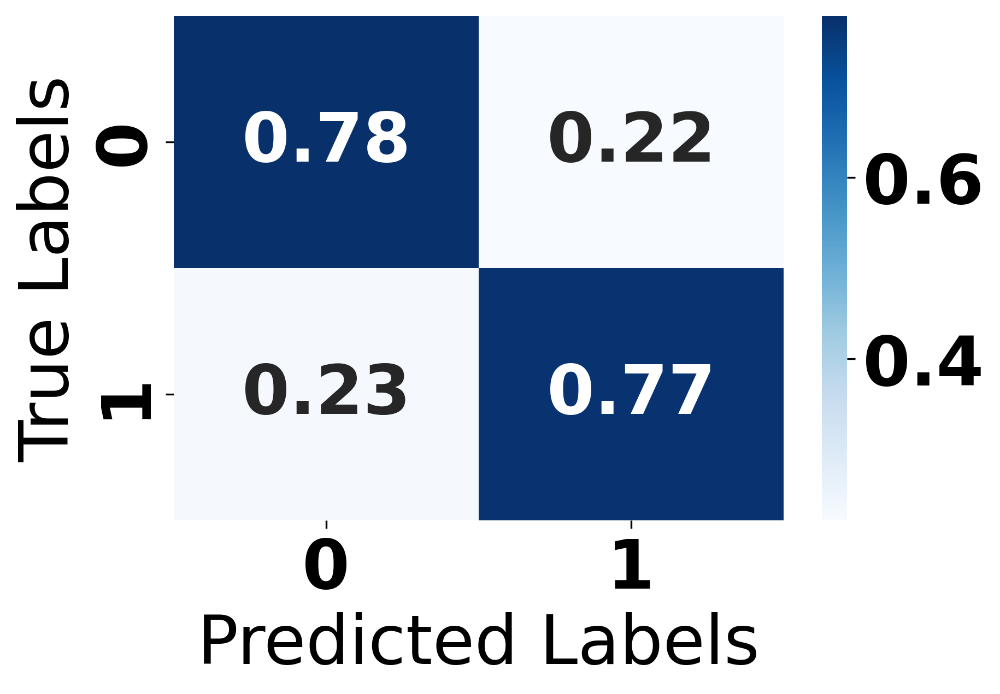

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
136/136 [==============================] - 5s 26ms/step - loss: 1.2343 - accuracy: 0.5725 - val_loss: 2.9870 - val_accuracy: 0.0368
Epoch 2/10
136/136 [==============================] - 3s 22ms/step - loss: 0.6529 - accuracy: 0.6639 - val_loss: 0.3824 - val_accuracy: 0.8307
Epoch 3/10
136/136 [==============================] - 2s 18ms/step - loss: 0.6270 - accuracy: 0.6894 - val_loss: 0.4026 - val_accuracy: 0.8025
Epoch 4/10
136/136 [==============================] - 3s 24ms/step - loss: 0.5586 - accuracy: 0.7227 - val_loss: 0.5498 - val_accuracy: 0.6994
Epoch 5/10
136/136 [==============================] - 3s 18ms/step - loss: 0.5511 - accuracy: 0.7240 - val_loss: 0.7620 - val_accuracy: 0.5787
Epoch 6/10
136/136 [==============================] - 3s 25ms/step - loss: 0.5570 - accuracy: 0.7234 - val_loss: 1.5394 - val_accuracy: 0.3303
Epoch 7/10
136/136 [==============================] - 6s 43ms/step - loss: 0.5732 - accuracy: 0.7151 - val_loss: 0.5720 - val_accuracy: 0.6810

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.89704698 0.10295302]
 [0.53505933 0.46494067]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.90      0.94    109244
     Class 1       0.13      0.46      0.21      3708

    accuracy                           0.88    112952
   macro avg       0.56      0.68      0.57    112952
weighted avg       0.95      0.88      0.91    112952



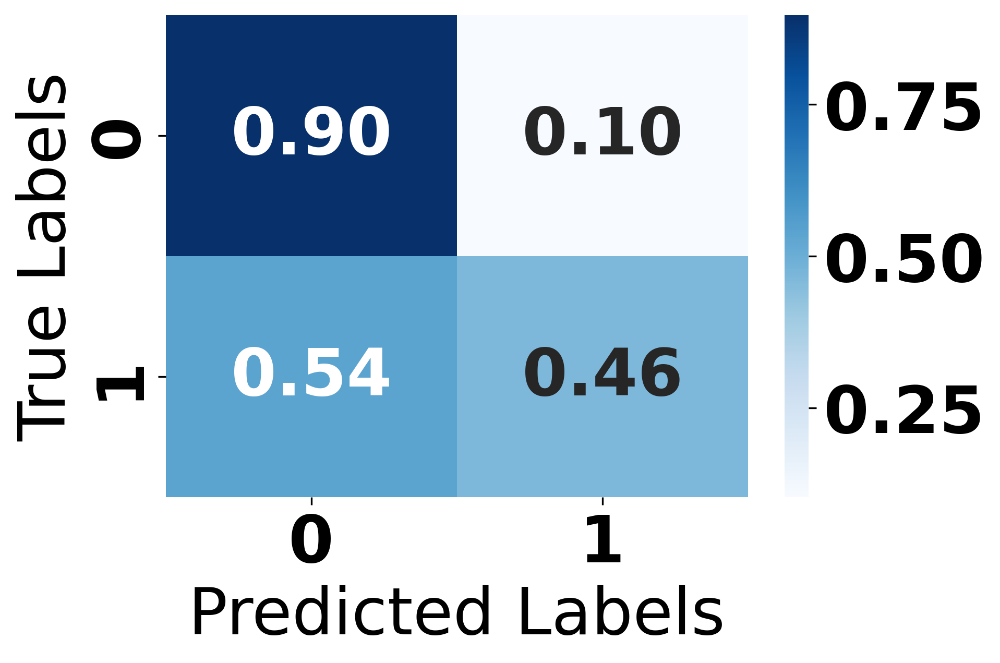

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
136/136 [==============================] - 6s 26ms/step - loss: 0.7171 - accuracy: 0.5719 - val_loss: 0.7844 - val_accuracy: 0.3065
Epoch 2/10
136/136 [==============================] - 4s 27ms/step - loss: 0.5945 - accuracy: 0.6879 - val_loss: 0.5776 - val_accuracy: 0.6731
Epoch 3/10
136/136 [==============================] - 2s 18ms/step - loss: 0.5414 - accuracy: 0.7336 - val_loss: 0.4738 - val_accuracy: 0.8113
Epoch 4/10
136/136 [==============================] - 3s 25ms/step - loss: 0.5092 - accuracy: 0.7536 - val_loss: 0.5504 - val_accuracy: 0.7211
Epoch 5/10
136/136 [==============================] - 3s 24ms/step - loss: 0.4857 - accuracy: 0.7719 - val_loss: 0.3579 - val_accuracy: 0.9292
Epoch 6/10
136/136 [==============================] - 3s 23ms/step - loss: 0.4743 - accuracy: 0.7761 - val_loss: 0.3775 - val_accuracy: 0.8876
Epoch 7/10
136/136 [==============================] - 2s 18ms/step - loss: 0.4666 - accuracy: 0.7845 - val_loss: 0.5112 - val_accuracy: 0.7864

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.66023763 0.33976237]
 [0.11947141 0.88052859]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.66      0.79    109244
     Class 1       0.08      0.88      0.15      3708

    accuracy                           0.67    112952
   macro avg       0.54      0.77      0.47    112952
weighted avg       0.96      0.67      0.77    112952



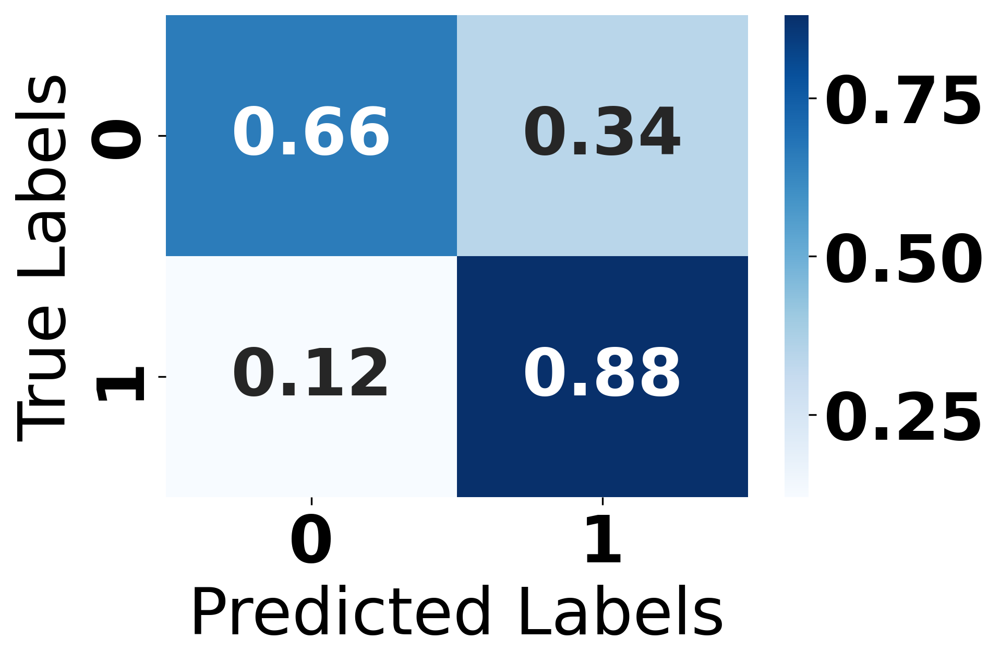

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Random Oversamppling

In [ ]:
from imblearn.over_sampling import RandomOverSampler

# Initialize RandomOverSampler
ros = RandomOverSampler(random_state=42)

# Fit and transform the training data
x_train_resampled, y_train_resampled = ros.fit_resample(x_train, y_train)

In [ ]:
"""
# Convert NumPy arrays to Pandas DataFrames
x_train_resampled = pd.DataFrame(x_train_resampled)
y_train_resampled = pd.DataFrame(y_train_resampled)

# Save oversampled data
x_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/x_train_resampled(ROS).csv', index=False)
y_train_resampled.to_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/y_train_resampled(ROS).csv', index=False)

"""

In [ ]:
# Load oversampled data
x_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/x_train_resampled(ROS).csv')
y_train_resampled = pd.read_csv('/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/y_train_resampled(ROS).csv')

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train_resampled == 0)
class_1_count = np.sum(y_train_resampled == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    109244
dtype: int64


In [ ]:
import copy

x_train = copy.deepcopy(x_train_resampled) # Copying oversampled input data
y_train = copy.deepcopy(y_train_resampled) # Copying oversampled target data

In [ ]:
# Count the occurrences of class 0 and class 1 in train set
class_0_count = np.sum(y_train == 0)
class_1_count = np.sum(y_train == 1)

print("Class 0 count:", class_0_count)
print("Class 1 count:", class_1_count)

Class 0 count: 0    109244
dtype: int64
Class 1 count: 0    109244
dtype: int64


In [ ]:
# Impoting libaries for pipeline
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score
from sklearn import metrics

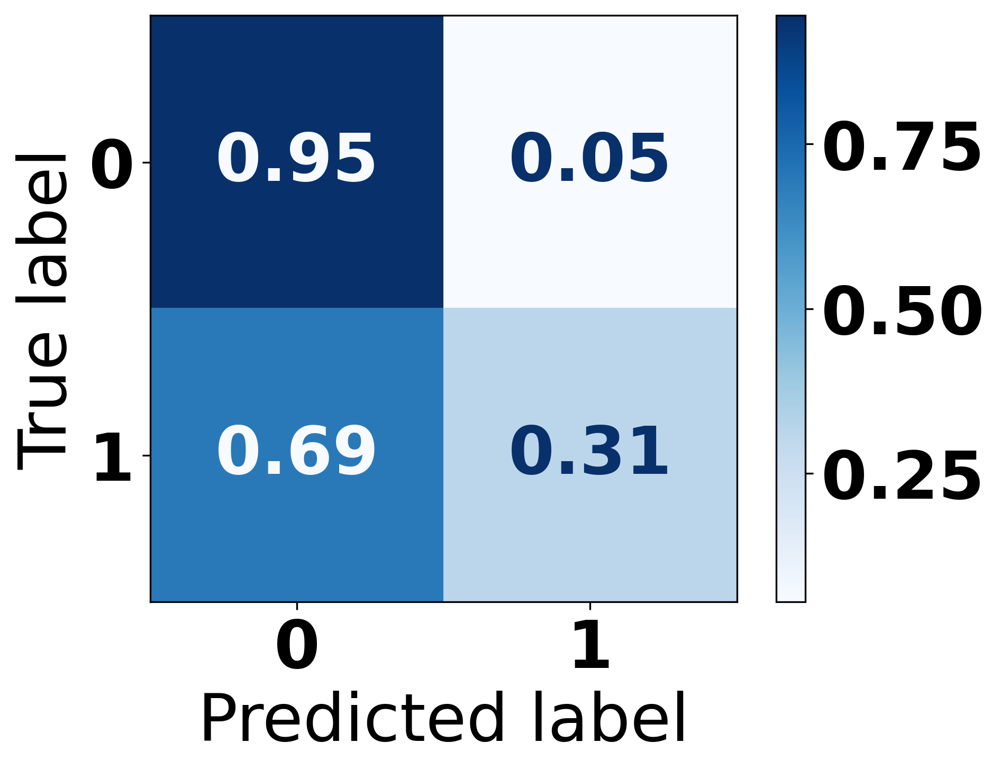

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.95      0.96    109244
     Class 1       0.16      0.31      0.21      3708

    accuracy                           0.92    112952
   macro avg       0.57      0.63      0.59    112952
weighted avg       0.95      0.92      0.94    112952

Train Accuracy: 1.0
Test Accuracy: 0.9242244493236065


In [ ]:
# Create and fit the Decision Tree Classifier
from sklearn.tree import DecisionTreeClassifier

DT = DecisionTreeClassifier(random_state=7)
DT.fit(x_train, y_train)

# Predict on the test set
y_pred = DT.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=DT.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = DT.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


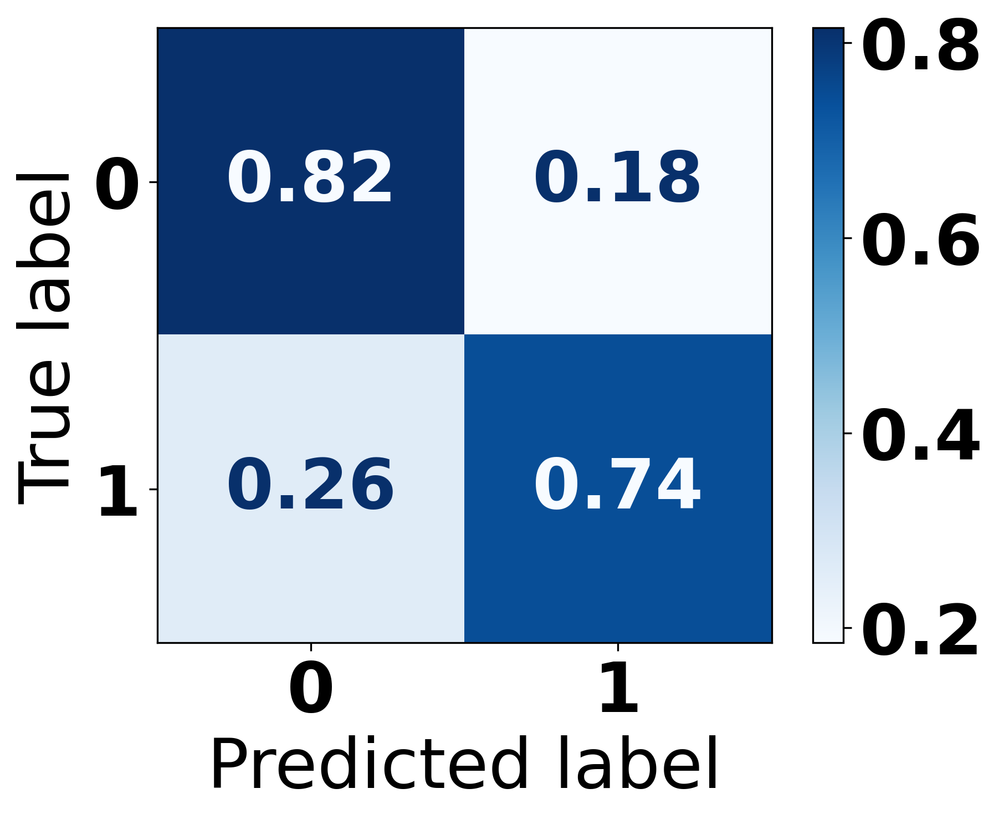

Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.89    109244
     Class 1       0.12      0.74      0.21      3708

    accuracy                           0.81    112952
   macro avg       0.55      0.78      0.55    112952
weighted avg       0.96      0.81      0.87    112952

Train Accuracy: 0.7843588663908315
Test Accuracy: 0.8128142927969403


In [ ]:
# Create an RUSBoost classifier
from imblearn.ensemble import RUSBoostClassifier

rusboost = RUSBoostClassifier(n_estimators=10, random_state=42)

# Fit the classifier to the training data
rusboost.fit(x_train, y_train)

# Predicting the output on the test dataset
y_pred = rusboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rusboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Generate classification report
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Calculate train accuracy
y_train_pred = rusboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

<ipython-input-181-2417d1570aca>:6: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  y_pred = RF.fit(x_train, y_train).predict(x_test)


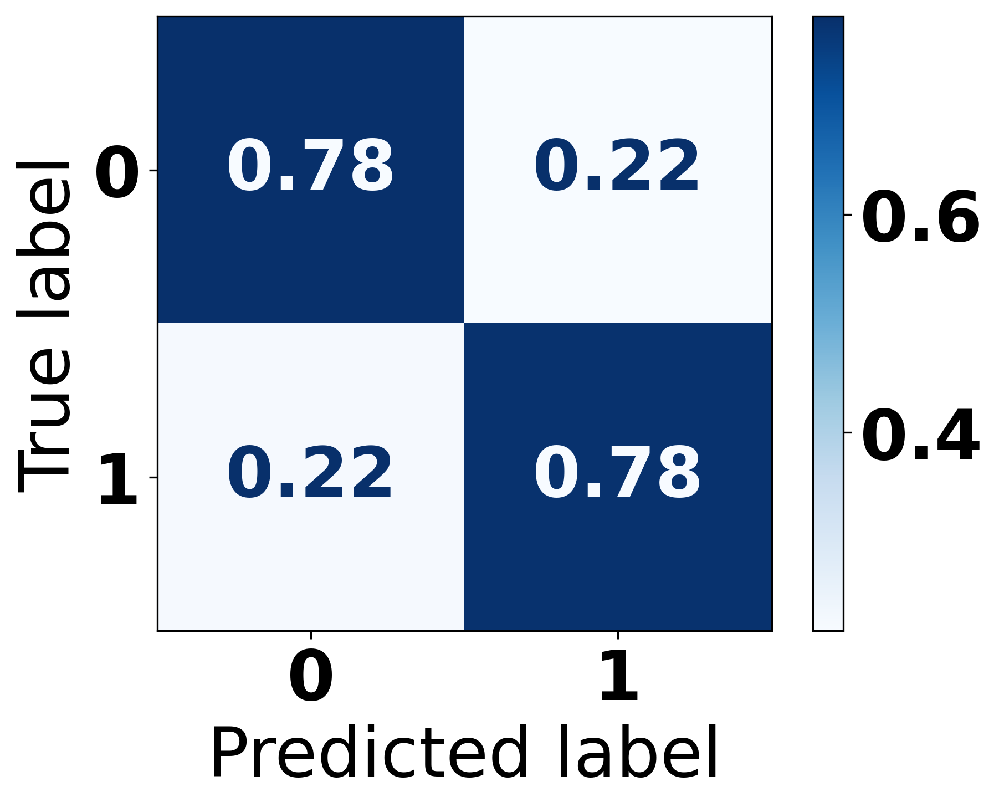

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.78      0.87    109244
           1       0.11      0.78      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.78      0.53    112952
weighted avg       0.96      0.78      0.85    112952

Train Accuracy: 0.781141298377943
Test Accuracy: 0.7817125858771867


In [ ]:
# Random Forest Classifier
from sklearn.ensemble import RandomForestClassifier
RF = RandomForestClassifier(max_depth=2, random_state=0)

# Fit the classifier to the training data
y_pred = RF.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=RF.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = RF.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


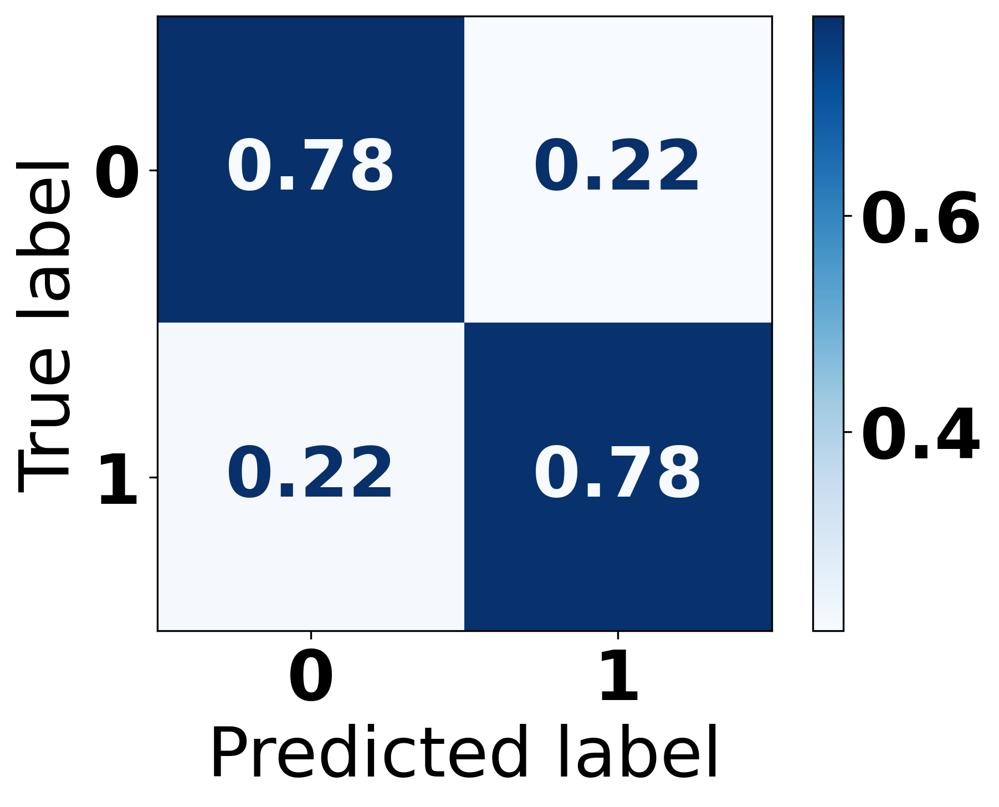

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.78      0.88    109244
           1       0.11      0.78      0.19      3708

    accuracy                           0.78    112952
   macro avg       0.55      0.78      0.53    112952
weighted avg       0.96      0.78      0.85    112952

Train Accuracy: 0.7802636142906695
Test Accuracy: 0.7840587152064594


In [ ]:
# Gaussian Naive Bayes
from sklearn.naive_bayes import GaussianNB
GNB = GaussianNB()

# Fit the classifier to the training data
y_pred = GNB.fit(x_train, y_train).predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = GNB.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
"""
import joblib

# Save the model to a file
joblib.dump(GNB, '/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/Model/GNB(ROS).pkl')

"""

['/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/Model/GNB(ROS).pkl']

In [ ]:
import joblib

# Load the model from file
GNB = joblib.load('/content/drive/MyDrive/Myocardial Infarction/Dataset/ROS/Model/GNB(ROS).pkl')

/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


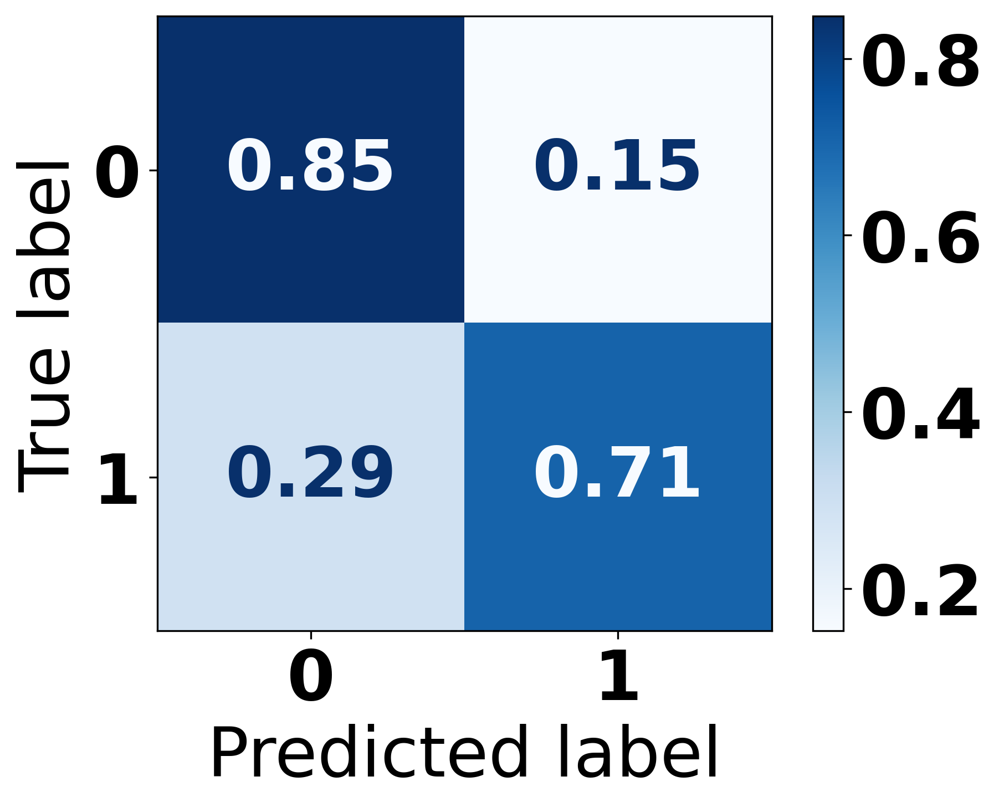

Classification Report:
               precision    recall  f1-score   support

           0       0.99      0.85      0.91    109244
           1       0.14      0.71      0.23      3708

    accuracy                           0.84    112952
   macro avg       0.56      0.78      0.57    112952
weighted avg       0.96      0.84      0.89    112952

Train Accuracy: 0.7867383512544803
Test Accuracy: 0.8433405340321553


In [ ]:
# Create an AdaBoost classifier
from sklearn.ensemble import AdaBoostClassifier

Adaboost = AdaBoostClassifier(n_estimators=14, learning_rate=0.4, random_state=33)
# Adaboost = AdaBoostClassifier(n_estimators=50, random_state=42)

# Train the AdaBoost classifier
Adaboost.fit(x_train, y_train)

# Make predictions on the test set
y_pred = Adaboost.predict(x_test)

# Display the confusion matrix as percentages
cm = confusion_matrix(y_test, y_pred, normalize='true')
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=Adaboost.classes_)
disp.plot(cmap='Blues', values_format='.2f')
# plt.title('Normalized Confusion Matrix (Percentage)')
plt.show()

# Print classification report
print("Classification Report:\n", classification_report(y_test, y_pred))

# Calculate train accuracy
y_train_pred = Adaboost.predict(x_train)
train_accuracy = accuracy_score(y_train, y_train_pred)

# Print train accuracy
print("Train Accuracy:", train_accuracy)

# Calculate test accuracy
test_accuracy = accuracy_score(y_test, y_pred)

# Print test accuracy
print("Test Accuracy:", test_accuracy)

In [ ]:
from sklearn.neural_network import MLPClassifier

clf = MLPClassifier(random_state=1, max_iter=10).fit(x_train, y_train)
y_pred = clf.predict_proba(x_test)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1098: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (10) reached and the optimization hasn't converged yet.
  warnings.warn(


Normalized Confusion Matrix:
[[0.9319505  0.0680495 ]
 [0.41154261 0.58845739]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.93      0.96    109244
     Class 1       0.23      0.59      0.33      3708

    accuracy                           0.92    112952
   macro avg       0.61      0.76      0.64    112952
weighted avg       0.96      0.92      0.94    112952



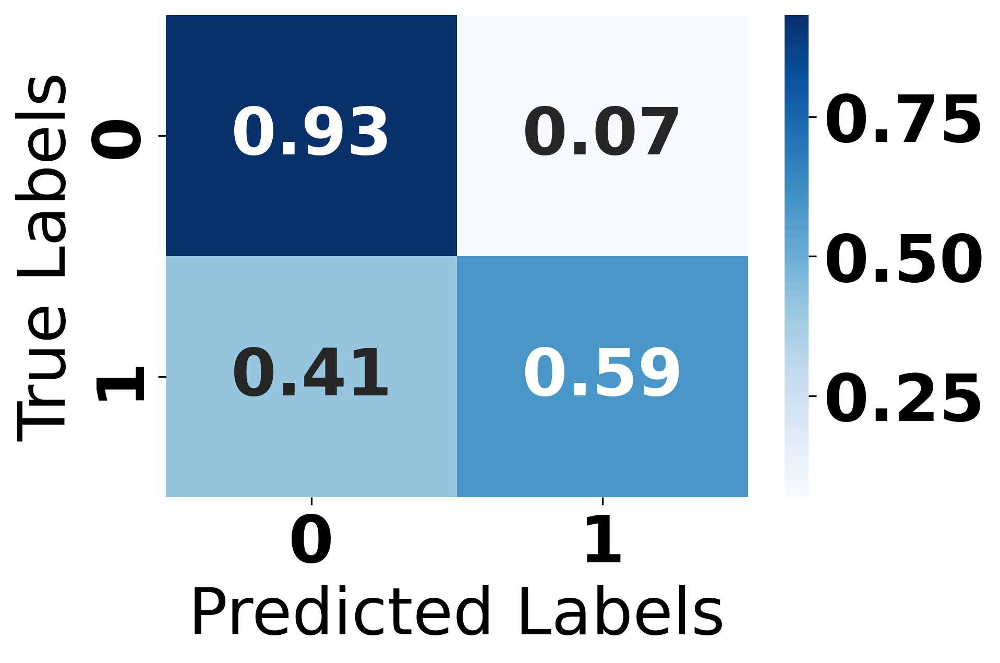

In [ ]:
# Predict probabilities on test data
y_pred_prob = clf.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add

# Input layer
input_layer = Input(shape=(x_train.shape[1], 1))

# First convolutional block
conv1 = Conv1D(filters=32, kernel_size=3, activation='relu', padding='same')(input_layer)
pool1 = MaxPooling1D(pool_size=2)(conv1)

# Second convolutional block with residual connection
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(pool1)
conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

# Residual connection
residual1 = Conv1D(filters=64, kernel_size=1, activation='relu', padding='same')(pool1)
residual1 = Add()([residual1, conv2])
pool2 = MaxPooling1D(pool_size=2)(residual1)

# Flatten layer
flatten = Flatten()(pool2)

# Dense layers
dense1 = Dense(128, activation='relu')(flatten)
dense2 = Dense(64, activation='relu')(dense1)

# Output layer
output = Dense(1, activation='sigmoid')(dense2)

# Create the model
model = Model(inputs=input_layer, outputs=output)

# Compile the model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the model
model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the model
loss, accuracy = model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1707/1707 [==============================] - 14s 7ms/step - loss: 0.5648 - accuracy: 0.7193 - val_loss: 0.5132 - val_accuracy: 0.7146
Epoch 2/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.5057 - accuracy: 0.7535 - val_loss: 0.5926 - val_accuracy: 0.6521
Epoch 3/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4984 - accuracy: 0.7591 - val_loss: 0.4814 - val_accuracy: 0.7373
Epoch 4/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.4942 - accuracy: 0.7607 - val_loss: 0.5274 - val_accuracy: 0.7103
Epoch 5/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.4905 - accuracy: 0.7622 - val_loss: 0.6029 - val_accuracy: 0.6391
Epoch 6/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.4841 - accuracy: 0.7653 - val_loss: 0.5237 - val_accuracy: 0.6910
Epoch 7/10
1707/1707 [==============================] - 11s 6ms/step - loss: 0.4758 - accuracy: 0.7692 - val_loss: 0.4823 - val_ac

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.74914869 0.25085131]
 [0.25566343 0.74433657]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.75      0.85    109244
     Class 1       0.09      0.74      0.16      3708

    accuracy                           0.75    112952
   macro avg       0.54      0.75      0.51    112952
weighted avg       0.96      0.75      0.83    112952



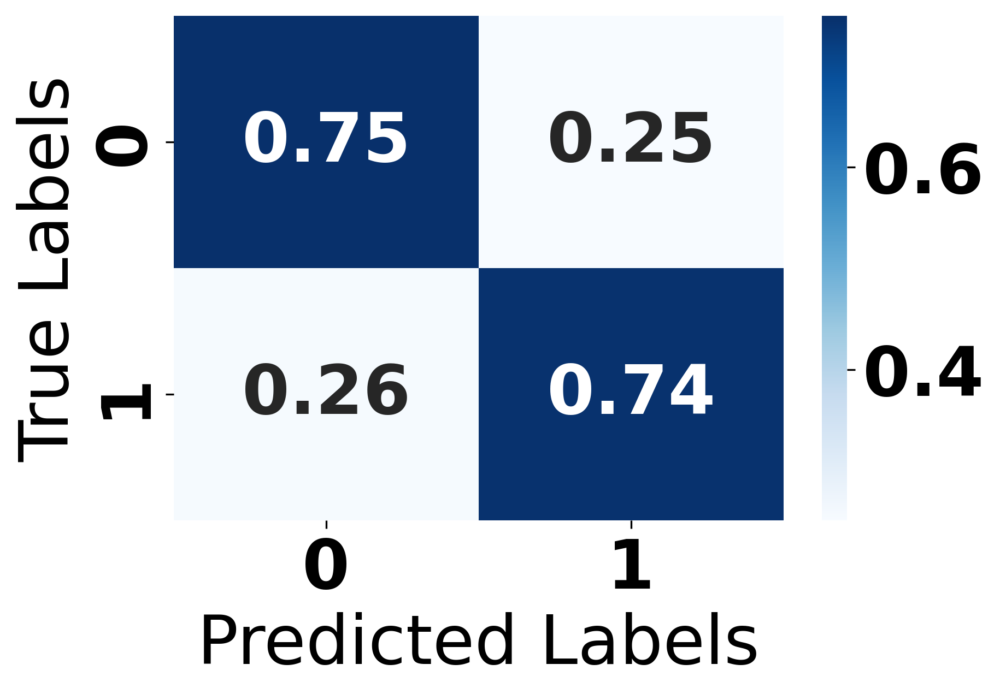

In [ ]:
# Predict probabilities on test data
y_pred_prob = model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout
from tensorflow.keras.models import Model

# Define the input shape based on your data
input_shape = (x_train.shape[1],)  # Assuming your input data is 1D

def ANN_model(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    dense3 = Dense(64, activation='relu')(dense2)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the more complex ANN model
ANN_model = ANN_model(input_shape)

# Compile the model
ANN_model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the more complex ANN model
ANN_model.fit(x_train, y_train, epochs=10, batch_size=128, validation_data=(x_test, y_test))

# Evaluate the more complex ANN model
loss, accuracy = ANN_model.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/10
1707/1707 [==============================] - 14s 7ms/step - loss: 0.4941 - accuracy: 0.7598 - val_loss: 0.4825 - val_accuracy: 0.8014
Epoch 2/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4440 - accuracy: 0.7926 - val_loss: 0.6203 - val_accuracy: 0.6757
Epoch 3/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4394 - accuracy: 0.7948 - val_loss: 0.6428 - val_accuracy: 0.6468
Epoch 4/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4344 - accuracy: 0.7967 - val_loss: 0.4213 - val_accuracy: 0.8126
Epoch 5/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4332 - accuracy: 0.7965 - val_loss: 0.3682 - val_accuracy: 0.8551
Epoch 6/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4317 - accuracy: 0.7971 - val_loss: 0.3761 - val_accuracy: 0.8428
Epoch 7/10
1707/1707 [==============================] - 12s 7ms/step - loss: 0.4308 - accuracy: 0.7966 - val_loss: 0.4653 - val_ac

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.89412691 0.10587309]
 [0.32740022 0.67259978]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.89      0.94    109244
     Class 1       0.18      0.67      0.28      3708

    accuracy                           0.89    112952
   macro avg       0.58      0.78      0.61    112952
weighted avg       0.96      0.89      0.92    112952



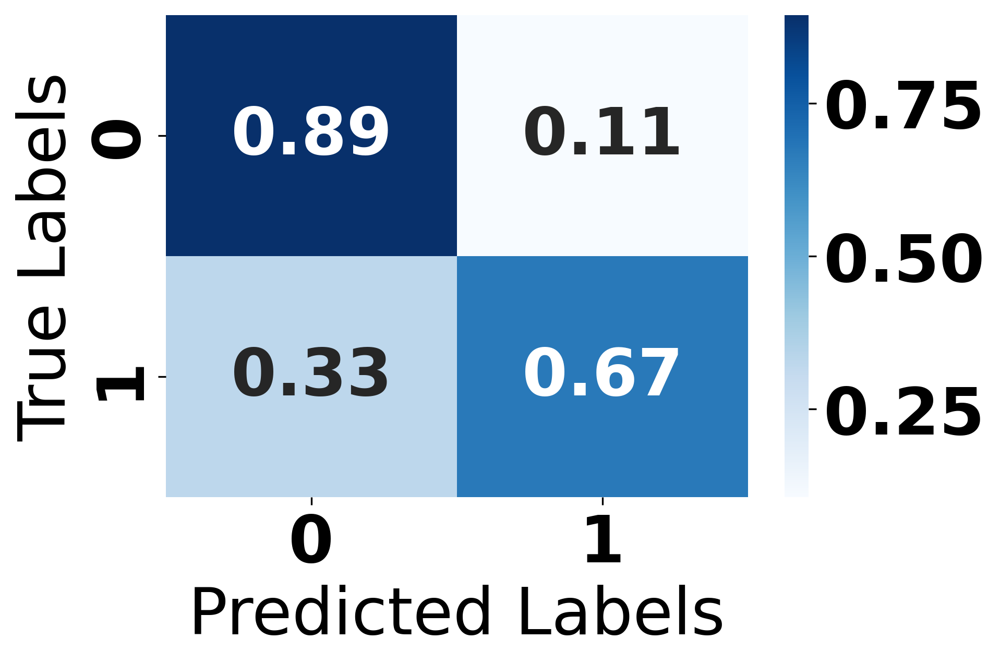

In [ ]:
# Predict probabilities on test data
y_pred_prob = ANN_model.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

### Sensitivity Analysis

# S1

In [ ]:
# Labeling
x_trainS = x_train[['MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 18s 9ms/step - loss: 0.6303 - accuracy: 0.6457 - val_loss: 0.4780 - val_accuracy: 0.8909
Epoch 2/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6070 - accuracy: 0.6679 - val_loss: 0.7978 - val_accuracy: 0.4104
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6095 - accuracy: 0.6635 - val_loss: 0.5027 - val_accuracy: 0.7860
Epoch 4/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6186 - accuracy: 0.6403 - val_loss: 0.6171 - val_accuracy: 0.5867
Epoch 5/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6192 - accuracy: 0.6348 - val_loss: 0.6451 - val_accuracy: 0.5332
Epoch 6/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6196 - accuracy: 0.6337 - val_loss: 0.6187 - val_accuracy: 0.5764
Epoch 7/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6185 - accuracy: 0.6339 - val_loss: 0.3861 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 22s 12ms/step - loss: 0.6266 - accuracy: 0.6484 - val_loss: 0.7037 - val_accuracy: 0.4802
Epoch 2/20
1691/1691 [==============================] - 28s 16ms/step - loss: 0.6071 - accuracy: 0.6680 - val_loss: 0.6420 - val_accuracy: 0.5823
Epoch 3/20
1691/1691 [==============================] - 27s 16ms/step - loss: 0.6160 - accuracy: 0.6519 - val_loss: 1.3955 - val_accuracy: 0.0532
Epoch 4/20
1691/1691 [==============================] - 29s 17ms/step - loss: 0.6195 - accuracy: 0.6346 - val_loss: 0.6265 - val_accuracy: 0.5397
Epoch 5/20
1691/1691 [==============================] - 29s 17ms/step - loss: 0.6198 - accuracy: 0.6340 - val_loss: 0.5764 - val_accuracy: 0.7761
Epoch 6/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6198 - accuracy: 0.6335 - val_loss: 0.5984 - val_accuracy: 0.6889
Epoch 7/20
1691/1691 [==============================] - 16s 10ms/step - loss: 0.6186 - accuracy: 0.6347 - val_loss: 0.5811 -

3530/3530 [==============================] - 15s 4ms/step
Normalized Confusion Matrix:
[[0.55001648 0.44998352]
 [0.20226537 0.79773463]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.55      0.71    109244
     Class 1       0.06      0.80      0.11      3708

    accuracy                           0.56    112952
   macro avg       0.52      0.67      0.41    112952
weighted avg       0.96      0.56      0.69    112952



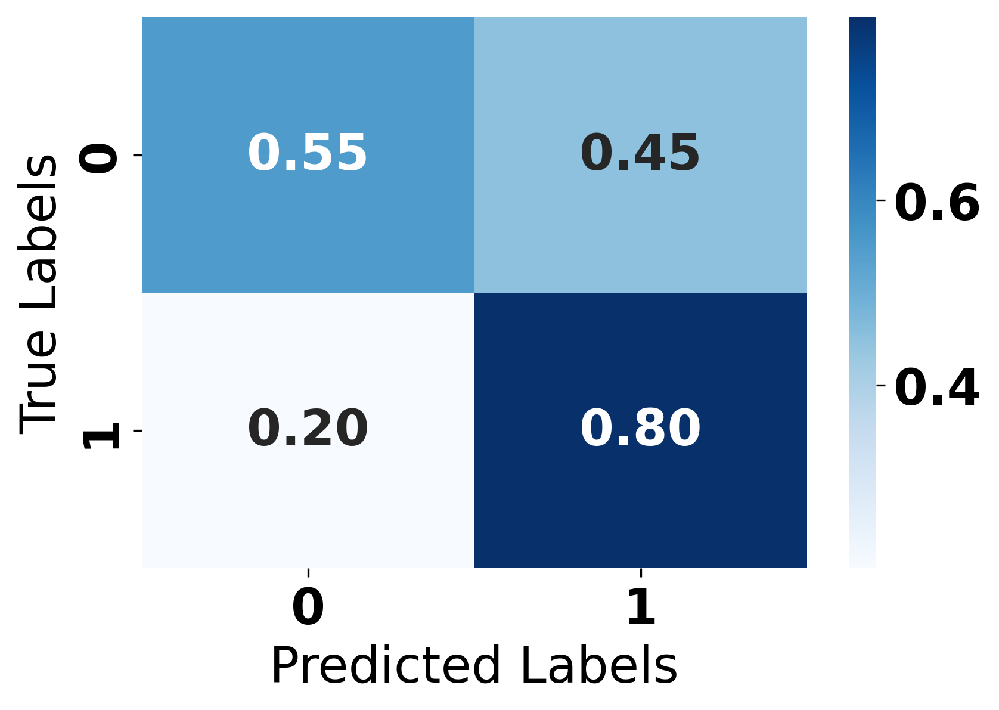

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.54, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S1).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS1 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S1).h5')

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.77531031 0.22468969]
 [0.4495685  0.5504315 ]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.78      0.87    109244
     Class 1       0.08      0.55      0.13      3708

    accuracy                           0.77    112952
   macro avg       0.53      0.66      0.50    112952
weighted avg       0.95      0.77      0.84    112952



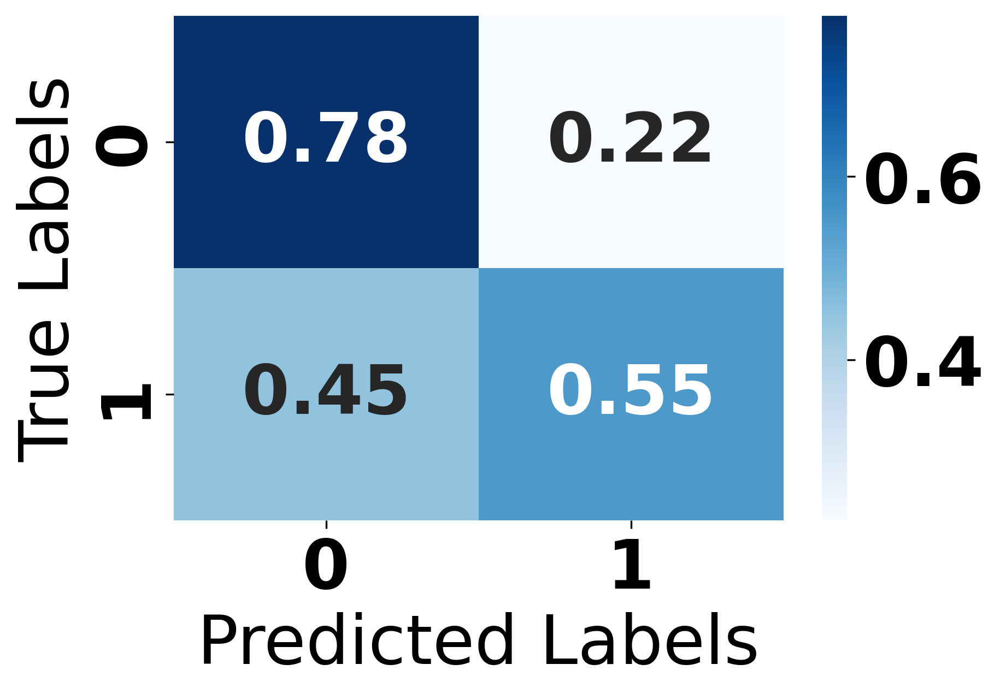

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS1.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S2

In [ ]:
# Labeling
x_trainS = x_train[['EDUCA', 'EMPLOY1', 'INCOME3', 'CPDEMO1B']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['EDUCA', 'EMPLOY1', 'INCOME3', 'CPDEMO1B']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 18s 9ms/step - loss: 0.6337 - accuracy: 0.6574 - val_loss: 0.6506 - val_accuracy: 0.6395
Epoch 2/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6236 - accuracy: 0.6640 - val_loss: 0.5972 - val_accuracy: 0.6387
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6224 - accuracy: 0.6656 - val_loss: 0.6395 - val_accuracy: 0.6331
Epoch 4/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6224 - accuracy: 0.6660 - val_loss: 0.6187 - val_accuracy: 0.6413
Epoch 5/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6211 - accuracy: 0.6675 - val_loss: 0.6194 - val_accuracy: 0.6595
Epoch 6/20
1691/1691 [==============================] - 14s 9ms/step - loss: 0.6206 - accuracy: 0.6677 - val_loss: 0.6400 - val_accuracy: 0.6349
Epoch 7/20
1691/1691 [==============================] - 14s 9ms/step - loss: 0.6202 - accuracy: 0.6678 - val_loss: 0.6318 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 36s 19ms/step - loss: 0.6323 - accuracy: 0.6572 - val_loss: 0.6443 - val_accuracy: 0.6457
Epoch 2/20
1691/1691 [==============================] - 29s 17ms/step - loss: 0.6232 - accuracy: 0.6650 - val_loss: 0.6452 - val_accuracy: 0.6375
Epoch 3/20
1691/1691 [==============================] - 28s 17ms/step - loss: 0.6221 - accuracy: 0.6660 - val_loss: 0.6603 - val_accuracy: 0.6413
Epoch 4/20
1691/1691 [==============================] - 24s 14ms/step - loss: 0.6209 - accuracy: 0.6664 - val_loss: 0.6400 - val_accuracy: 0.6571
Epoch 5/20
1691/1691 [==============================] - 19s 11ms/step - loss: 0.6209 - accuracy: 0.6670 - val_loss: 0.6370 - val_accuracy: 0.6289
Epoch 6/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6202 - accuracy: 0.6681 - val_loss: 0.6194 - val_accuracy: 0.6516
Epoch 7/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6201 - accuracy: 0.6680 - val_loss: 0.6139 -

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.63591593 0.36408407]
 [0.28694714 0.71305286]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.64      0.77    109244
     Class 1       0.06      0.71      0.11      3708

    accuracy                           0.64    112952
   macro avg       0.52      0.67      0.44    112952
weighted avg       0.95      0.64      0.75    112952



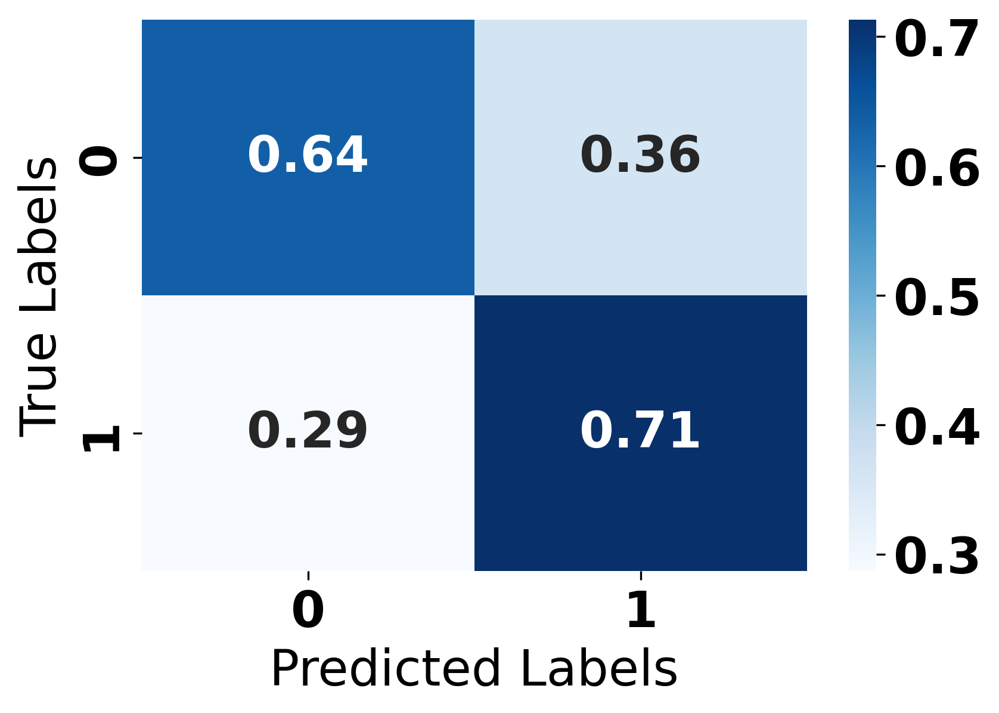

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S2).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS2 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S2).h5')

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.62490388 0.37509612]
 [0.27669903 0.72330097]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.62      0.76    109244
     Class 1       0.06      0.72      0.11      3708

    accuracy                           0.63    112952
   macro avg       0.52      0.67      0.44    112952
weighted avg       0.95      0.63      0.74    112952



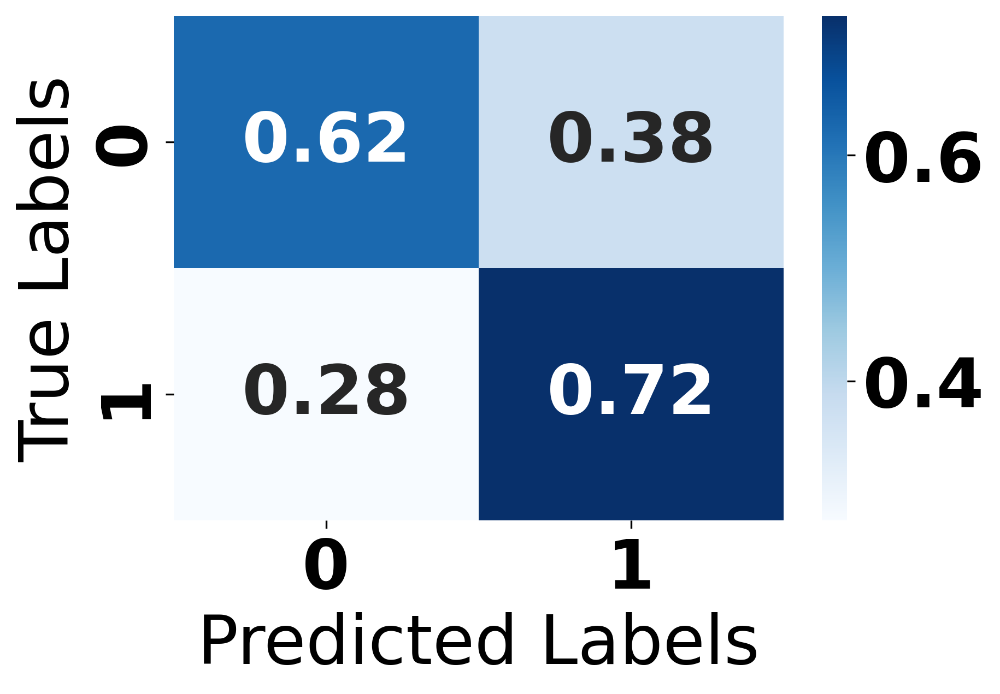

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS2.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S3

In [ ]:
# Labeling
x_trainS = x_train[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 27s 13ms/step - loss: 0.4669 - accuracy: 0.7776 - val_loss: 0.3732 - val_accuracy: 0.8570
Epoch 2/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.4552 - accuracy: 0.7837 - val_loss: 0.4145 - val_accuracy: 0.8429
Epoch 3/20
1691/1691 [==============================] - 21s 12ms/step - loss: 0.4547 - accuracy: 0.7836 - val_loss: 0.4258 - val_accuracy: 0.8144
Epoch 4/20
1691/1691 [==============================] - 23s 14ms/step - loss: 0.4533 - accuracy: 0.7844 - val_loss: 0.4262 - val_accuracy: 0.8402
Epoch 5/20
1691/1691 [==============================] - 23s 13ms/step - loss: 0.4528 - accuracy: 0.7845 - val_loss: 0.4409 - val_accuracy: 0.8095
Epoch 6/20
1691/1691 [==============================] - 26s 15ms/step - loss: 0.4525 - accuracy: 0.7850 - val_loss: 0.4646 - val_accuracy: 0.8233
Epoch 7/20
1691/1691 [==============================] - 24s 14ms/step - loss: 0.4521 - accuracy: 0.7852 - val_loss: 0.4371 -

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 33s 17ms/step - loss: 0.4679 - accuracy: 0.7771 - val_loss: 0.3713 - val_accuracy: 0.8708
Epoch 2/20
1691/1691 [==============================] - 29s 17ms/step - loss: 0.4549 - accuracy: 0.7835 - val_loss: 0.4042 - val_accuracy: 0.8418
Epoch 3/20
1691/1691 [==============================] - 28s 16ms/step - loss: 0.4533 - accuracy: 0.7842 - val_loss: 0.4530 - val_accuracy: 0.8102
Epoch 4/20
1691/1691 [==============================] - 21s 12ms/step - loss: 0.4526 - accuracy: 0.7846 - val_loss: 0.3825 - val_accuracy: 0.8614
Epoch 5/20
1691/1691 [==============================] - 20s 12ms/step - loss: 0.4523 - accuracy: 0.7846 - val_loss: 0.4317 - val_accuracy: 0.8218
Epoch 6/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.4517 - accuracy: 0.7846 - val_loss: 0.4021 - val_accuracy: 0.8294
Epoch 7/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.4519 - accuracy: 0.7849 - val_loss: 0.4240 -

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.85459156 0.14540844]
 [0.28937433 0.71062567]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.85      0.92    109244
     Class 1       0.14      0.71      0.24      3708

    accuracy                           0.85    112952
   macro avg       0.57      0.78      0.58    112952
weighted avg       0.96      0.85      0.89    112952



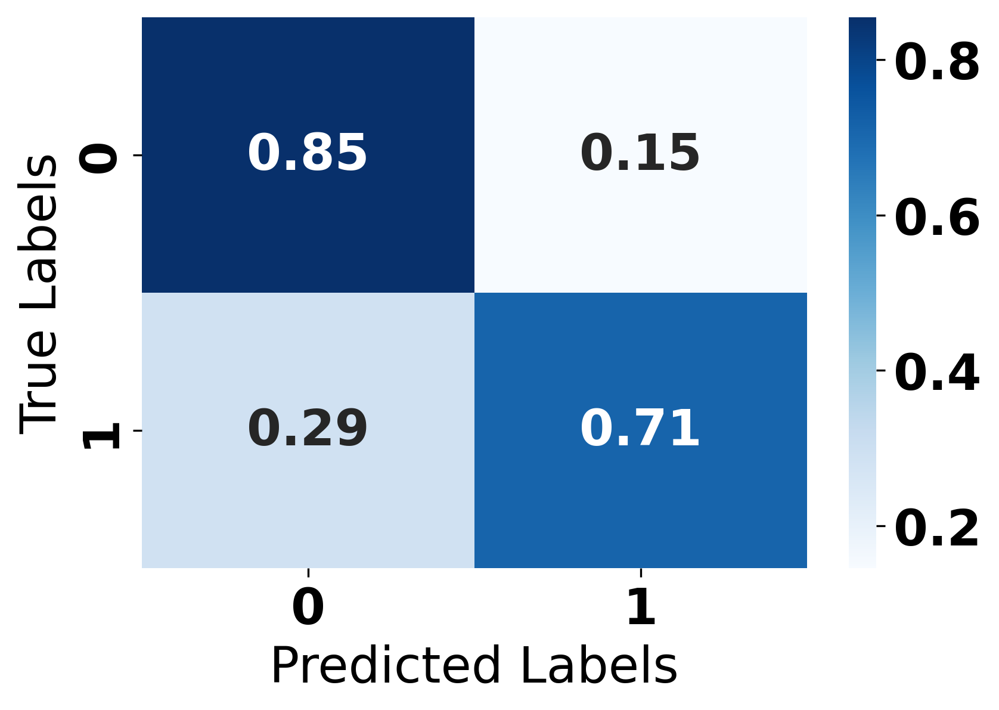

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS3 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3).h5')

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.82985793 0.17014207]
 [0.26348436 0.73651564]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.83      0.90    109244
     Class 1       0.13      0.74      0.22      3708

    accuracy                           0.83    112952
   macro avg       0.56      0.78      0.56    112952
weighted avg       0.96      0.83      0.88    112952



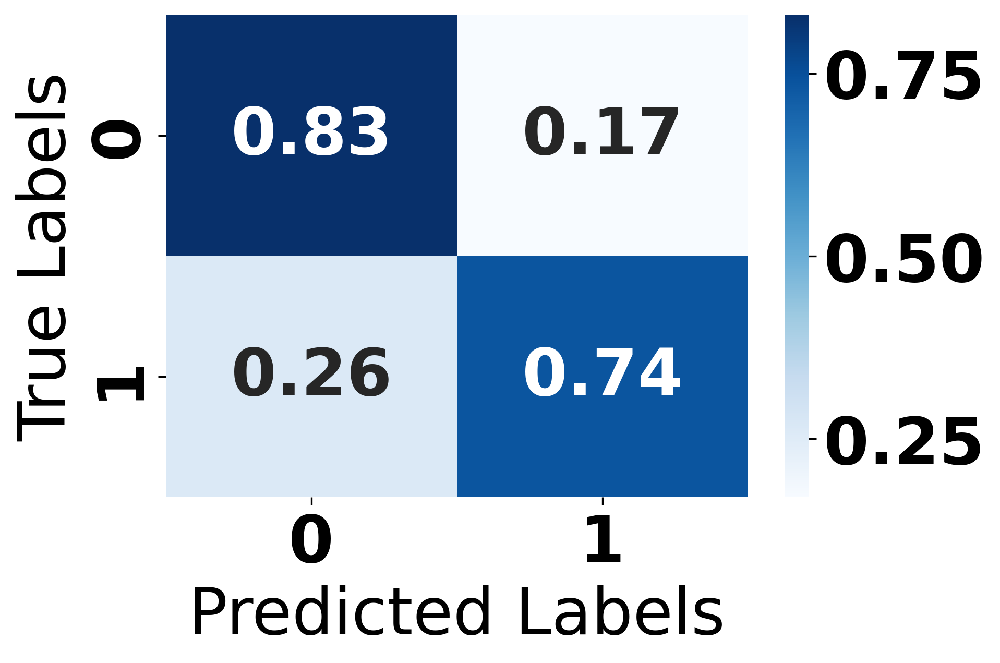

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS3.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S4

In [ ]:
# Labeling
x_trainS = x_train[['BLIND', 'DIFFDRES', 'DIFFWALK', 'DIFFALON']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['BLIND', 'DIFFDRES', 'DIFFWALK', 'DIFFALON']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 18s 9ms/step - loss: 0.6611 - accuracy: 0.6255 - val_loss: 0.6418 - val_accuracy: 0.8179
Epoch 2/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6535 - accuracy: 0.6303 - val_loss: 0.6434 - val_accuracy: 0.8044
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6528 - accuracy: 0.6306 - val_loss: 0.6426 - val_accuracy: 0.8044
Epoch 4/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6522 - accuracy: 0.6309 - val_loss: 0.6402 - val_accuracy: 0.8044
Epoch 5/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6520 - accuracy: 0.6304 - val_loss: 0.6394 - val_accuracy: 0.8044
Epoch 6/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6520 - accuracy: 0.6306 - val_loss: 0.6519 - val_accuracy: 0.8044
Epoch 7/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6520 - accuracy: 0.6305 - val_loss: 0.6226 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 35s 18ms/step - loss: 0.6609 - accuracy: 0.6252 - val_loss: 0.6325 - val_accuracy: 0.8044
Epoch 2/20
1691/1691 [==============================] - 28s 17ms/step - loss: 0.6533 - accuracy: 0.6304 - val_loss: 0.6345 - val_accuracy: 0.8044
Epoch 3/20
1691/1691 [==============================] - 26s 15ms/step - loss: 0.6525 - accuracy: 0.6306 - val_loss: 0.6426 - val_accuracy: 0.8044
Epoch 4/20
1691/1691 [==============================] - 22s 13ms/step - loss: 0.6522 - accuracy: 0.6307 - val_loss: 0.6433 - val_accuracy: 0.8044
Epoch 5/20
1691/1691 [==============================] - 19s 11ms/step - loss: 0.6520 - accuracy: 0.6308 - val_loss: 0.6197 - val_accuracy: 0.8044
Epoch 6/20
1691/1691 [==============================] - 20s 12ms/step - loss: 0.6518 - accuracy: 0.6306 - val_loss: 0.6434 - val_accuracy: 0.8044
Epoch 7/20
1691/1691 [==============================] - 18s 11ms/step - loss: 0.6515 - accuracy: 0.6309 - val_loss: 0.6454 -

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.81671305 0.18328695]
 [0.55825243 0.44174757]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.82      0.89    109244
     Class 1       0.08      0.44      0.13      3708

    accuracy                           0.80    112952
   macro avg       0.53      0.63      0.51    112952
weighted avg       0.95      0.80      0.86    112952



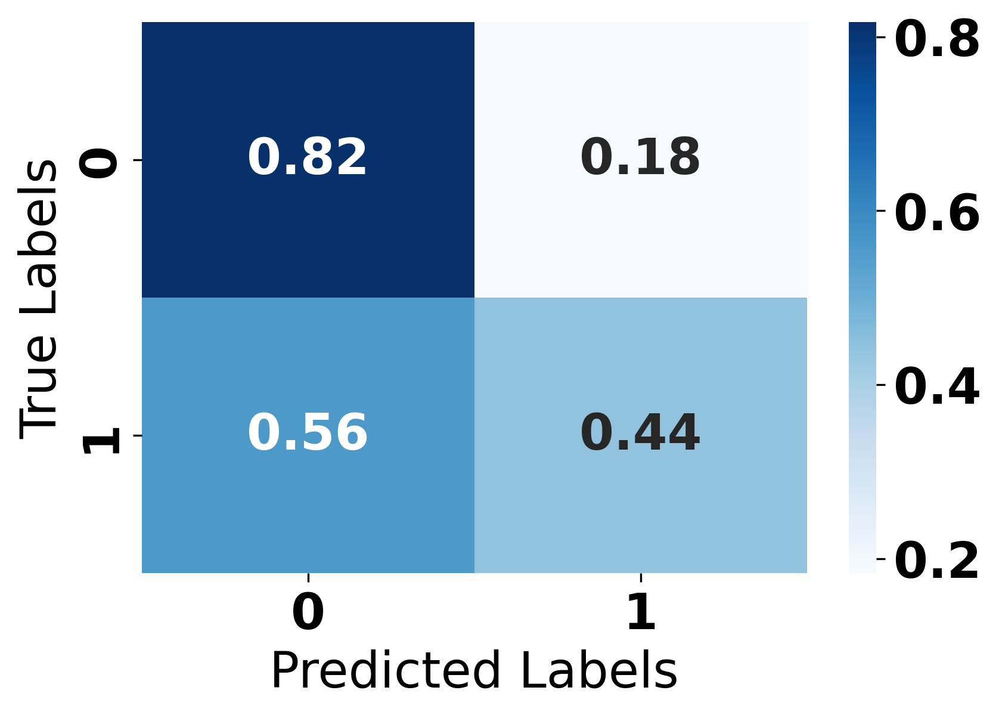

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S4).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS4 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S4).h5')

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.81671305 0.18328695]
 [0.55825243 0.44174757]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.82      0.89    109244
     Class 1       0.08      0.44      0.13      3708

    accuracy                           0.80    112952
   macro avg       0.53      0.63      0.51    112952
weighted avg       0.95      0.80      0.86    112952



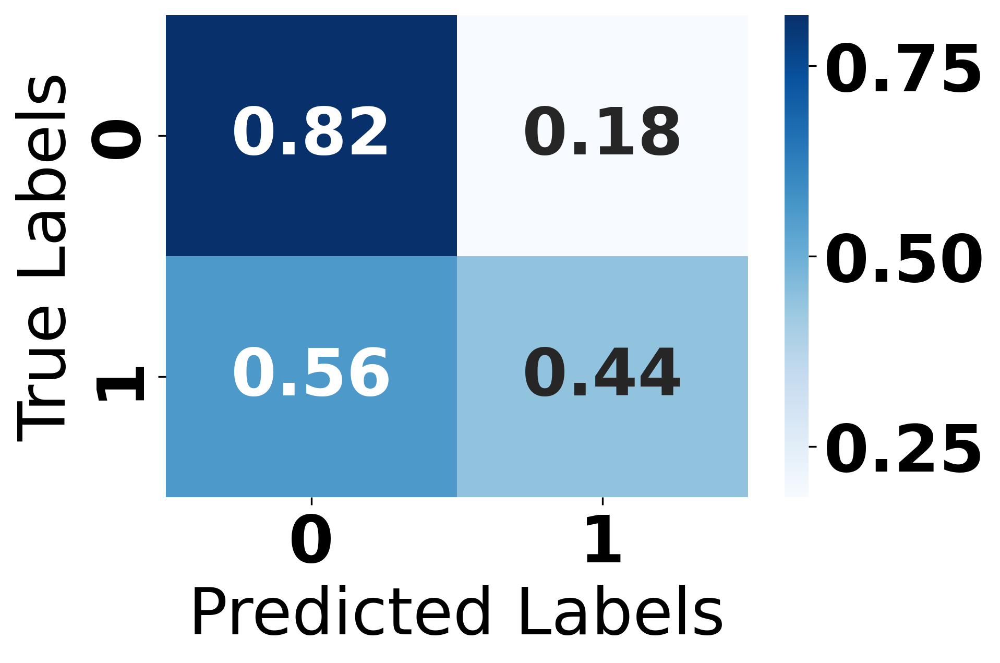

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS4.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S5

In [ ]:
# Labeling
x_trainS = x_train[['PRIMINSR', 'MEDCOST1', 'CHECKUP1', 'PERSDOC3']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['PRIMINSR', 'MEDCOST1', 'CHECKUP1', 'PERSDOC3']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 19s 9ms/step - loss: 0.6420 - accuracy: 0.6435 - val_loss: 0.6401 - val_accuracy: 0.5853
Epoch 2/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6322 - accuracy: 0.6519 - val_loss: 0.6401 - val_accuracy: 0.5797
Epoch 3/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6306 - accuracy: 0.6533 - val_loss: 0.6060 - val_accuracy: 0.5898
Epoch 4/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6301 - accuracy: 0.6541 - val_loss: 0.6430 - val_accuracy: 0.5801
Epoch 5/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6292 - accuracy: 0.6546 - val_loss: 0.6473 - val_accuracy: 0.5852
Epoch 6/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6286 - accuracy: 0.6554 - val_loss: 0.6134 - val_accuracy: 0.6143
Epoch 7/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.6285 - accuracy: 0.6548 - val_loss: 0.6359 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 34s 17ms/step - loss: 0.6425 - accuracy: 0.6445 - val_loss: 0.6823 - val_accuracy: 0.5823
Epoch 2/20
1691/1691 [==============================] - 27s 16ms/step - loss: 0.6321 - accuracy: 0.6518 - val_loss: 0.6299 - val_accuracy: 0.6115
Epoch 3/20
1691/1691 [==============================] - 26s 16ms/step - loss: 0.6309 - accuracy: 0.6526 - val_loss: 0.6447 - val_accuracy: 0.6092
Epoch 4/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6295 - accuracy: 0.6548 - val_loss: 0.6122 - val_accuracy: 0.6133
Epoch 5/20
1691/1691 [==============================] - 16s 10ms/step - loss: 0.6291 - accuracy: 0.6548 - val_loss: 0.6346 - val_accuracy: 0.6094
Epoch 6/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6288 - accuracy: 0.6554 - val_loss: 0.6119 - val_accuracy: 0.6151
Epoch 7/20
1691/1691 [==============================] - 18s 11ms/step - loss: 0.6282 - accuracy: 0.6555 - val_loss: 0.6280 -

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.60607448 0.39392552]
 [0.28802589 0.71197411]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.61      0.75    109244
     Class 1       0.06      0.71      0.11      3708

    accuracy                           0.61    112952
   macro avg       0.52      0.66      0.43    112952
weighted avg       0.95      0.61      0.73    112952



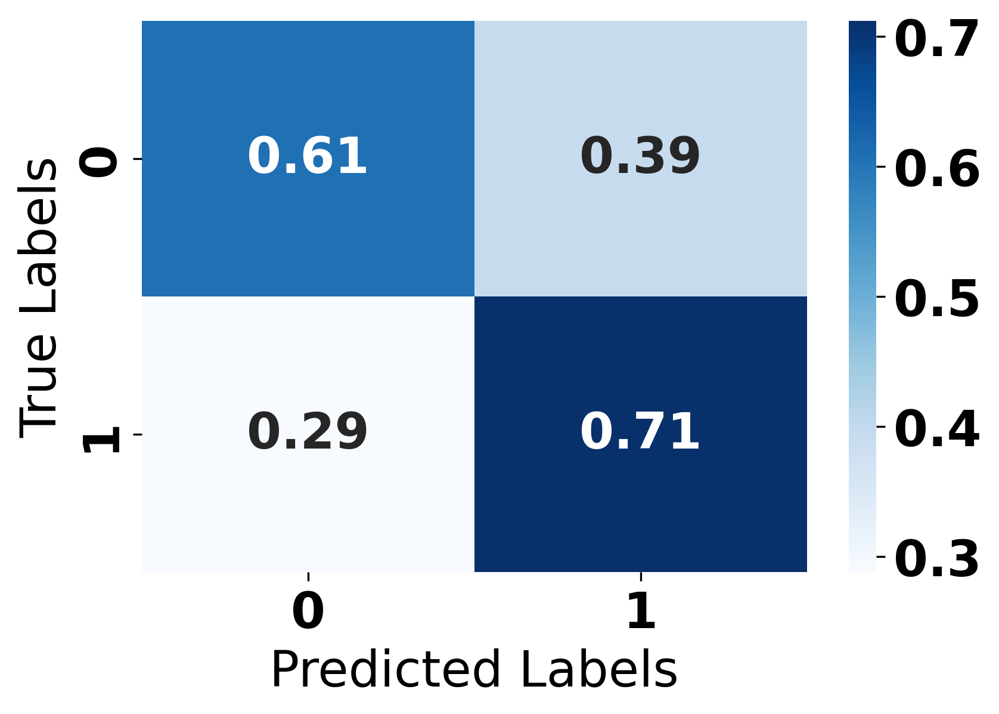

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S5).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS5 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S5).h5')

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.60201018 0.39798982]
 [0.28505933 0.71494067]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.60      0.75    109244
     Class 1       0.06      0.71      0.11      3708

    accuracy                           0.61    112952
   macro avg       0.52      0.66      0.43    112952
weighted avg       0.95      0.61      0.73    112952



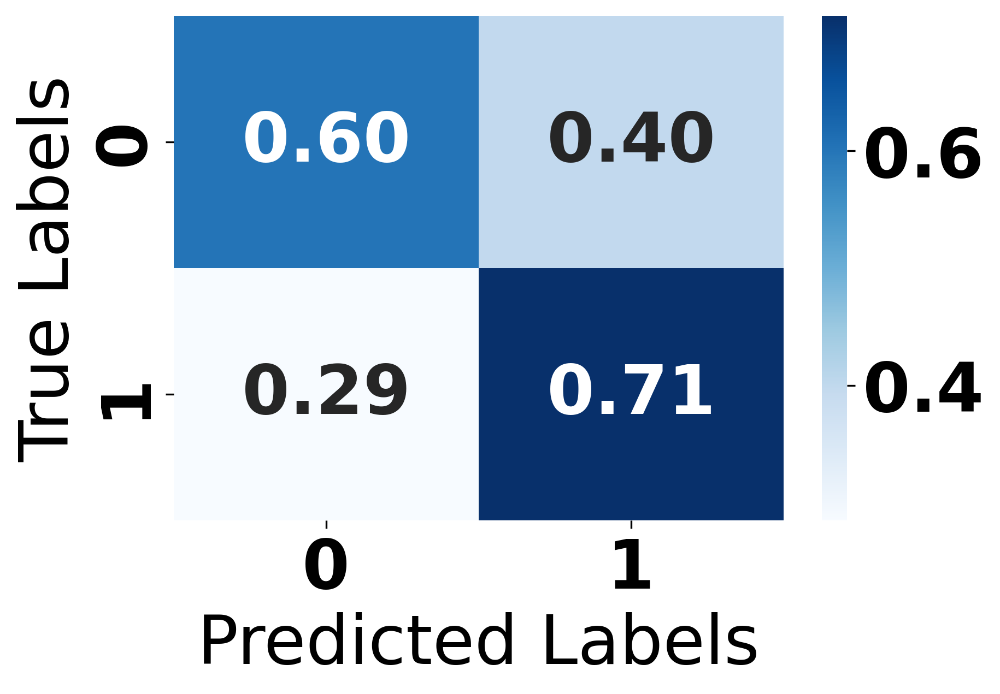

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS5.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S6

In [ ]:
# Labeling
x_trainS = x_train[['_RFDRHV7', 'USENOW3',  '_SMOKER3', 'EXERANY2',  'FRUIT2']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['_RFDRHV7', 'USENOW3',  '_SMOKER3', 'EXERANY2',  'FRUIT2']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 17s 9ms/step - loss: 0.6856 - accuracy: 0.5705 - val_loss: 0.6426 - val_accuracy: 0.6321
Epoch 2/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6700 - accuracy: 0.5949 - val_loss: 0.6772 - val_accuracy: 0.5117
Epoch 3/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6675 - accuracy: 0.6019 - val_loss: 0.4821 - val_accuracy: 0.8447
Epoch 4/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6666 - accuracy: 0.6025 - val_loss: 0.6027 - val_accuracy: 0.6508
Epoch 5/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6660 - accuracy: 0.6037 - val_loss: 0.6261 - val_accuracy: 0.5436
Epoch 6/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6653 - accuracy: 0.6055 - val_loss: 0.6620 - val_accuracy: 0.5188
Epoch 7/20
1691/1691 [==============================] - 13s 8ms/step - loss: 0.6658 - accuracy: 0.6038 - val_loss: 0.6578 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 36s 19ms/step - loss: 0.6821 - accuracy: 0.5776 - val_loss: 0.7432 - val_accuracy: 0.4554
Epoch 2/20
1691/1691 [==============================] - 29s 17ms/step - loss: 0.6708 - accuracy: 0.5938 - val_loss: 0.6265 - val_accuracy: 0.5892
Epoch 3/20
1691/1691 [==============================] - 23s 13ms/step - loss: 0.6680 - accuracy: 0.5988 - val_loss: 0.6022 - val_accuracy: 0.6706
Epoch 4/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6674 - accuracy: 0.5999 - val_loss: 0.6215 - val_accuracy: 0.6039
Epoch 5/20
1691/1691 [==============================] - 18s 10ms/step - loss: 0.6670 - accuracy: 0.6002 - val_loss: 0.6630 - val_accuracy: 0.5179
Epoch 6/20
1691/1691 [==============================] - 17s 10ms/step - loss: 0.6668 - accuracy: 0.6004 - val_loss: 0.6622 - val_accuracy: 0.5116
Epoch 7/20
1691/1691 [==============================] - 20s 12ms/step - loss: 0.6664 - accuracy: 0.6008 - val_loss: 0.6556 -

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.51049028 0.48950972]
 [0.27750809 0.72249191]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.51      0.67    109244
     Class 1       0.05      0.72      0.09      3708

    accuracy                           0.52    112952
   macro avg       0.51      0.62      0.38    112952
weighted avg       0.95      0.52      0.65    112952



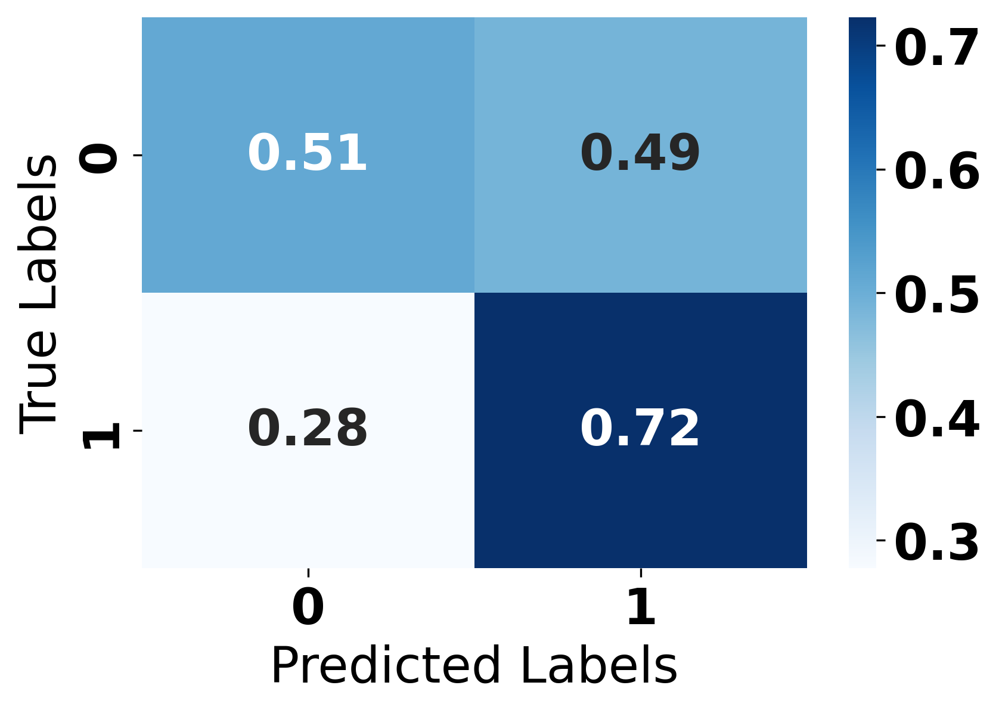

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S6).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS6 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S6).h5')

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.51207389 0.48792611]
 [0.27831715 0.72168285]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.98      0.51      0.67    109244
     Class 1       0.05      0.72      0.09      3708

    accuracy                           0.52    112952
   macro avg       0.51      0.62      0.38    112952
weighted avg       0.95      0.52      0.65    112952



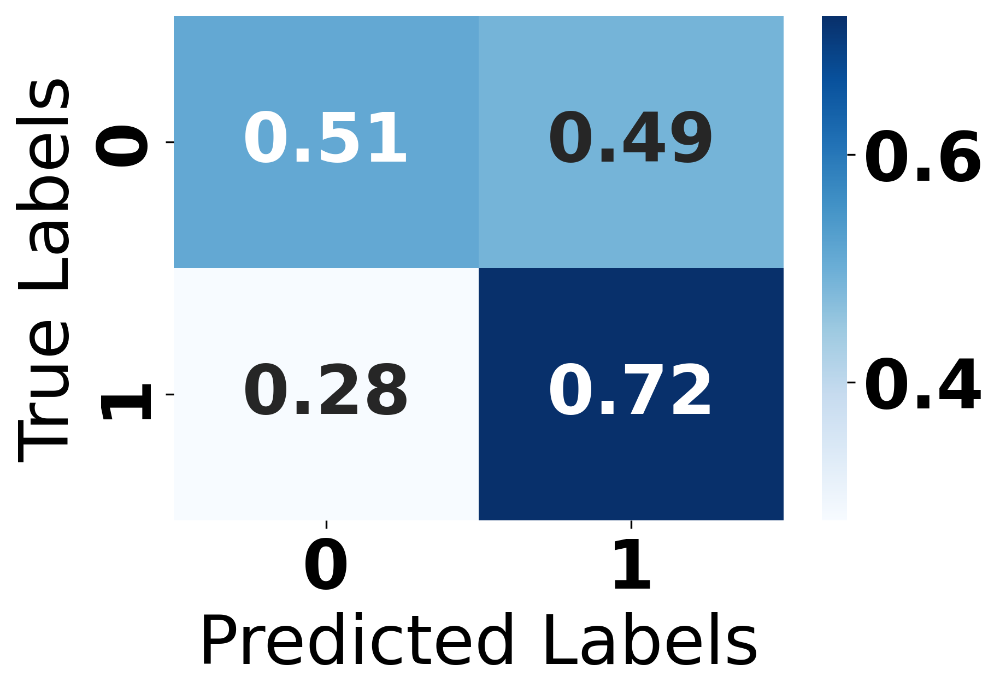

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS6.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S7

In [ ]:
# Labeling
x_trainS = x_train[['HIVTST7', 'FLUSHOT7']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['HIVTST7', 'FLUSHOT7']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 19s 9ms/step - loss: 0.7001 - accuracy: 0.5204 - val_loss: 0.6773 - val_accuracy: 0.4561
Epoch 2/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6925 - accuracy: 0.5258 - val_loss: 0.7023 - val_accuracy: 0.3662
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6918 - accuracy: 0.5273 - val_loss: 0.6863 - val_accuracy: 0.6263
Epoch 4/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.6916 - accuracy: 0.5298 - val_loss: 0.6952 - val_accuracy: 0.6263
Epoch 5/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.6914 - accuracy: 0.5312 - val_loss: 0.6904 - val_accuracy: 0.6263
Epoch 6/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.6912 - accuracy: 0.5316 - val_loss: 0.6795 - val_accuracy: 0.6263
Epoch 7/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.6911 - accuracy: 0.5322 - val_loss: 0.6738 - val_ac

In [ ]:
import time
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Measure the training time
start_time = time.time()

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

end_time = time.time()
training_time = end_time - start_time

print("Training Time:", training_time)

# Measure the test time
start_time = time.time()

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)

end_time = time.time()
test_time = end_time - start_time

print("Test Time:", test_time)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 33s 17ms/step - loss: 0.7000 - accuracy: 0.5188 - val_loss: 0.6455 - val_accuracy: 0.6263
Epoch 2/20
1691/1691 [==============================] - 28s 17ms/step - loss: 0.6923 - accuracy: 0.5280 - val_loss: 0.6887 - val_accuracy: 0.6263
Epoch 3/20
1691/1691 [==============================] - 24s 14ms/step - loss: 0.6917 - accuracy: 0.5291 - val_loss: 0.6650 - val_accuracy: 0.6263
Epoch 4/20
1691/1691 [==============================] - 18s 10ms/step - loss: 0.6915 - accuracy: 0.5299 - val_loss: 0.6740 - val_accuracy: 0.6263
Epoch 5/20
1691/1691 [==============================] - 21s 12ms/step - loss: 0.6914 - accuracy: 0.5309 - val_loss: 0.6807 - val_accuracy: 0.4561
Epoch 6/20
1691/1691 [==============================] - 21s 12ms/step - loss: 0.6912 - accuracy: 0.5311 - val_loss: 0.6757 - val_accuracy: 0.6263
Epoch 7/20
1691/1691 [==============================] - 18s 10ms/step - loss: 0.6911 - accuracy: 0.5325 - val_loss: 0.6903 -

3530/3530 [==============================] - 6s 2ms/step
Normalized Confusion Matrix:
[[0.63217202 0.36782798]
 [0.54665588 0.45334412]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.63      0.77    109244
     Class 1       0.04      0.45      0.07      3708

    accuracy                           0.63    112952
   macro avg       0.51      0.54      0.42    112952
weighted avg       0.94      0.63      0.74    112952



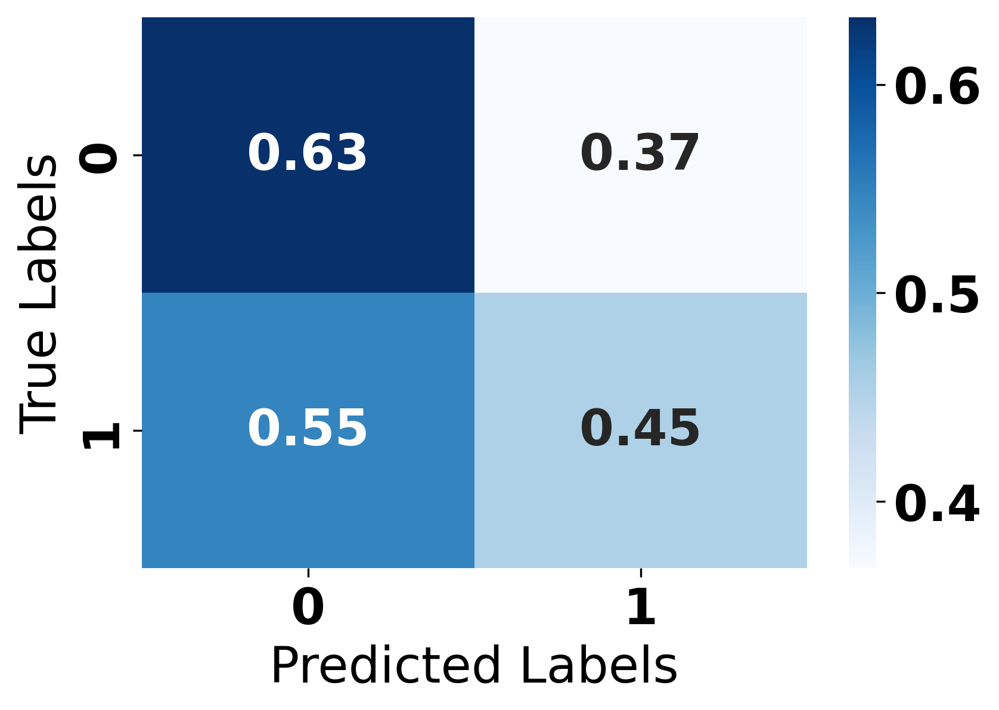

In [ ]:
# Predict probabilities on test data
y_pred_prob = dual-path_ANN.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S7).h5')
"""

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS7 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S7).h5')

3530/3530 [==============================] - 12s 3ms/step
Normalized Confusion Matrix:
[[0.63217202 0.36782798]
 [0.54665588 0.45334412]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.63      0.77    109244
     Class 1       0.04      0.45      0.07      3708

    accuracy                           0.63    112952
   macro avg       0.51      0.54      0.42    112952
weighted avg       0.94      0.63      0.74    112952



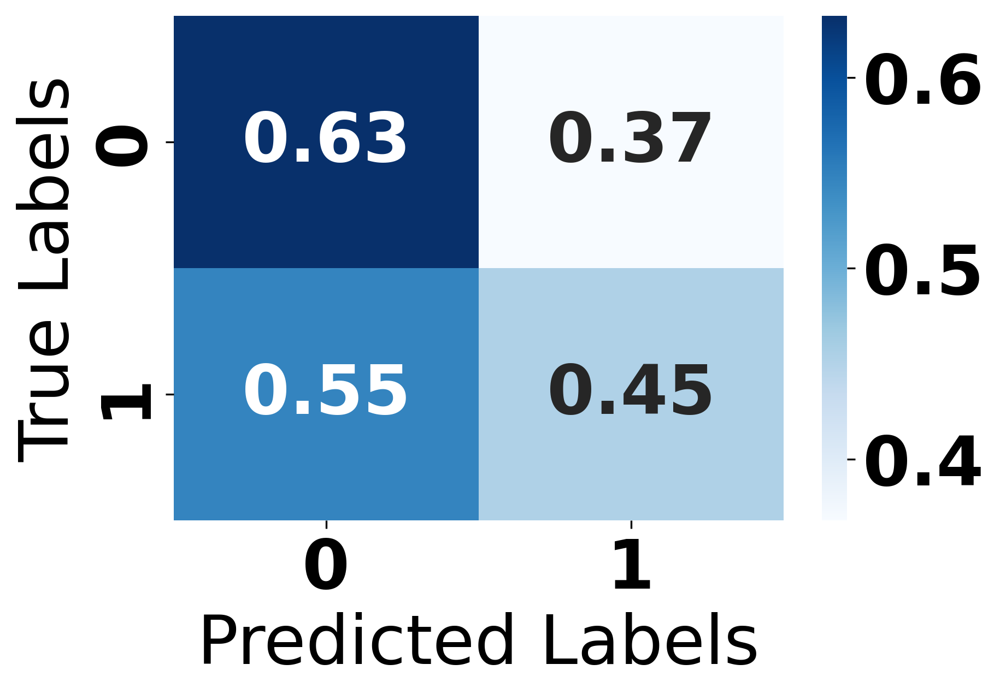

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS7.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S3S1

In [ ]:
# Labeling
x_trainS = x_train[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT', 'MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G', 'EDUCA', 'EMPLOY1', 'INCOME3', 'CPDEMO1B']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT', 'MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G', 'EDUCA', 'EMPLOY1', 'INCOME3', 'CPDEMO1B']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 19s 9ms/step - loss: 0.4852 - accuracy: 0.7678 - val_loss: 0.4334 - val_accuracy: 0.9118
Epoch 2/20
1691/1691 [==============================] - 14s 9ms/step - loss: 0.4549 - accuracy: 0.7869 - val_loss: 0.6783 - val_accuracy: 0.6283
Epoch 3/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.4527 - accuracy: 0.7870 - val_loss: 0.2047 - val_accuracy: 0.9392
Epoch 4/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4531 - accuracy: 0.7862 - val_loss: 0.5815 - val_accuracy: 0.7234
Epoch 5/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.4476 - accuracy: 0.7895 - val_loss: 0.9278 - val_accuracy: 0.3559
Epoch 6/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4470 - accuracy: 0.7891 - val_loss: 0.5176 - val_accuracy: 0.6977
Epoch 7/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4450 - accuracy: 0.7888 - val_loss: 0.3488 - val_ac

In [ ]:

# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3S1S2).h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS3S1S2 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3S1S2).h5')

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.82125334 0.17874666]
 [0.22950378 0.77049622]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.82      0.90    109244
     Class 1       0.13      0.77      0.22      3708

    accuracy                           0.82    112952
   macro avg       0.56      0.80      0.56    112952
weighted avg       0.96      0.82      0.88    112952



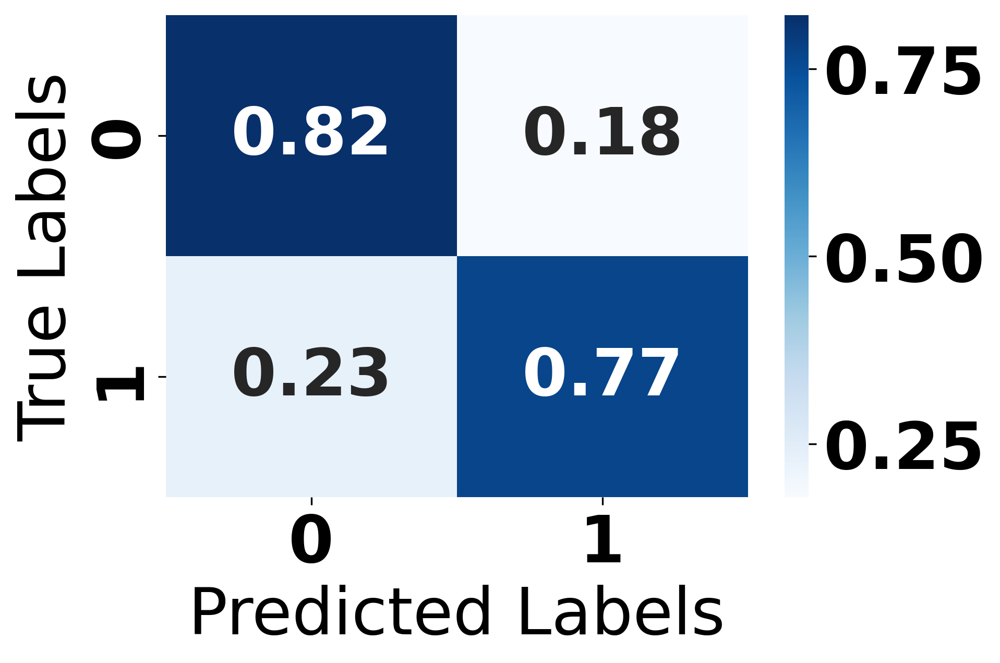

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS3S1S2.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# S3S1S2

In [ ]:
# Labeling
x_trainS = x_train[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT', 'MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G']] # Input features
y_trainS = y_train.copy() # Target label

x_testS = x_test[['CHCSCNCR', 'CHCOCNCR', 'CHCCOPD3', 'CVDCRHD4', 'ADDEPEV3', 'CHCKDNY2', 'DIABETE4', 'HAVARTH5', 'CVDSTRK3', 'ASTHMA3', 'TOLDHI3', 'BPHIGH6', 'GENHLTH',  '_BMI5CAT', 'MARITAL', 'RENTHOM1', 'VETERAN3', 'HEIGHT3', '_IMPRACE', '_STATE', 'QSTLANG', 'SEXVAR', '_CHLDCNT',  '_AGE_G']] # Input features
y_testS = y_test.copy() # Target label

In [ ]:
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.regularizers import l2

# Define the input shape based on your data
input_shape = (x_trainS.shape[1],)  # Assuming your input data is 1D

def dual-path_ANN(input_shape):
    input_layer = Input(shape=input_shape)

    # Add fully connected layers with increasing complexity
    dense1 = Dense(256, activation='relu')(input_layer)
    dense1 = BatchNormalization()(dense1)
    dense1 = Dropout(0.5)(dense1)  # Adding dropout for regularization

    dense2 = Dense(128, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)
    dense2 = Dropout(0.5)(dense2)

    # Introduce a parallel branch with a different activation function
    dense2_alt = Dense(128, activation='selu')(dense1)
    dense2_alt = BatchNormalization()(dense2_alt)
    dense2_alt = Dropout(0.5)(dense2_alt)

    # Concatenate outputs from the main and parallel branches
    concatenated = Concatenate()([dense2, dense2_alt])

    dense3 = Dense(64, activation='relu')(concatenated)
    dense3 = BatchNormalization()(dense3)

    output = Dense(1, activation='sigmoid')(dense3)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel ANN model
dual-path_ANN = dual-path_ANN(input_shape)

# Compile the model
dual-path_ANN.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Train the novel ANN model
dual-path_ANN.fit(x_trainS, y_trainS, epochs=20, batch_size=128, validation_data=(x_testS, y_testS))

# Evaluate the novel ANN model
loss, accuracy = dual-path_ANN.evaluate(x_testS, y_testS)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

Epoch 1/20
1691/1691 [==============================] - 17s 9ms/step - loss: 0.4965 - accuracy: 0.7622 - val_loss: 0.8466 - val_accuracy: 0.4286
Epoch 2/20
1691/1691 [==============================] - 14s 8ms/step - loss: 0.4633 - accuracy: 0.7827 - val_loss: 1.0939 - val_accuracy: 0.3421
Epoch 3/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4607 - accuracy: 0.7809 - val_loss: 0.3981 - val_accuracy: 0.8596
Epoch 4/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4582 - accuracy: 0.7813 - val_loss: 0.4308 - val_accuracy: 0.8118
Epoch 5/20
1691/1691 [==============================] - 15s 9ms/step - loss: 0.4557 - accuracy: 0.7823 - val_loss: 0.5342 - val_accuracy: 0.7479
Epoch 6/20
1691/1691 [==============================] - 14s 9ms/step - loss: 0.4525 - accuracy: 0.7836 - val_loss: 0.7031 - val_accuracy: 0.6040
Epoch 7/20
1691/1691 [==============================] - 16s 9ms/step - loss: 0.4503 - accuracy: 0.7839 - val_loss: 0.4139 - val_ac

In [ ]:

# Save the model to a file
dual-path_ANN.save('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3S1).h5')


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
Novel_ANNS3S1 = load_model('/content/drive/MyDrive/Myocardial Infarction/Sensitivity/Novel_ANN(S3S1).h5')

3530/3530 [==============================] - 7s 2ms/step
Normalized Confusion Matrix:
[[0.72285892 0.27714108]
 [0.1469795  0.8530205 ]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.99      0.72      0.84    109244
     Class 1       0.09      0.85      0.17      3708

    accuracy                           0.73    112952
   macro avg       0.54      0.79      0.50    112952
weighted avg       0.96      0.73      0.81    112952



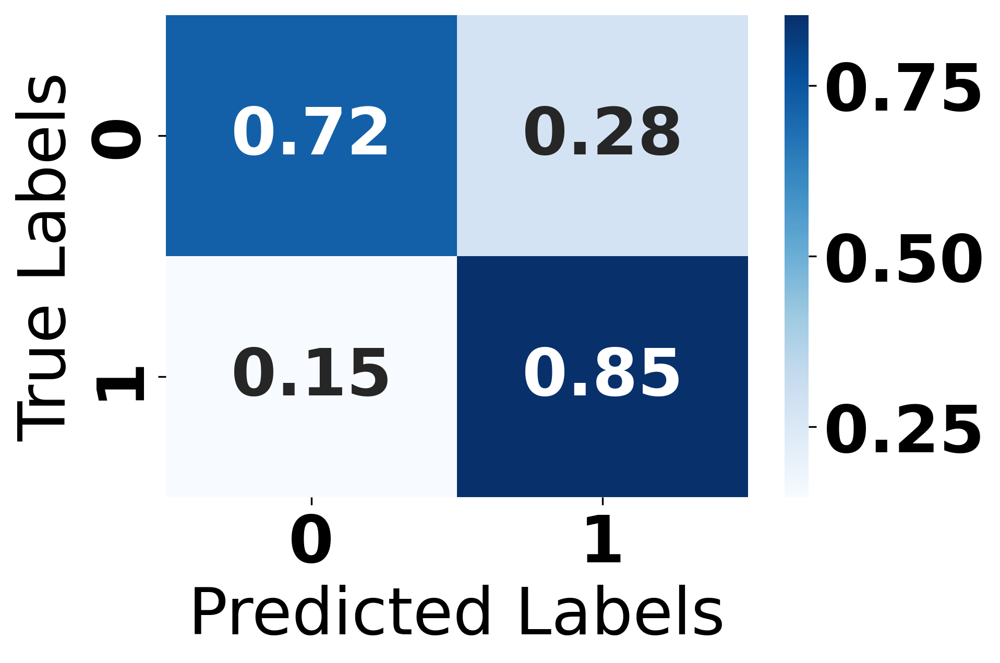

In [ ]:
# Predict probabilities on test data
y_pred_prob = Novel_ANNS3S1.predict(x_testS)

# Convert probabilities to class labels using a threshold of 0.50
y_pred = np.where(y_pred_prob > 0.50, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_testS, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.50)
report = classification_report(y_testS, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Cost Sensitive Learning (CSL)

### BRFSS 2021

In [ ]:
from tensorflow.keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, Add, Multiply, BatchNormalization, GlobalAveragePooling1D, Reshape
from tensorflow.keras.models import Model
import tensorflow as tf
import numpy as np
from sklearn.utils import class_weight

# Define a function to calculate class weights with an increasing factor
def get_class_weights(y_train, factor):
    class_weights = class_weight.compute_class_weight('balanced', classes=np.unique(y_train), y=y_train)
    class_weights_dict = {0: class_weights[0], 1: class_weights[1] * factor}
    return class_weights_dict

# Define a function to create the model
def novel_improved_model(input_shape):
    input_layer = Input(shape=input_shape)

    conv1 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(input_layer)
    conv2 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv1)
    conv3 = Conv1D(filters=64, kernel_size=3, activation='relu', padding='same')(conv2)

    # Channel-wise Attention Block
    attention = GlobalAveragePooling1D()(conv3)
    attention = Dense(64, activation='sigmoid')(attention)
    attention = Reshape((1, 64))(attention)
    attention = Multiply()([conv3, attention])

    # Skip connection and batch normalization
    skip_connection = Add()([conv1, attention])
    skip_connection = BatchNormalization()(skip_connection)

    pool = MaxPooling1D(pool_size=2)(skip_connection)

    # Flatten and fully connected layers
    flatten = Flatten()(pool)

    dense1 = Dense(128, activation='relu')(flatten)
    dense1 = BatchNormalization()(dense1)

    dense2 = Dense(64, activation='relu')(dense1)
    dense2 = BatchNormalization()(dense2)

    output = Dense(1, activation='sigmoid')(dense2)

    model = Model(inputs=input_layer, outputs=output)
    return model

# Create the novel model
input_shape = (x_train.shape[1], 1)
novel_model_instance = novel_improved_model(input_shape)

# Compile the model
novel_model_instance.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

# Set an initial factor for class weight increase
factor = 1

# Train the novel model for multiple epochs with increasing class weights
for epoch in range(10):
    class_weights_dict = get_class_weights(y_train, factor)
    novel_model_instance.fit(x_train, y_train, epochs=1, batch_size=64, validation_data=(x_test, y_test), class_weight=class_weights_dict)
    factor += 0.1  # Increase the factor for the next epoch

# Evaluate the novel model
loss, accuracy = novel_model_instance.evaluate(x_test, y_test)
print("Test Loss:", loss)
print("Test Accuracy:", accuracy)

1843/1843 ━━━━━━━━━━━━━━━━━━━━ 20s 7ms/step - accuracy: 0.6753 - loss: 0.5766 - val_accuracy: 0.9554 - val_loss: 0.2226
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 10s 5ms/step - accuracy: 0.7389 - loss: 0.5179 - val_accuracy: 0.9672 - val_loss: 0.2111
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7700 - loss: 0.4859 - val_accuracy: 0.3760 - val_loss: 0.8900
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7524 - loss: 0.5006 - val_accuracy: 0.9636 - val_loss: 0.1274
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 14s 7ms/step - accuracy: 0.7422 - loss: 0.5187 - val_accuracy: 0.9621 - val_loss: 0.1777
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 11s 6ms/step - accuracy: 0.7389 - loss: 0.5215 - val_accuracy: 0.9671 - val_loss: 0.1138
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 12s 7ms/step - accuracy: 0.7091 - loss: 0.5473 - val_accuracy: 0.9596 - val_loss: 0.1449
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 9s 5ms/step - accuracy: 0.7064 - loss: 0.5633 - val_accuracy: 0.9676 - val_loss: 0.1593
1843/1843 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step 

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 6s 2ms/step
Normalized Confusion Matrix:
[[0.9899491 0.0100509]
 [0.7731931 0.2268069]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.97      0.99      0.98    109244
     Class 1       0.43      0.23      0.30      3708

    accuracy                           0.96    112952
   macro avg       0.70      0.61      0.64    112952
weighted avg       0.96      0.96      0.96    112952



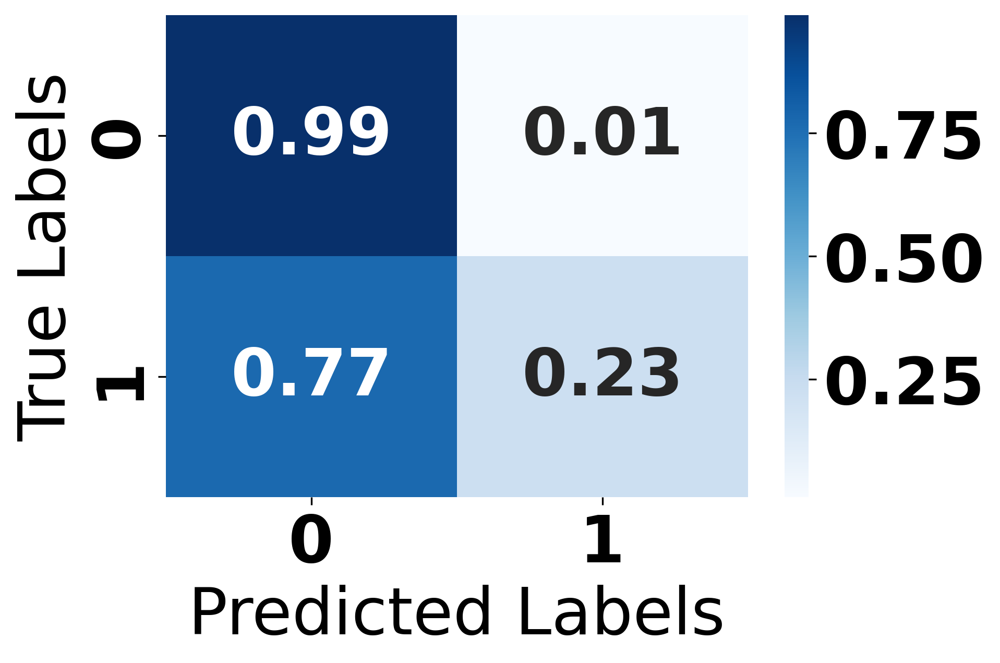

In [ ]:
# Predict probabilities on test data
y_pred_prob = novel_model_instance.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
"""
# Save the model to a file
novel_model_instance.save('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/novel_model_instance(CSL).h5')
"""

In [ ]:
from tensorflow.keras.models import load_model

# Load the saved model
novel_model_instance = load_model('/content/drive/MyDrive/Myocardial Infarction/Dataset/Minority-weighted Sampling/Model/novel_model_instance(CSL).h5')

In [ ]:
from sklearn.metrics import roc_auc_score

# Predict probabilities for the positive class
y_pred_proba = novel_model_instance.predict(x_test)

# If your model is binary classification, it might output probability for one class
# In that case, ensure you're using the right probability column (e.g., `[:, 1]` for binary classification)
if y_pred_proba.shape[1] > 1:
    y_pred_proba = y_pred_proba[:, 1]

# Calculate the AUC
auc = roc_auc_score(y_test, y_pred_proba)
print(f"AUC: {auc}")

3530/3530 ━━━━━━━━━━━━━━━━━━━━ 7s 2ms/step
AUC: 0.8795826661017565


### BRFSS 2019

1759/1759 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step
Normalized Confusion Matrix:
[[0.98819657 0.01180343]
 [0.73053188 0.26946812]]
Classification Report:
              precision    recall  f1-score   support

     Class 0       0.95      0.99      0.97     52866
     Class 1       0.60      0.27      0.37      3403

    accuracy                           0.94     56269
   macro avg       0.77      0.63      0.67     56269
weighted avg       0.93      0.94      0.93     56269



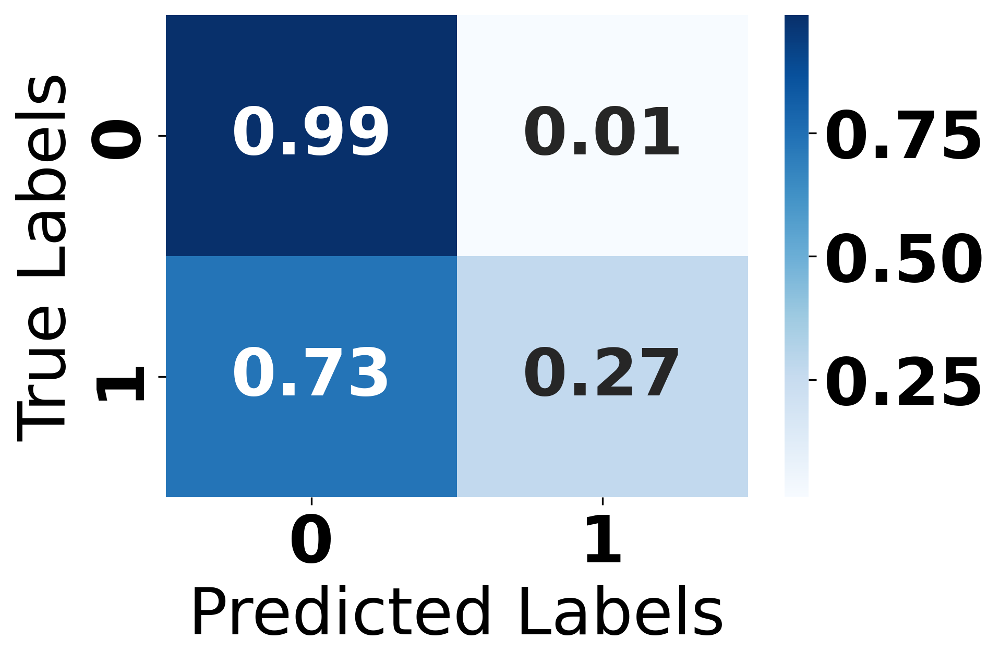

In [ ]:
# Predict probabilities on test data
y_pred_prob = novel_model_instance.predict(x_test)

# Convert probabilities to class labels using a threshold of 0.5
y_pred = np.where(y_pred_prob > 0.5, 1, 0)

# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate the normalized confusion matrix
normalized_cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

print("Normalized Confusion Matrix:")
print(normalized_cm)

# Generate classification report with the same threshold (0.5)
report = classification_report(y_test, y_pred, target_names=["Class 0", "Class 1"])
print("Classification Report:")
print(report)

# Print confusion matrix as figure
plt.figure(figsize=(6, 4))
sns.heatmap(normalized_cm, annot=True, cmap='Blues', fmt=".2f")
# plt.title('Normalized Confusion Matrix', fontsize=16, weight='bold')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [ ]:
from sklearn.metrics import roc_auc_score

# Predict probabilities for the positive class
y_pred_proba = novel_model_instance.predict(x_test)

# If your model is binary classification, it might output probability for one class
# In that case, ensure you're using the right probability column (e.g., `[:, 1]` for binary classification)
if y_pred_proba.shape[1] > 1:
    y_pred_proba = y_pred_proba[:, 1]

# Calculate the AUC
auc = roc_auc_score(y_test, y_pred_proba)
print(f"AUC: {auc}")

1759/1759 ━━━━━━━━━━━━━━━━━━━━ 3s 1ms/step
AUC: 0.8836021954453478
